**Quest 1 Part 3**

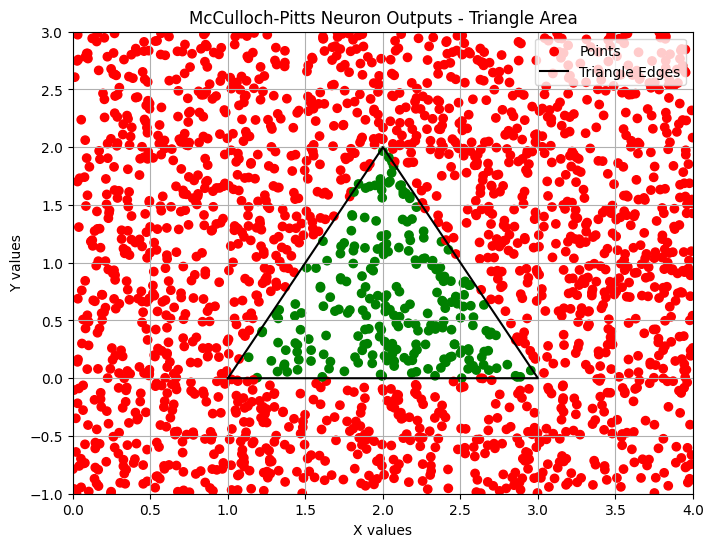

In [1]:
#import libraries
import numpy as np
import matplotlib.pyplot as plt

# Define the McCulloch-Pitts neuron class
class McCulloch_Pitts_neuron:
    def __init__(self, weights, threshold):
        self.weights = weights
        self.threshold = threshold

    def model(self, x):
        return 1 if np.dot(self.weights, x) >= self.threshold else 0

# Define the function to determine if a point is inside the triangle
def Area(x, y):
    # Define neurons based on the lines of the triangle
    neur1 = McCulloch_Pitts_neuron([2, -1], 2)  # Line 1: 2x - y = 2
    neur2 = McCulloch_Pitts_neuron([-2, -1], -6)  # Line 2: -2x - y = -6
    neur3 = McCulloch_Pitts_neuron([0, 1], 0)  # Line 3: y = 0
    neur4 = McCulloch_Pitts_neuron([1, 1, 1], 3)  # Combine previous neurons' outputs

    # Calculate the output of each neuron
    z1 = neur1.model(np.array([x, y]))
    z2 = neur2.model(np.array([x, y]))
    z3 = neur3.model(np.array([x, y]))
    z4 = neur4.model(np.array([z1, z2, z3]))

    return z4

# Generate random data points
num_points = 2000
x_values = np.random.uniform(0, 4, num_points)
y_values = np.random.uniform(-1, 3, num_points)

# Initialize color arrays based on the Area function output
colors = ['green' if Area(x, y) == 1 else 'red' for x, y in zip(x_values, y_values)]

# Plotting
plt.figure(figsize=(8, 6))
plt.scatter(x_values, y_values, c=colors, label='Points')
plt.xlabel('X values')
plt.ylabel('Y values')
plt.title('McCulloch-Pitts Neuron Outputs - Triangle Area')

# Plotting lines with legends
x_triangle = [1, 3, 2, 1]
y_triangle = [0, 0, 2, 0]
plt.plot(x_triangle, y_triangle, color='black', linestyle='-', label='Triangle Edges')

plt.grid(True)
plt.xlim(0, 4)
plt.ylim(-1, 3)
plt.legend(loc='upper right')
plt.show()


**Quest 2 part 1**

In [1]:
!kaggle datasets download aslkuscu/telecust1000t

Dataset URL: https://www.kaggle.com/datasets/aslkuscu/telecust1000t
License(s): apache-2.0
  0% 0.00/10.3k [00:00<?, ?B/s]
100% 10.3k/10.3k [00:00<00:00, 18.0MB/s]


In [2]:
!unzip telecust1000t.zip -d /content/telecust1000t

Archive:  telecust1000t.zip
  inflating: /content/telecust1000t/teleCust1000t.csv  


In [4]:
import pandas as pd
df = pd.read_csv("/content/telecust1000t/teleCust1000t.csv")
df.head()

,region,tenure,age,marital,address,income,ed,employ,retire,gender,reside,custcat
0,2,13,44,1,9,64.0,4,5,0.0,0,2,1
1,3,11,33,1,7,136.0,5,5,0.0,0,6,4
2,3,68,52,1,24,116.0,1,29,0.0,1,2,3
3,2,33,33,0,12,33.0,2,0,0.0,1,1,1
4,2,23,30,1,9,30.0,1,2,0.0,0,4,3


In [6]:
df.isna()

,region,tenure,age,marital,address,income,ed,employ,retire,gender,reside,custcat
0,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...
995,False,False,False,False,False,False,False,False,False,False,False,False
996,False,False,False,False,False,False,False,False,False,False,False,False
997,False,False,False,False,False,False,False,False,False,False,False,False
998,False,False,False,False,False,False,False,False,False,False,False,False


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 12 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   region   1000 non-null   int64  
 1   tenure   1000 non-null   int64  
 2   age      1000 non-null   int64  
 3   marital  1000 non-null   int64  
 4   address  1000 non-null   int64  
 5   income   1000 non-null   float64
 6   ed       1000 non-null   int64  
 7   employ   1000 non-null   int64  
 8   retire   1000 non-null   float64
 9   gender   1000 non-null   int64  
 10  reside   1000 non-null   int64  
 11  custcat  1000 non-null   int64  
dtypes: float64(2), int64(10)
memory usage: 93.9 KB


<Axes: >

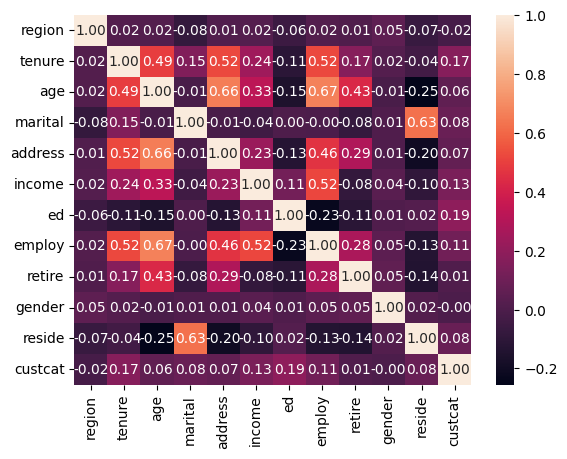

In [10]:
import seaborn as sns
correl = df.corr()
sns.heatmap(correl, annot = True, fmt = '.2f')

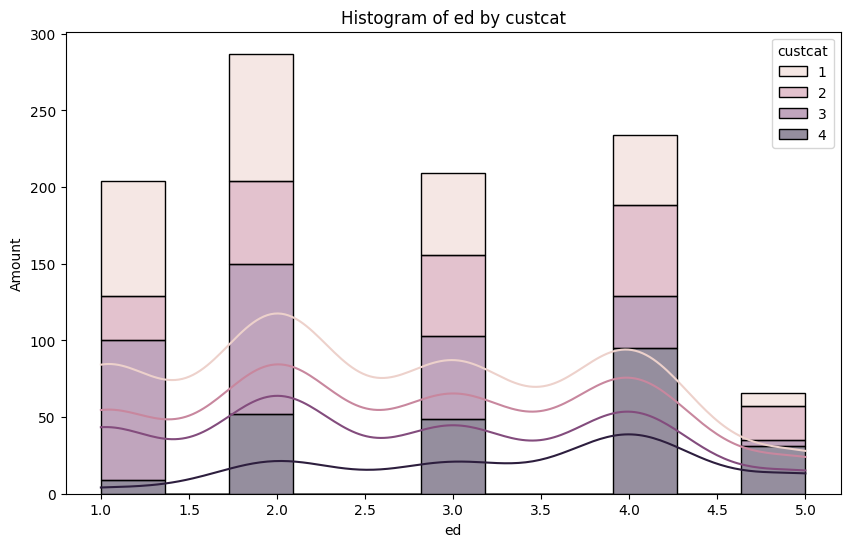

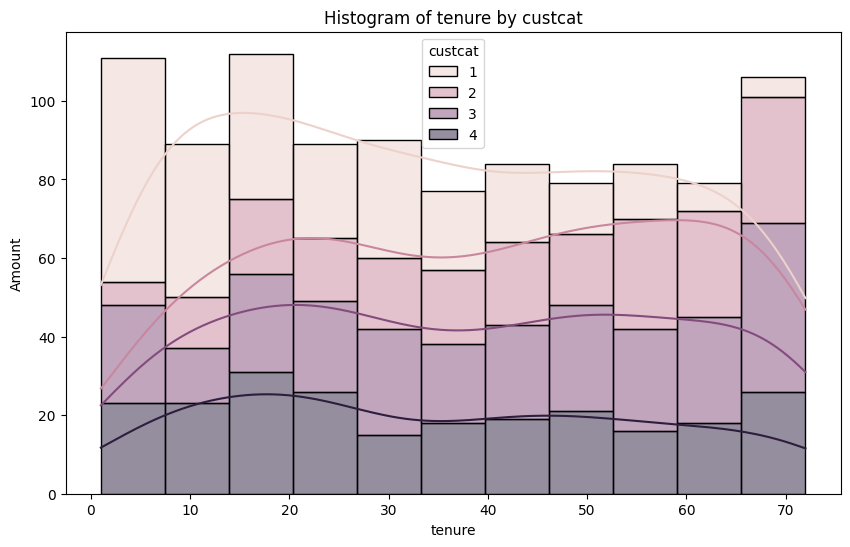

The two features with the highest correlation with 'custcat' are: ['ed', 'tenure']


In [8]:
import matplotlib.pyplot as plt

# Top 2 features with the highest correlation to 'custcat'
top_2_features = ['ed', 'tenure']

# Plot histograms for these features
for feature in top_2_features:
    plt.figure(figsize=(10, 6))
    sns.histplot(data=df, x=feature, hue='custcat', multiple='stack', kde=True)
    plt.title(f'Histogram of {feature} by custcat')
    plt.xlabel(f'{feature}')
    plt.ylabel('Amount')
    plt.show()

print(f"The two features with the highest correlation with 'custcat' are: {top_2_features}")


In [24]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.utils import to_categorical

# Separate features and the target
X = df.drop(columns=['custcat'])
y = df['custcat']

# Encode target into categorical values
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)
y_categorical = to_categorical(y_encoded)

# Data before normalization
print("Unnormalized Data:")
print(X.head())

# Normalize the features
scaler = MinMaxScaler()
X_normalized = scaler.fit_transform(X)

# Data after normalization
print("\nNormalized Data:")
print(pd.DataFrame(X_normalized, columns=X.columns).head())

# Split the dataset into training, validation, and testing sets
X_train, X_temp, y_train, y_temp = train_test_split(X_normalized, y_categorical, test_size=0.3, random_state=73, shuffle=True)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=73, shuffle=True)

# Print the shape of each split
print("\nShapes of each split:")
print(f"Training data: {X_train.shape}, {y_train.shape}")
print(f"Validation data: {X_val.shape}, {y_val.shape}")
print(f"Test data: {X_test.shape}, {y_test.shape}")


Unnormalized Data:
   region  tenure  age  marital  address  income  ed  employ  retire  gender  \
0       2      13   44        1        9    64.0   4       5     0.0       0   
1       3      11   33        1        7   136.0   5       5     0.0       0   
2       3      68   52        1       24   116.0   1      29     0.0       1   
3       2      33   33        0       12    33.0   2       0     0.0       1   
4       2      23   30        1        9    30.0   1       2     0.0       0   

   reside  
0       2  
1       6  
2       2  
3       1  
4       4  

Normalized Data:
   region    tenure       age  marital   address    income    ed    employ  \
0     0.5  0.169014  0.440678      1.0  0.163636  0.033153  0.75  0.106383   
1     1.0  0.140845  0.254237      1.0  0.127273  0.076552  1.00  0.106383   
2     1.0  0.943662  0.576271      1.0  0.436364  0.064497  0.00  0.617021   
3     0.5  0.450704  0.254237      0.0  0.218182  0.014467  0.25  0.000000   
4     0.5  0.309859 

Training model with 1 hidden layer...
Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - accuracy: 0.2681 - loss: 1.4180 - val_accuracy: 0.2867 - val_loss: 1.3868
Epoch 2/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.2762 - loss: 1.3993 - val_accuracy: 0.3000 - val_loss: 1.3818
Epoch 3/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.2866 - loss: 1.3895 - val_accuracy: 0.2800 - val_loss: 1.3784
Epoch 4/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.3000 - loss: 1.3828 - val_accuracy: 0.3000 - val_loss: 1.3751
Epoch 5/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.3039 - loss: 1.3771 - val_accuracy: 0.3000 - val_loss: 1.3721
Epoch 6/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.3187 - loss: 1.3720 - val_accuracy: 0.3000 - val_loss: 1.3692
Epoch 7/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.3255 - loss: 1.3672 - val_accuracy: 0.3200 - val_loss: 1.3665
Epoch 8/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3456 - loss: 1.3627 - val_accuracy: 0.3067 - val_loss: 1.3638

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.2874 - loss: 1.4109 - val_accuracy: 0.3333 - val_loss: 1.3705
Epoch 2/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3232 - loss: 1.3946 - val_accuracy: 0.3467 - val_loss: 1.3683
Epoch 3/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3160 - loss: 1.3856 - val_accuracy: 0.3333 - val_loss: 1.3666
Epoch 4/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3309 - loss: 1.3792 - val_accuracy: 0.3600 - val_loss: 1.3649
Epoch 5/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3303 - loss: 1.3735 - val_accuracy: 0.3733 - val_loss: 1.3628
Epoch 6/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3528 - loss: 1.3684 - val_accuracy: 0.3800 - val_loss: 1.3606
Epoch 7/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3577 - loss: 1.3640 - val_accuracy: 0.3800 - val_loss: 1.3582
Epoch 8/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.3531 - loss: 1.3598 - val_accuracy: 0.3733 - val_loss: 1.3560
Ep

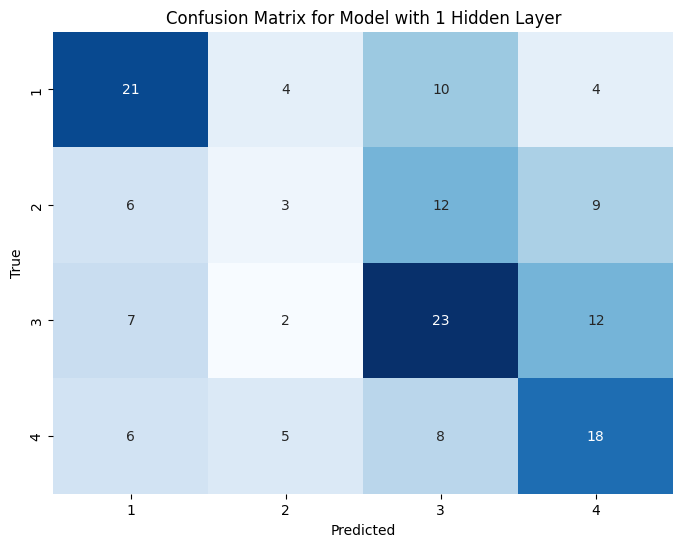

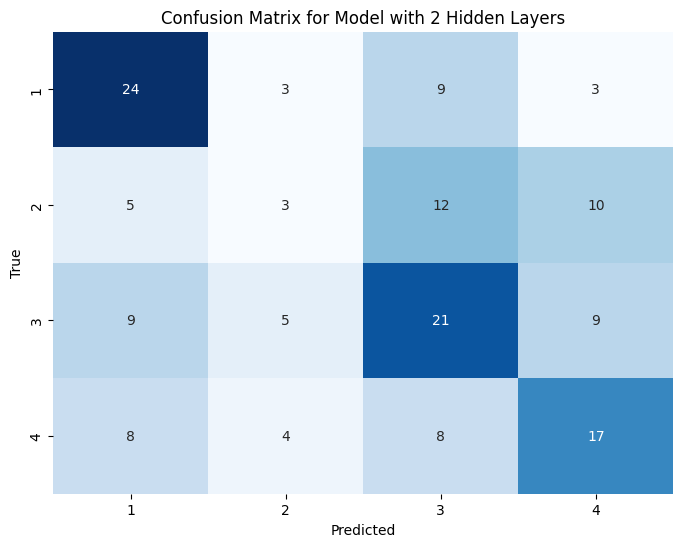

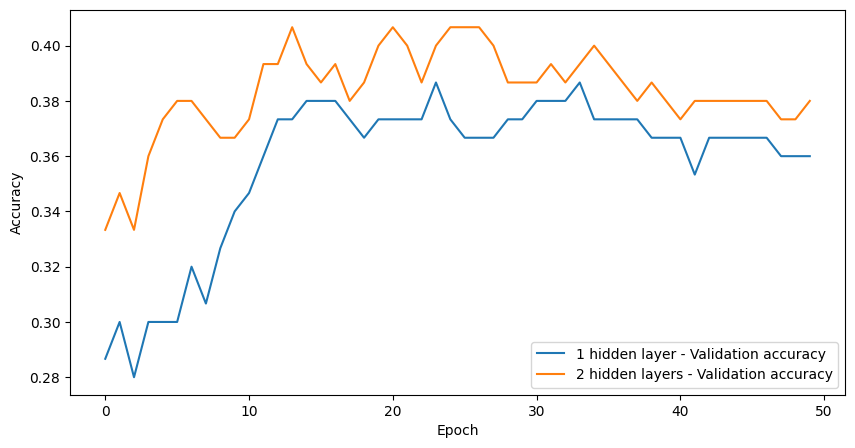


Training and evaluation completed successfully.


In [25]:
import tensorflow as tf
import random
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import confusion_matrix, accuracy_score

# Set random seeds for reproducibility
def set_seed(seed=73):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

def load_and_preprocess_data(file_path, seed=73):
    set_seed(seed)

    # Load the dataset
    df = pd.read_csv(file_path)

    # Separate features and the target
    X = df.drop(columns=['custcat'])
    y = df['custcat']

    # Encode target into categorical values
    label_encoder = LabelEncoder()
    y_encoded = label_encoder.fit_transform(y)
    y_categorical = to_categorical(y_encoded)

    # Split the dataset into training, validation, and testing sets
    X_train, X_temp, y_train, y_temp = train_test_split(X_normalized, y_categorical, test_size=0.3, random_state=seed, shuffle=True)
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=seed, shuffle=True)

    return X_train, X_val, X_test, y_train, y_val, y_test, label_encoder

def create_model_1(input_shape):
    model = Sequential([
        Dense(32, activation='relu', input_shape=(input_shape,)),
        Dense(4, activation='softmax')  # Adjusted output layer for 4 classes
    ])
    model.compile(optimizer=SGD(learning_rate=0.03), loss='categorical_crossentropy', metrics=['accuracy'])
    return model

def create_model_2(input_shape):
    model = Sequential([
        Dense(32, activation='relu', input_shape=(input_shape,)),
        Dense(32, activation='relu'),
        Dense(4, activation='softmax')  # Adjusted output layer for 4 classes
    ])
    model.compile(optimizer=SGD(learning_rate=0.03), loss='categorical_crossentropy', metrics=['accuracy'])
    return model

def train_and_evaluate(model, X_train, y_train, X_val, y_val, X_test, y_test, seed=73):
    set_seed(seed)

    # Train the model
    history = model.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), verbose=1)

    # Evaluate the model
    loss, accuracy = model.evaluate(X_test, y_test)
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true_classes = np.argmax(y_test, axis=1)
    cm = confusion_matrix(y_true_classes, y_pred_classes)

    return history, accuracy, cm

def plot_confusion_matrix(cm, title, label_encoder):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False, xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
    plt.title(title)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

def main():
    seed = 73
    set_seed(seed)

    # Load and preprocess data
    file_path = '/content/telecust1000t/teleCust1000t.csv'  # Adjust the file path as needed
    X_train, X_val, X_test, y_train, y_val, y_test, label_encoder = load_and_preprocess_data(file_path, seed)

    # Train and evaluate model with 1 hidden layer
    print("Training model with 1 hidden layer...")
    model_1 = create_model_1(X_train.shape[1])
    history_1, accuracy_1, cm_1 = train_and_evaluate(model_1, X_train, y_train, X_val, y_val, X_test, y_test, seed)

    # Train and evaluate model with 2 hidden layers
    print("Training model with 2 hidden layers...")
    model_2 = create_model_2(X_train.shape[1])
    history_2, accuracy_2, cm_2 = train_and_evaluate(model_2, X_train, y_train, X_val, y_val, X_test, y_test, seed)

    # Print accuracy results
    print(f"Model with 1 hidden layer test accuracy: {accuracy_1:.4f}")
    print(f"Model with 2 hidden layers test accuracy: {accuracy_2:.4f}")

    # Print confusion matrices
    print("\nConfusion matrix for model with 1 hidden layer:\n", cm_1)
    print("\nConfusion matrix for model with 2 hidden layers:\n", cm_2)

    # Plot confusion matrices
    plot_confusion_matrix(cm_1, 'Confusion Matrix for Model with 1 Hidden Layer', label_encoder)
    plot_confusion_matrix(cm_2, 'Confusion Matrix for Model with 2 Hidden Layers', label_encoder)

    # Plot accuracy
    plt.figure(figsize=(10, 5))
    plt.plot(history_1.history['val_accuracy'], label='1 hidden layer - Validation accuracy')
    plt.plot(history_2.history['val_accuracy'], label='2 hidden layers - Validation accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()

    print("\nTraining and evaluation completed successfully.")

main()



Training model with 5 neurons per hidden layer...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 45ms/step - accuracy: 0.3294 - loss: 1.4549 - val_accuracy: 0.3600 - val_loss: 1.3494
Epoch 2/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.3426 - loss: 1.4051 - val_accuracy: 0.3467 - val_loss: 1.3331
Epoch 3/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.3688 - loss: 1.3812 - val_accuracy: 0.3400 - val_loss: 1.3236
Epoch 4/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3893 - loss: 1.3648 - val_accuracy: 0.4000 - val_loss: 1.3160
Epoch 5/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.3792 - loss: 1.3526 - val_accuracy: 0.3867 - val_loss: 1.3106
Epoch 6/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.3847 - loss: 1.3432 - val_accuracy: 0.4133 - val_loss: 1.3058
Epoch 7/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.3901 - loss: 1.3349 - val_accuracy: 0.4200 - val_loss: 1.3020
Epoch 8/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.3900 - loss: 1.3278 - val_accuracy: 0.4133 - val_l

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - accuracy: 0.2146 - loss: 1.4777 - val_accuracy: 0.1800 - val_loss: 1.4461
Epoch 2/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.2466 - loss: 1.4145 - val_accuracy: 0.2667 - val_loss: 1.4060
Epoch 3/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2969 - loss: 1.3828 - val_accuracy: 0.3067 - val_loss: 1.3834
Epoch 4/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.3182 - loss: 1.3624 - val_accuracy: 0.3333 - val_loss: 1.3682
Epoch 5/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.3435 - loss: 1.3464 - val_accuracy: 0.3667 - val_loss: 1.3566
Epoch 6/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.3564 - loss: 1.3331 - val_accuracy: 0.3867 - val_loss: 1.3474
Epoch 7/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.3732 - loss: 1.3210 - val_accuracy: 0.3733 - val_loss: 1.3396
Epoch 8/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.3854 - loss: 1.3096 - val_accuracy: 0.3733 - val_loss

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.2160 - loss: 1.4406 - val_accuracy: 0.2600 - val_loss: 1.3895
Epoch 2/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.2859 - loss: 1.3836 - val_accuracy: 0.3133 - val_loss: 1.3583
Epoch 3/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.3192 - loss: 1.3494 - val_accuracy: 0.3267 - val_loss: 1.3392
Epoch 4/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3711 - loss: 1.3229 - val_accuracy: 0.3600 - val_loss: 1.3255
Epoch 5/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4047 - loss: 1.3009 - val_accuracy: 0.3800 - val_loss: 1.3142
Epoch 6/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4320 - loss: 1.2820 - val_accuracy: 0.3800 - val_loss: 1.3046
Epoch 7/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4304 - loss: 1.2659 - val_accuracy: 0.3800 - val_loss: 1.2971
Epoch 8/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.4321 - loss: 1.2522 - val_accuracy: 0.3733 - val_loss: 1.2917
Ep

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.2485 - loss: 1.3886 - val_accuracy: 0.2867 - val_loss: 1.3890
Epoch 2/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.3791 - loss: 1.3421 - val_accuracy: 0.3133 - val_loss: 1.3639
Epoch 3/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3932 - loss: 1.3166 - val_accuracy: 0.3467 - val_loss: 1.3499
Epoch 4/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4174 - loss: 1.2969 - val_accuracy: 0.3533 - val_loss: 1.3407
Epoch 5/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.4245 - loss: 1.2805 - val_accuracy: 0.3667 - val_loss: 1.3335
Epoch 6/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4378 - loss: 1.2662 - val_accuracy: 0.3400 - val_loss: 1.3282
Epoch 7/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4361 - loss: 1.2536 - val_accuracy: 0.3467 - val_loss: 1.3238
Epoch 8/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4464 - loss: 1.2423 - val_accuracy: 0.3467 - val_loss: 1.3202
Ep

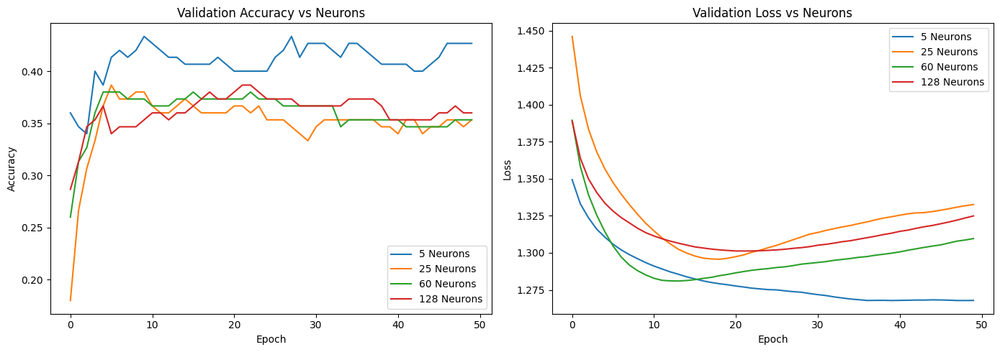

In [1]:
import tensorflow as tf
import random
import numpy as np
import pandas as pd
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
import seaborn as sns

# Set random seeds for reproducibility
def set_seed(seed=73):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Load and preprocess data
def load_and_preprocess_data(file_path, seed=73):
    set_seed(seed)

    # Load dataset
    df = pd.read_csv(file_path)

    # Separate features and target
    X = df.drop(columns=['custcat'])
    y = df['custcat']

    # Encode target into categorical values
    label_encoder = LabelEncoder()
    y_encoded = label_encoder.fit_transform(y)
    y_categorical = to_categorical(y_encoded)

    # Normalize features
    X_normalized = (X - X.mean()) / X.std()

    # Split dataset
    X_train, X_temp, y_train, y_temp = train_test_split(X_normalized, y_categorical, test_size=0.3, random_state=seed, shuffle=True)
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=seed, shuffle=True)

    return X_train, X_val, X_test, y_train, y_val, y_test, label_encoder

# Define and compile model
def create_model(neurons, layers):
    model = Sequential()
    model.add(Dense(neurons, activation='relu', input_shape=(X_train.shape[1],)))
    for _ in range(layers - 1):
        model.add(Dense(neurons, activation='relu'))
    model.add(Dense(4, activation='softmax'))  # Output layer for 4 classes
    model.compile(optimizer=SGD(learning_rate=0.03), loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Main function
def main():
    seed = 73
    set_seed(seed)

    # Load and preprocess data
    file_path = '/content/telecust1000t/teleCust1000t.csv'  # Adjust the file path as needed
    global X_train, X_val, X_test, y_train, y_val, y_test
    X_train, X_val, X_test, y_train, y_val, y_test, label_encoder = load_and_preprocess_data(file_path, seed)

    # Define neurons to test
    neuron_counts = [5, 25, 60, 128]
    histories = []

    # Train models with varying neurons
    for neurons in neuron_counts:
        print(f"\nTraining model with {neurons} neurons per hidden layer...")
        model = create_model(neurons, layers=2)  # Two hidden layers
        history = model.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), verbose=1)
        histories.append((neurons, history))

        # Print the accuracy of the model
        val_accuracy = history.history['val_accuracy'][-1]
        print(f"Validation accuracy for model with {neurons} neurons: {val_accuracy:.4f}")

    # Plot accuracy and loss
    plt.figure(figsize=(14, 5))

    # Accuracy
    plt.subplot(1, 2, 1)
    for neurons, history in histories:
        plt.plot(history.history['val_accuracy'], label=f'{neurons} Neurons')
    plt.title('Validation Accuracy vs Neurons')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()

    # Loss
    plt.subplot(1, 2, 2)
    for neurons, history in histories:
        plt.plot(history.history['val_loss'], label=f'{neurons} Neurons')
    plt.title('Validation Loss vs Neurons')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()
    plt.show()

    print("\nTraining and plotting completed successfully.")

# Run the main function
main()


Training model with 5 neurons per hidden layer without normalization...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 39ms/step - accuracy: 0.2566 - loss: 1.4172 - val_accuracy: 0.2733 - val_loss: 1.3942
Epoch 2/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.2584 - loss: 1.4038 - val_accuracy: 0.2667 - val_loss: 1.3845
Epoch 3/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2840 - loss: 1.3955 - val_accuracy: 0.2667 - val_loss: 1.3782
Epoch 4/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2726 - loss: 1.3901 - val_accuracy: 0.2733 - val_loss: 1.3737
Epoch 5/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.2773 - loss: 1.3861 - val_accuracy: 0.2800 - val_loss: 1.3702
Epoch 6/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.2755 - loss: 1.3828 - val_accuracy: 0.3000 - val_loss: 1.3675
Epoch 7/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2755 - loss: 1.3800 - val_accuracy: 0.3200 - val_loss: 1.3650
Epoch 8/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.2805 - loss: 1.3775 - val_accuracy: 0.3200 - val_lo

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.2436 - loss: 1.6562 - val_accuracy: 0.3000 - val_loss: 1.4772
Epoch 2/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.2819 - loss: 1.5162 - val_accuracy: 0.2800 - val_loss: 1.4282
Epoch 3/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.3081 - loss: 1.4446 - val_accuracy: 0.2800 - val_loss: 1.4010
Epoch 4/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.3313 - loss: 1.4047 - val_accuracy: 0.2667 - val_loss: 1.3820
Epoch 5/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.3331 - loss: 1.3789 - val_accuracy: 0.2800 - val_loss: 1.3684
Epoch 6/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.3565 - loss: 1.3620 - val_accuracy: 0.2867 - val_loss: 1.3574
Epoch 7/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.3557 - loss: 1.3502 - val_accuracy: 0.2933 - val_loss: 1.3477
Epoch 8/50
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3628 - loss: 1.3410 - val_accuracy: 0.3000 - val_loss: 1.3391
Ep

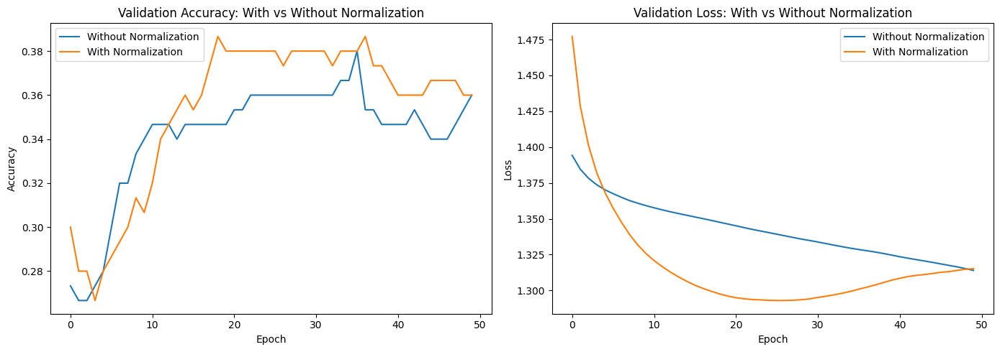

In [2]:
import tensorflow as tf
import random
import numpy as np
import pandas as pd
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt

# Set random seeds for reproducibility
def set_seed(seed=73):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Load and preprocess data
def load_and_preprocess_data(file_path, seed=73, normalize=True):
    set_seed(seed)

    # Load dataset
    df = pd.read_csv(file_path)

    # Separate features and target
    X = df.drop(columns=['custcat'])
    y = df['custcat']

    # Encode target into categorical values
    label_encoder = LabelEncoder()
    y_encoded = label_encoder.fit_transform(y)
    y_categorical = to_categorical(y_encoded)

    # Normalize features if required
    if normalize:
        X = (X - X.mean()) / X.std()

    # Split the dataset
    X_train, X_temp, y_train, y_temp = train_test_split(X, y_categorical, test_size=0.3, random_state=seed, shuffle=True)
    X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=seed, shuffle=True)

    return X_train, X_val, X_test, y_train, y_val, y_test, label_encoder

# Define and compile models
# Define and compile models with learning rate adjustments
def create_model(neurons, layers, use_batch_norm=False):
    model = Sequential()
    model.add(Dense(neurons, activation='relu', input_shape=(X_train.shape[1],)))
    if use_batch_norm:
        model.add(BatchNormalization())
    for _ in range(layers-1):
        model.add(Dense(neurons, activation='relu'))
        if use_batch_norm:
            model.add(BatchNormalization())
    model.add(Dense(4, activation='softmax'))  # Adjusted output layer for 4 classes
    model.compile(optimizer=SGD(learning_rate=0.03), loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Train and evaluate models with and without normalization
print(f"Training model with 5 neurons per hidden layer without normalization...")
model_without_norm = create_model(neurons=5, layers=2)
history_without_norm = model_without_norm.fit(X_train, y_train, epochs=50, batch_size=40, validation_data=(X_val, y_val), verbose=1)
print(f"\nValidation accuracy for model without normalization: {history_without_norm.history['val_accuracy'][-1]:.4f}")

print(f"\nTraining model with 5 neurons per hidden layer with normalization...")
model_with_norm = create_model(neurons=5, layers=2, use_batch_norm=True)
history_with_norm = model_with_norm.fit(X_train, y_train, epochs=50, batch_size=40, validation_data=(X_val, y_val), verbose=1)
print(f"\nValidation accuracy for model with normalization: {history_with_norm.history['val_accuracy'][-1]:.4f}")

# Plot accuracy and loss
plt.figure(figsize=(14, 5))

# Accuracy
plt.subplot(1, 2, 1)
plt.plot(history_without_norm.history['val_accuracy'], label='Without Normalization')
plt.plot(history_with_norm.history['val_accuracy'], label='With Normalization')
plt.title('Validation Accuracy: With vs Without Normalization')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss
plt.subplot(1, 2, 2)
plt.plot(history_without_norm.history['val_loss'], label='Without Normalization')
plt.plot(history_with_norm.history['val_loss'], label='With Normalization')
plt.title('Validation Loss: With vs Without Normalization')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


Training model with 5 neurons per hidden layer without Dropout...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 25ms/step - accuracy: 0.2321 - loss: 1.7022 - val_accuracy: 0.2200 - val_loss: 1.4173
Epoch 2/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.2499 - loss: 1.6251 - val_accuracy: 0.1733 - val_loss: 1.4132
Epoch 3/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2660 - loss: 1.5650 - val_accuracy: 0.1867 - val_loss: 1.4120
Epoch 4/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.2792 - loss: 1.5169 - val_accuracy: 0.2000 - val_loss: 1.4114
Epoch 5/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.2847 - loss: 1.4782 - val_accuracy: 0.2200 - val_loss: 1.4116
Epoch 6/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2948 - loss: 1.4529 - val_accuracy: 0.2533 - val_loss: 1.4117
Epoch 7/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.3049 - loss: 1.4333 - val_accuracy: 0.2933 - val_loss: 1.4111
Epoch 8/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.3145 - loss: 1.4149 - val_accuracy: 0.2933 - val_loss

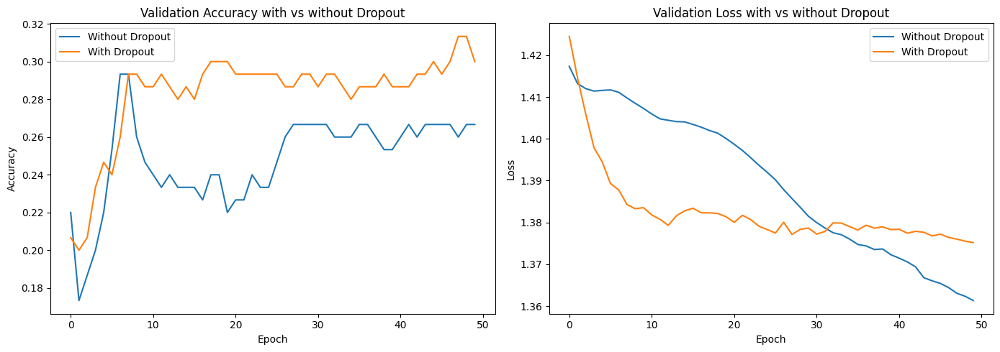


Training and plotting completed successfully.


In [8]:
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, Dropout
from tensorflow.keras.optimizers import SGD
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt

# Set random seeds for reproducibility
np.random.seed(73)
tf.random.set_seed(73)

# Separate features and the target
X = df.drop(columns=['custcat'])
y = df['custcat']

# Encode target into categorical values
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)
y_categorical = to_categorical(y_encoded)

# Normalize the features
scaler = MinMaxScaler()
X_normalized = scaler.fit_transform(X)

# Split the dataset into training, validation, and testing sets
X_train, X_temp, y_train, y_temp = train_test_split(X_normalized, y_categorical, test_size=0.3, random_state=73)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=73)

# Define and compile models with Batch Normalization and Dropout
def create_model(neurons, layers, use_dropout=False, dropout_rate=0.5):
    model = Sequential()
    model.add(Dense(neurons, activation='relu', input_shape=(X_train.shape[1],)))
    model.add(BatchNormalization())  # Batch normalization applied here
    if use_dropout:
        model.add(Dropout(dropout_rate))  # Dropout if specified
    for _ in range(layers - 1):  # Add remaining hidden layers
        model.add(Dense(neurons, activation='relu'))
        model.add(BatchNormalization())  # Batch normalization applied here
        if use_dropout:
            model.add(Dropout(dropout_rate))  # Dropout if specified
    model.add(Dense(4, activation='softmax'))  # Output layer for 4 classes
    model.compile(optimizer=SGD(learning_rate=0.01), loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Train and evaluate models with and without Dropout
neurons = 5  # 5 neurons per layer
layers = 2   # Two hidden layers

print(f"Training model with {neurons} neurons per hidden layer without Dropout...")
model_without_dropout = create_model(neurons, layers)
history_without_dropout = model_without_dropout.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), verbose=1)

print(f"Training model with {neurons} neurons per hidden layer with Dropout...")
model_with_dropout = create_model(neurons, layers, use_dropout=True, dropout_rate=0.5)
history_with_dropout = model_with_dropout.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), verbose=1)

# Plot accuracy and loss
plt.figure(figsize=(14, 5))

# Accuracy
plt.subplot(1, 2, 1)
plt.plot(history_without_dropout.history['val_accuracy'], label='Without Dropout')
plt.plot(history_with_dropout.history['val_accuracy'], label='With Dropout')
plt.title('Validation Accuracy with vs without Dropout')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss
plt.subplot(1, 2, 2)
plt.plot(history_without_dropout.history['val_loss'], label='Without Dropout')
plt.plot(history_with_dropout.history['val_loss'], label='With Dropout')
plt.title('Validation Loss with vs without Dropout')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

print("\nTraining and plotting completed successfully.")


Training model with 5 neurons per hidden layer with Dropout...
Epoch 1/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 27ms/step - accuracy: 0.2807 - loss: 1.8627 - val_accuracy: 0.2000 - val_loss: 1.6339
Epoch 2/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2723 - loss: 1.7748 - val_accuracy: 0.2333 - val_loss: 1.4934
Epoch 3/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2401 - loss: 1.7159 - val_accuracy: 0.2667 - val_loss: 1.4284
Epoch 4/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - accuracy: 0.2092 - loss: 1.7190 - val_accuracy: 0.3133 - val_loss: 1.3878
Epoch 5/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2809 - loss: 1.6118 - val_accuracy: 0.3533 - val_loss: 1.3634
Epoch 6/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2505 - loss: 1.5566 - val_accuracy: 0.3800 - val_loss: 1.3483
Epoch 7/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.2875 - loss: 1.5352 - val_accuracy: 0.3733 - val_loss: 1.3401
Epoch 8/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - a

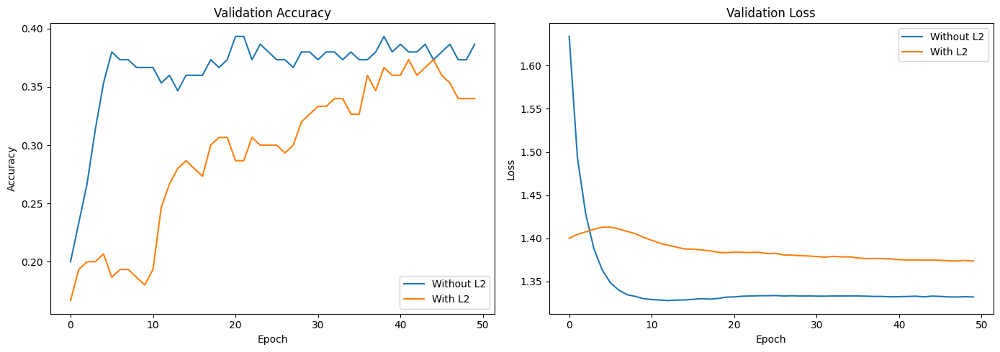


Final Validation Accuracy:
With Dropout: 0.3867
With Dropout + L2-Regularization: 0.3400


In [12]:
from tensorflow.keras.regularizers import l2
np.random.seed(73)
tf.random.set_seed(73)
# Define and compile models with Dropout and L2-Regularization
def create_model_with_l2(neurons, layers, use_dropout=False, dropout_rate=0.5, use_l2=False, l2_rate=0.0001):
    model = Sequential()
    # First layer
    if use_l2:
        model.add(Dense(neurons, activation='relu', input_shape=(X_train.shape[1],), kernel_regularizer=l2(l2_rate)))
    else:
        model.add(Dense(neurons, activation='relu', input_shape=(X_train.shape[1],)))
    model.add(BatchNormalization())
    if use_dropout:
        model.add(Dropout(dropout_rate))

    # Hidden layers
    for _ in range(layers - 1):
        if use_l2:
            model.add(Dense(neurons, activation='relu', kernel_regularizer=l2(l2_rate)))
        else:
            model.add(Dense(neurons, activation='relu'))
        model.add(BatchNormalization())
        if use_dropout:
            model.add(Dropout(dropout_rate))

    # Output layer
    model.add(Dense(4, activation='softmax'))  # Adjusted output layer for 4 classes
    model.compile(optimizer=SGD(learning_rate=0.01), loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Train and evaluate models with Dropout and L2-Regularization
neurons = 5  # 5 neurons per layer
layers = 2   # Two hidden layers

print(f"Training model with {neurons} neurons per hidden layer with Dropout...")
model_with_dropout = create_model_with_l2(neurons, layers, use_dropout=True, dropout_rate=0.5)
history_with_dropout = model_with_dropout.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), verbose=1)

print(f"Training model with {neurons} neurons per hidden layer with Dropout and L2-Regularization...")
model_with_l2 = create_model_with_l2(neurons, layers, use_dropout=True, dropout_rate=0.5, use_l2=True, l2_rate=0.0001)
history_with_l2 = model_with_l2.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), verbose=1)

# Plot accuracy and loss
plt.figure(figsize=(14, 5))

# Accuracy
plt.subplot(1, 2, 1)
plt.plot(history_with_dropout.history['val_accuracy'], label='Without L2')
plt.plot(history_with_l2.history['val_accuracy'], label='With L2')
plt.title('Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss
plt.subplot(1, 2, 2)
plt.plot(history_with_dropout.history['val_loss'], label='Without L2')
plt.plot(history_with_l2.history['val_loss'], label='With L2')
plt.title('Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

# Print final validation accuracy
final_accuracy_with_dropout = history_with_dropout.history['val_accuracy'][-1]
final_accuracy_with_l2 = history_with_l2.history['val_accuracy'][-1]

print("\nFinal Validation Accuracy:")
print(f"With Dropout: {final_accuracy_with_dropout:.4f}")
print(f"With Dropout + L2-Regularization: {final_accuracy_with_l2:.4f}")


In [77]:
pip install torch-adopt



Training model with SGD optimizer...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 4s 55ms/step - accuracy: 0.2575 - loss: 1.7580 - val_accuracy: 0.2867 - val_loss: 1.3700
Epoch 2/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.2688 - loss: 1.6989 - val_accuracy: 0.3000 - val_loss: 1.3630
Epoch 3/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.2318 - loss: 1.6129 - val_accuracy: 0.2933 - val_loss: 1.3598
Epoch 4/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.2815 - loss: 1.6207 - val_accuracy: 0.3000 - val_loss: 1.3543
Epoch 5/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.2822 - loss: 1.5752 - val_accuracy: 0.3200 - val_loss: 1.3516
Epoch 6/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.2699 - loss: 1.5271 - val_accuracy: 0.3400 - val_loss: 1.3476
Epoch 7/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.2909 - loss: 1.5366 - val_accuracy: 0.3333 - val_loss: 1.3444
Epoch 8/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.3059 - loss: 1.4720 - val_accuracy: 0.3333 - val_loss

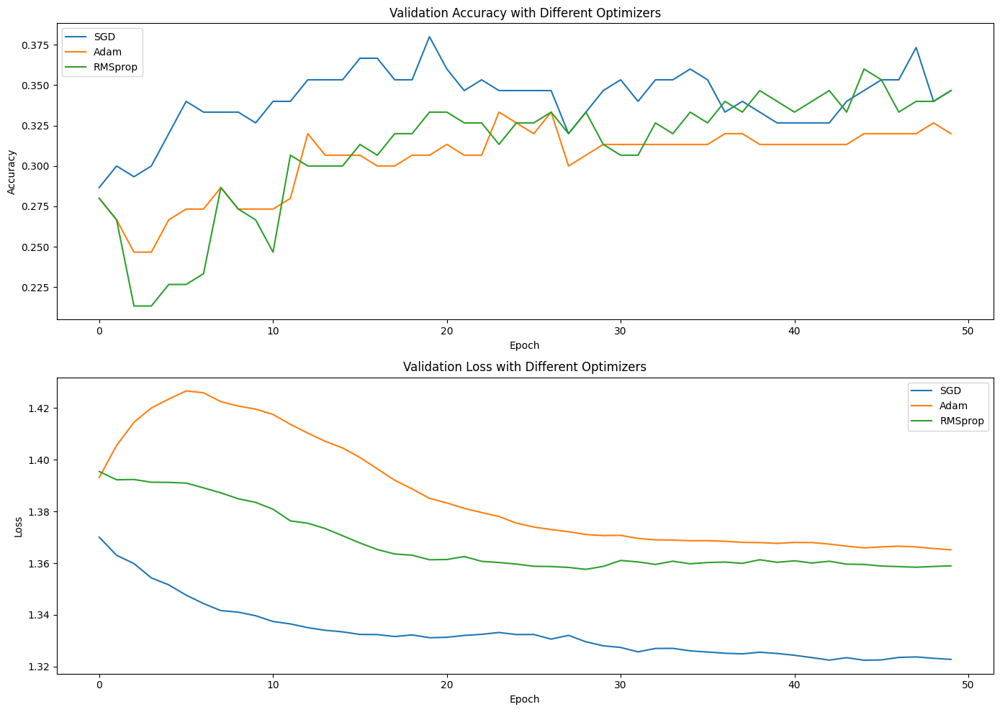


Training and plotting completed successfully.


In [14]:
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, Dropout
from tensorflow.keras.optimizers import SGD, Adam, RMSprop
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.utils import to_categorical
import seaborn as sns
import matplotlib.pyplot as plt
np.random.seed(73)
tf.random.set_seed(73)
# Separate features and the target
X = df.drop(columns=['custcat'])
y = df['custcat']

# Encode target into categorical values
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)
y_categorical = to_categorical(y_encoded)

# Normalize the features
scaler = MinMaxScaler()
X_normalized = scaler.fit_transform(X)

# Split the dataset into training, validation, and testing sets
X_train, X_temp, y_train, y_temp = train_test_split(X_normalized, y_categorical, test_size=0.3, random_state=73)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=73)

# Define and compile model with Dropout
def create_model(neurons, layers, optimizer_name='SGD'):
    model = Sequential([
        Dense(neurons, activation='relu', input_shape=(X_train.shape[1],)),
        BatchNormalization(),
        Dropout(0.5)
    ])
    for _ in range(layers-1):
        model.add(Dense(neurons, activation='relu'))
        model.add(BatchNormalization())
        model.add(Dropout(0.5))
    model.add(Dense(4, activation='softmax'))  # Adjusted output layer for 4 classes

    if optimizer_name == 'SGD':
        optimizer = SGD(learning_rate=0.01)
    elif optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=0.001)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=0.001)

    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Train models with different optimizers
optimizers = ['SGD', 'Adam', 'RMSprop']

neurons = 5
layers = 2
histories = []

for optimizer_name in optimizers:
    print(f"\nTraining model with {optimizer_name} optimizer...")
    model = create_model(neurons, layers, optimizer_name)
    history = model.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), verbose=1)
    histories.append((optimizer_name, history))

# Plot accuracy and loss
plt.figure(figsize=(14, 10))

# Accuracy
plt.subplot(2, 1, 1)
for optimizer_name, history in histories:
    plt.plot(history.history['val_accuracy'], label=optimizer_name)
plt.title('Validation Accuracy with Different Optimizers')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss
plt.subplot(2, 1, 2)
for optimizer_name, history in histories:
    plt.plot(history.history['val_loss'], label=optimizer_name)
plt.title('Validation Loss with Different Optimizers')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

print("\nTraining and plotting completed successfully.")



Training model with SGD optimizer...


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - accuracy: 0.2498 - loss: 2.0736 - val_accuracy: 0.2733 - val_loss: 1.4092
Epoch 2/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.2473 - loss: 1.8226 - val_accuracy: 0.2667 - val_loss: 1.4043
Epoch 3/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2785 - loss: 1.8441 - val_accuracy: 0.2600 - val_loss: 1.4042
Epoch 4/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2276 - loss: 1.7188 - val_accuracy: 0.2733 - val_loss: 1.4068
Epoch 5/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2498 - loss: 1.7071 - val_accuracy: 0.2467 - val_loss: 1.4047
Epoch 6/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2754 - loss: 1.6696 - val_accuracy: 0.2733 - val_loss: 1.4028
Epoch 7/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2784 - loss: 1.6593 - val_accuracy: 0.2667 - val_loss: 1.4000
Epoch 8/50
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.2429 - loss: 1.6192 - val_accuracy: 0.2933 - val_loss

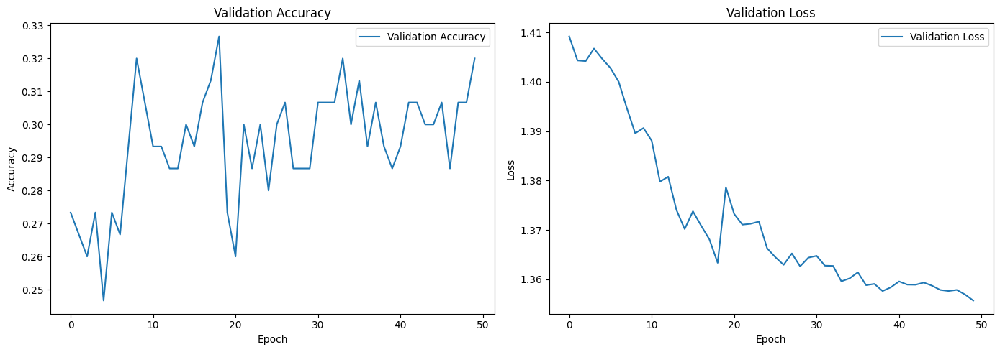


Test accuracy: 0.3533
Test loss: 1.3465

10 test data samples with predicted values:
Sample 1: True value: 2 Predicted value: 3
Sample 2: True value: 0 Predicted value: 3
Sample 3: True value: 1 Predicted value: 3
Sample 4: True value: 0 Predicted value: 3
Sample 5: True value: 1 Predicted value: 0
Sample 6: True value: 3 Predicted value: 3
Sample 7: True value: 1 Predicted value: 0
Sample 8: True value: 3 Predicted value: 0
Sample 9: True value: 0 Predicted value: 0
Sample 10: True value: 3 Predicted value: 3

Training, evaluation, and reporting completed successfully.


In [17]:
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, Dropout
from tensorflow.keras.optimizers import SGD
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.utils import to_categorical
import seaborn as sns
import matplotlib.pyplot as plt

np.random.seed(73)
tf.random.set_seed(73)

# Separate features and the target
X = df.drop(columns=['custcat'])
y = df['custcat']

# Encode target into categorical values
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)
y_categorical = to_categorical(y_encoded)

# Normalize the features
scaler = MinMaxScaler()
X_normalized = scaler.fit_transform(X)

# Split the dataset into training, validation, and testing sets
X_train, X_temp, y_train, y_temp = train_test_split(X_normalized, y_categorical, test_size=0.3, random_state=73)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=73)

# Define and compile model with Dropout
def create_model(neurons, layers, optimizer_name='SGD'):
    model = Sequential([
        Dense(neurons, activation='relu', input_shape=(X_train.shape[1],)),
        BatchNormalization(),
        Dropout(0.5)
    ])
    for _ in range(layers-1):
        model.add(Dense(neurons, activation='relu'))
        model.add(BatchNormalization())
        model.add(Dropout(0.5))
    model.add(Dense(4, activation='softmax'))  # Adjusted output layer for 4 classes

    optimizer = SGD(learning_rate=0.01)
    model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
    return model

neurons = 5
layers = 2

# Train the model with SGD optimizer
print(f"\nTraining model with SGD optimizer...")
model = create_model(neurons, layers, 'SGD')
history = model.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), verbose=1)

# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=1)
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true_classes = np.argmax(y_test, axis=1)

# Plot accuracy and loss
plt.figure(figsize=(14, 5))

# Accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss
plt.subplot(1, 2, 2)
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

# Print test accuracy and loss
print(f"\nTest accuracy: {test_accuracy:.4f}")
print(f"Test loss: {test_loss:.4f}")

# Print 10 test data samples with predictions
print("\n10 test data samples with predicted values:")
for i in range(10):
    print(f"Sample {i+1}: True value: {y_true_classes[i]} Predicted value: {y_pred_classes[i]}")

print("\nTraining, evaluation, and reporting completed successfully.")



Training model: Neurons=64, Layers=2, Optimizer=SGD, BatchNorm=True, Dropout=True, DropoutRate=0.5, L2=True, L2Reg=0.01


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Validation accuracy: 0.4133

Training model: Neurons=64, Layers=2, Optimizer=SGD, BatchNorm=True, Dropout=True, DropoutRate=0.5, L2=False, L2Reg=0.01
Validation accuracy: 0.4000

Training model: Neurons=64, Layers=2, Optimizer=SGD, BatchNorm=True, Dropout=False, DropoutRate=0.5, L2=True, L2Reg=0.01
Validation accuracy: 0.3800

Training model: Neurons=64, Layers=2, Optimizer=SGD, BatchNorm=True, Dropout=False, DropoutRate=0.5, L2=False, L2Reg=0.01
Validation accuracy: 0.4133

Training model: Neurons=64, Layers=2, Optimizer=SGD, BatchNorm=False, Dropout=True, DropoutRate=0.5, L2=True, L2Reg=0.01
Validation accuracy: 0.4000

Training model: Neurons=64, Layers=2, Optimizer=SGD, BatchNorm=False, Dropout=True, DropoutRate=0.5, L2=False, L2Reg=0.01
Validation accuracy: 0.3867

Training model: Neurons=64, Layers=2, Optimizer=SGD, BatchNorm=False, Dropout=False, DropoutRate=0.5, L2=True, L2Reg=0.01
Validation accuracy: 0.4133

Training model: Neurons=64, Layers=2, Optimizer=SGD, BatchNorm=False

1/5 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step

5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


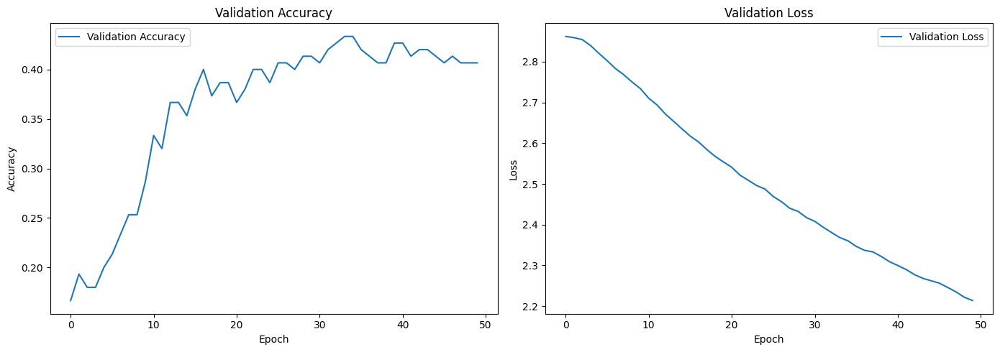


Test accuracy: 0.3933
Test loss: 2.2060

10 test data samples with predicted values:
Sample 1: True value: 2 Predicted value: 3
Sample 2: True value: 0 Predicted value: 3
Sample 3: True value: 1 Predicted value: 2
Sample 4: True value: 0 Predicted value: 3
Sample 5: True value: 1 Predicted value: 2
Sample 6: True value: 3 Predicted value: 3
Sample 7: True value: 1 Predicted value: 2
Sample 8: True value: 3 Predicted value: 2
Sample 9: True value: 0 Predicted value: 2
Sample 10: True value: 3 Predicted value: 3

Training, evaluation, and reporting completed successfully.


In [21]:
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, Dropout
from tensorflow.keras.optimizers import SGD, Adam, RMSprop
from tensorflow.keras.regularizers import L2
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt

np.random.seed(73)
tf.random.set_seed(73)

# Load dataset
df = pd.read_csv("/content/telecust1000t/teleCust1000t.csv")

# Separate features and the target
X = df.drop(columns=['custcat'])
y = df['custcat']

# Encode target into categorical values
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)
y_categorical = to_categorical(y_encoded)

# Normalize the features
scaler = MinMaxScaler()
X_normalized = scaler.fit_transform(X)

# Split the dataset into training, validation, and testing sets
X_train, X_temp, y_train, y_temp = train_test_split(X_normalized, y_categorical, test_size=0.3, random_state=73)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=73)

# Define the model with different configurations
def create_model(neurons, layers, use_batch_norm, use_dropout, dropout_rate, use_l2, l2_reg):
    model = Sequential()

    for i in range(layers):
        if i == 0:
            model.add(Dense(neurons, activation='relu', input_shape=(X_train.shape[1],), kernel_regularizer=L2(l2_reg) if use_l2 else None))
        else:
            model.add(Dense(neurons, activation='relu', kernel_regularizer=L2(l2_reg) if use_l2 else None))

        if use_batch_norm:
            model.add(BatchNormalization())
        if use_dropout:
            model.add(Dropout(dropout_rate))

    model.add(Dense(4, activation='softmax'))

    return model

# Define neurons, layers, configurations to test
neurons_lst = [64, 128]
layers_lst = [2, 3]
optimizers_lst = ['SGD', 'Adam', 'RMSprop']
use_batch_norm_lst = [True, False]
use_dropout_lst = [True, False]
dropout_rate_lst = [0.5]
use_l2_lst = [True, False]
l2_reg_lst = [0.01]

best_accuracy = 0
best_model_config = None

# Train models with different configurations
for neurons in neurons_lst:
    for layers in layers_lst:
        for optimizer_name in optimizers_lst:
            for use_batch_norm in use_batch_norm_lst:
                for use_dropout in use_dropout_lst:
                    for dropout_rate in dropout_rate_lst:
                        for use_l2 in use_l2_lst:
                            for l2_reg in l2_reg_lst:
                                print(f"\nTraining model: Neurons={neurons}, Layers={layers}, Optimizer={optimizer_name}, BatchNorm={use_batch_norm}, Dropout={use_dropout}, DropoutRate={dropout_rate}, L2={use_l2}, L2Reg={l2_reg}")
                                model = create_model(neurons, layers, use_batch_norm, use_dropout, dropout_rate, use_l2, l2_reg)

                                # Compile the model with the specified optimizer
                                if optimizer_name == 'SGD':
                                    optimizer = SGD(learning_rate=0.01)
                                elif optimizer_name == 'Adam':
                                    optimizer = Adam(learning_rate=0.001)
                                elif optimizer_name == 'RMSprop':
                                    optimizer = RMSprop(learning_rate=0.001)

                                model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

                                history = model.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), verbose=0)

                                val_accuracy = history.history['val_accuracy'][-1]
                                print(f"Validation accuracy: {val_accuracy:.4f}")

                                if val_accuracy > best_accuracy:
                                    best_accuracy = val_accuracy
                                    best_model_config = {
                                        'neurons': neurons,
                                        'layers': layers,
                                        'optimizer_name': optimizer_name,
                                        'use_batch_norm': use_batch_norm,
                                        'use_dropout': use_dropout,
                                        'dropout_rate': dropout_rate,
                                        'use_l2': use_l2,
                                        'l2_reg': l2_reg
                                    }

print("\nBest model configuration:")
print(best_model_config)
print(f"Best validation accuracy: {best_accuracy:.4f}")

# Train the best model configuration on the complete dataset
best_model = create_model(
    best_model_config['neurons'],
    best_model_config['layers'],
    best_model_config['use_batch_norm'],
    best_model_config['use_dropout'],
    best_model_config['dropout_rate'],
    best_model_config['use_l2'],
    best_model_config['l2_reg']
)

optimizer_name = best_model_config['optimizer_name']

if optimizer_name == 'SGD':
    optimizer = SGD(learning_rate=0.01)
elif optimizer_name == 'Adam':
    optimizer = Adam(learning_rate=0.001)
elif optimizer_name == 'RMSprop':
    optimizer = RMSprop(learning_rate=0.001)

best_model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
history = best_model.fit(X_train, y_train, epochs=50, validation_data=(X_val, y_val), verbose=1)

# Evaluate the best model on the test data
test_loss, test_accuracy = best_model.evaluate(X_test, y_test, verbose=1)
y_pred = best_model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true_classes = np.argmax(y_test, axis=1)

# Plot accuracy and loss
plt.figure(figsize=(14, 5))

# Accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss
plt.subplot(1, 2, 2)
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

# Print test accuracy and loss
print(f"\nTest accuracy: {test_accuracy:.4f}")
print(f"Test loss: {test_loss:.4f}")

# Print 10 test data samples with predictions
print("\n10 test data samples with predicted values:")
for i in range(10):
    print(f"Sample {i+1}: True value: {y_true_classes[i]} Predicted value: {y_pred_classes[i]}")

print("\nTraining, evaluation, and reporting completed successfully.")


**Quest 3 part 2 (Noise Level)**

In [2]:
!pip install --upgrade --no-cache-dir gdown
!gdown 1QTi7dJtNAfFR5mG0rd8K3ZGvEIfSn_DS
!unzip PersianData.zip

Downloading...
From: https://drive.google.com/uc?id=1QTi7dJtNAfFR5mG0rd8K3ZGvEIfSn_DS
To: /content/PersianData.zip
100% 7.46k/7.46k [00:00<00:00, 26.8MB/s]
Archive:  PersianData.zip
  inflating: 1.jpg                   
  inflating: 2.jpg                   
  inflating: 3.jpg                   
  inflating: 4.jpg                   
  inflating: 5.jpg                   


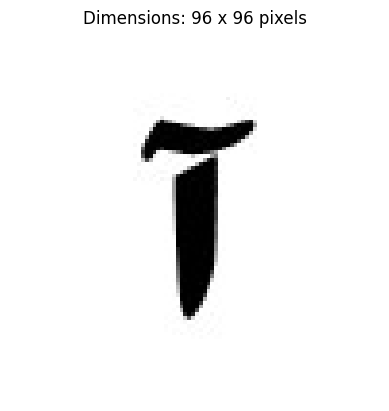

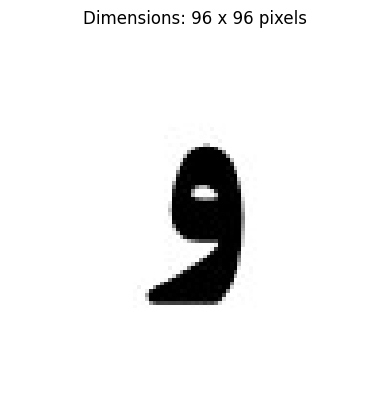

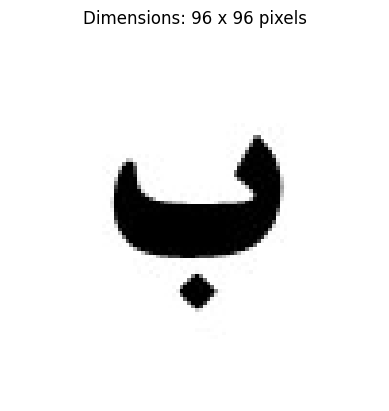

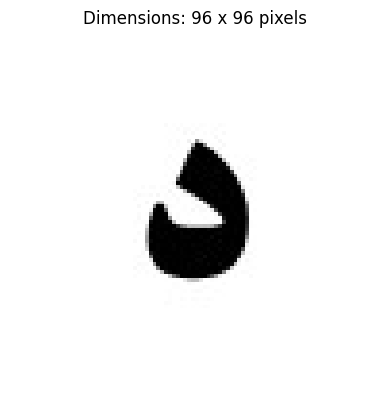

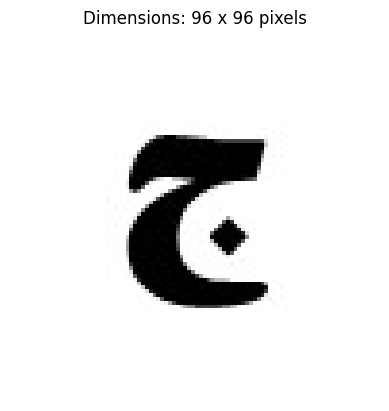

In [3]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

# Assuming the images are in the current directory and named with a ".jpg" extension
image_paths = glob.glob('*.jpg')

# Display each image with its dimensions
for img_path in image_paths:
    img = mpimg.imread(img_path)
    height, width, _ = img.shape

    plt.figure()
    plt.imshow(img)
    plt.axis('off')  # Hide the axes
    plt.title(f'Dimensions: {width} x {height} pixels')
    plt.show()


**Image -> Binary**

In [23]:
from PIL import Image, ImageDraw
import numpy as np
import random
import matplotlib.pyplot as plt
# Your function to convert images to binary
def convertImageToBinary(path):
    image = Image.open(path)
    draw = ImageDraw.Draw(image)
    width, height = image.size
    pix = image.load()
    factor = 100
    binary_representation = []

    for i in range(width):
        for j in range(height):
            red, green, blue = pix[i, j]
            total_intensity = red + green + blue

            if total_intensity > (((255 + factor) // 2) * 3):
                red, green, blue = 255, 255, 255
                binary_representation.append(-1)
            else:
                red, green, blue = 0, 0, 0
                binary_representation.append(1)

            draw.point((i, j), (red, green, blue))

    del draw  # Clean up drawing tool
    return binary_representation



**Image + Noise**

In [24]:
# Your function to add black-and-white noise to images and save as file
def getNoisyBinaryImage(input_path, output_path, noise_factor):
    """
    Add noise to an image and save it as a new file.

    Args:
        input_path (str): The file path to the input image.
        output_path (str): The file path to save the noisy image.
        noise_factor (int): Factor to determine the amount of noise.
    """
    # Open the input image.
    image = Image.open(input_path)

    # Create a drawing tool for manipulating the image.
    draw = ImageDraw.Draw(image)

    # Determine the image's width and height in pixels.
    width = image.size[0]
    height = image.size[1]

    # Load pixel values for the image.
    pix = image.load()

    # Loop through all pixels in the image.
    for i in range(width):
        for j in range(height):
            if random.random() < noise_factor / 100:  # Adjust this line to add reasonable noise
                if random.random() > 0.5:
                    color = (255, 255, 255)  # White pixel
                else:
                    color = (0, 0, 0)  # Black pixel
                draw.point((i, j), color)

    # Save the noisy image as a file.
    image.save(output_path, "JPEG")

    # Clean up the drawing tool.
    del draw

def generateNoisyImages(noise_factor):
    # List of image file paths
    image_paths = [f"{i}.jpg" for i in range(1, 6)]

    for i, image_path in enumerate(image_paths, start=1):
        noisy_image_path = f"noisy{i}.jpg"
        getNoisyBinaryImage(image_path, noisy_image_path, noise_factor)
        print(f"Noisy image for {image_path} generated and saved as {noisy_image_path}")


**Model Defining**

Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


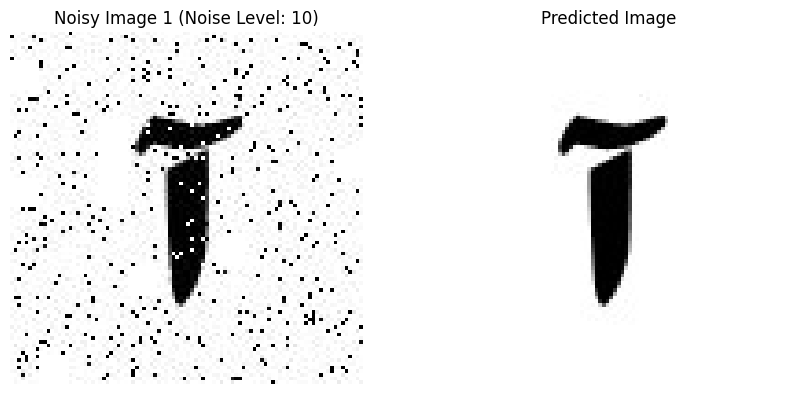

Given Image: noisy1.jpg, Predicted Image Index: 1


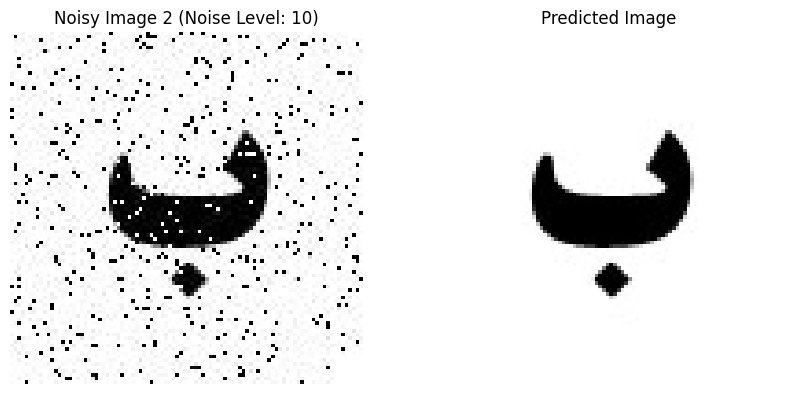

Given Image: noisy2.jpg, Predicted Image Index: 2


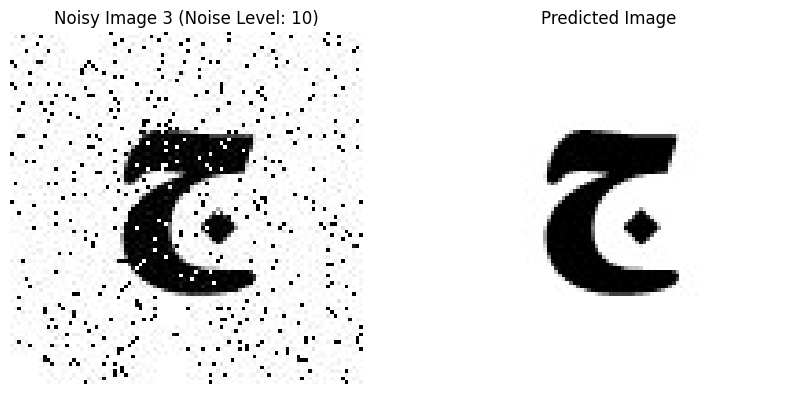

Given Image: noisy3.jpg, Predicted Image Index: 3


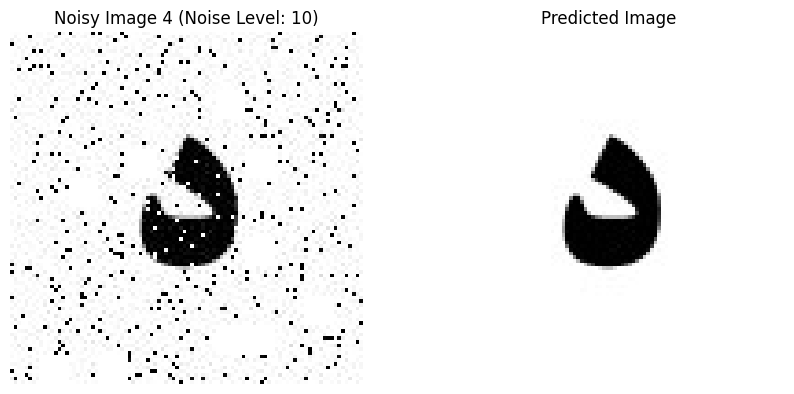

Given Image: noisy4.jpg, Predicted Image Index: 4


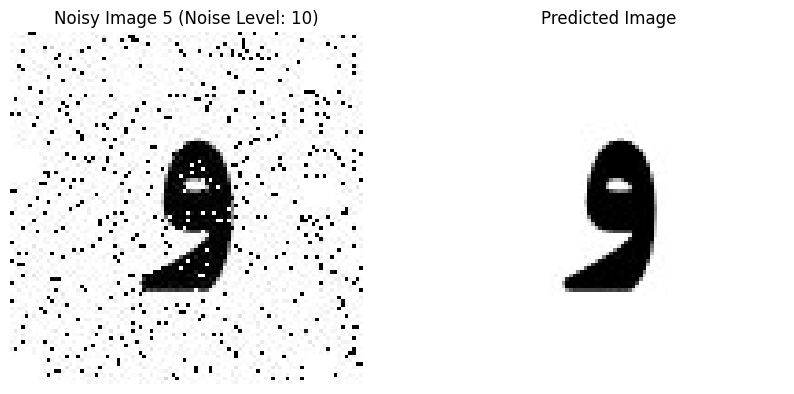

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


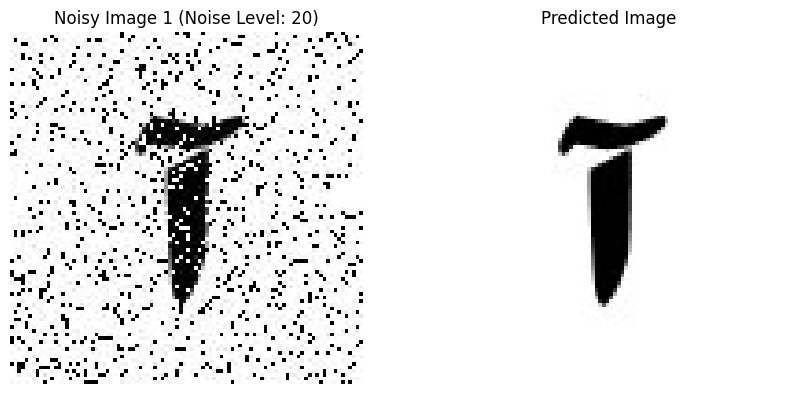

Given Image: noisy1.jpg, Predicted Image Index: 1


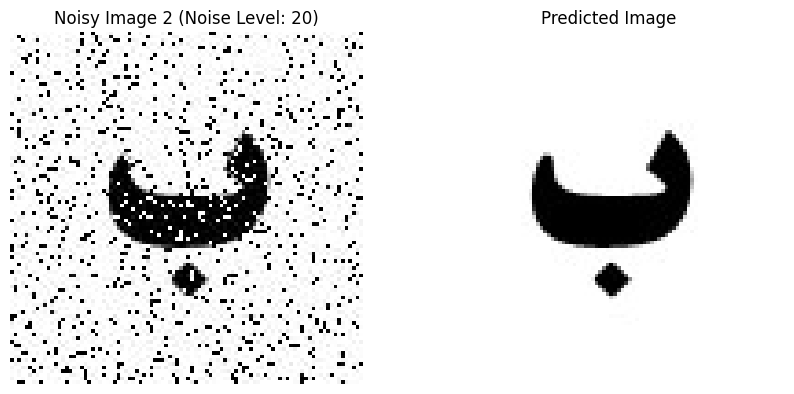

Given Image: noisy2.jpg, Predicted Image Index: 2


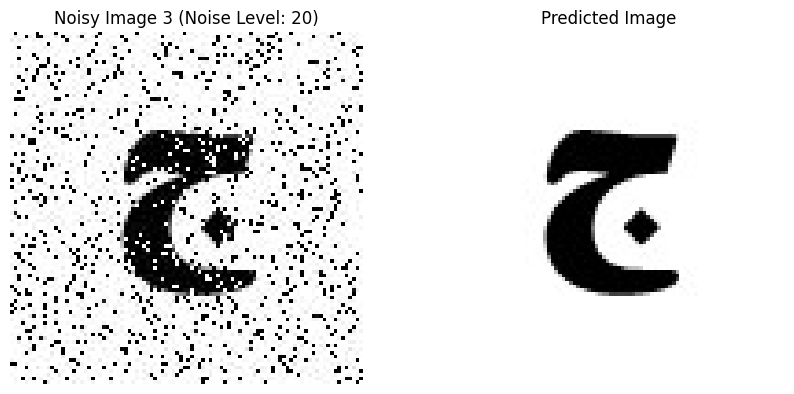

Given Image: noisy3.jpg, Predicted Image Index: 3


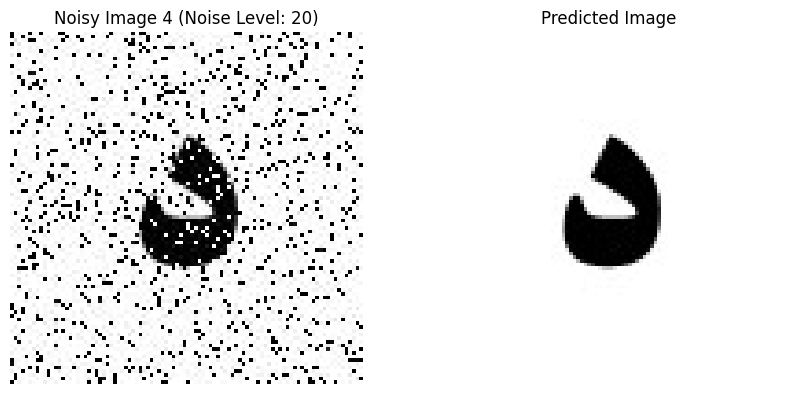

Given Image: noisy4.jpg, Predicted Image Index: 4


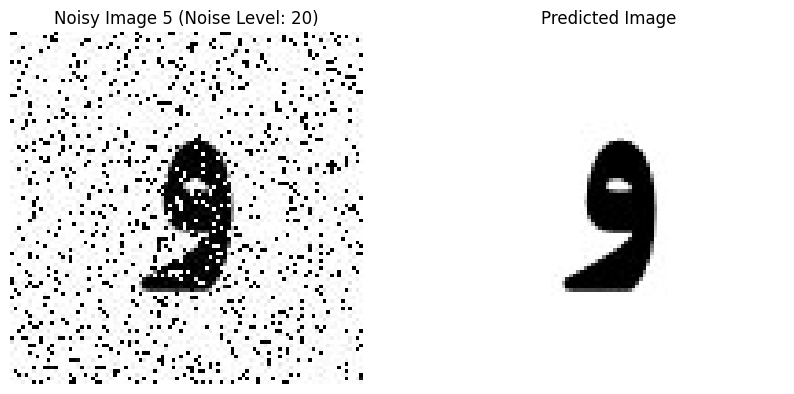

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


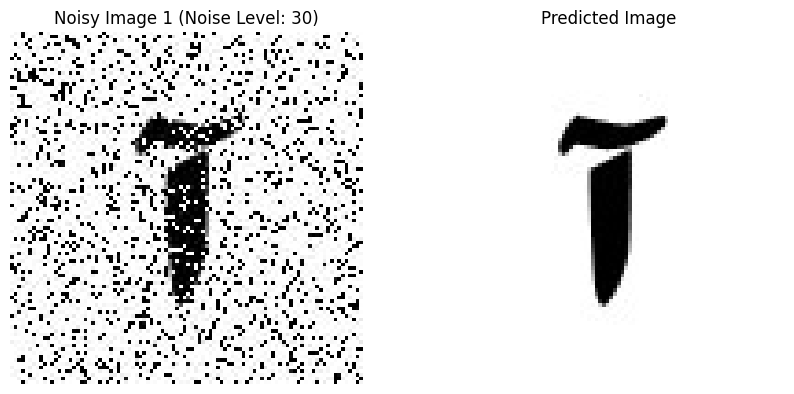

Given Image: noisy1.jpg, Predicted Image Index: 1


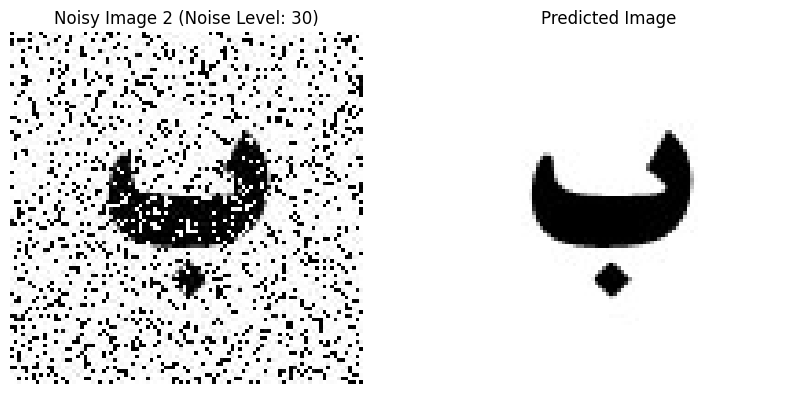

Given Image: noisy2.jpg, Predicted Image Index: 2


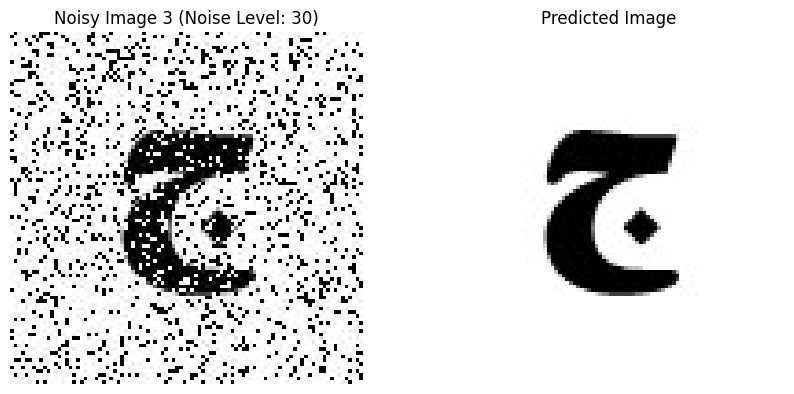

Given Image: noisy3.jpg, Predicted Image Index: 3


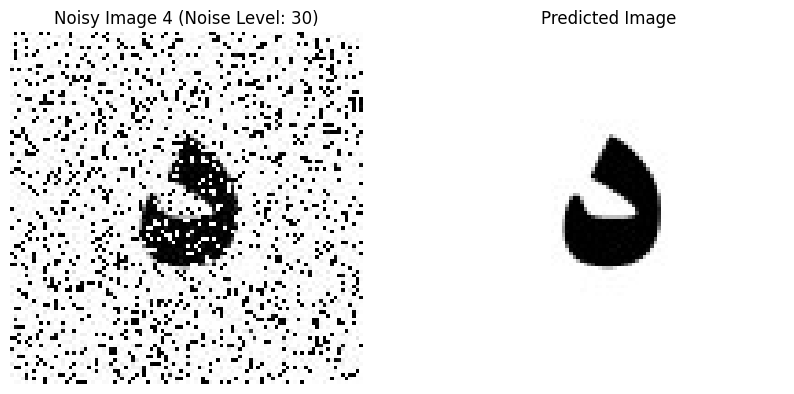

Given Image: noisy4.jpg, Predicted Image Index: 4


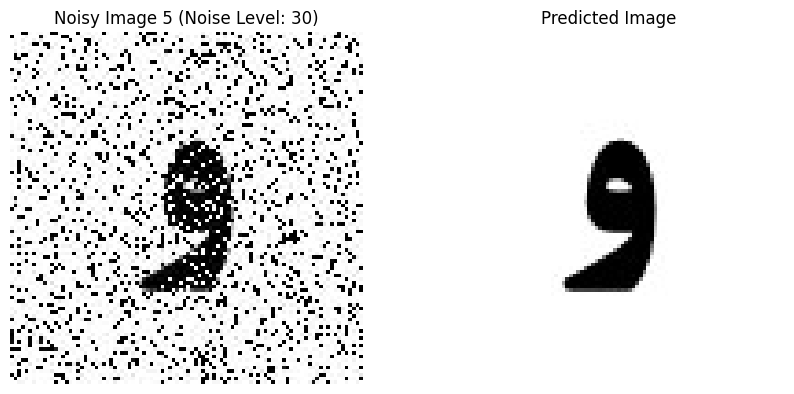

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


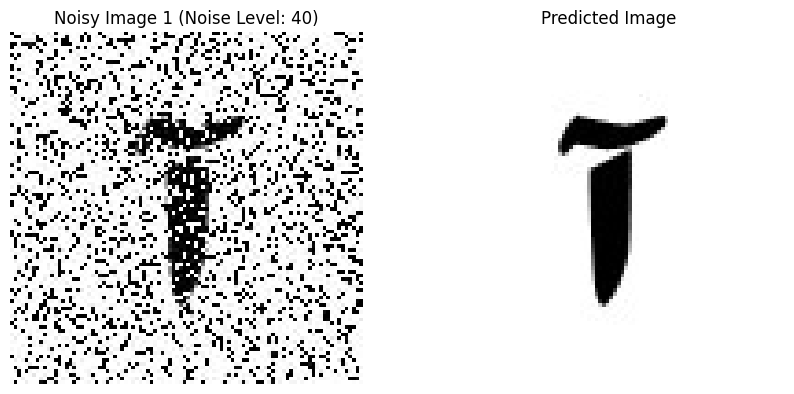

Given Image: noisy1.jpg, Predicted Image Index: 1


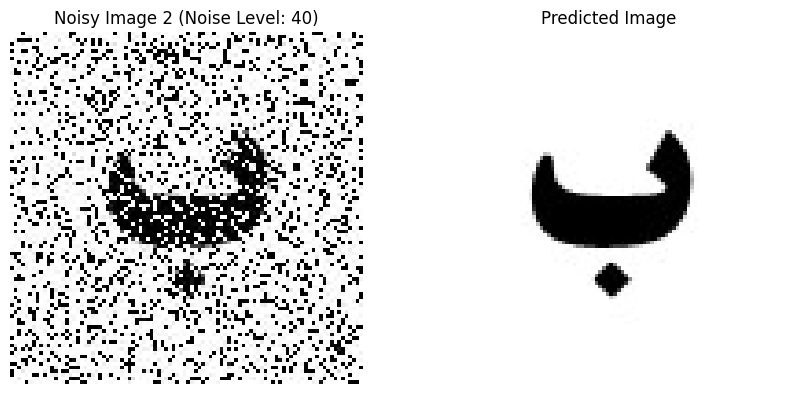

Given Image: noisy2.jpg, Predicted Image Index: 2


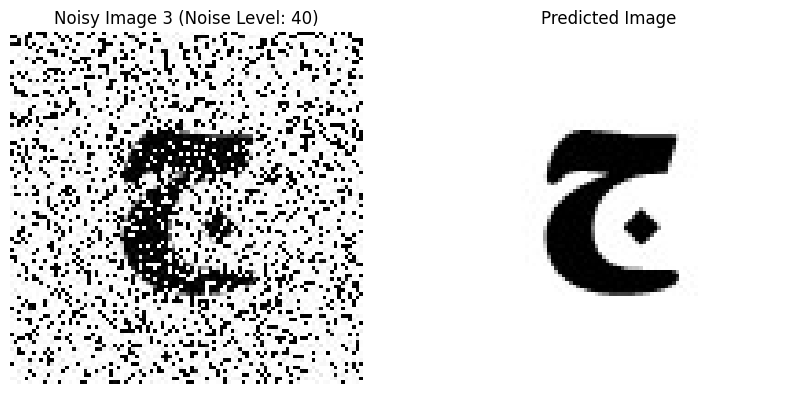

Given Image: noisy3.jpg, Predicted Image Index: 3


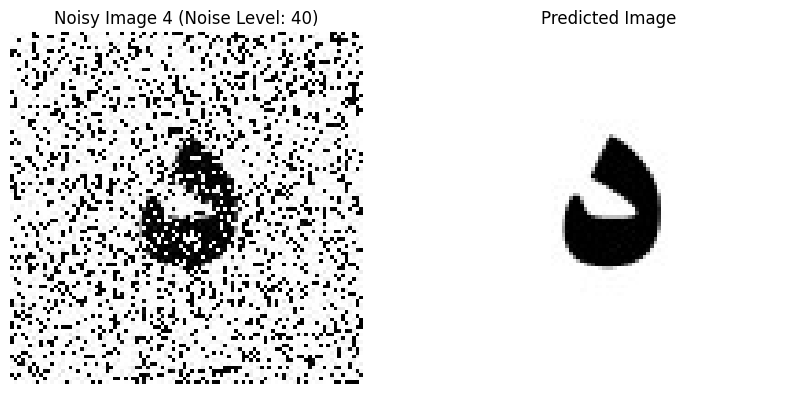

Given Image: noisy4.jpg, Predicted Image Index: 4


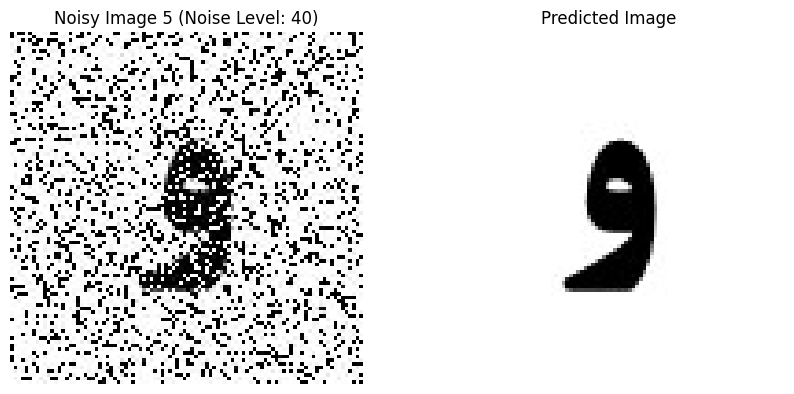

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


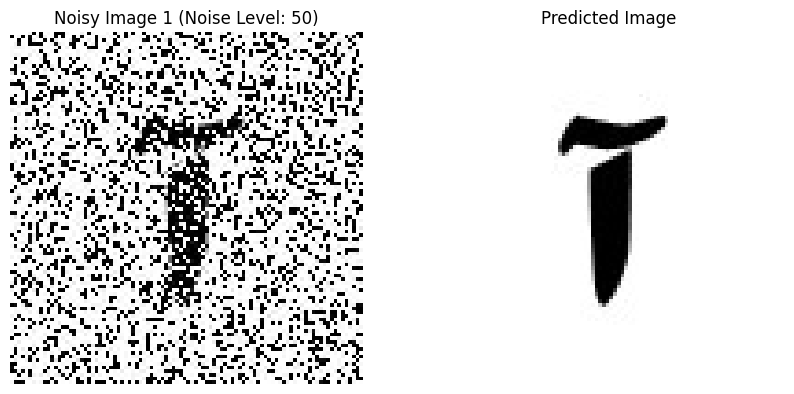

Given Image: noisy1.jpg, Predicted Image Index: 1


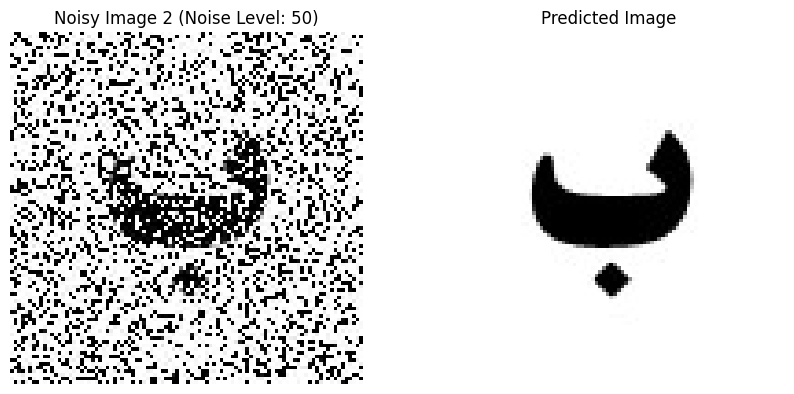

Given Image: noisy2.jpg, Predicted Image Index: 2


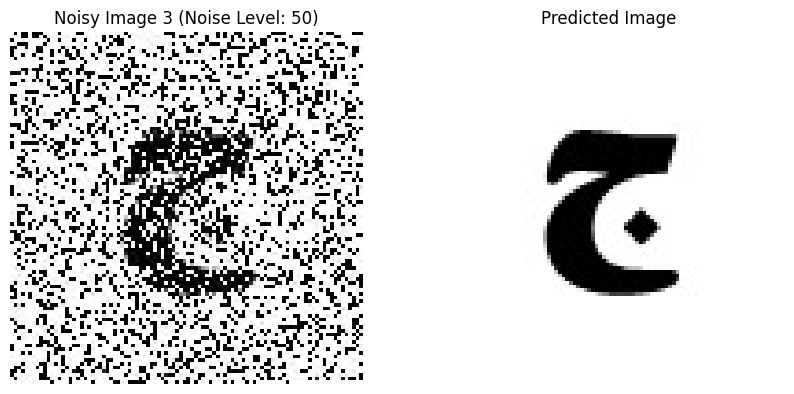

Given Image: noisy3.jpg, Predicted Image Index: 3


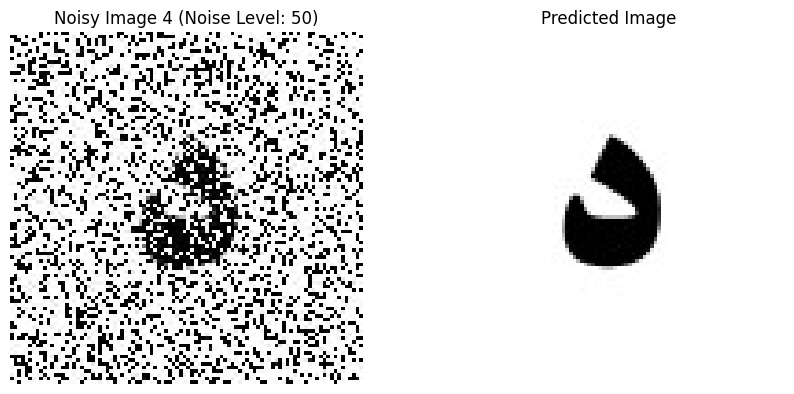

Given Image: noisy4.jpg, Predicted Image Index: 4


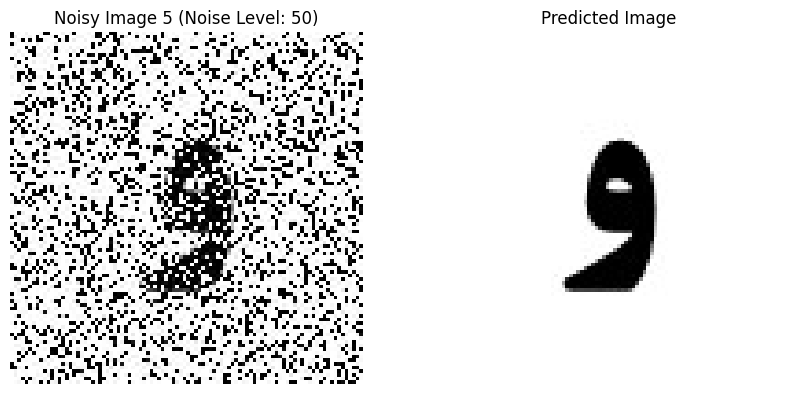

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


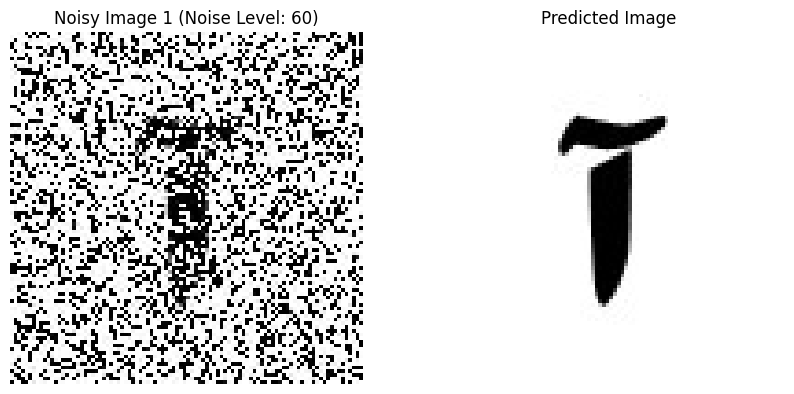

Given Image: noisy1.jpg, Predicted Image Index: 1


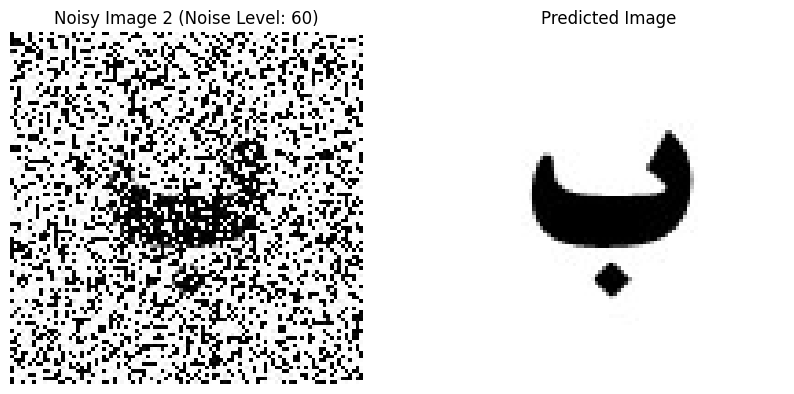

Given Image: noisy2.jpg, Predicted Image Index: 2


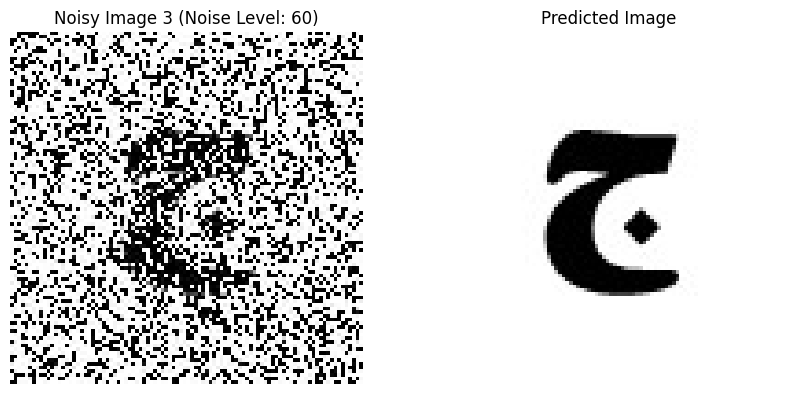

Given Image: noisy3.jpg, Predicted Image Index: 3


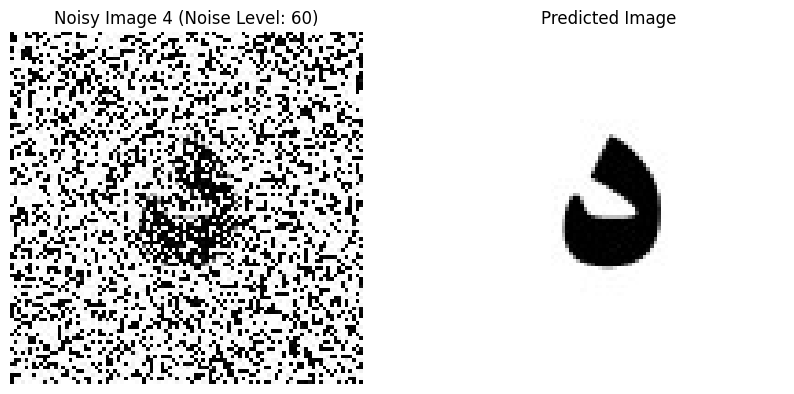

Given Image: noisy4.jpg, Predicted Image Index: 4


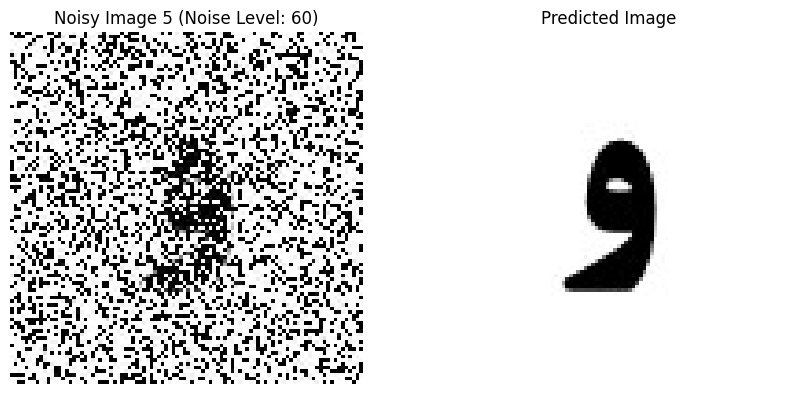

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


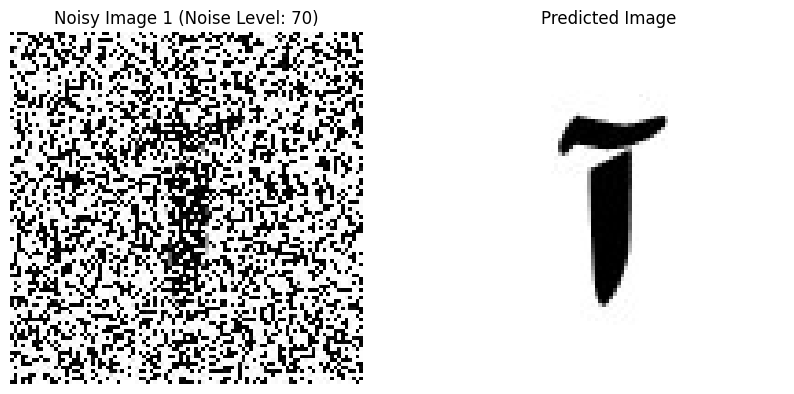

Given Image: noisy1.jpg, Predicted Image Index: 1


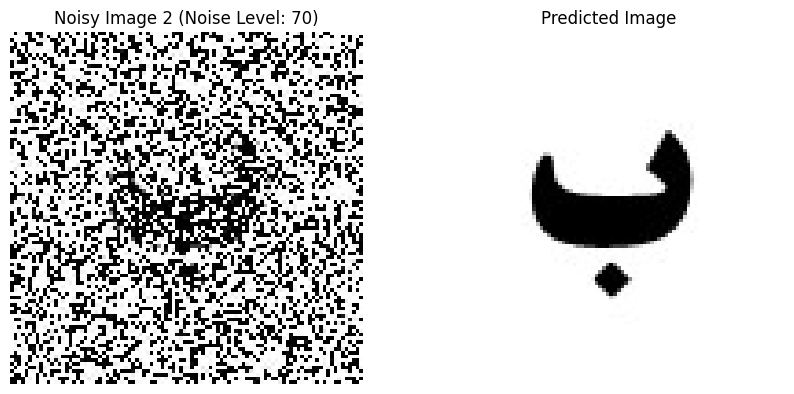

Given Image: noisy2.jpg, Predicted Image Index: 2


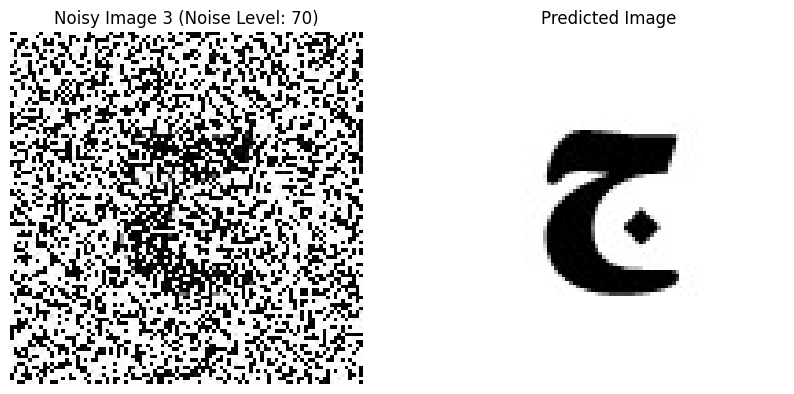

Given Image: noisy3.jpg, Predicted Image Index: 3


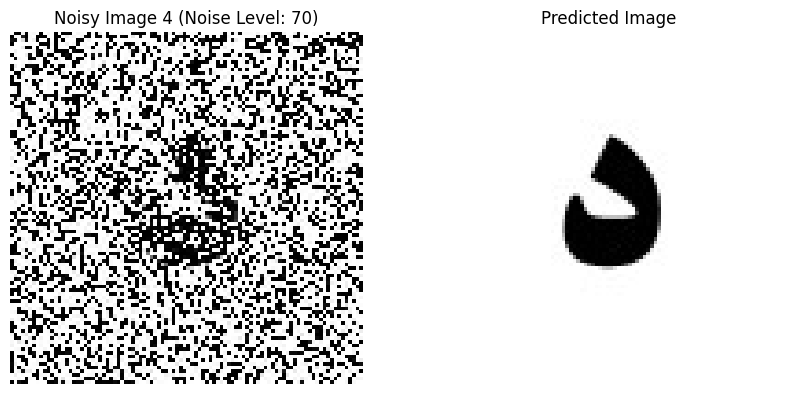

Given Image: noisy4.jpg, Predicted Image Index: 4


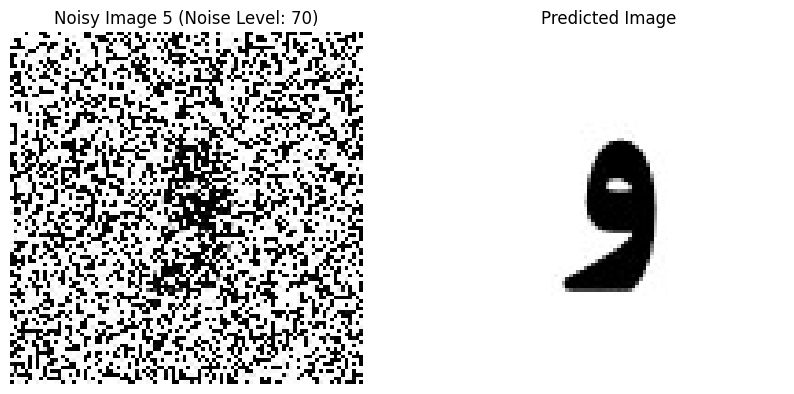

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


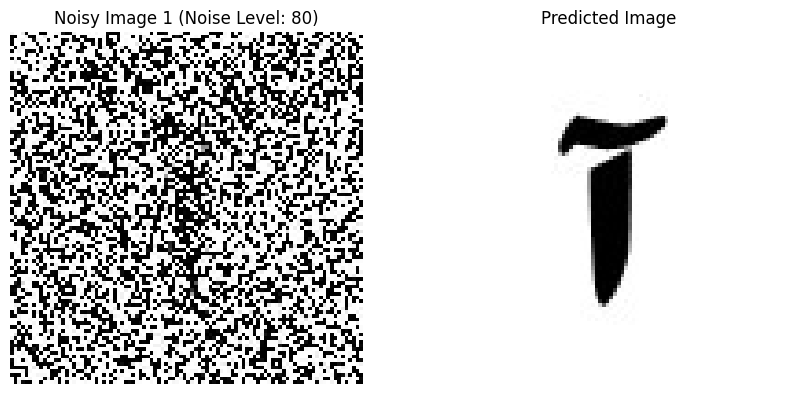

Given Image: noisy1.jpg, Predicted Image Index: 1


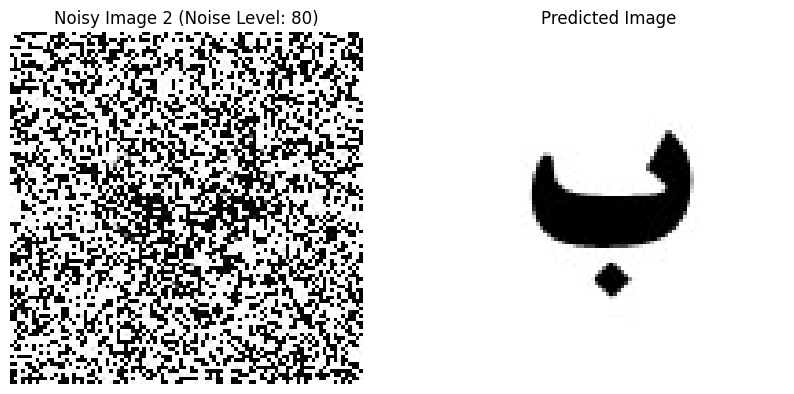

Given Image: noisy2.jpg, Predicted Image Index: 2


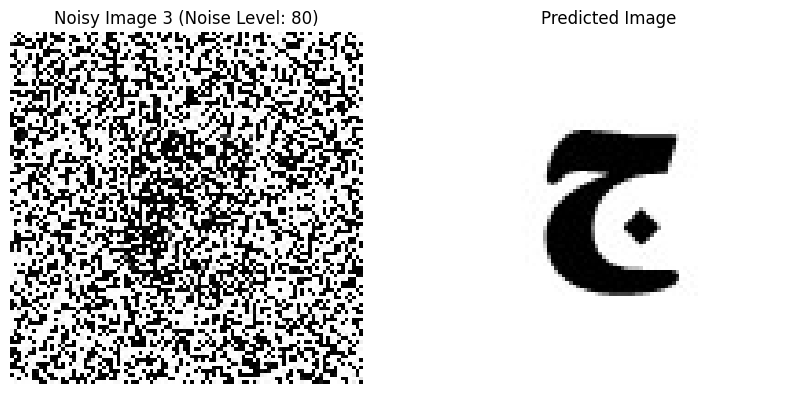

Given Image: noisy3.jpg, Predicted Image Index: 3


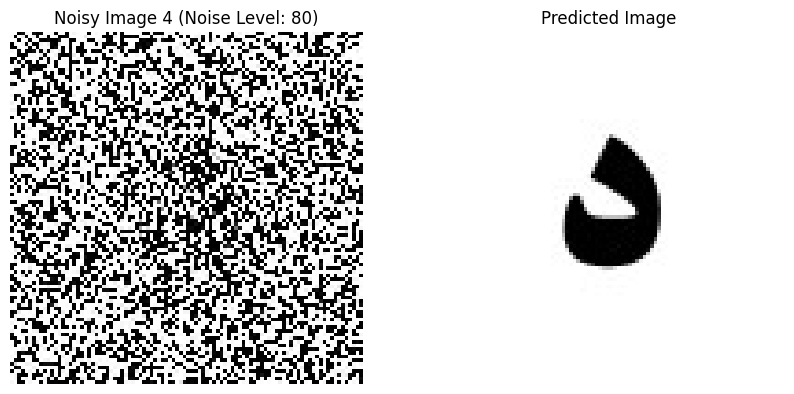

Given Image: noisy4.jpg, Predicted Image Index: 4


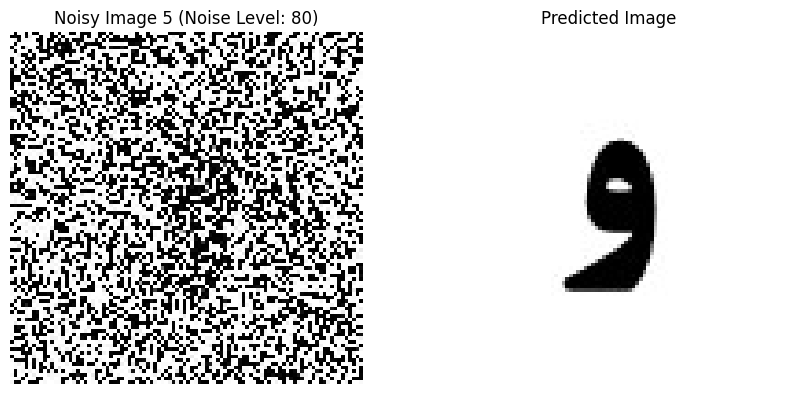

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


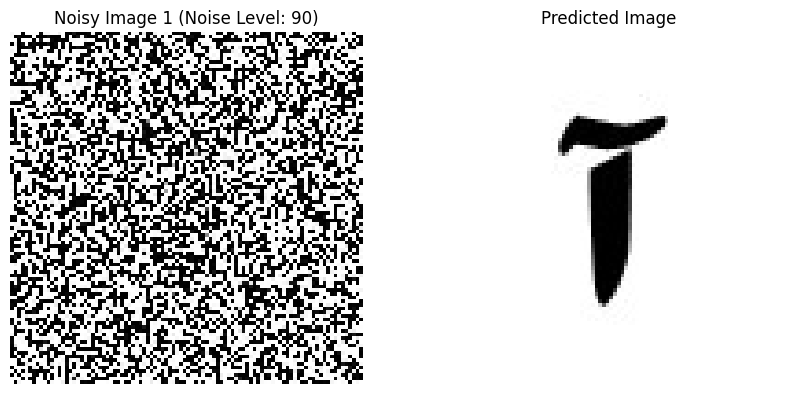

Given Image: noisy1.jpg, Predicted Image Index: 1


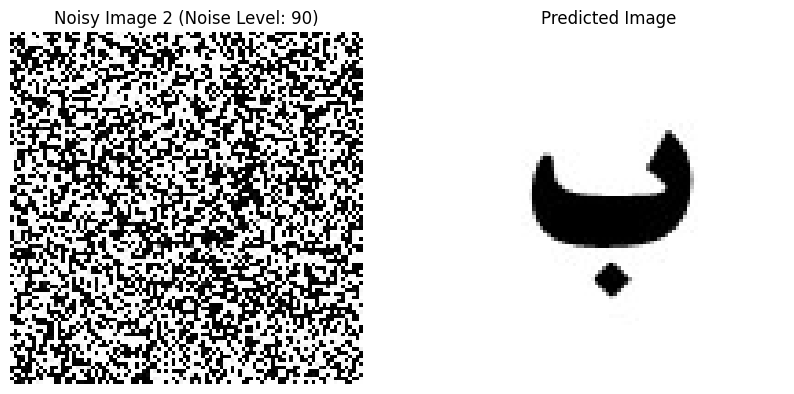

Given Image: noisy2.jpg, Predicted Image Index: 2


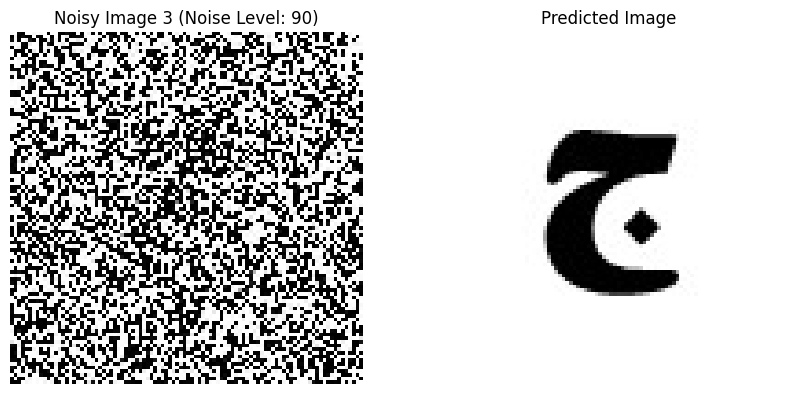

Given Image: noisy3.jpg, Predicted Image Index: 3


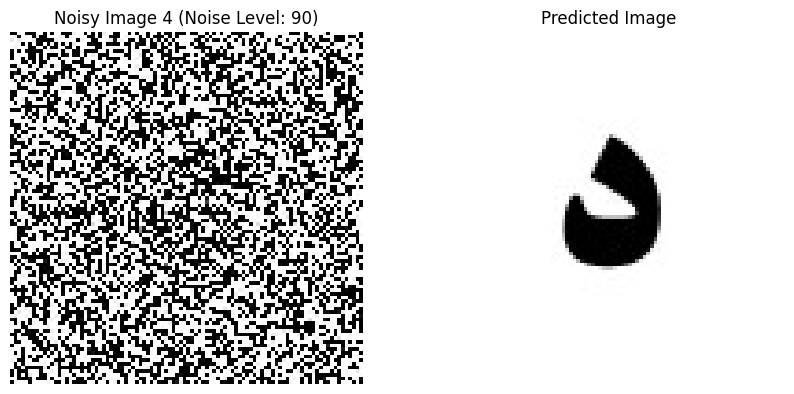

Given Image: noisy4.jpg, Predicted Image Index: 4


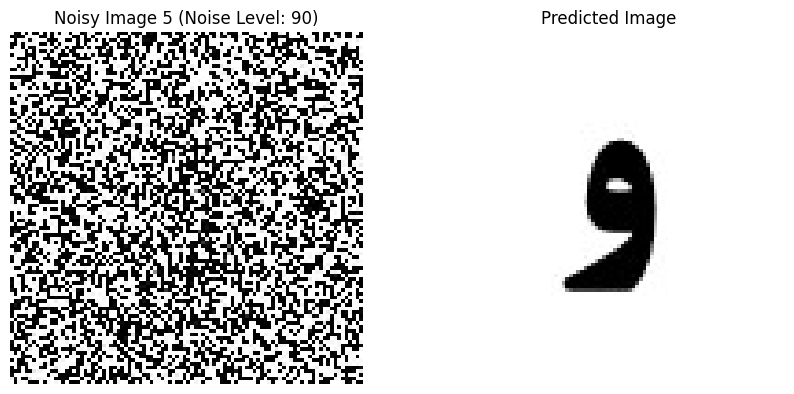

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


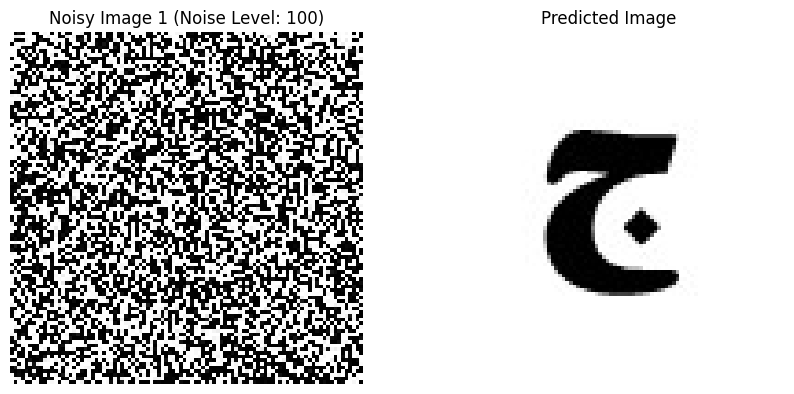

Given Image: noisy1.jpg, Predicted Image Index: 3
Prediction error at noise level 100 for image 1
The image was image 1 but the network predicted image 3
The highest noise level where the network was still accurate: 90


In [25]:

# Define the Hamming Network class
class HammingNetwork:
    def __init__(self, num_neurons):
        self.num_neurons = num_neurons
        self.weights = None
        self.bias = None

    def train(self, inputs):
        self.weights = np.array(inputs)
        self.bias = np.ones(self.num_neurons) * 0.5 * len(inputs[0]) * 3

    def predict(self, input_image):
        product = np.dot(self.weights, input_image)
        stored = product - self.bias
        return np.argmax(stored)

# Function to display images side-by-side for comparison
def display_images(noisy_image_pil, predicted_image_pil, noise_factor, index):
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(noisy_image_pil)
    plt.title(f'Noisy Image {index+1} (Noise Level: {noise_factor})')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(predicted_image_pil)
    plt.title(f'Predicted Image')
    plt.axis('off')

    plt.show()

# Paths to original images
image_paths = [f"{i}.jpg" for i in range(1, 6)]

# Initialize and train the Hamming Network using clean images
network = HammingNetwork(num_neurons=len(image_paths))
training_data = [convertImageToBinary(path) for path in image_paths]
network.train(training_data)

# Initial noise factor
noise_factor = 10  # Start with a smaller noise factor

# Test with increasing noisy images, show both images until the first incorrect prediction
last_correct_noise_level = 0

while True:
    correct_predictions = 0

    generateNoisyImages(noise_factor)  # Generate noisy images with the current noise factor
    noisy_image_paths = [f"noisy{i}.jpg" for i in range(1, 6)]

    for i, path in enumerate(noisy_image_paths):
        noisy_image = np.array(convertImageToBinary(path)).flatten()
        prediction = network.predict(noisy_image)

        # Display the noisy image and predicted image
        noisy_image_pil = Image.open(path)
        predicted_image_pil = Image.open(image_paths[prediction])
        display_images(noisy_image_pil, predicted_image_pil, noise_factor, i)

        print(f"Given Image: {path}, Predicted Image Index: {prediction + 1}")

        if prediction != i:
            print(f"Prediction error at noise level {noise_factor} for image {i+1}")
            print(f"The image was image {i+1} but the network predicted image {prediction+1}")
            break
        else:
            correct_predictions += 1

    if correct_predictions == len(image_paths):
        last_correct_noise_level = noise_factor  # Update last correct noise level
    else:
        break  # Stop loop if the network makes an incorrect prediction

    noise_factor += 10  # Increase noise level incrementally

print(f"The highest noise level where the network was still accurate: {last_correct_noise_level}")


**Quest 3 part 2 (Noise Factor)**

Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


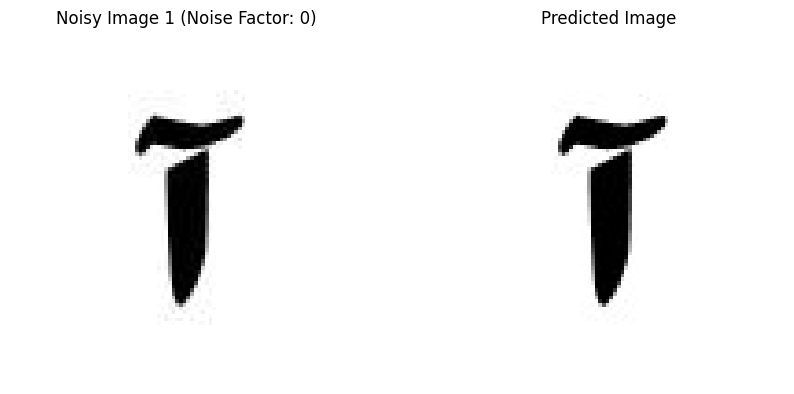

Given Image: noisy1.jpg, Predicted Image Index: 1


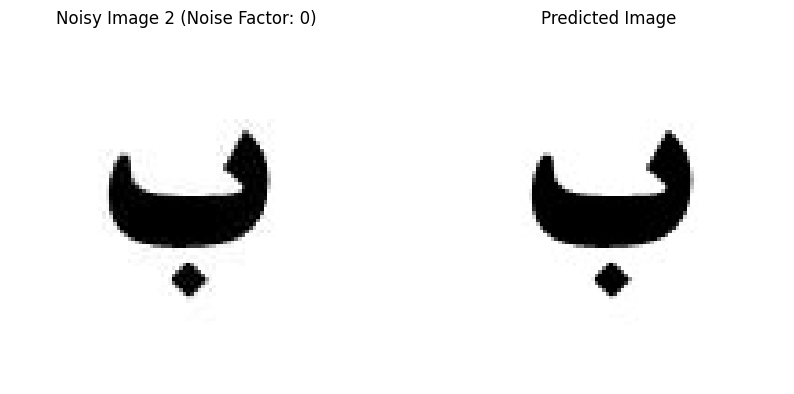

Given Image: noisy2.jpg, Predicted Image Index: 2


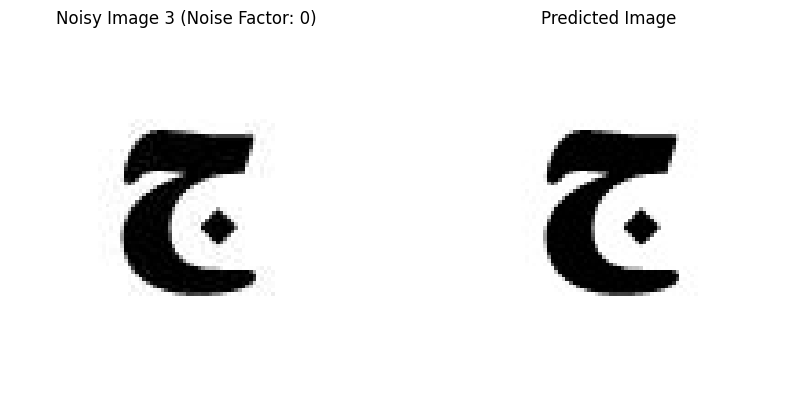

Given Image: noisy3.jpg, Predicted Image Index: 3


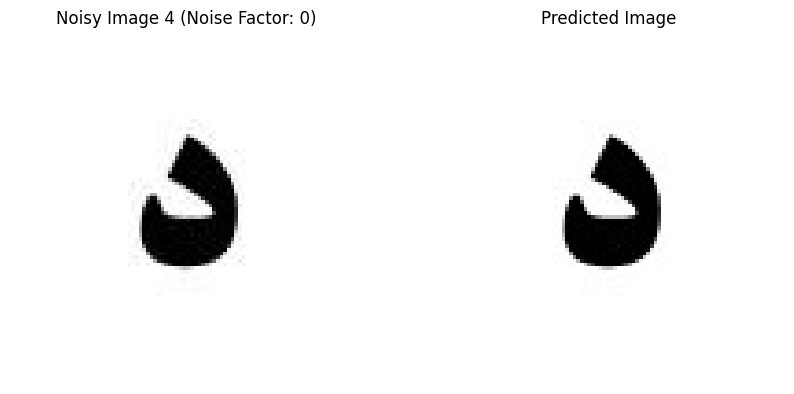

Given Image: noisy4.jpg, Predicted Image Index: 4


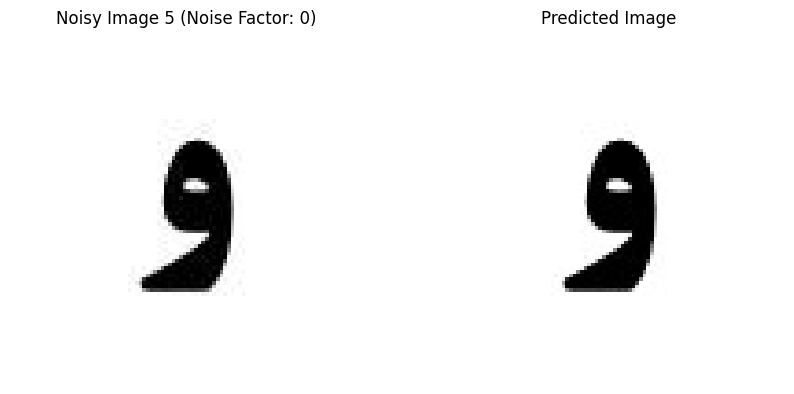

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


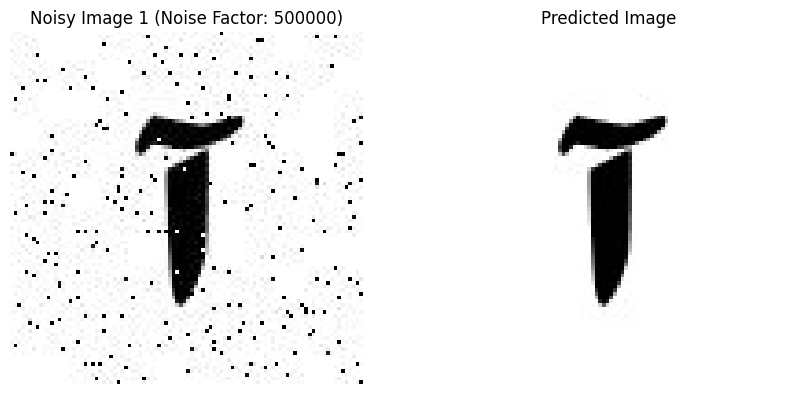

Given Image: noisy1.jpg, Predicted Image Index: 1


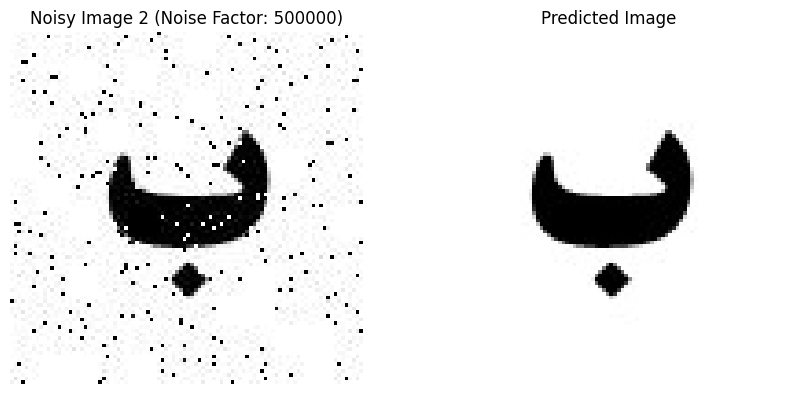

Given Image: noisy2.jpg, Predicted Image Index: 2


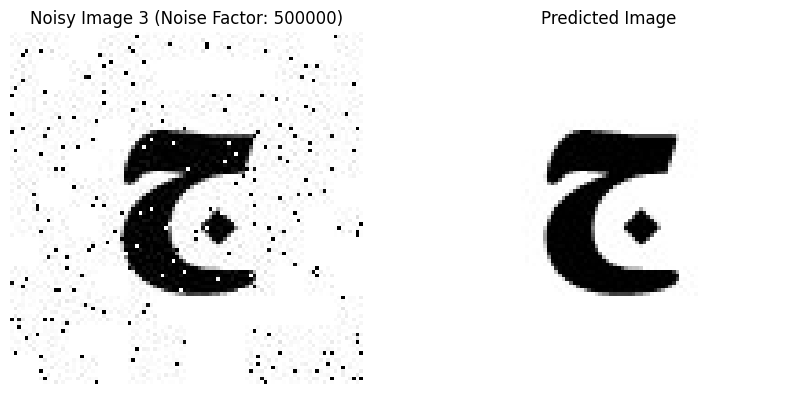

Given Image: noisy3.jpg, Predicted Image Index: 3


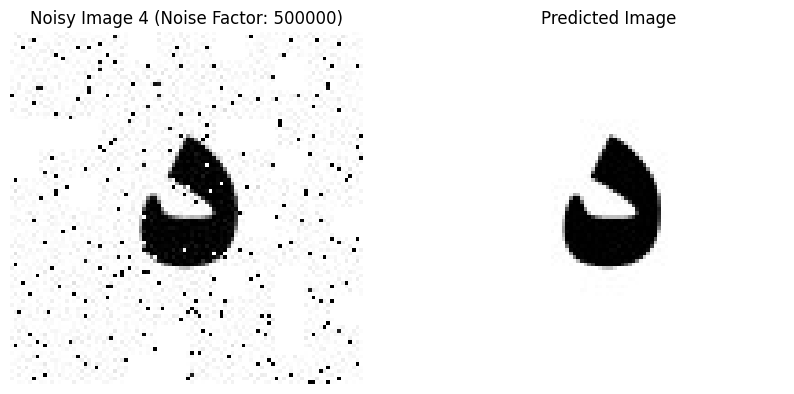

Given Image: noisy4.jpg, Predicted Image Index: 4


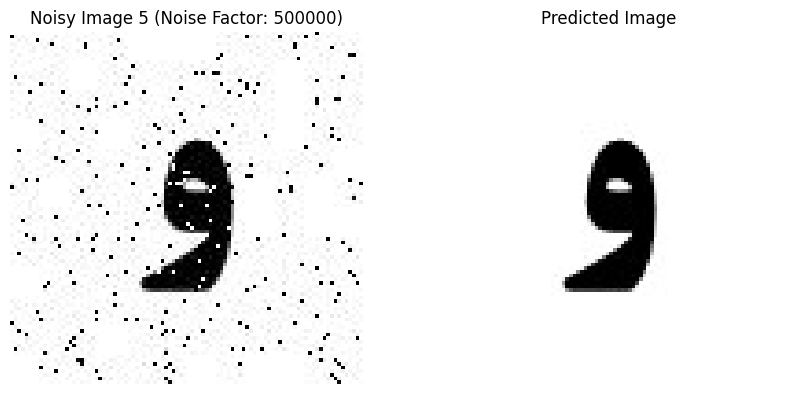

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


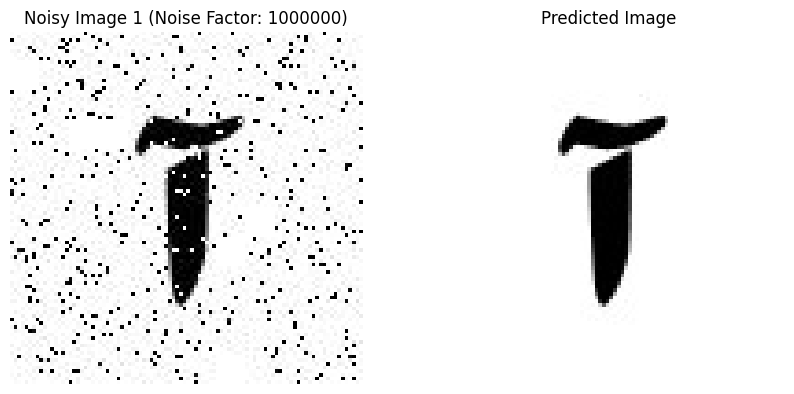

Given Image: noisy1.jpg, Predicted Image Index: 1


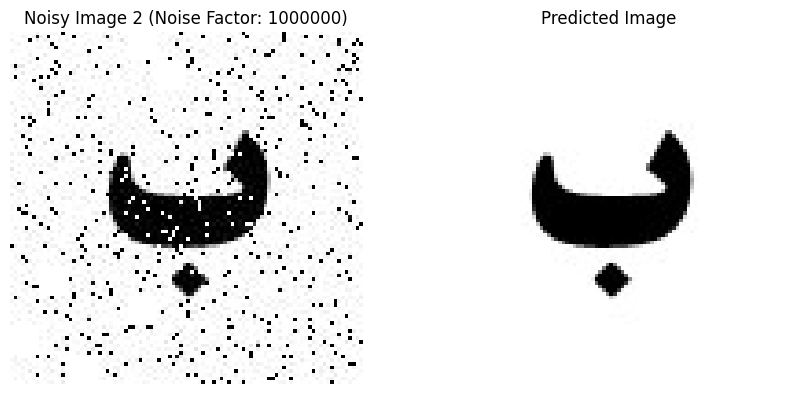

Given Image: noisy2.jpg, Predicted Image Index: 2


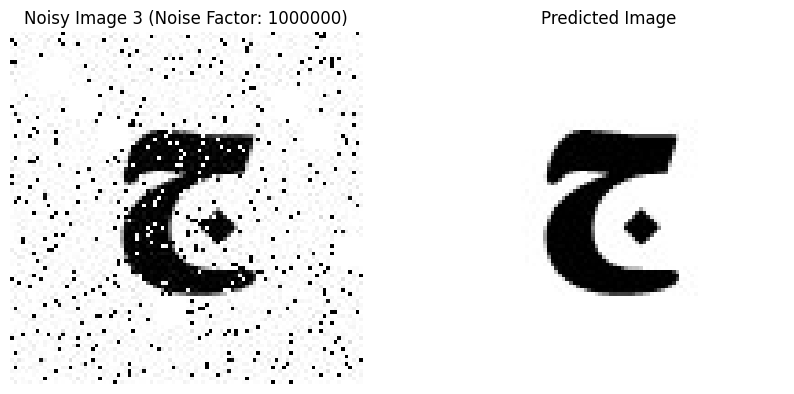

Given Image: noisy3.jpg, Predicted Image Index: 3


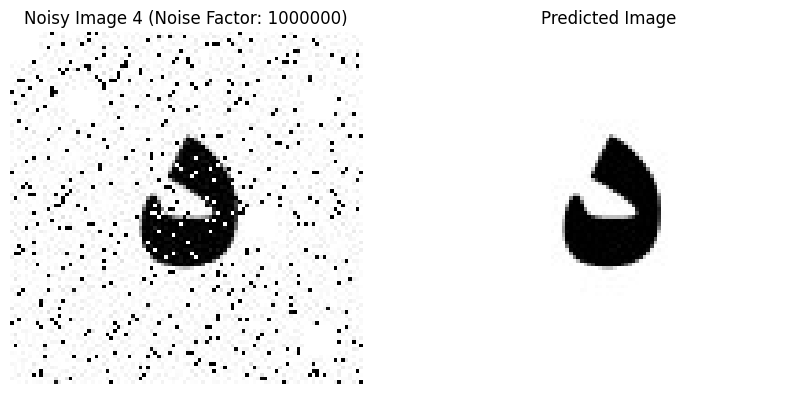

Given Image: noisy4.jpg, Predicted Image Index: 4


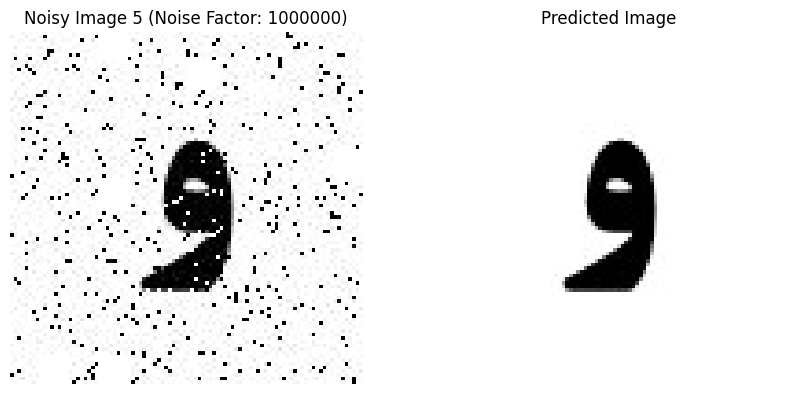

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


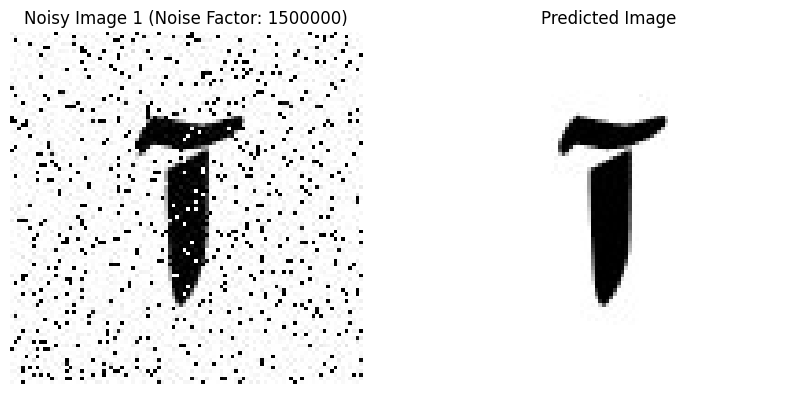

Given Image: noisy1.jpg, Predicted Image Index: 1


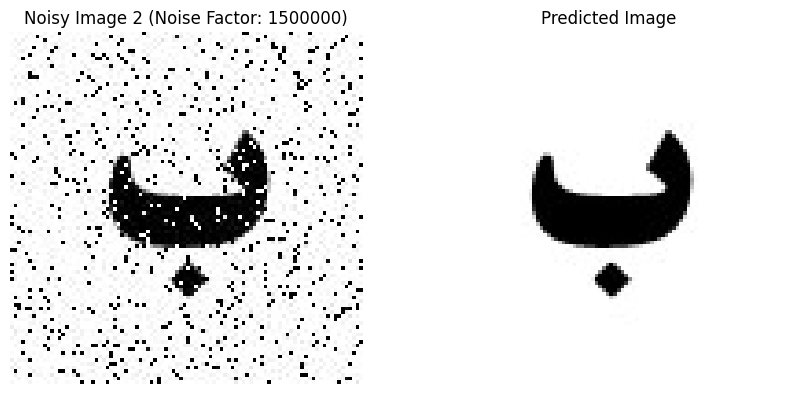

Given Image: noisy2.jpg, Predicted Image Index: 2


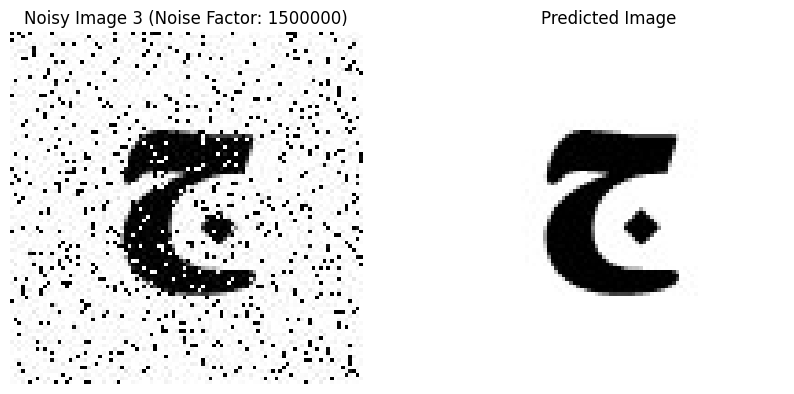

Given Image: noisy3.jpg, Predicted Image Index: 3


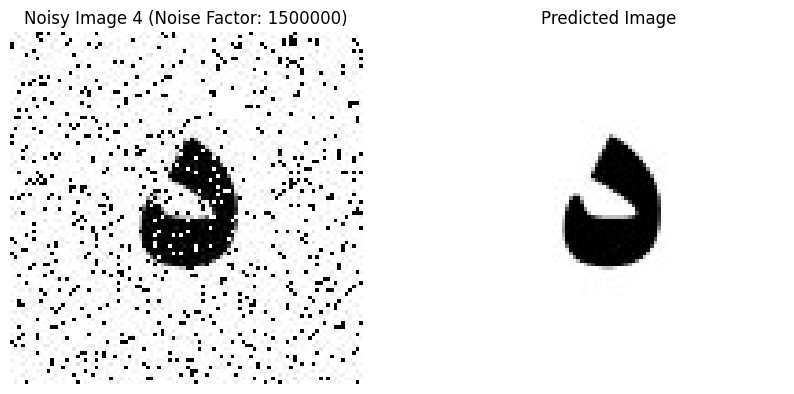

Given Image: noisy4.jpg, Predicted Image Index: 4


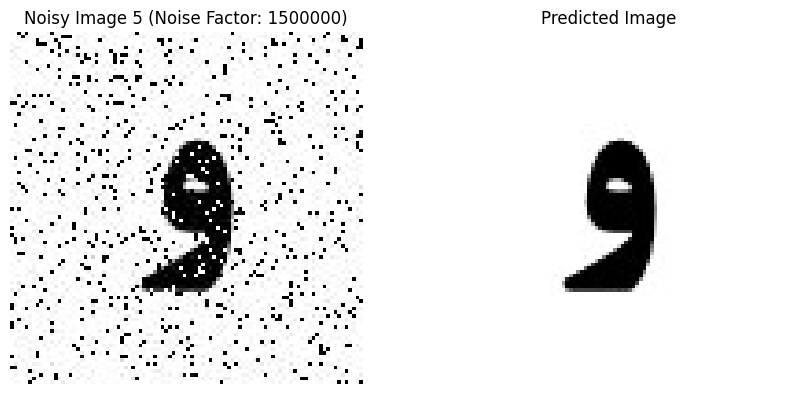

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


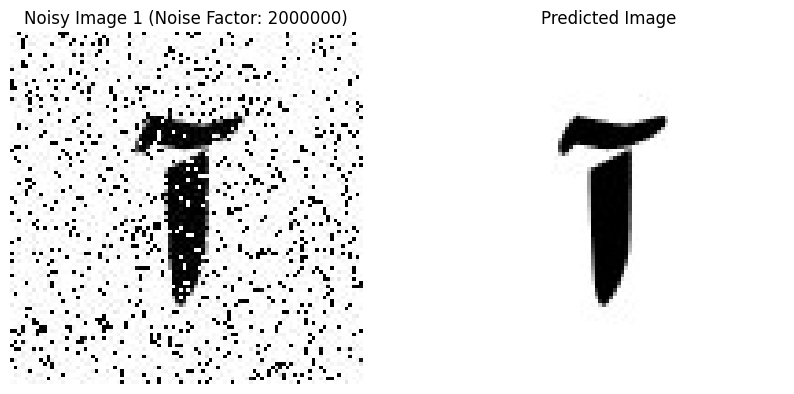

Given Image: noisy1.jpg, Predicted Image Index: 1


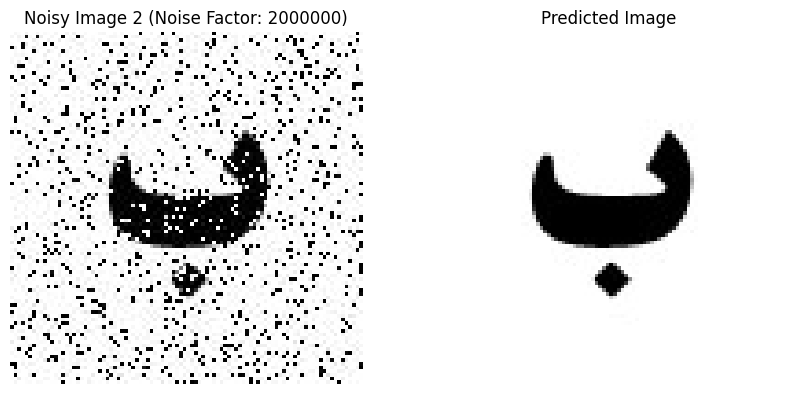

Given Image: noisy2.jpg, Predicted Image Index: 2


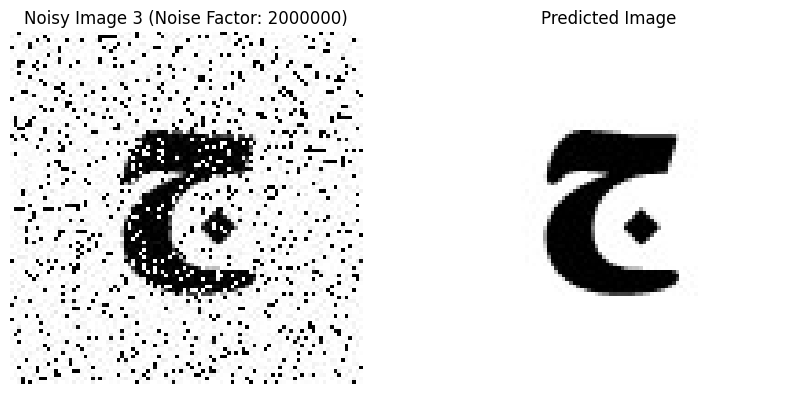

Given Image: noisy3.jpg, Predicted Image Index: 3


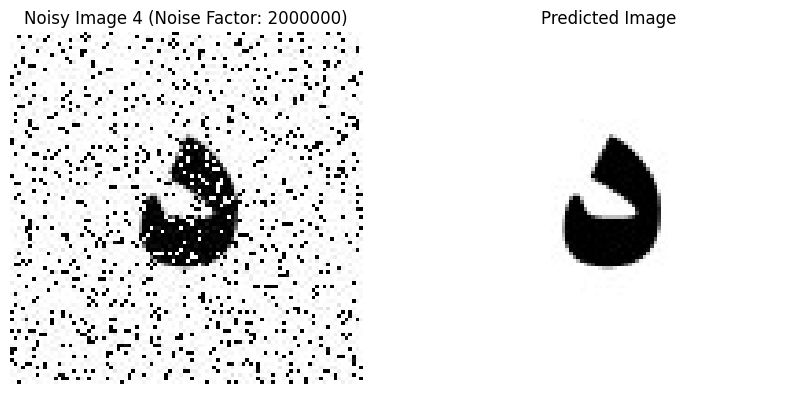

Given Image: noisy4.jpg, Predicted Image Index: 4


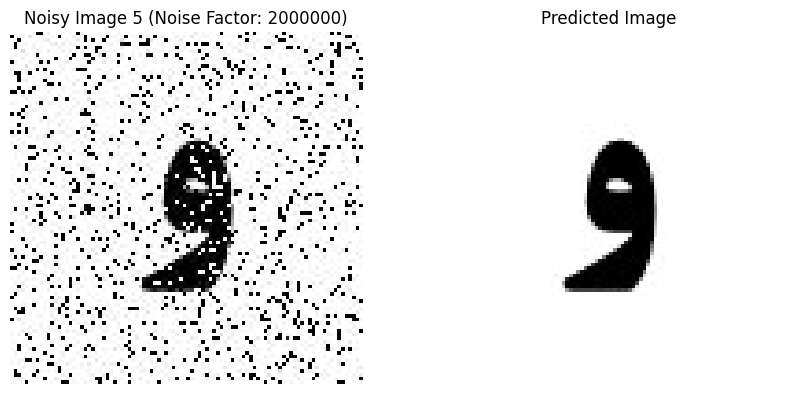

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


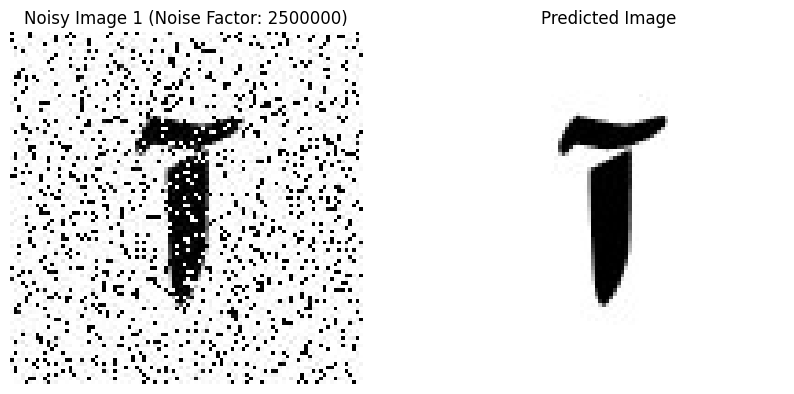

Given Image: noisy1.jpg, Predicted Image Index: 1


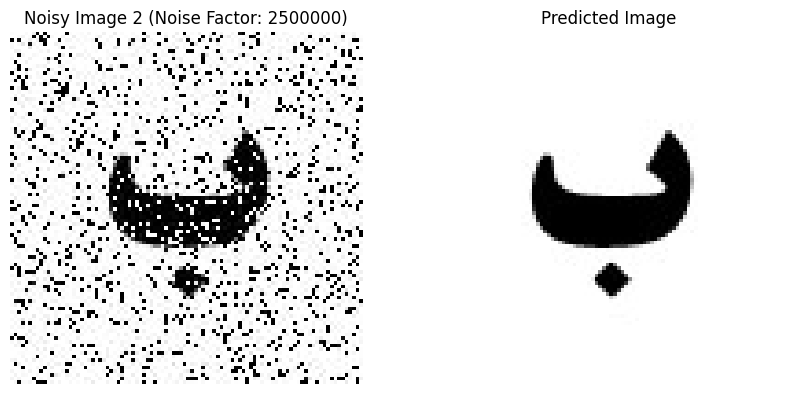

Given Image: noisy2.jpg, Predicted Image Index: 2


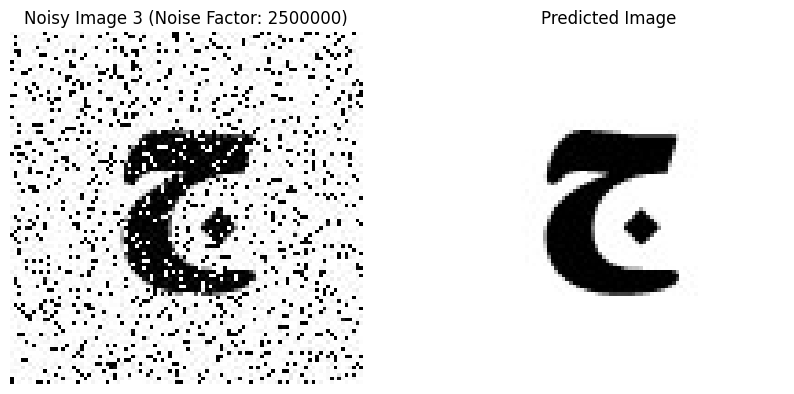

Given Image: noisy3.jpg, Predicted Image Index: 3


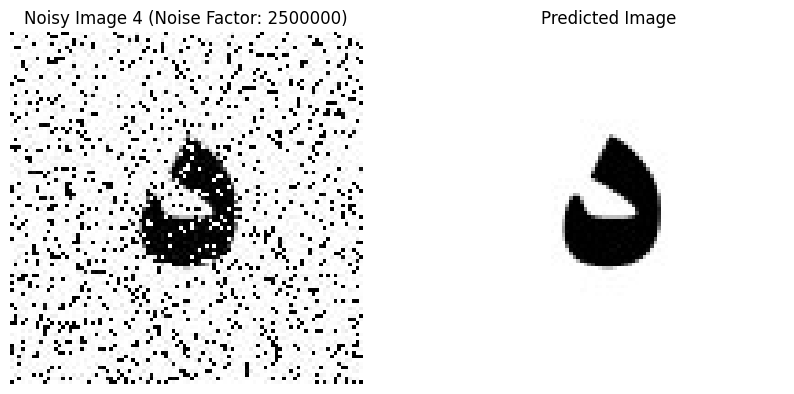

Given Image: noisy4.jpg, Predicted Image Index: 4


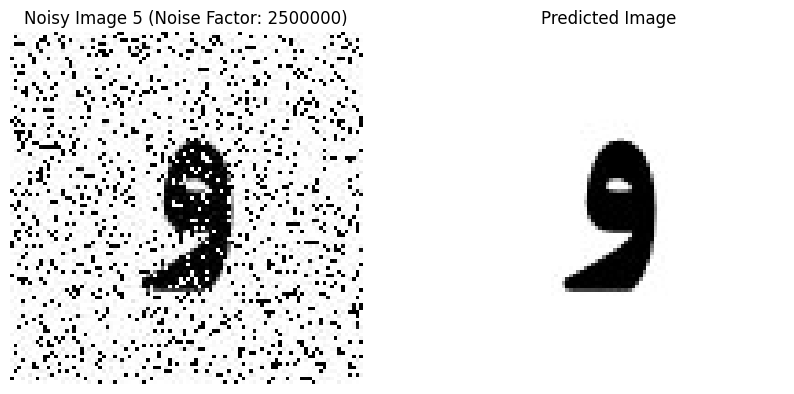

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


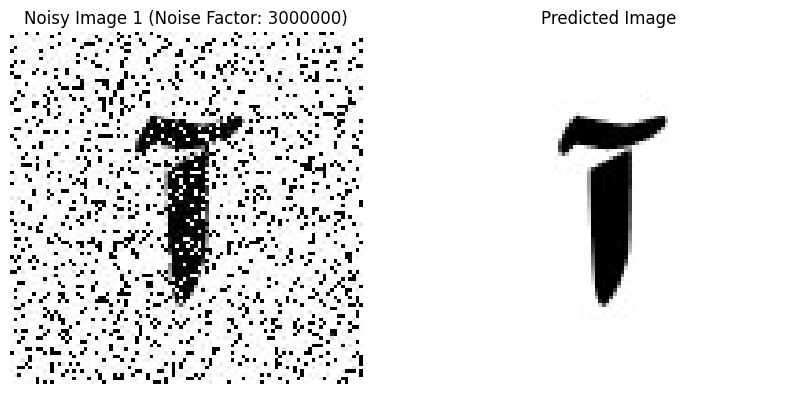

Given Image: noisy1.jpg, Predicted Image Index: 1


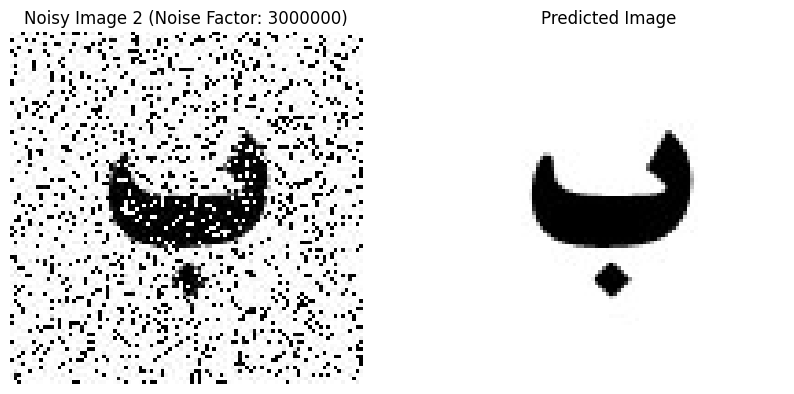

Given Image: noisy2.jpg, Predicted Image Index: 2


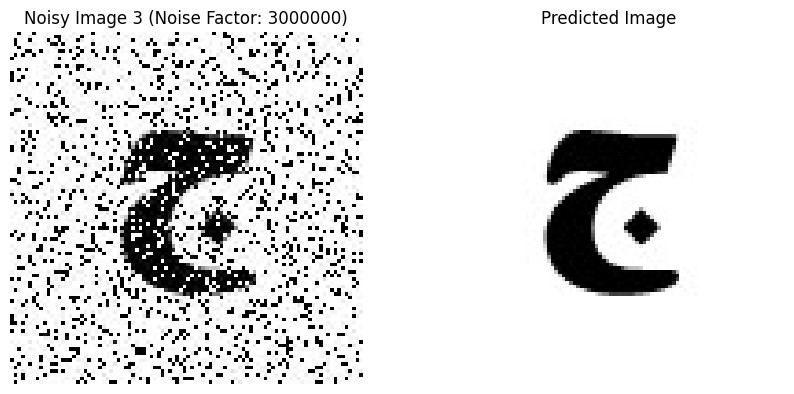

Given Image: noisy3.jpg, Predicted Image Index: 3


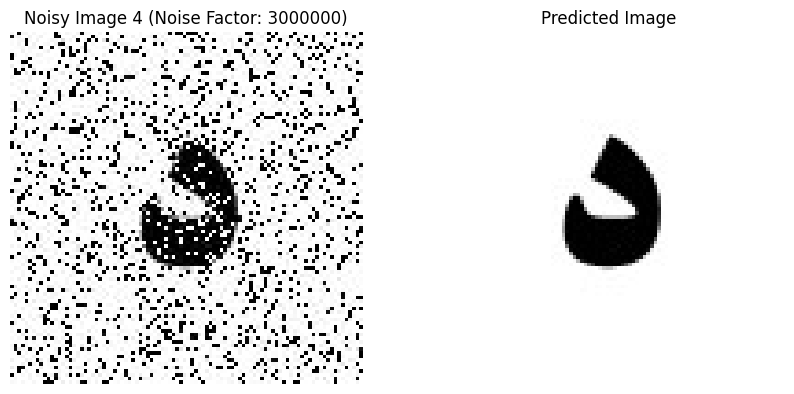

Given Image: noisy4.jpg, Predicted Image Index: 4


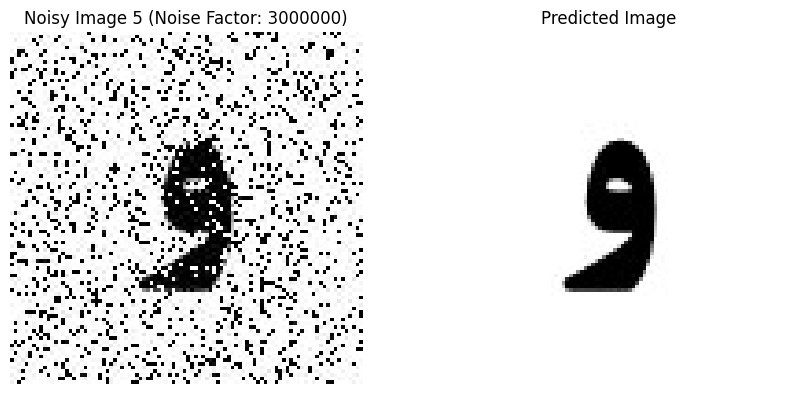

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


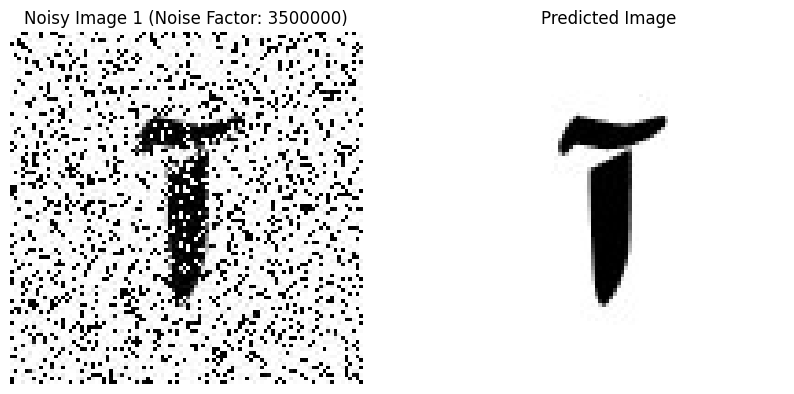

Given Image: noisy1.jpg, Predicted Image Index: 1


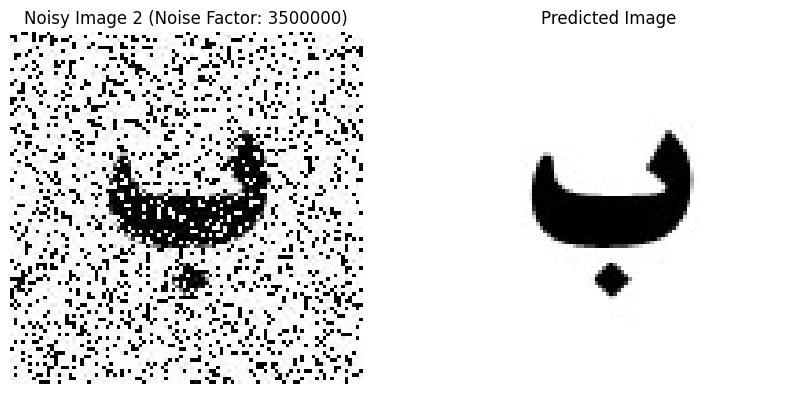

Given Image: noisy2.jpg, Predicted Image Index: 2


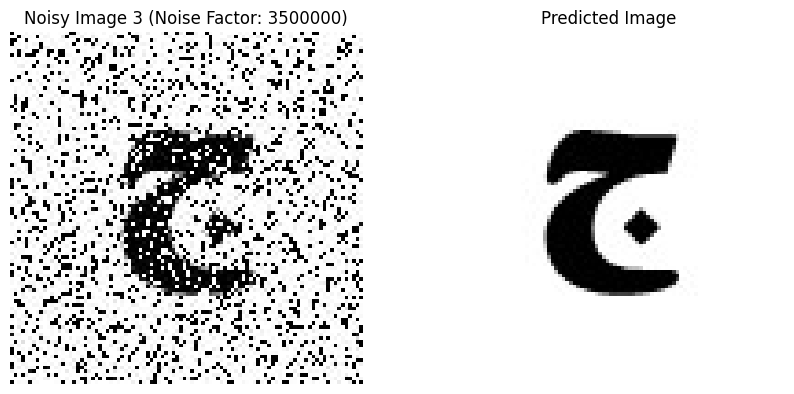

Given Image: noisy3.jpg, Predicted Image Index: 3


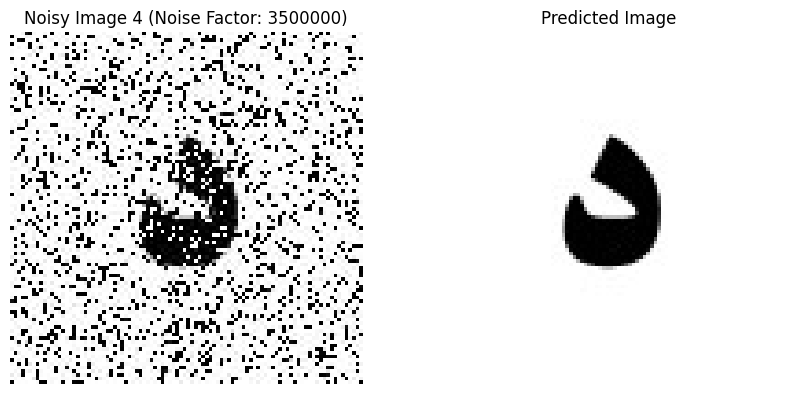

Given Image: noisy4.jpg, Predicted Image Index: 4


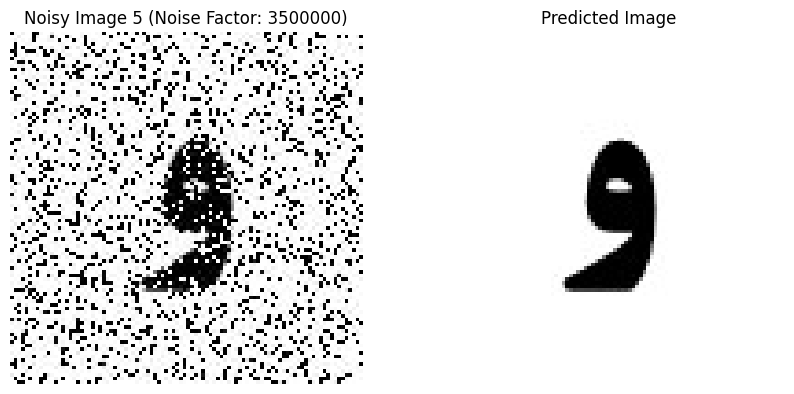

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


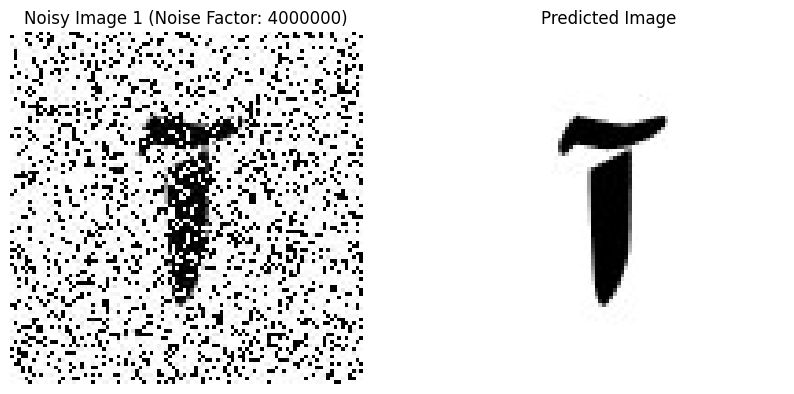

Given Image: noisy1.jpg, Predicted Image Index: 1


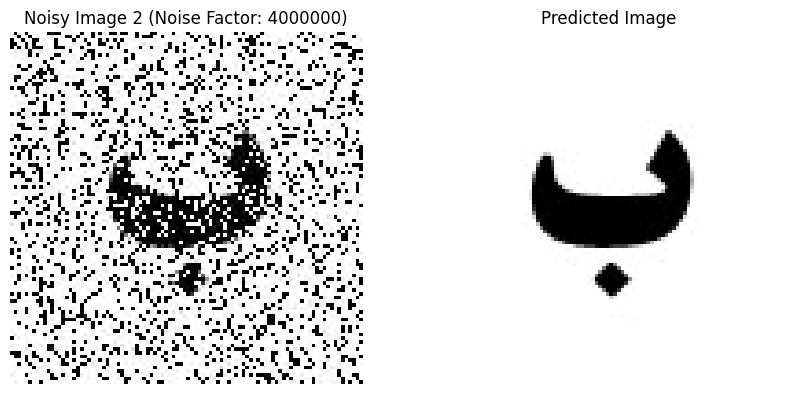

Given Image: noisy2.jpg, Predicted Image Index: 2


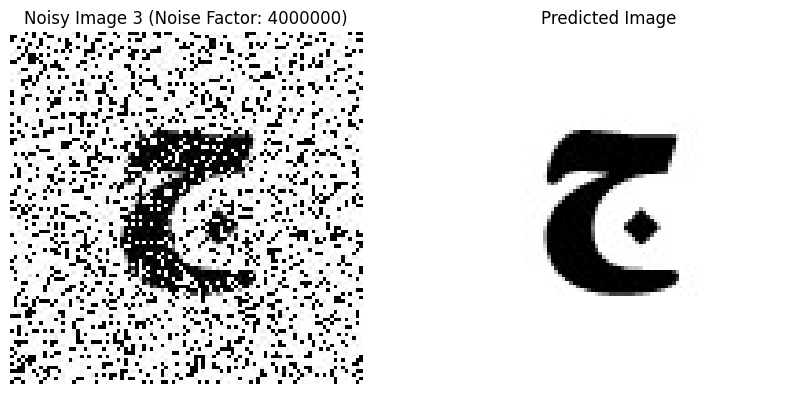

Given Image: noisy3.jpg, Predicted Image Index: 3


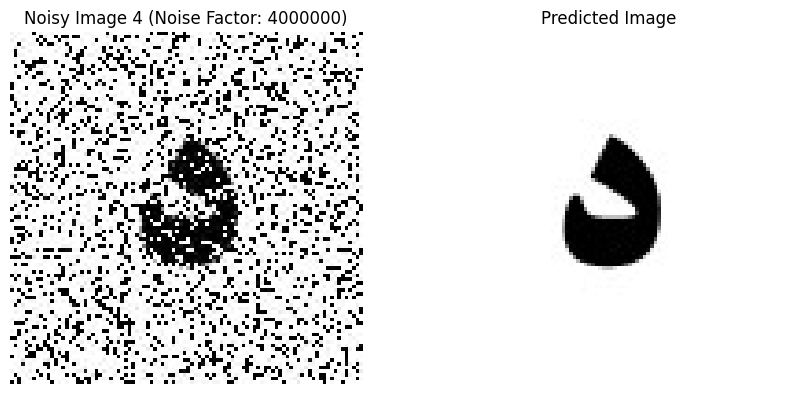

Given Image: noisy4.jpg, Predicted Image Index: 4


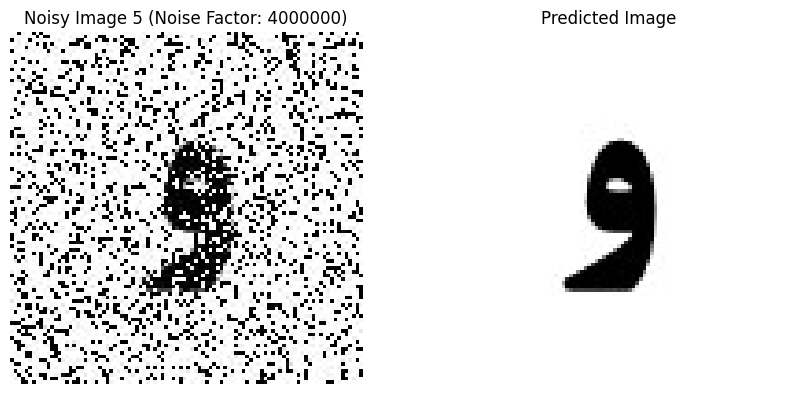

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


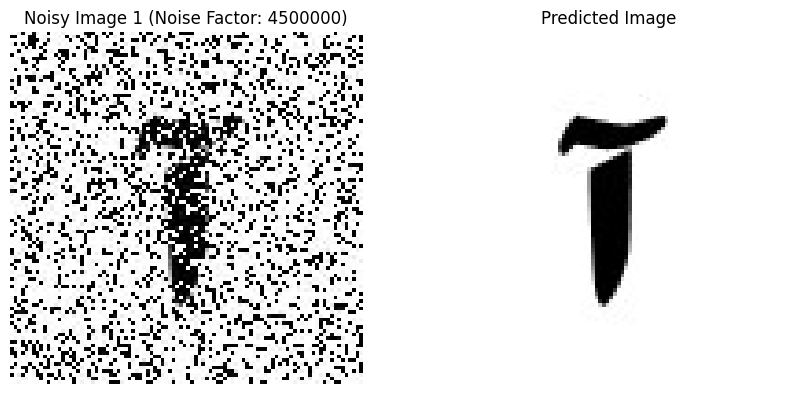

Given Image: noisy1.jpg, Predicted Image Index: 1


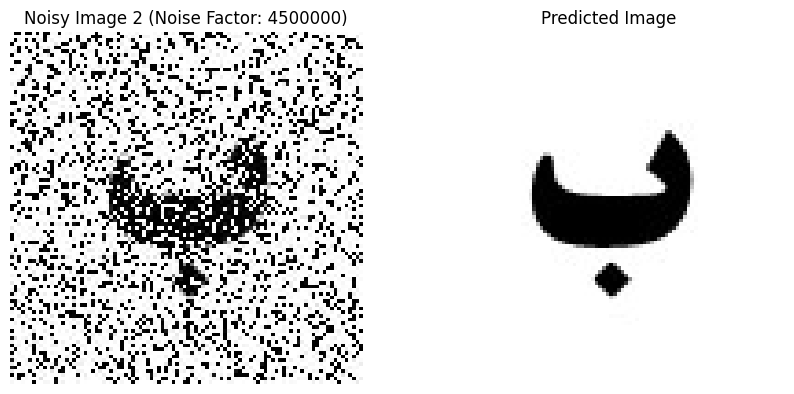

Given Image: noisy2.jpg, Predicted Image Index: 2


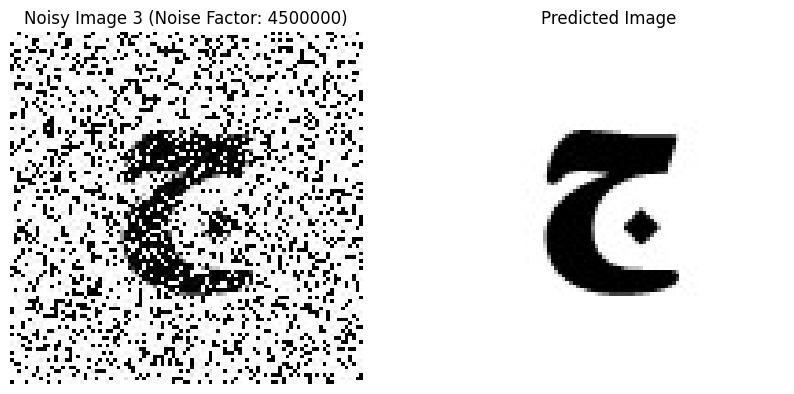

Given Image: noisy3.jpg, Predicted Image Index: 3


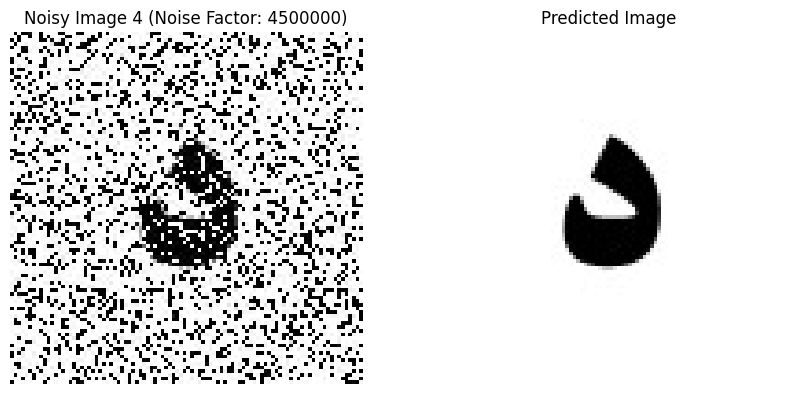

Given Image: noisy4.jpg, Predicted Image Index: 4


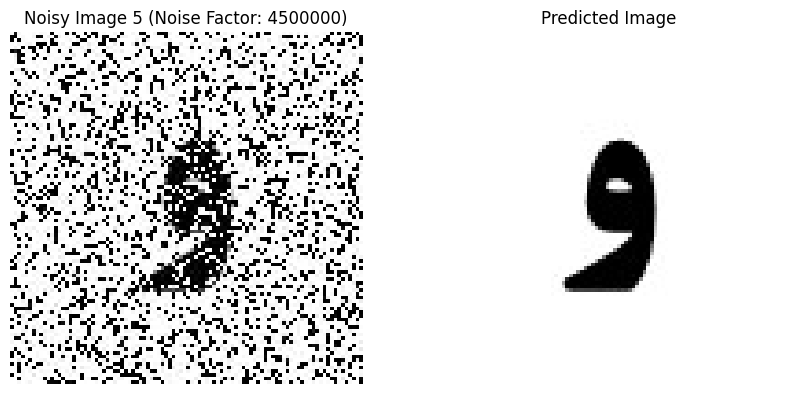

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


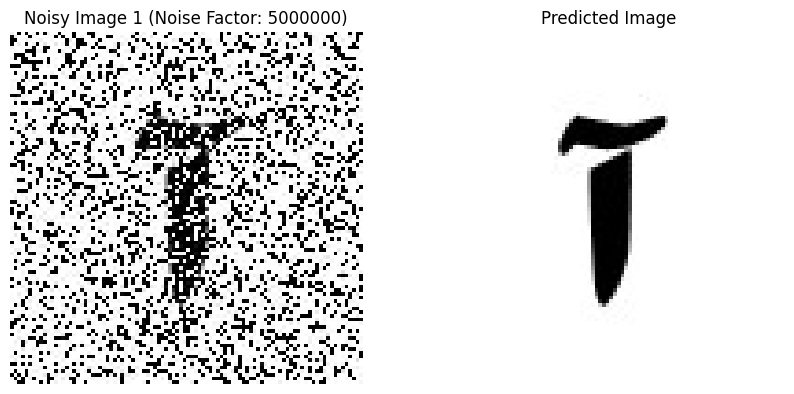

Given Image: noisy1.jpg, Predicted Image Index: 1


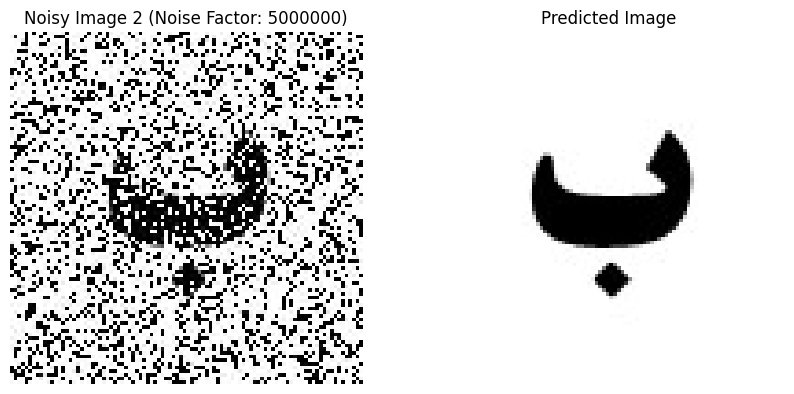

Given Image: noisy2.jpg, Predicted Image Index: 2


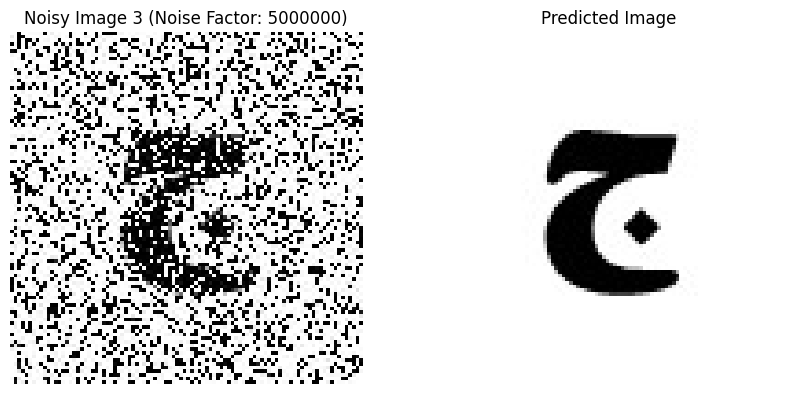

Given Image: noisy3.jpg, Predicted Image Index: 3


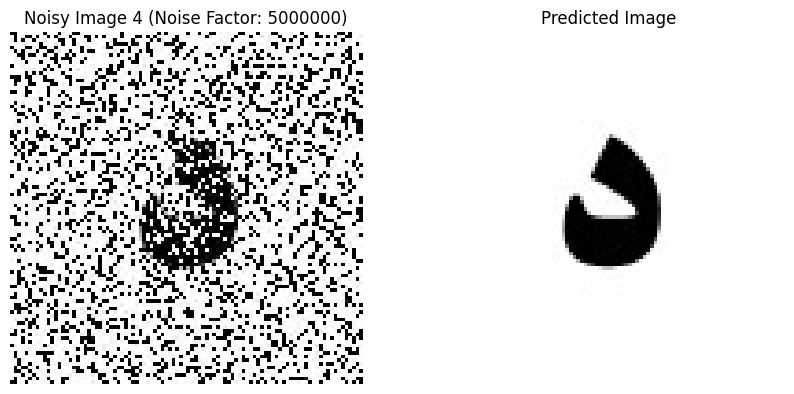

Given Image: noisy4.jpg, Predicted Image Index: 4


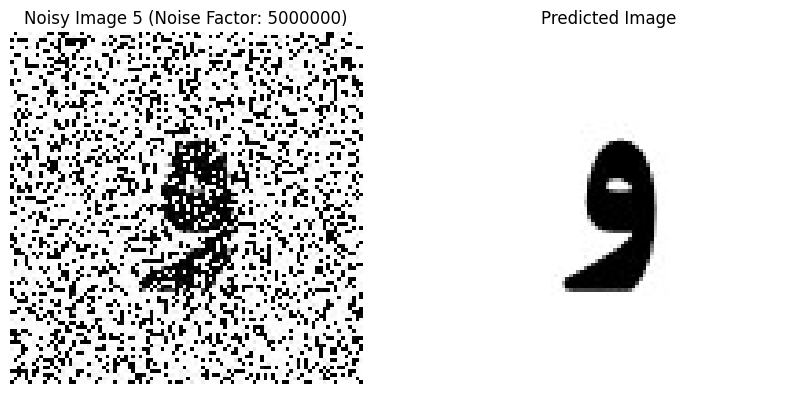

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


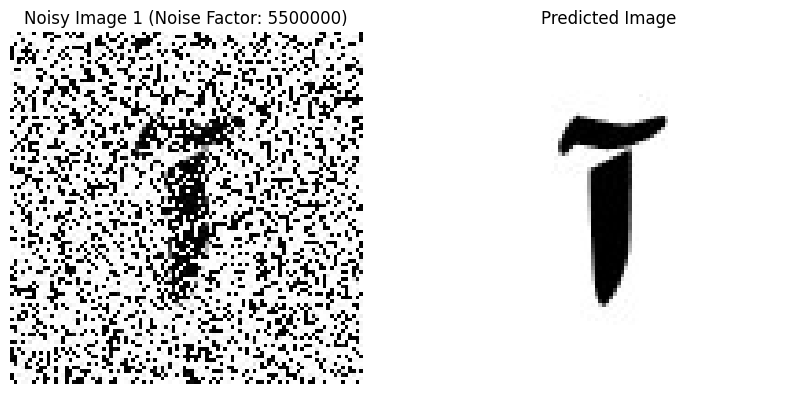

Given Image: noisy1.jpg, Predicted Image Index: 1


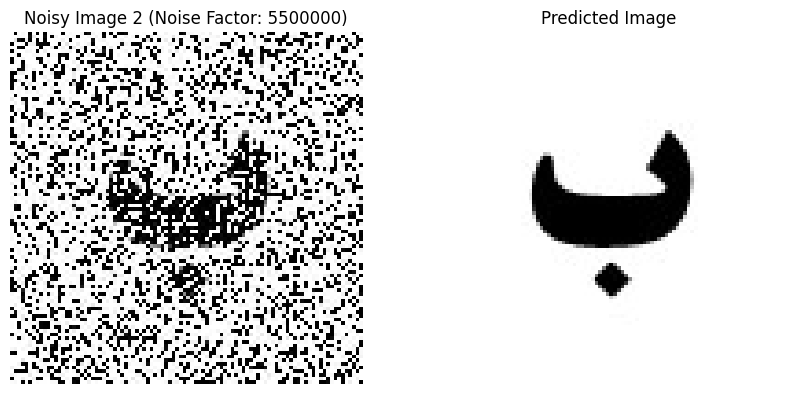

Given Image: noisy2.jpg, Predicted Image Index: 2


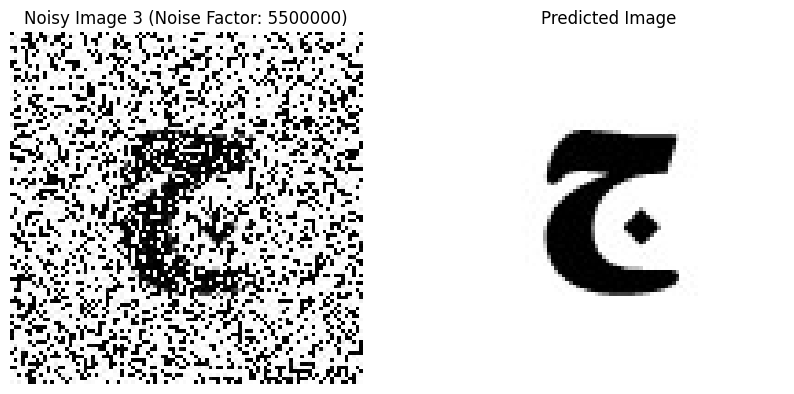

Given Image: noisy3.jpg, Predicted Image Index: 3


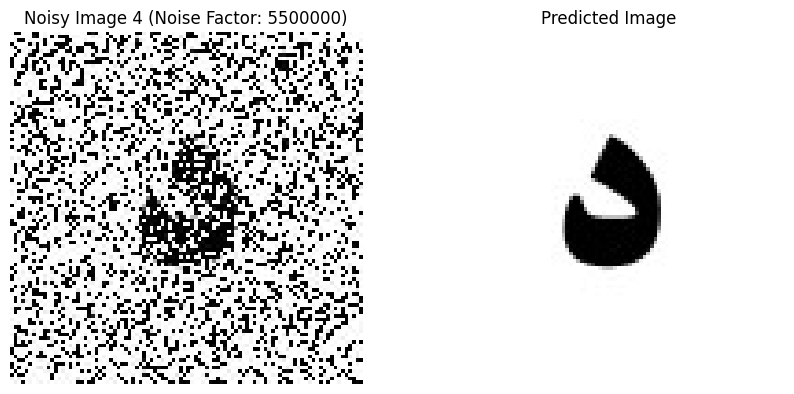

Given Image: noisy4.jpg, Predicted Image Index: 4


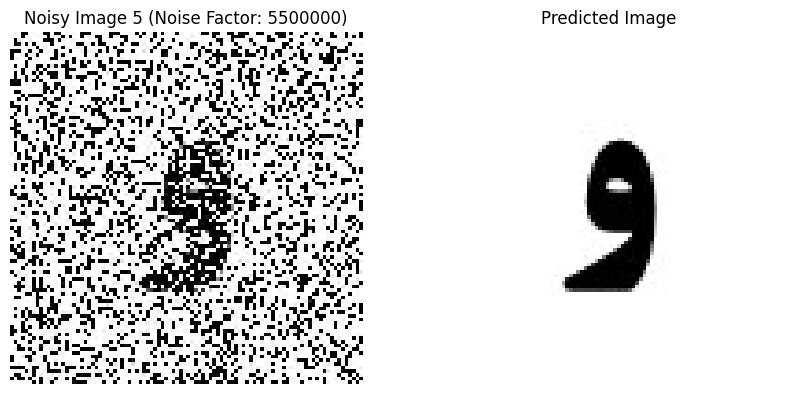

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


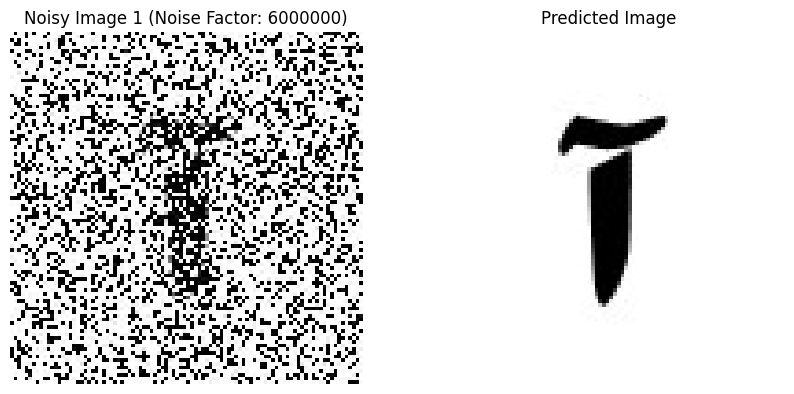

Given Image: noisy1.jpg, Predicted Image Index: 1


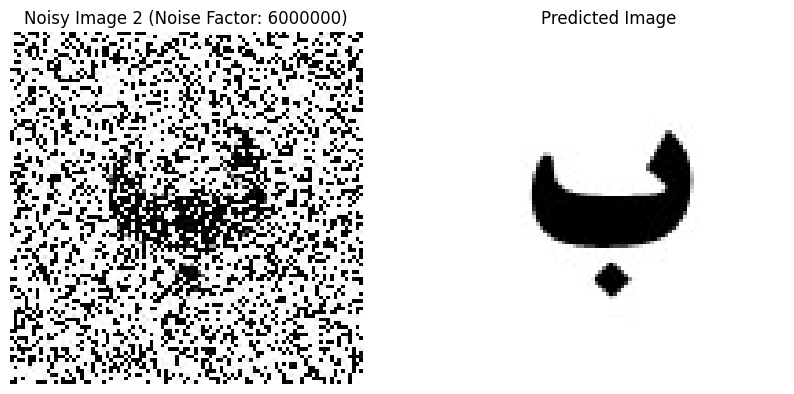

Given Image: noisy2.jpg, Predicted Image Index: 2


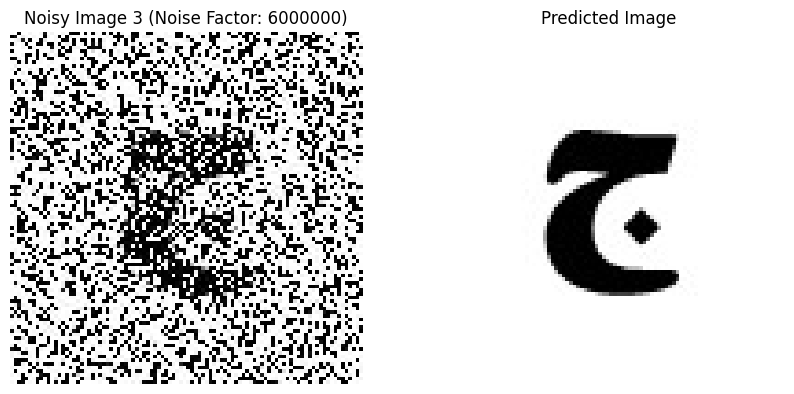

Given Image: noisy3.jpg, Predicted Image Index: 3


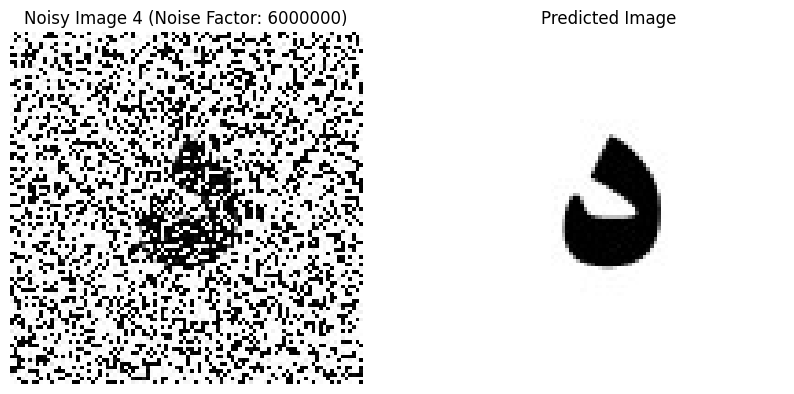

Given Image: noisy4.jpg, Predicted Image Index: 4


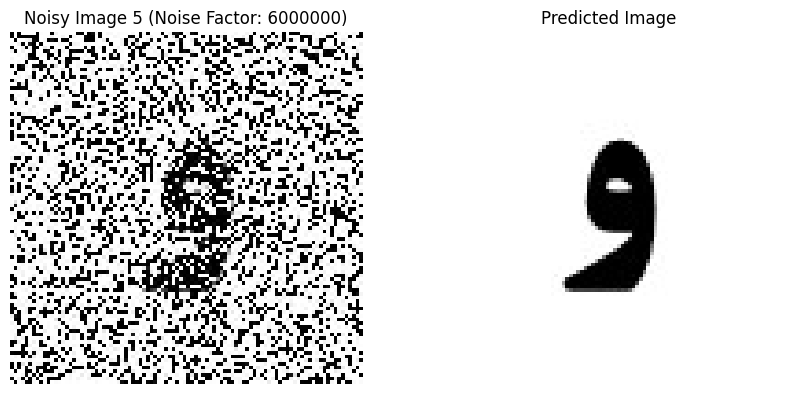

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


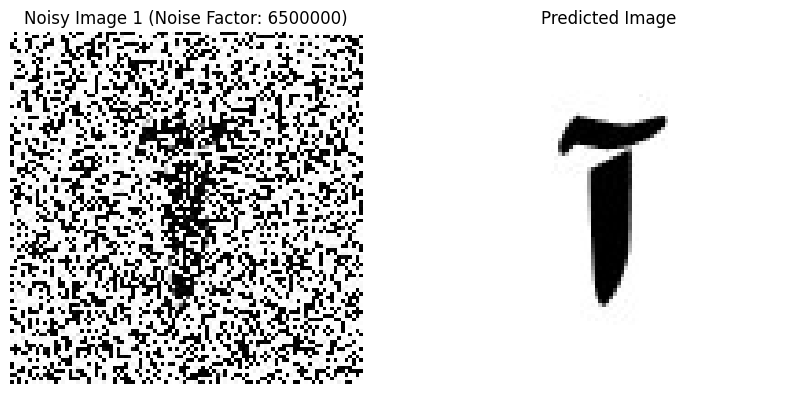

Given Image: noisy1.jpg, Predicted Image Index: 1


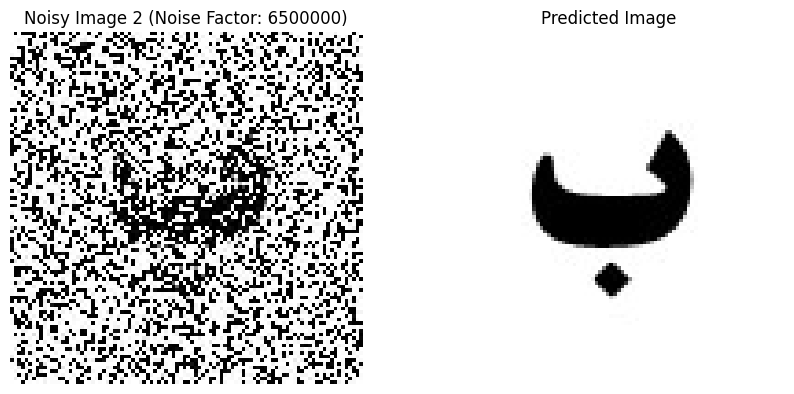

Given Image: noisy2.jpg, Predicted Image Index: 2


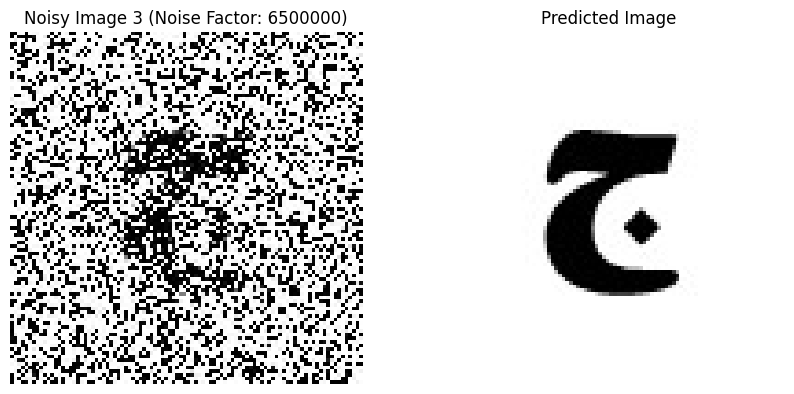

Given Image: noisy3.jpg, Predicted Image Index: 3


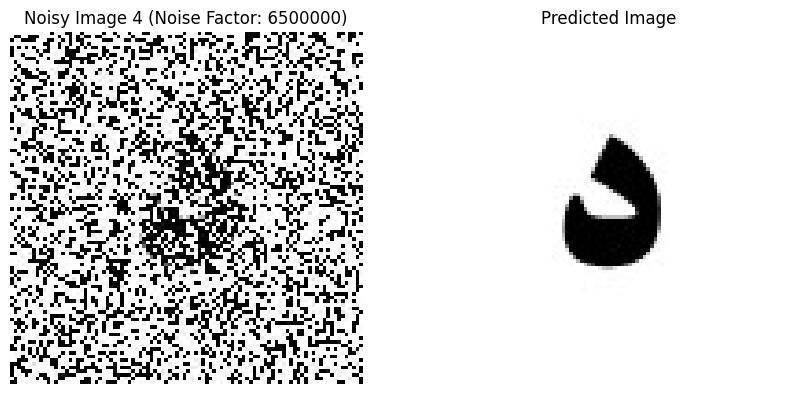

Given Image: noisy4.jpg, Predicted Image Index: 4


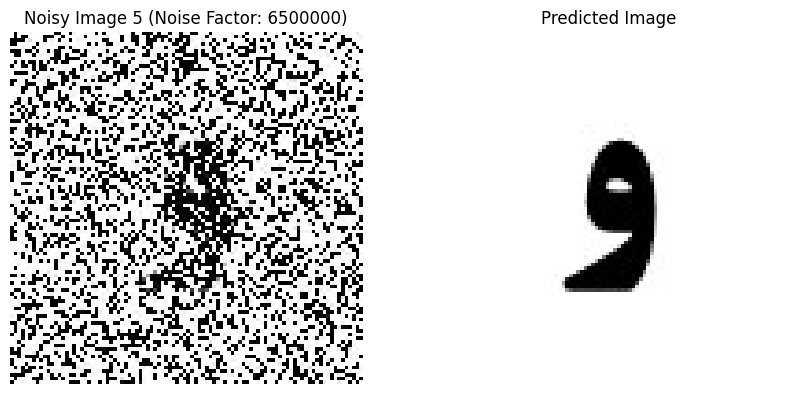

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


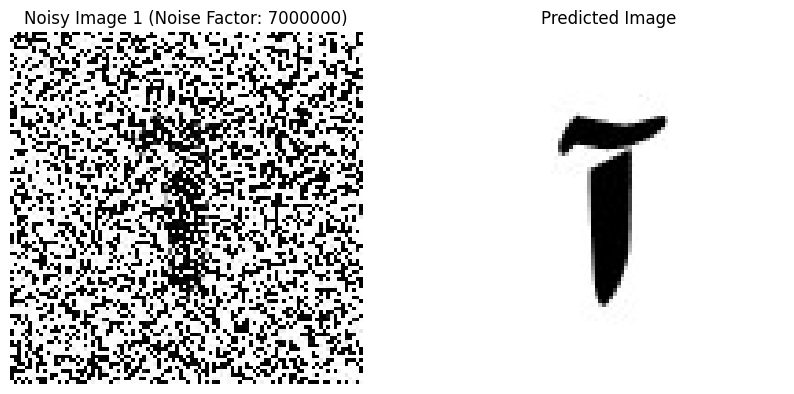

Given Image: noisy1.jpg, Predicted Image Index: 1


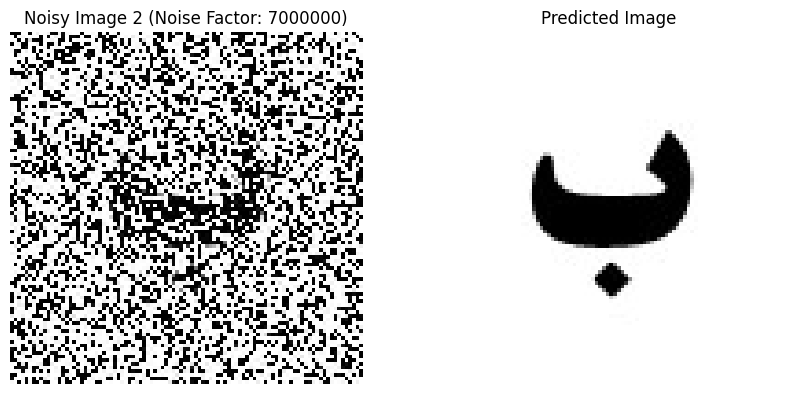

Given Image: noisy2.jpg, Predicted Image Index: 2


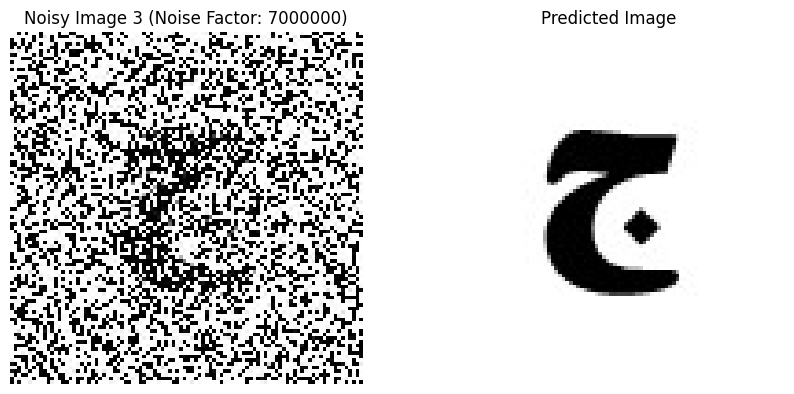

Given Image: noisy3.jpg, Predicted Image Index: 3


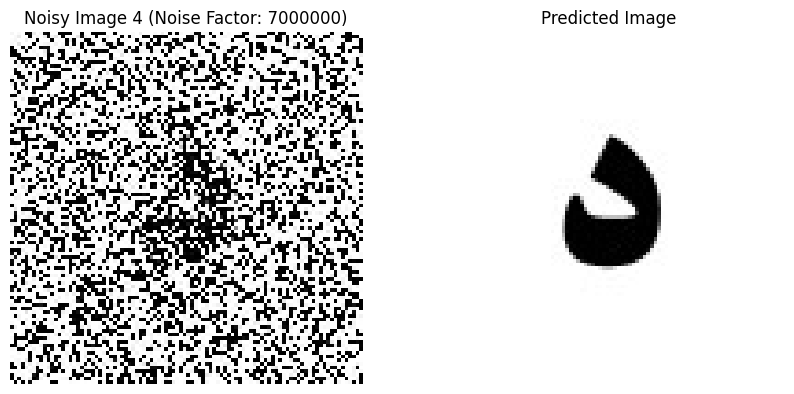

Given Image: noisy4.jpg, Predicted Image Index: 4


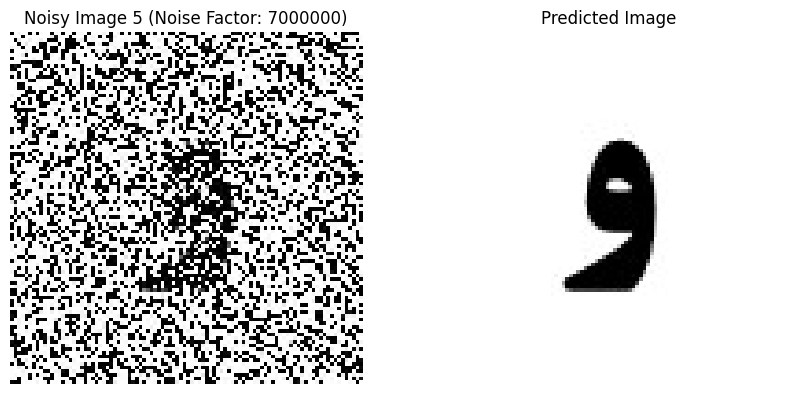

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


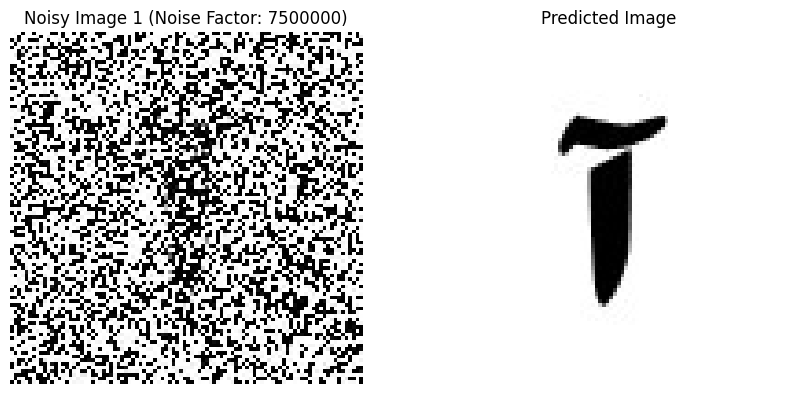

Given Image: noisy1.jpg, Predicted Image Index: 1


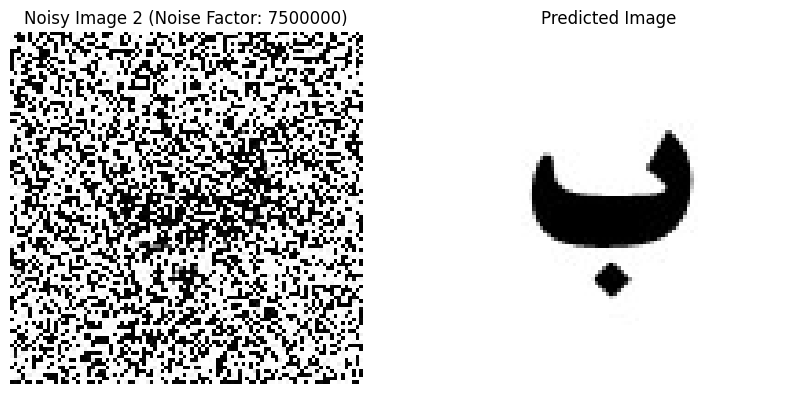

Given Image: noisy2.jpg, Predicted Image Index: 2


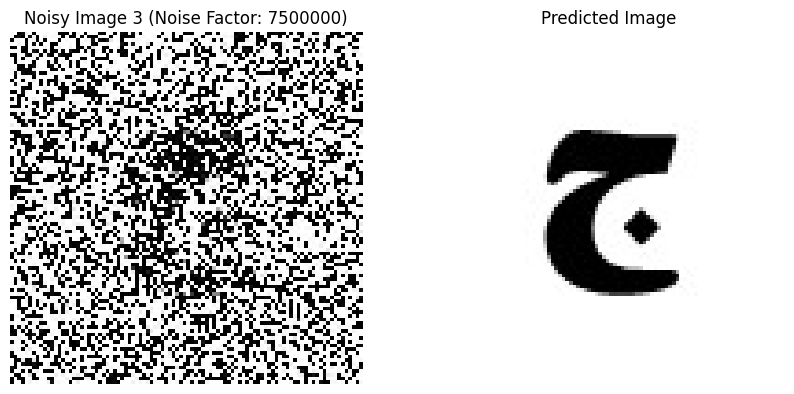

Given Image: noisy3.jpg, Predicted Image Index: 3


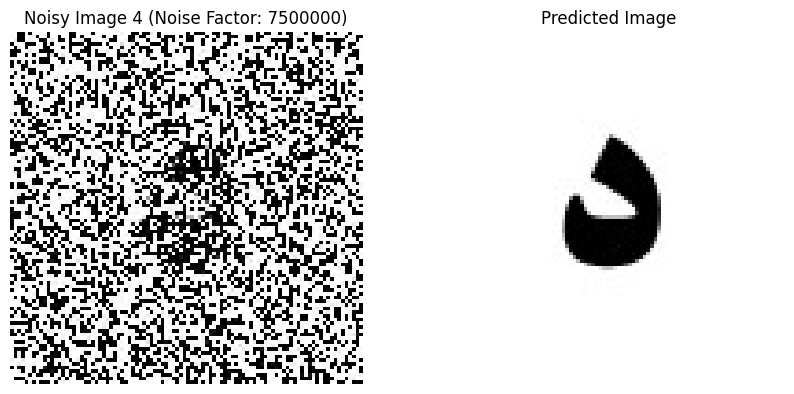

Given Image: noisy4.jpg, Predicted Image Index: 4


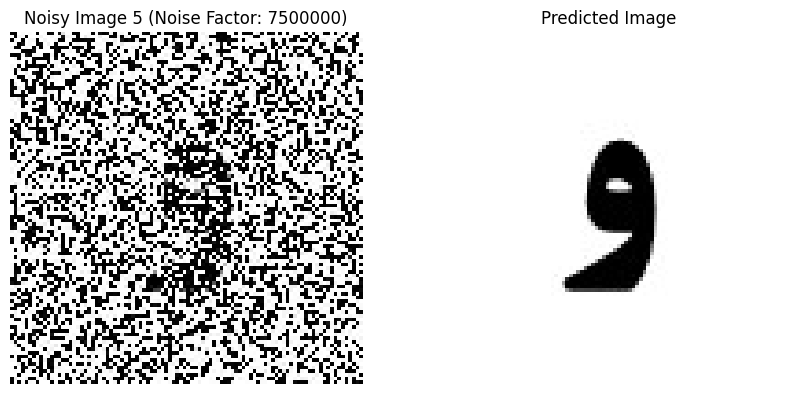

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


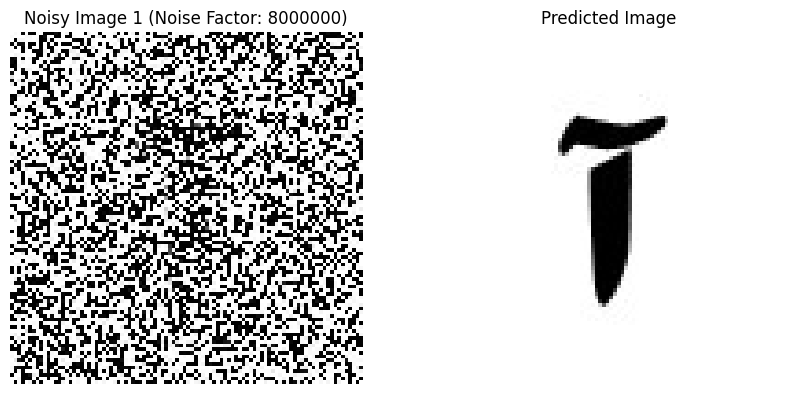

Given Image: noisy1.jpg, Predicted Image Index: 1


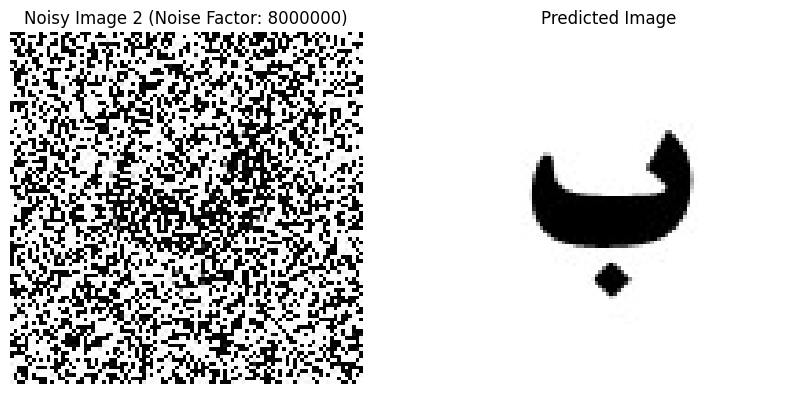

Given Image: noisy2.jpg, Predicted Image Index: 2


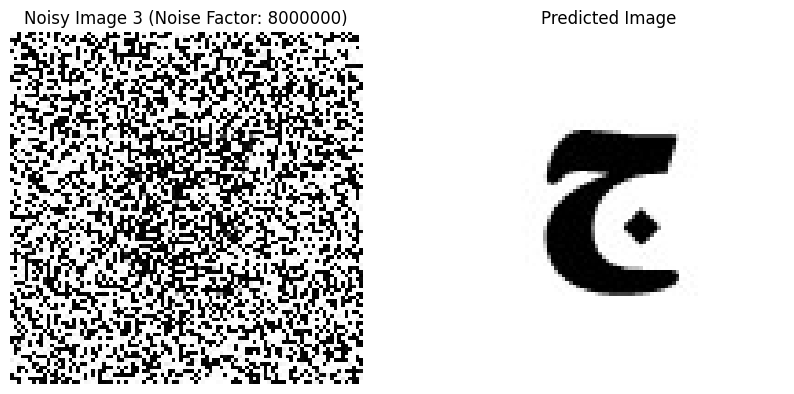

Given Image: noisy3.jpg, Predicted Image Index: 3


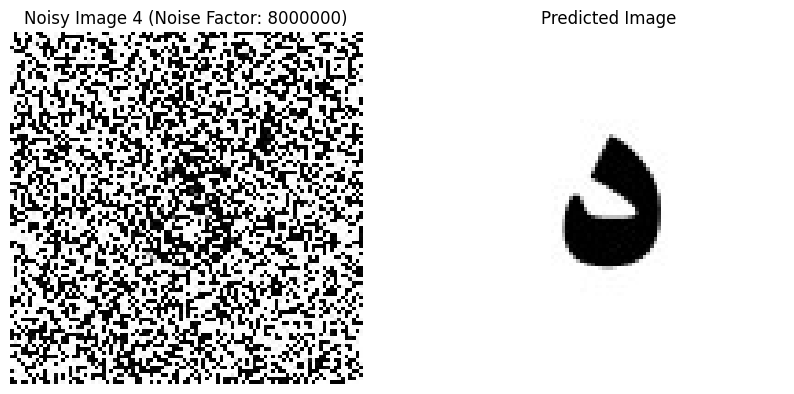

Given Image: noisy4.jpg, Predicted Image Index: 4


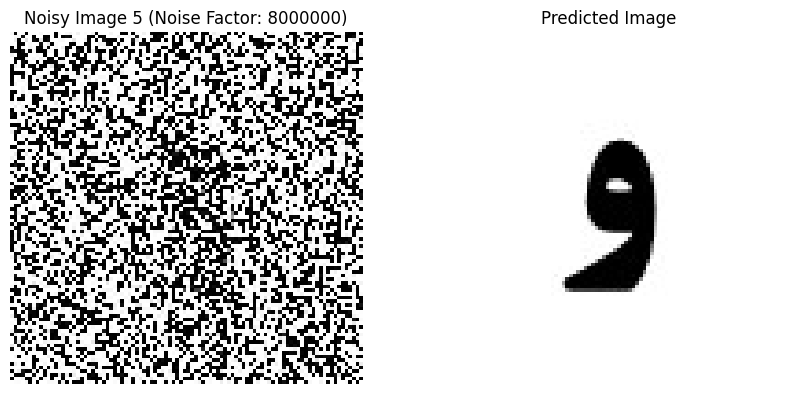

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


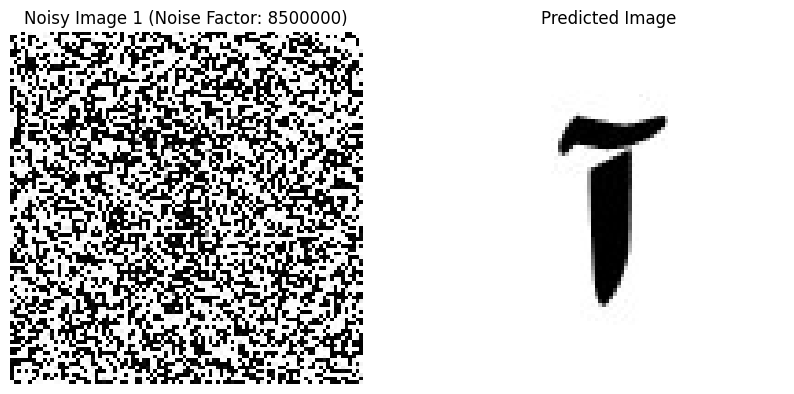

Given Image: noisy1.jpg, Predicted Image Index: 1


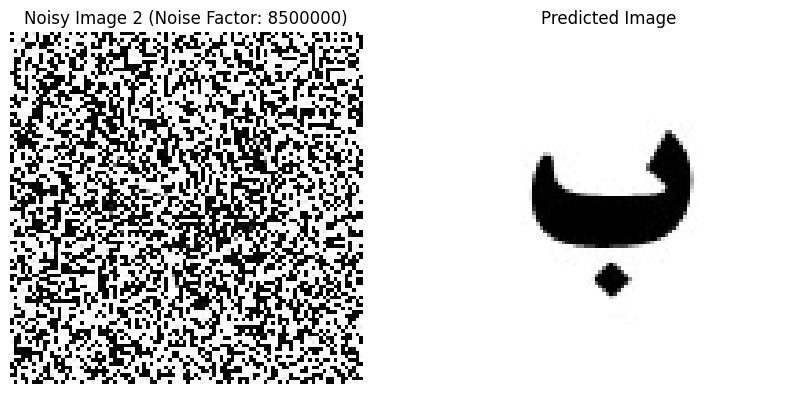

Given Image: noisy2.jpg, Predicted Image Index: 2


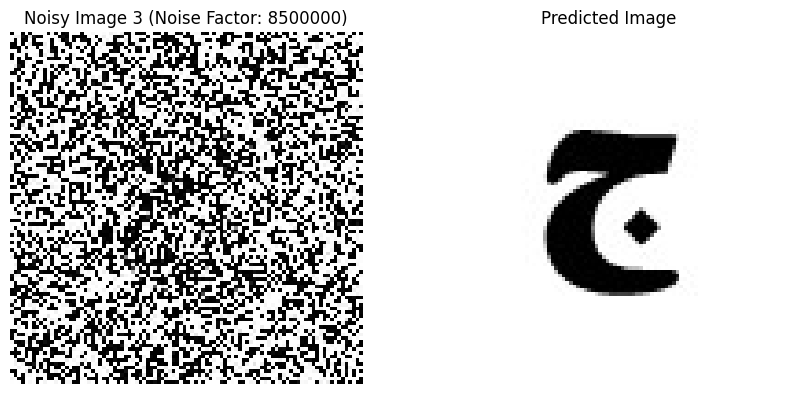

Given Image: noisy3.jpg, Predicted Image Index: 3


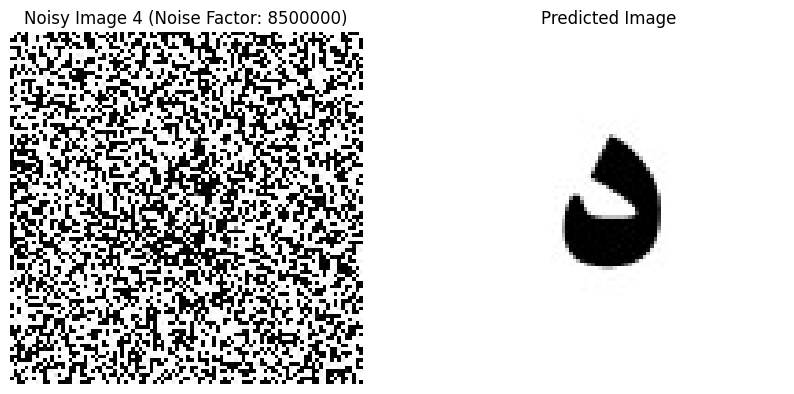

Given Image: noisy4.jpg, Predicted Image Index: 4


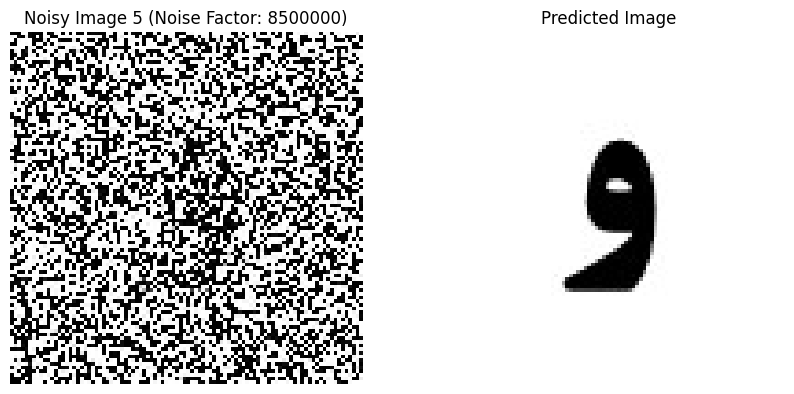

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


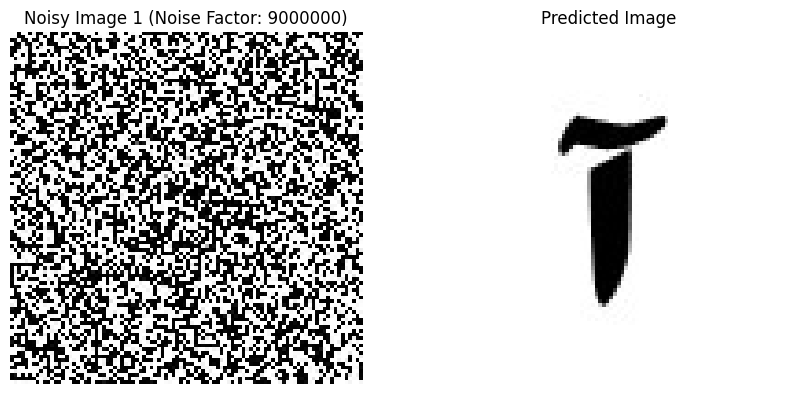

Given Image: noisy1.jpg, Predicted Image Index: 1


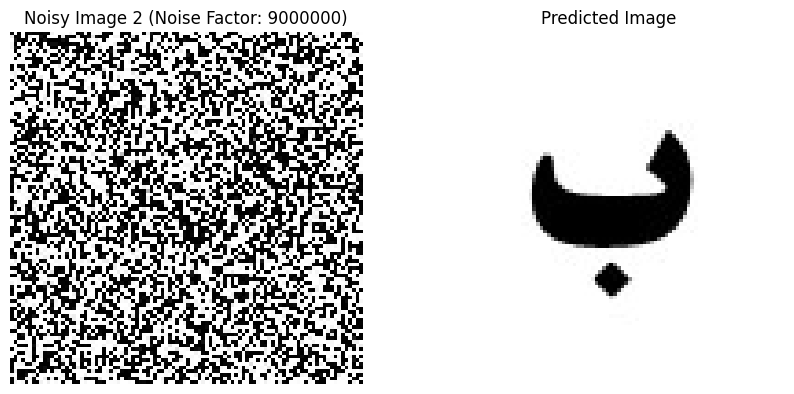

Given Image: noisy2.jpg, Predicted Image Index: 2


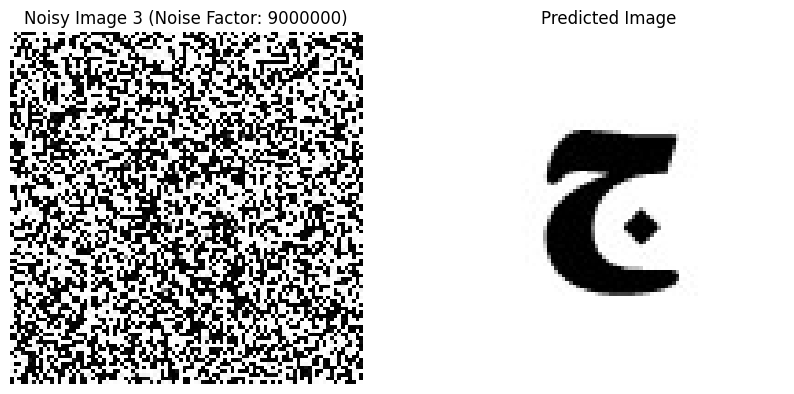

Given Image: noisy3.jpg, Predicted Image Index: 3


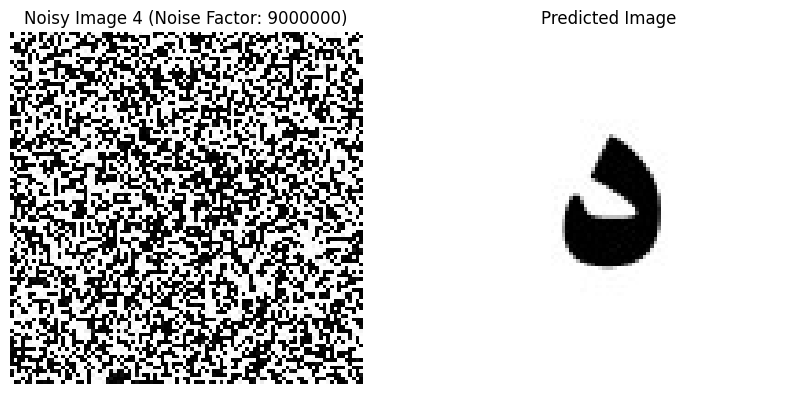

Given Image: noisy4.jpg, Predicted Image Index: 4


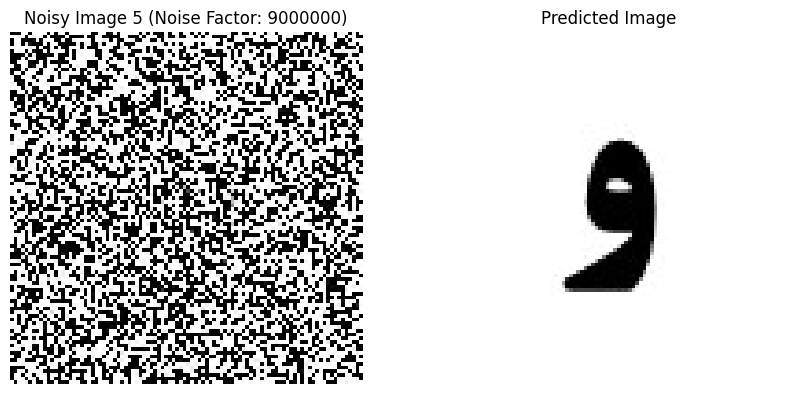

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


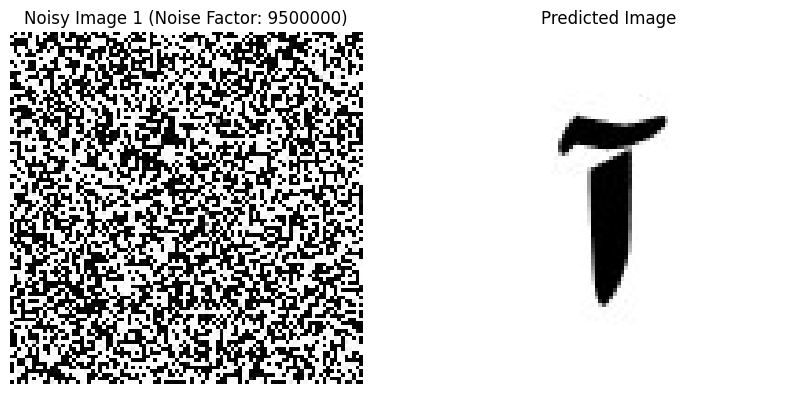

Given Image: noisy1.jpg, Predicted Image Index: 1


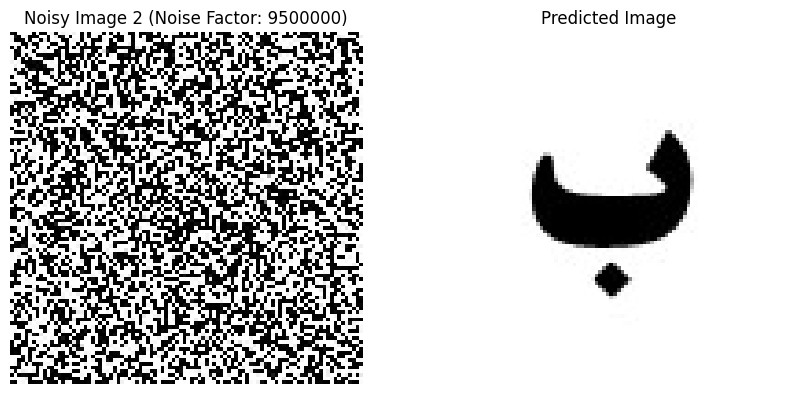

Given Image: noisy2.jpg, Predicted Image Index: 2


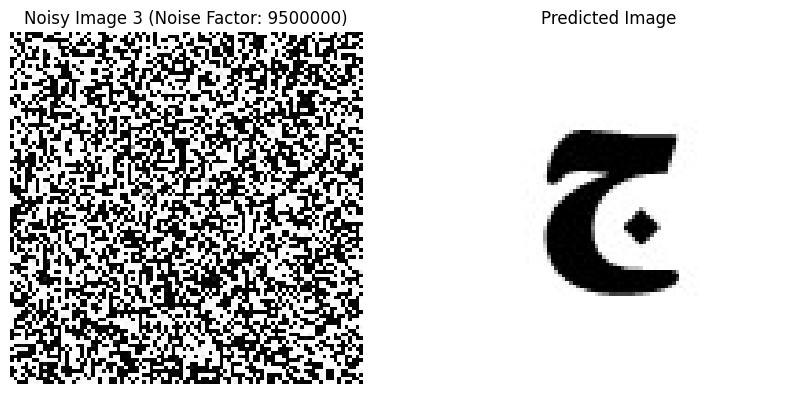

Given Image: noisy3.jpg, Predicted Image Index: 3


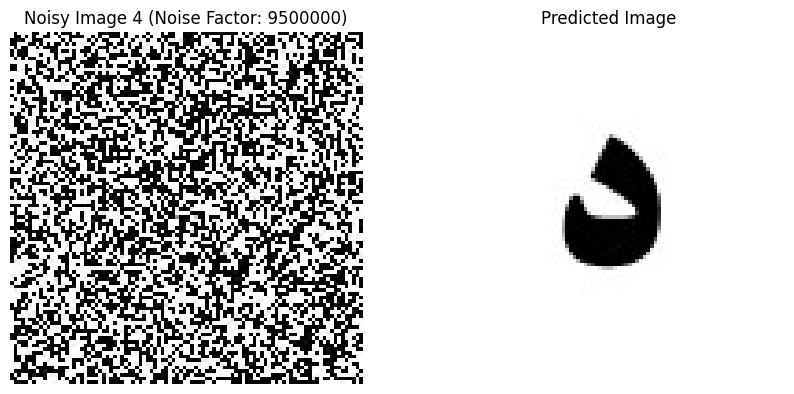

Given Image: noisy4.jpg, Predicted Image Index: 4


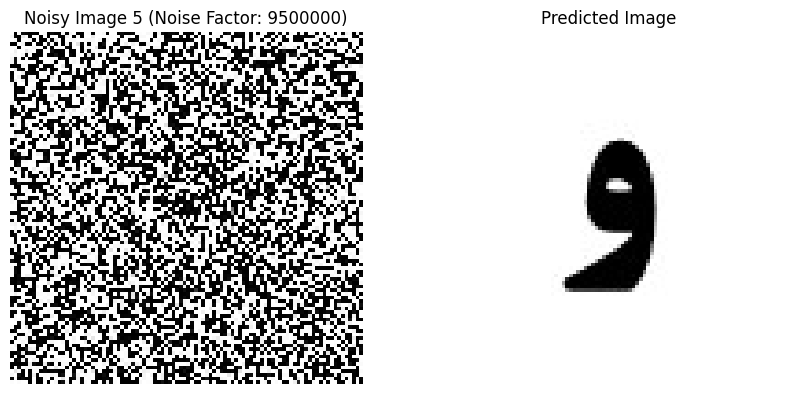

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated and saved as noisy1.jpg
Noisy image for 2.jpg generated and saved as noisy2.jpg
Noisy image for 3.jpg generated and saved as noisy3.jpg
Noisy image for 4.jpg generated and saved as noisy4.jpg
Noisy image for 5.jpg generated and saved as noisy5.jpg


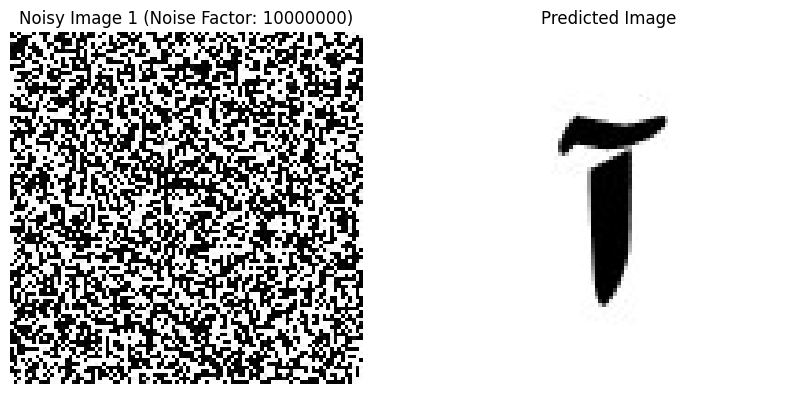

Given Image: noisy1.jpg, Predicted Image Index: 1


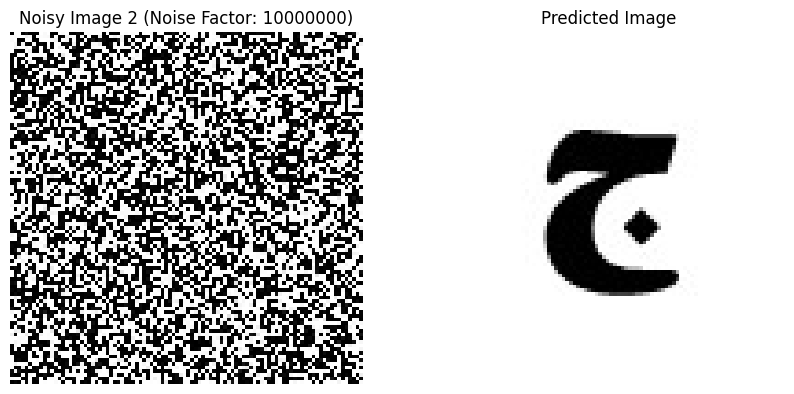

Given Image: noisy2.jpg, Predicted Image Index: 3
Prediction error at noise factor 10000000 for image 2
The highest noise factor where the network was still accurate: 9500000


In [28]:
from PIL import Image, ImageDraw
import numpy as np
import random
import matplotlib.pyplot as plt

# Function to convert images to binary
def convertImageToBinary(path):
    image = Image.open(path)
    draw = ImageDraw.Draw(image)
    width, height = image.size
    pix = image.load()
    factor = 100
    binary_representation = []

    for i in range(width):
        for j in range(height):
            red, green, blue = pix[i, j]
            total_intensity = red + green + blue

            if total_intensity > (((255 + factor) // 2) * 3):
                red, green, blue = 255, 255, 255
                binary_representation.append(-1)
            else:
                red, green, blue = 0, 0, 0
                binary_representation.append(1)

            draw.point((i, j), (red, green, blue))

    del draw  # Clean up drawing tool
    return binary_representation

# Function to add black-and-white noise to images and save as file
def getNoisyBinaryImage(input_path, output_path, noise_factor):
    image = Image.open(input_path)
    draw = ImageDraw.Draw(image)
    width, height = image.size
    pix = image.load()

    # Loop through all pixels in the image.
    for i in range(width):
        for j in range(height):
            if random.random() < noise_factor / 10000000:  # Adjust this line to add reasonable noise
                if random.random() > 0.5:
                    color = (255, 255, 255)  # White pixel
                else:
                    color = (0, 0, 0)  # Black pixel
                draw.point((i, j), color)

    image.save(output_path, "JPEG")
    del draw

def generateNoisyImages(noise_factor):
    image_paths = [f"{i}.jpg" for i in range(1, 6)]

    for i, image_path in enumerate(image_paths, start=1):
        noisy_image_path = f"noisy{i}.jpg"
        getNoisyBinaryImage(image_path, noisy_image_path, noise_factor)
        print(f"Noisy image for {image_path} generated and saved as {noisy_image_path}")

# Define the Hamming Network class
class HammingNetwork:
    def __init__(self, num_neurons):
        self.num_neurons = num_neurons
        self.weights = None
        self.bias = None

    def train(self, inputs):
        self.weights = np.array(inputs)
        self.bias = np.ones(self.num_neurons) * 0.5 * len(inputs[0]) * 3

    def predict(self, input_image):
        product = np.dot(self.weights, input_image)
        stored = product - self.bias
        return np.argmax(stored)

# Function to display images side-by-side for comparison
def display_images(noisy_image_pil, predicted_image_pil, noise_factor, index):
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(noisy_image_pil)
    plt.title(f'Noisy Image {index+1} (Noise Factor: {noise_factor})')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(predicted_image_pil)
    plt.title(f'Predicted Image')
    plt.axis('off')

    plt.show()

# Paths to original images
image_paths = [f"{i}.jpg" for i in range(1, 6)]

# Initialize and train the Hamming Network using clean images
network = HammingNetwork(num_neurons=len(image_paths))
training_data = [convertImageToBinary(path) for path in image_paths]
network.train(training_data)

# Initial noise factor
noise_factor = 0  # Start with a noise factor of 0

# Test with increasing noisy images, show both images until the first incorrect prediction
last_correct_noise_factor = 0

while True:
    correct_predictions = 0

    generateNoisyImages(noise_factor)  # Generate noisy images with the current noise factor
    noisy_image_paths = [f"noisy{i}.jpg" for i in range(1, 6)]

    for i, path in enumerate(noisy_image_paths):
        noisy_image = np.array(convertImageToBinary(path)).flatten()
        prediction = network.predict(noisy_image)

        # Display the noisy image and predicted image
        noisy_image_pil = Image.open(path)
        predicted_image_pil = Image.open(image_paths[prediction])
        display_images(noisy_image_pil, predicted_image_pil, noise_factor, i)

        print(f"Given Image: {path}, Predicted Image Index: {prediction + 1}")

        if prediction != i:
            print(f"Prediction error at noise factor {noise_factor} for image {i+1}")
            break
        else:
            correct_predictions += 1

    if correct_predictions == len(image_paths):
        last_correct_noise_factor = noise_factor  # Update last correct noise factor
    else:
        break  # Stop loop if the network makes an incorrect prediction

    noise_factor += 500000  # Increase noise factor incrementally by 500000

print(f"The highest noise factor where the network was still accurate: {last_correct_noise_factor}")


**Quest 3 Part 3**

Noisy image for 1.jpg generated with 5 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 7 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 9 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 5 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 5 missing points and saved as noisy5.jpg


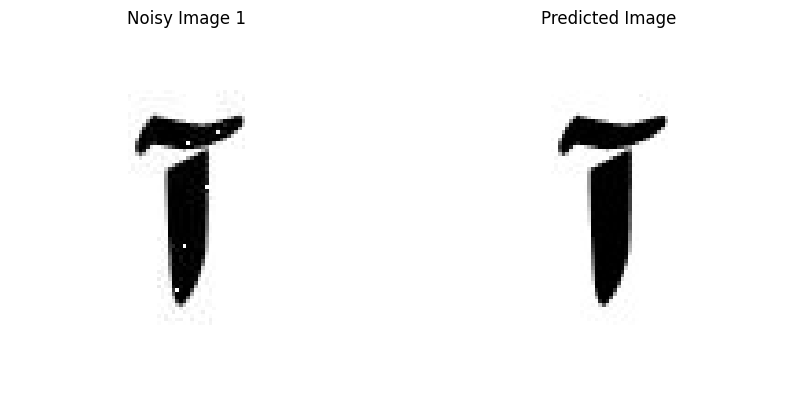

Given Image: noisy1.jpg, Predicted Image Index: 1


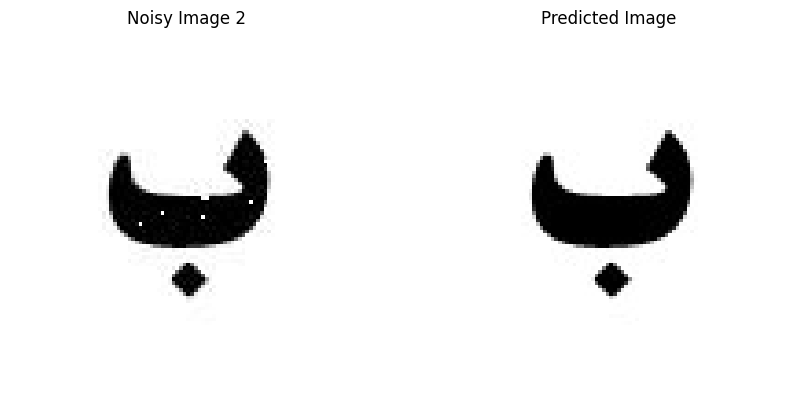

Given Image: noisy2.jpg, Predicted Image Index: 2


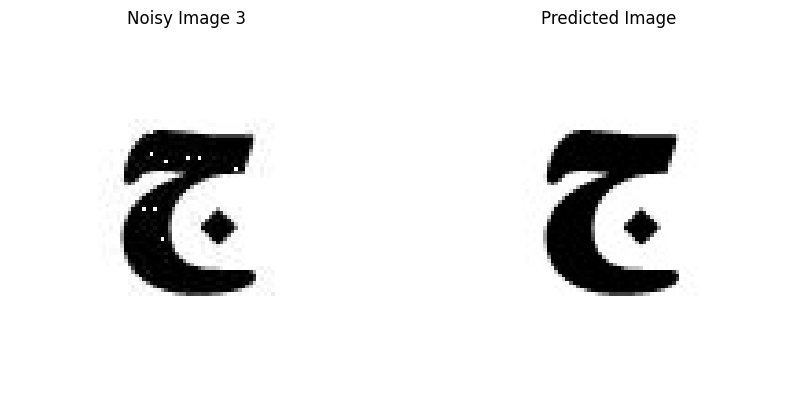

Given Image: noisy3.jpg, Predicted Image Index: 3


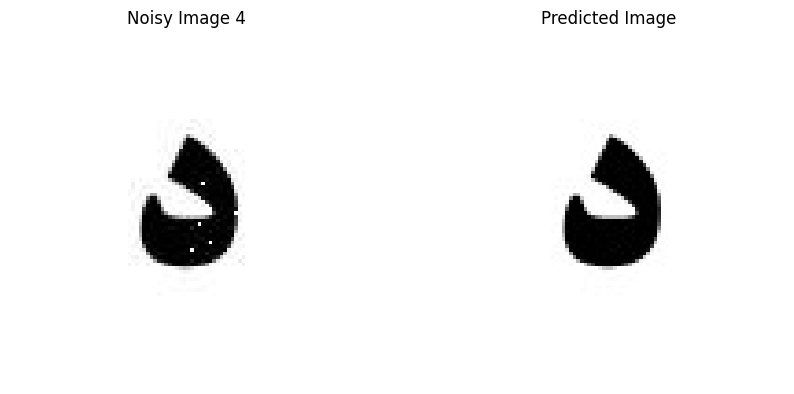

Given Image: noisy4.jpg, Predicted Image Index: 4


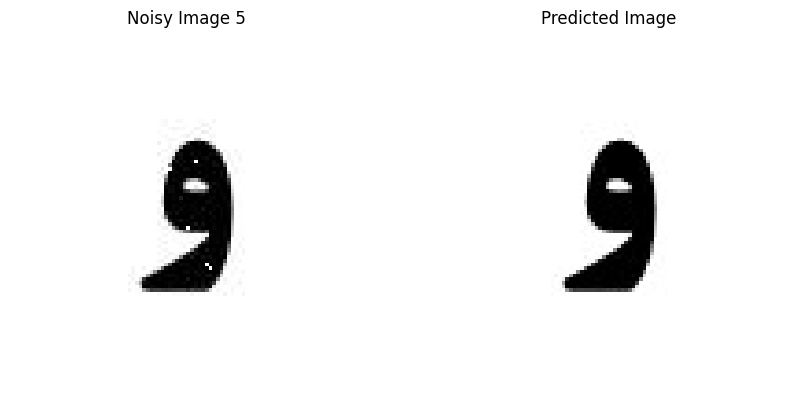

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 11 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 15 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 18 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 10 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 11 missing points and saved as noisy5.jpg


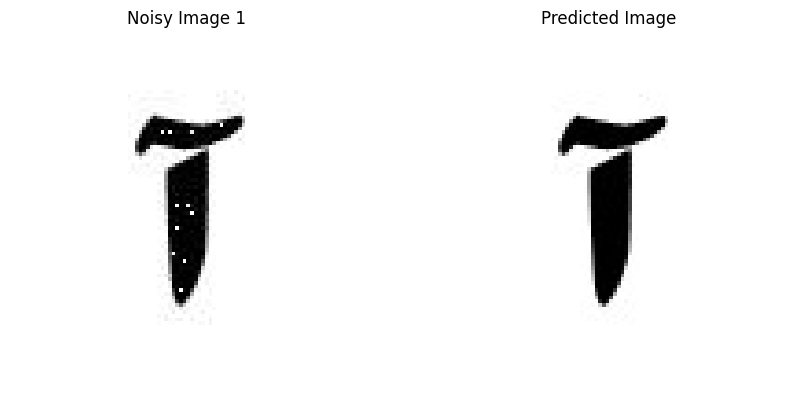

Given Image: noisy1.jpg, Predicted Image Index: 1


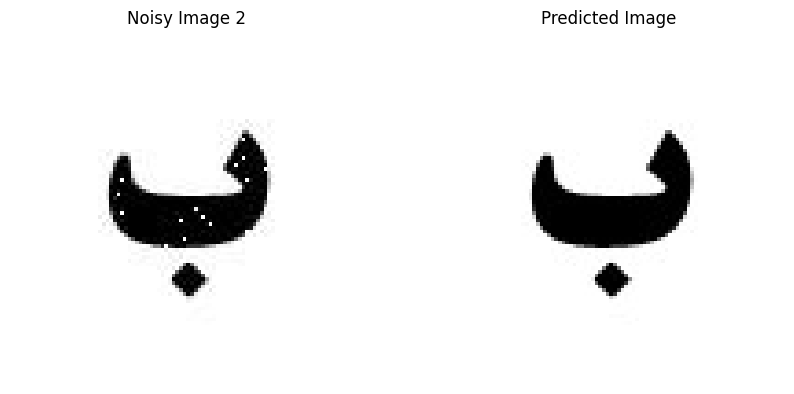

Given Image: noisy2.jpg, Predicted Image Index: 2


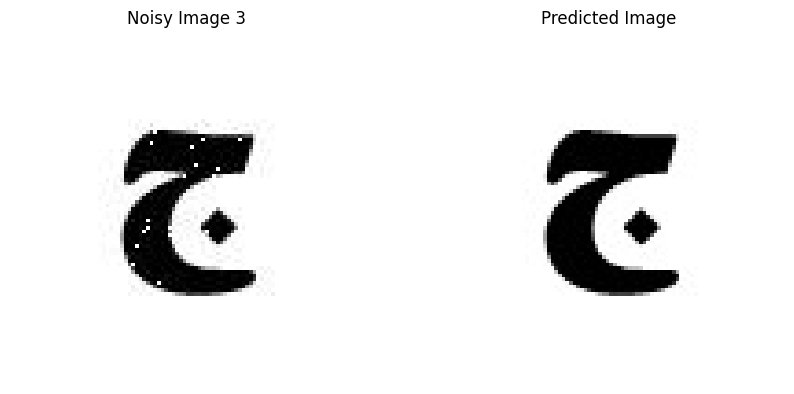

Given Image: noisy3.jpg, Predicted Image Index: 3


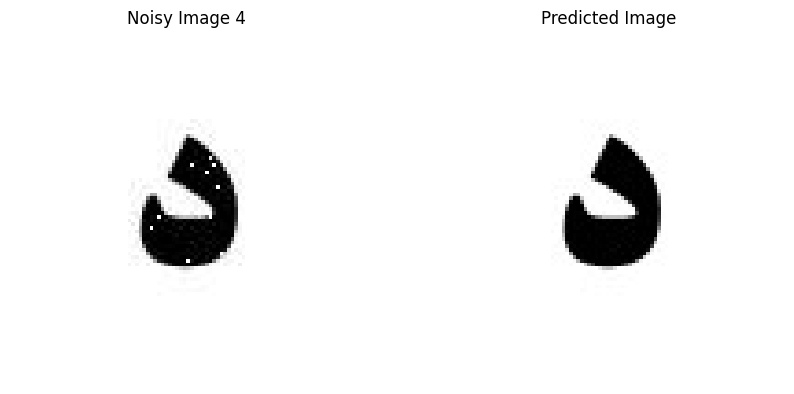

Given Image: noisy4.jpg, Predicted Image Index: 4


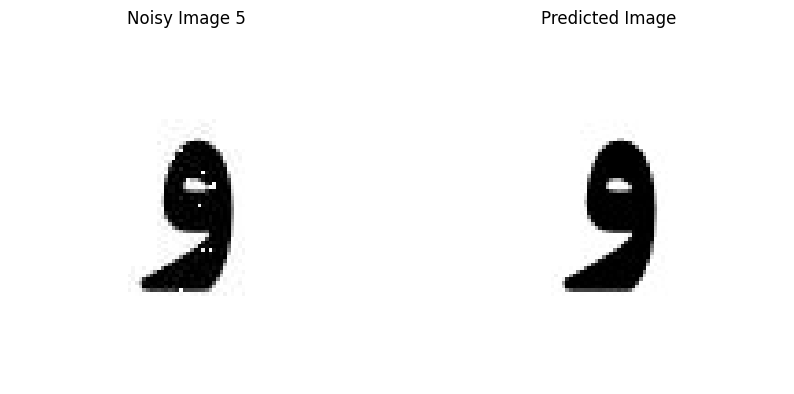

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 16 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 23 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 27 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 16 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 17 missing points and saved as noisy5.jpg


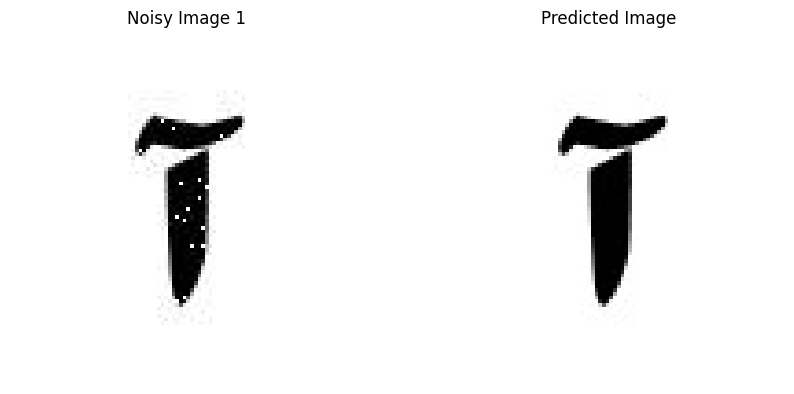

Given Image: noisy1.jpg, Predicted Image Index: 1


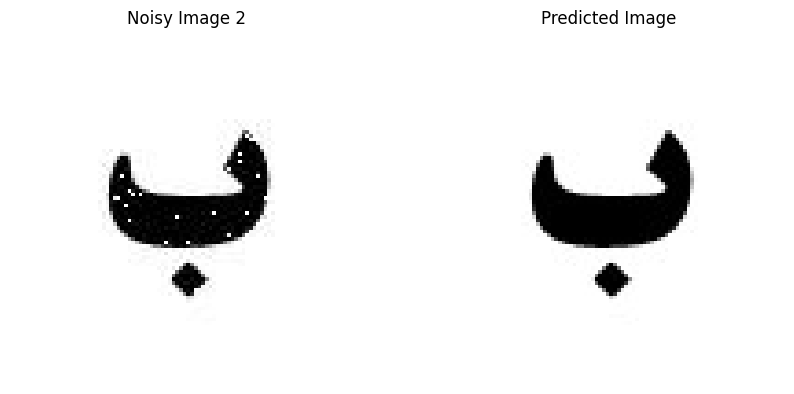

Given Image: noisy2.jpg, Predicted Image Index: 2


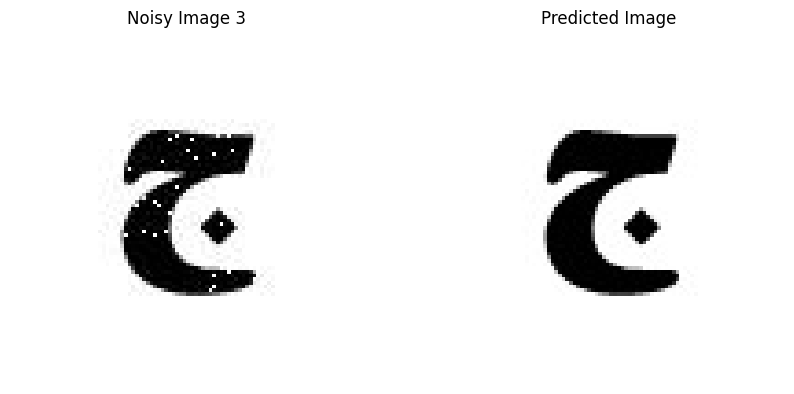

Given Image: noisy3.jpg, Predicted Image Index: 3


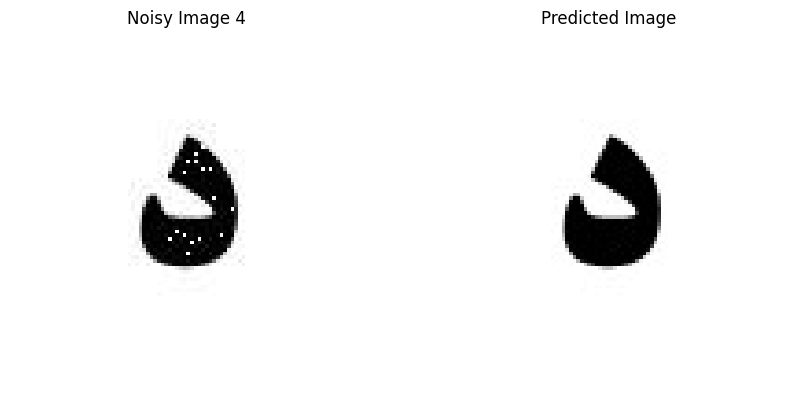

Given Image: noisy4.jpg, Predicted Image Index: 4


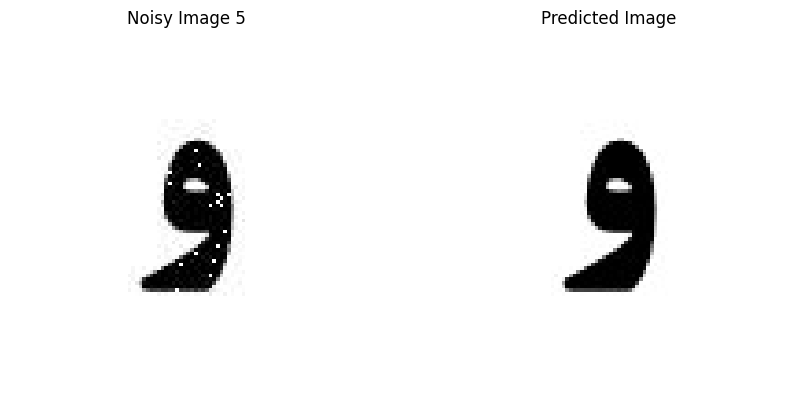

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 22 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 30 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 36 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 21 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 23 missing points and saved as noisy5.jpg


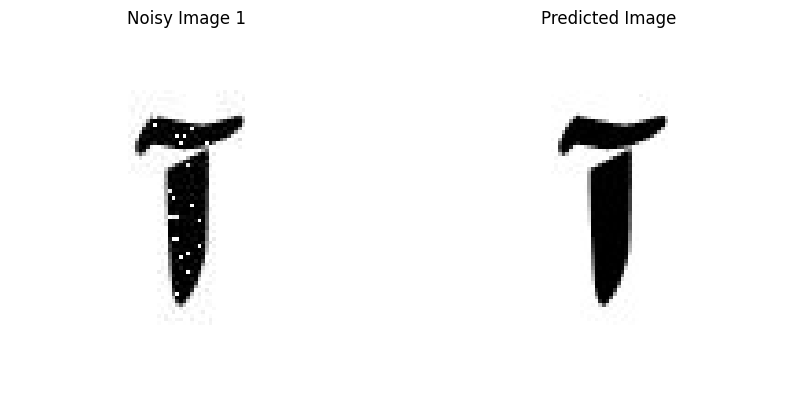

Given Image: noisy1.jpg, Predicted Image Index: 1


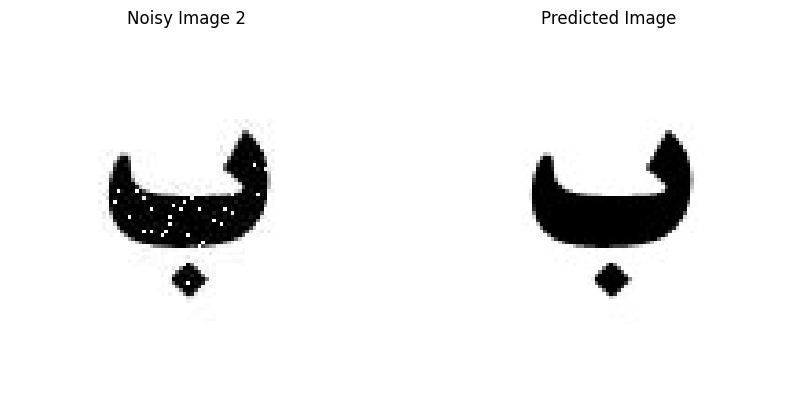

Given Image: noisy2.jpg, Predicted Image Index: 2


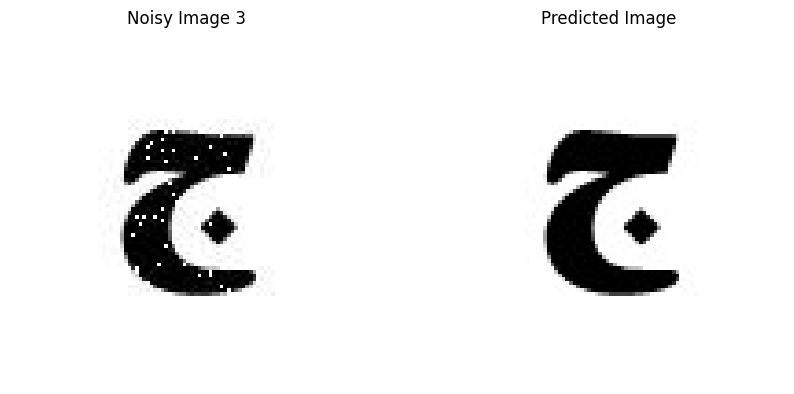

Given Image: noisy3.jpg, Predicted Image Index: 3


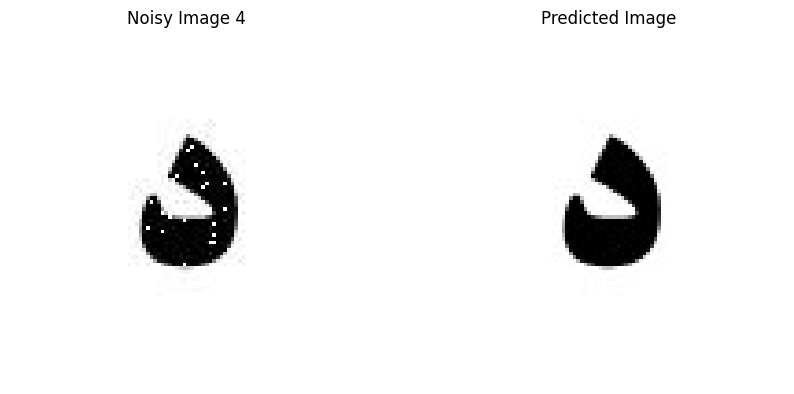

Given Image: noisy4.jpg, Predicted Image Index: 4


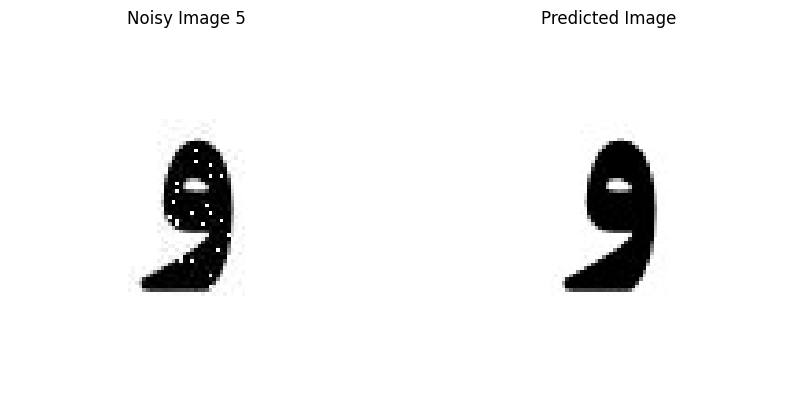

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 27 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 38 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 46 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 27 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 29 missing points and saved as noisy5.jpg


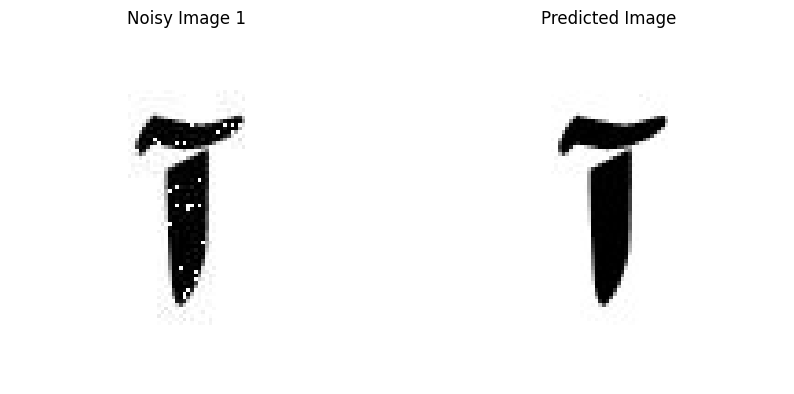

Given Image: noisy1.jpg, Predicted Image Index: 1


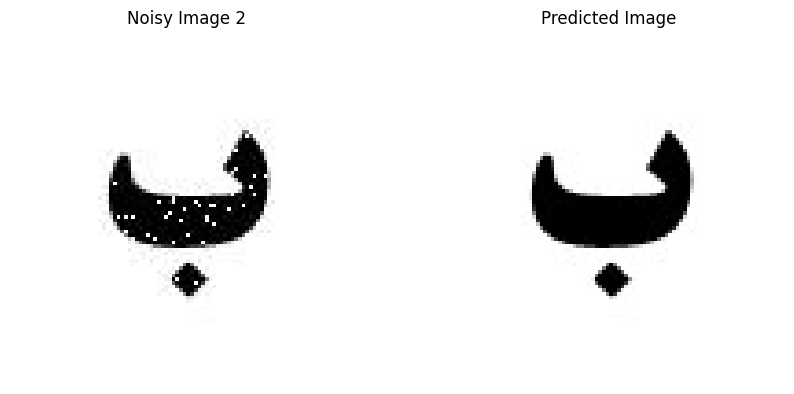

Given Image: noisy2.jpg, Predicted Image Index: 2


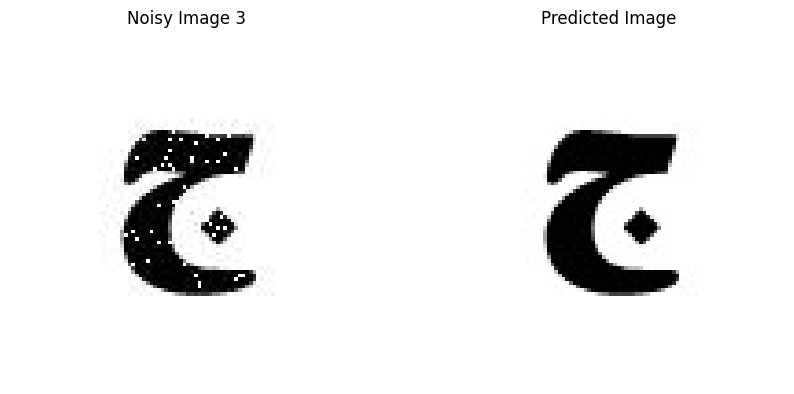

Given Image: noisy3.jpg, Predicted Image Index: 3


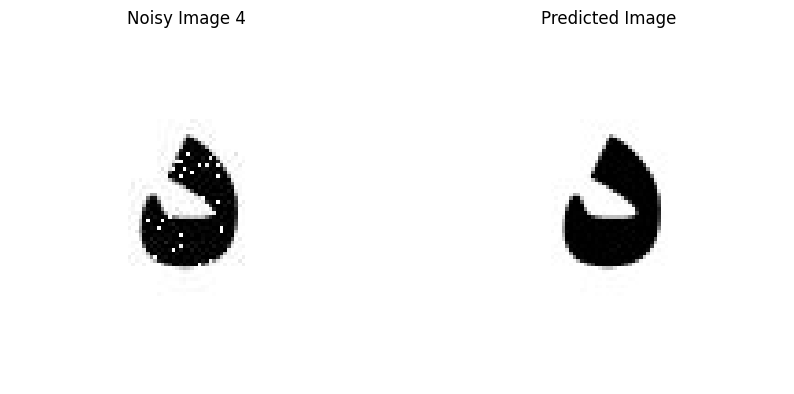

Given Image: noisy4.jpg, Predicted Image Index: 4


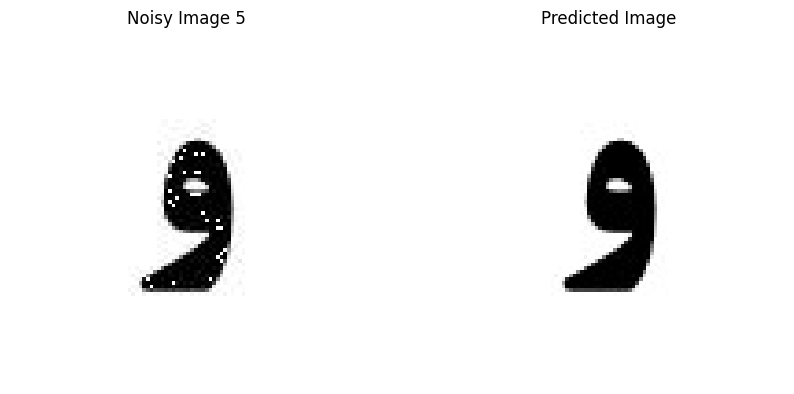

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 33 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 46 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 55 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 32 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 35 missing points and saved as noisy5.jpg


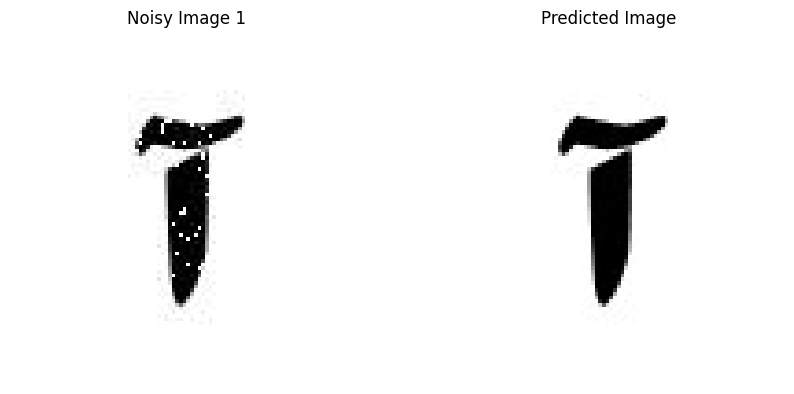

Given Image: noisy1.jpg, Predicted Image Index: 1


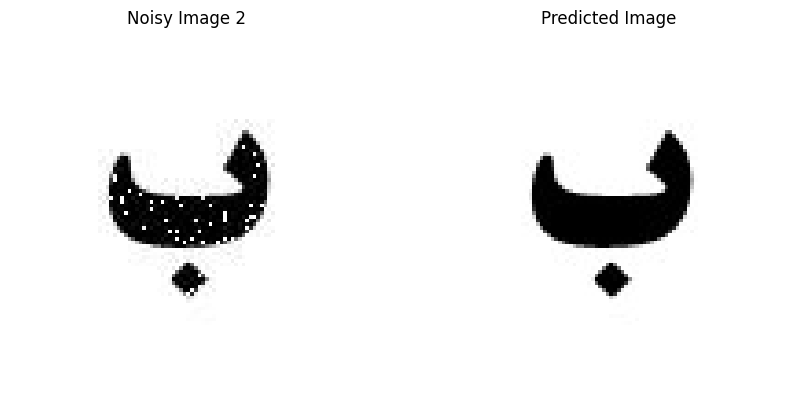

Given Image: noisy2.jpg, Predicted Image Index: 2


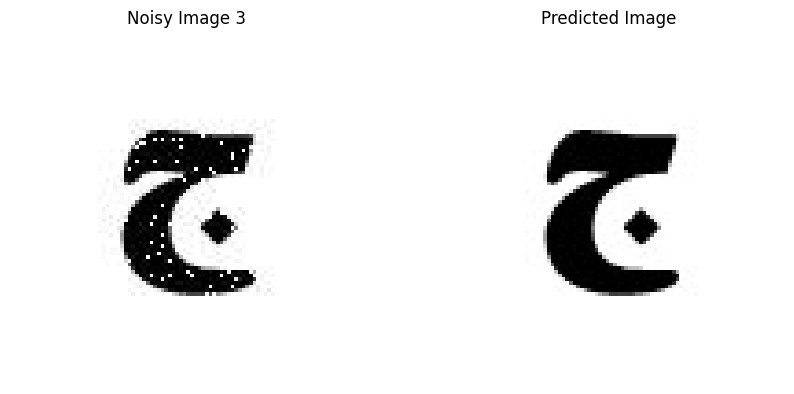

Given Image: noisy3.jpg, Predicted Image Index: 3


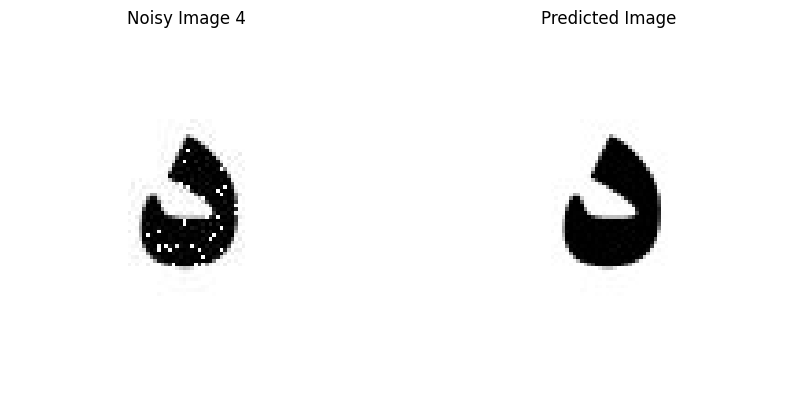

Given Image: noisy4.jpg, Predicted Image Index: 4


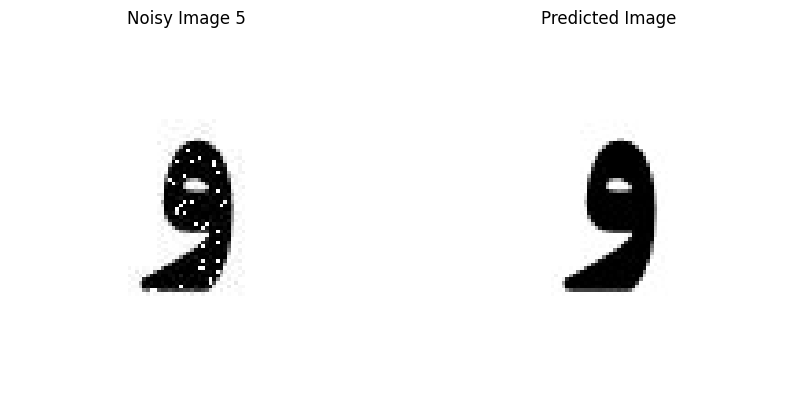

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 39 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 54 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 64 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 38 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 41 missing points and saved as noisy5.jpg


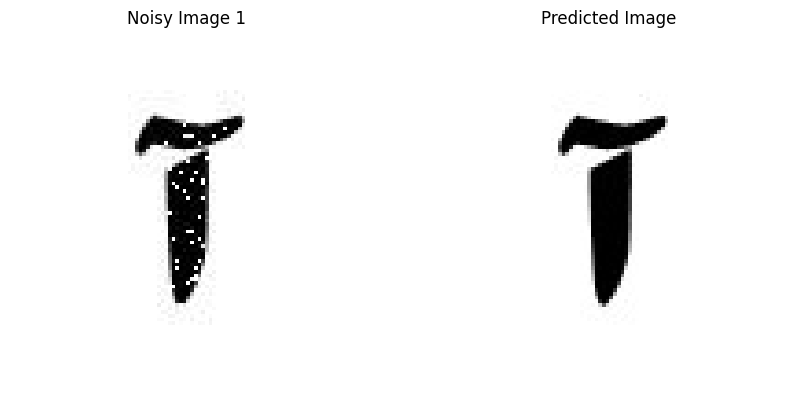

Given Image: noisy1.jpg, Predicted Image Index: 1


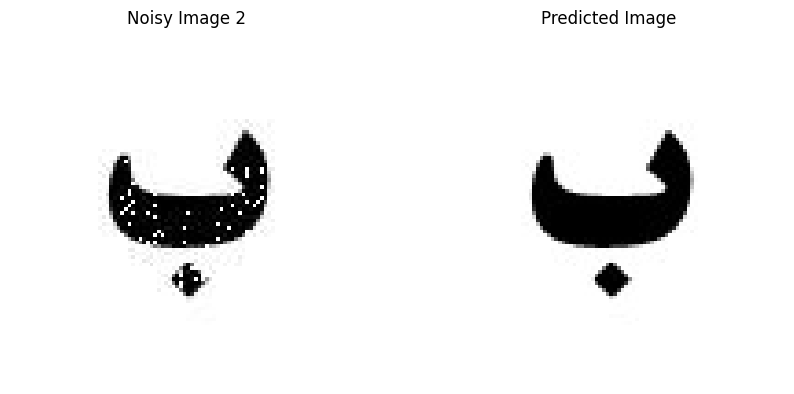

Given Image: noisy2.jpg, Predicted Image Index: 2


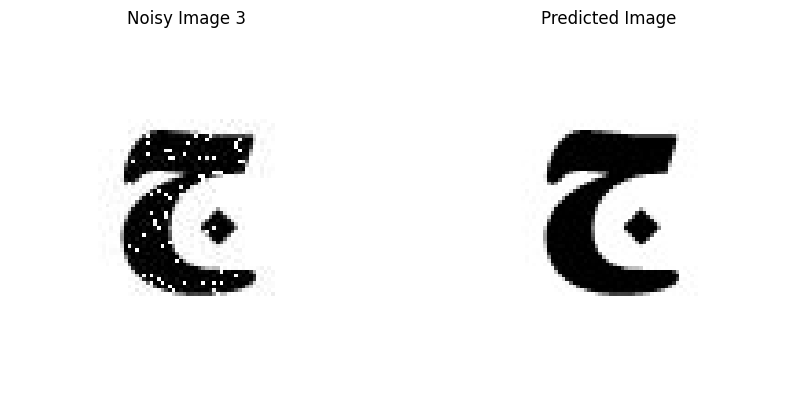

Given Image: noisy3.jpg, Predicted Image Index: 3


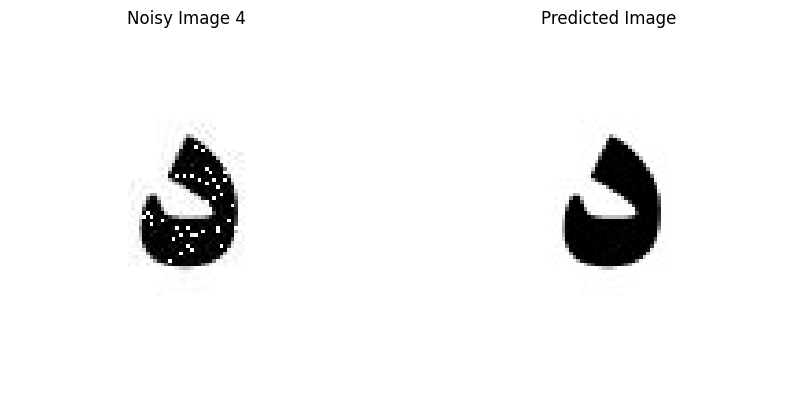

Given Image: noisy4.jpg, Predicted Image Index: 4


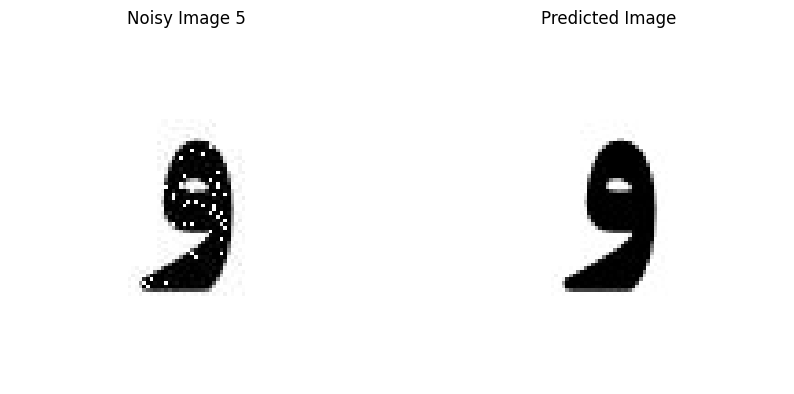

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 44 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 61 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 73 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 43 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 47 missing points and saved as noisy5.jpg


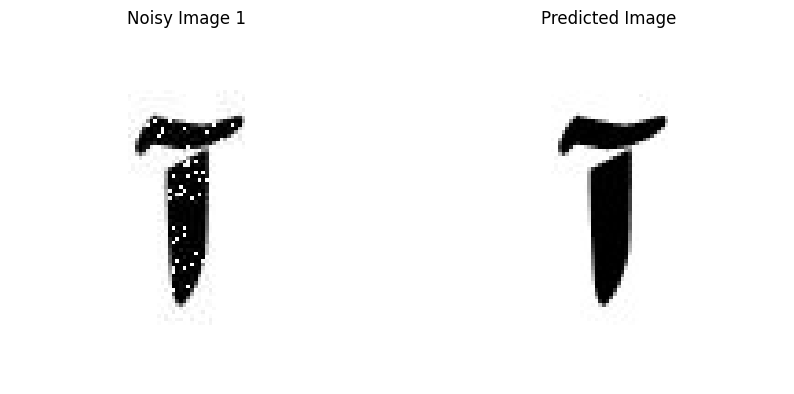

Given Image: noisy1.jpg, Predicted Image Index: 1


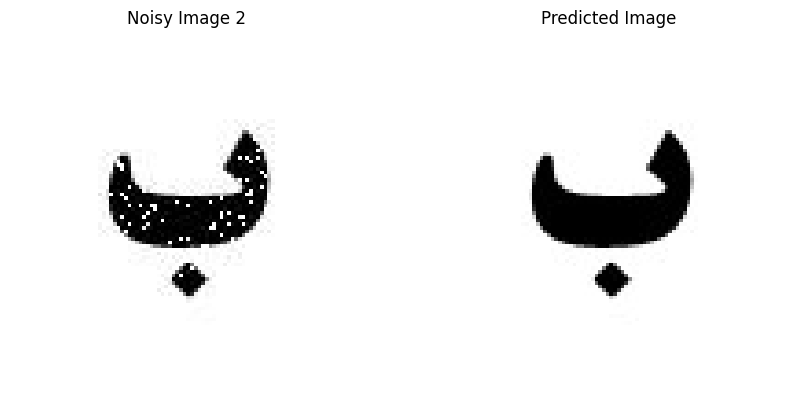

Given Image: noisy2.jpg, Predicted Image Index: 2


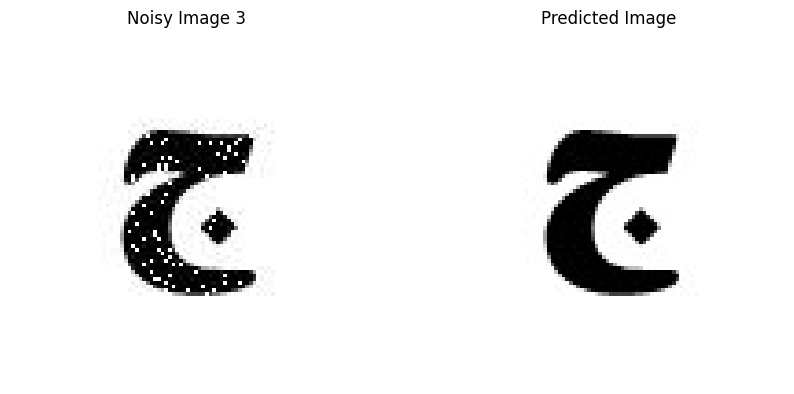

Given Image: noisy3.jpg, Predicted Image Index: 3


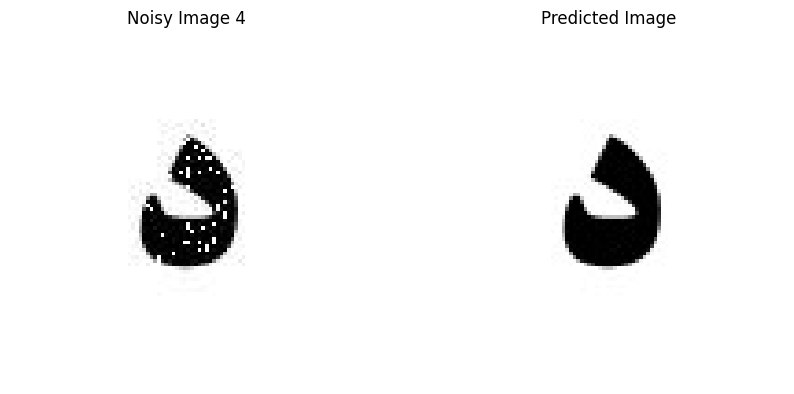

Given Image: noisy4.jpg, Predicted Image Index: 4


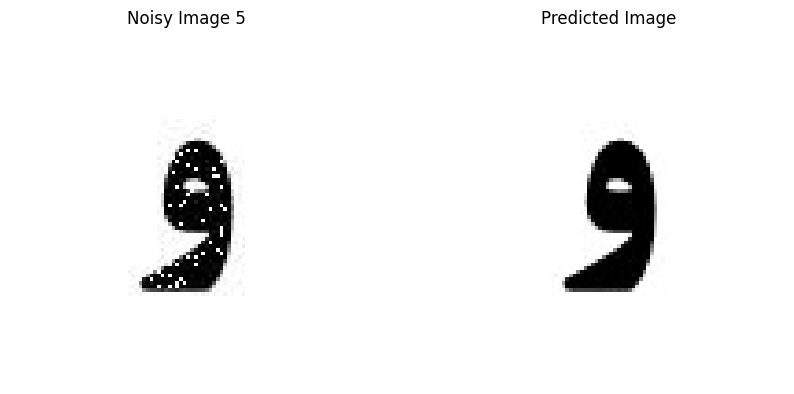

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 50 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 69 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 82 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 49 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 53 missing points and saved as noisy5.jpg


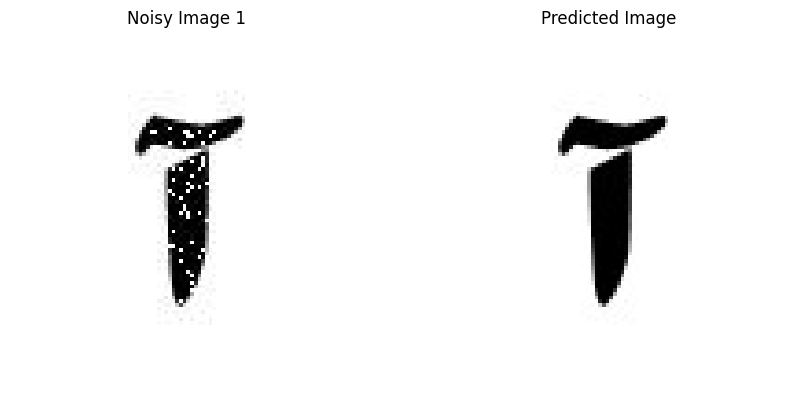

Given Image: noisy1.jpg, Predicted Image Index: 1


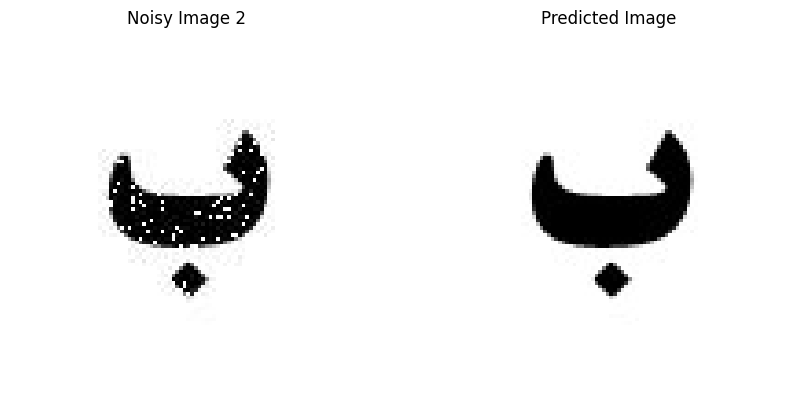

Given Image: noisy2.jpg, Predicted Image Index: 2


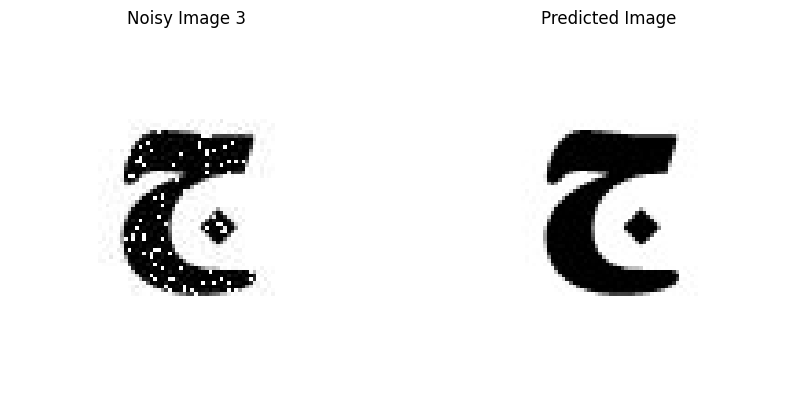

Given Image: noisy3.jpg, Predicted Image Index: 3


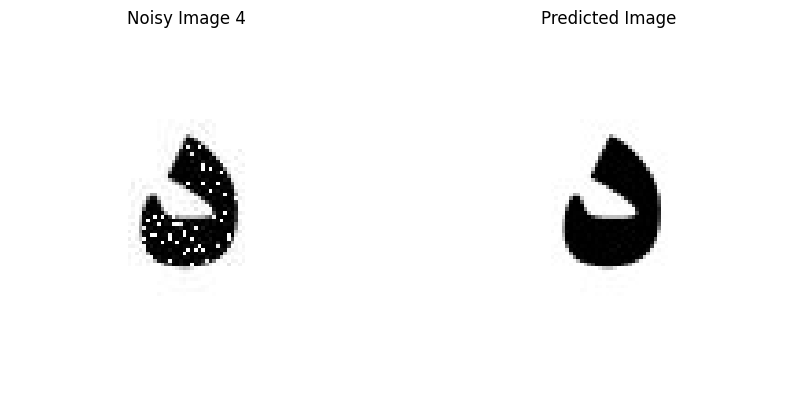

Given Image: noisy4.jpg, Predicted Image Index: 4


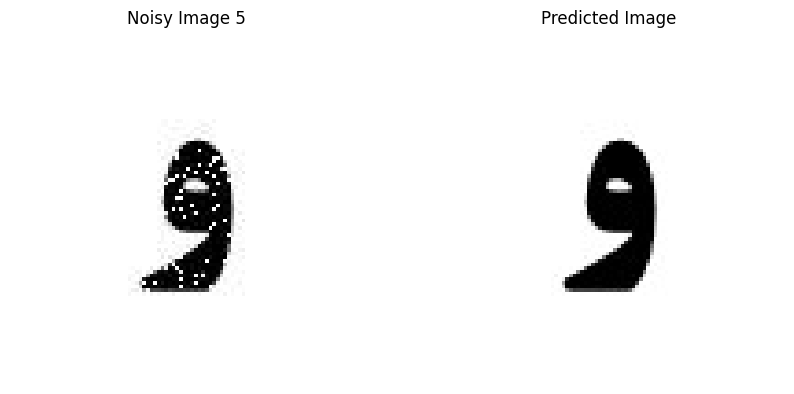

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 55 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 77 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 92 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 54 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 58 missing points and saved as noisy5.jpg


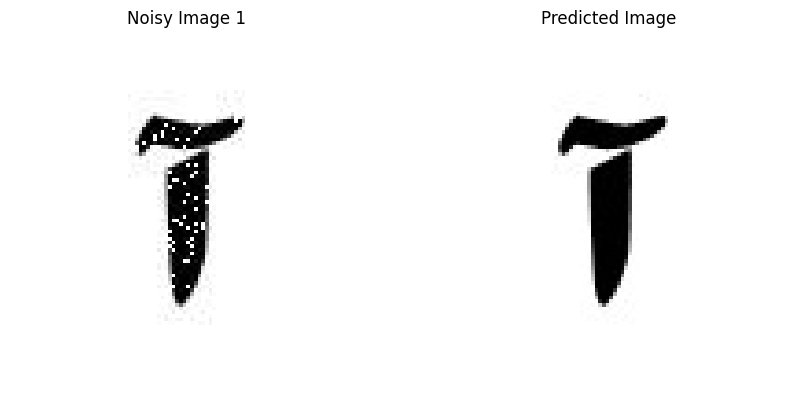

Given Image: noisy1.jpg, Predicted Image Index: 1


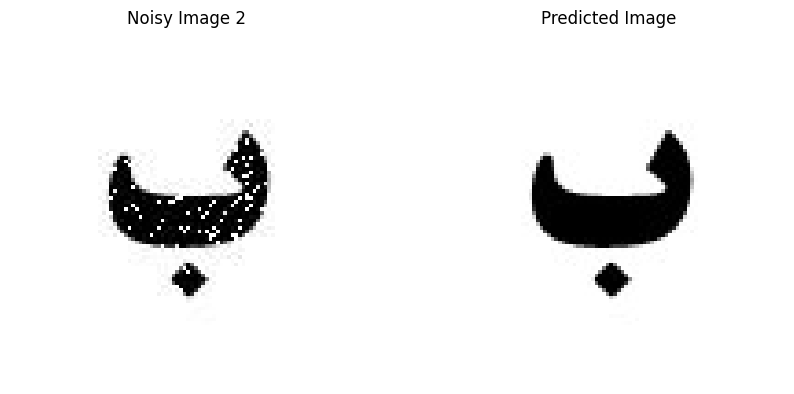

Given Image: noisy2.jpg, Predicted Image Index: 2


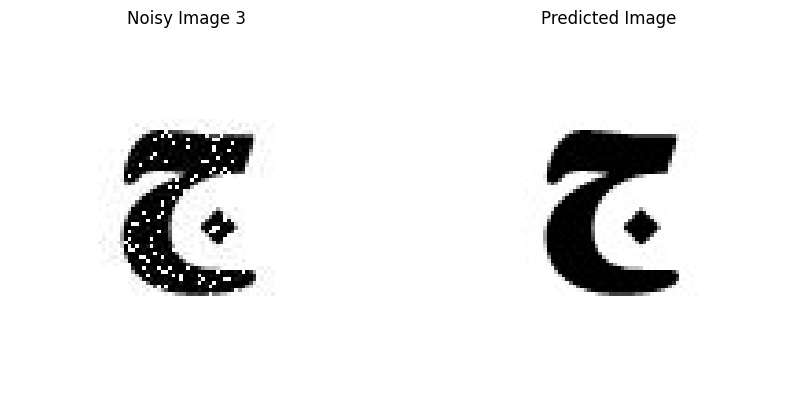

Given Image: noisy3.jpg, Predicted Image Index: 3


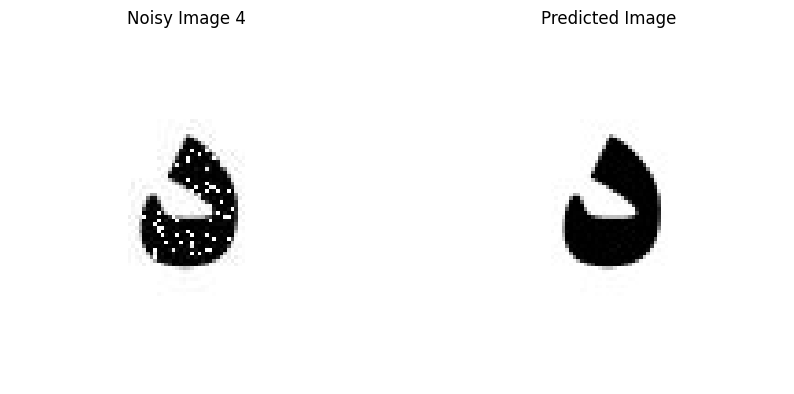

Given Image: noisy4.jpg, Predicted Image Index: 4


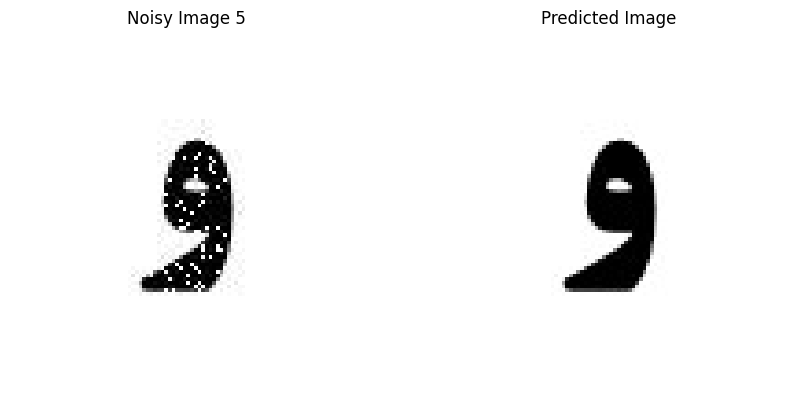

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 61 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 84 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 101 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 60 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 64 missing points and saved as noisy5.jpg


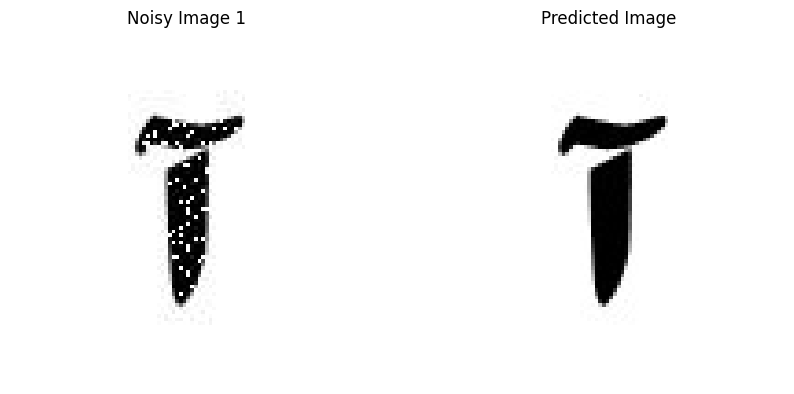

Given Image: noisy1.jpg, Predicted Image Index: 1


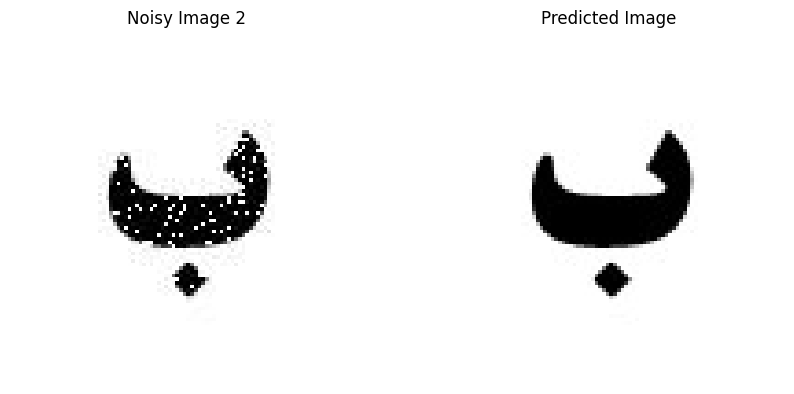

Given Image: noisy2.jpg, Predicted Image Index: 2


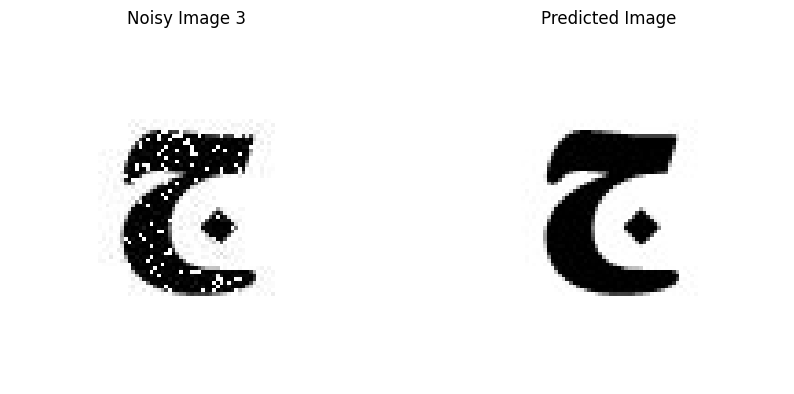

Given Image: noisy3.jpg, Predicted Image Index: 3


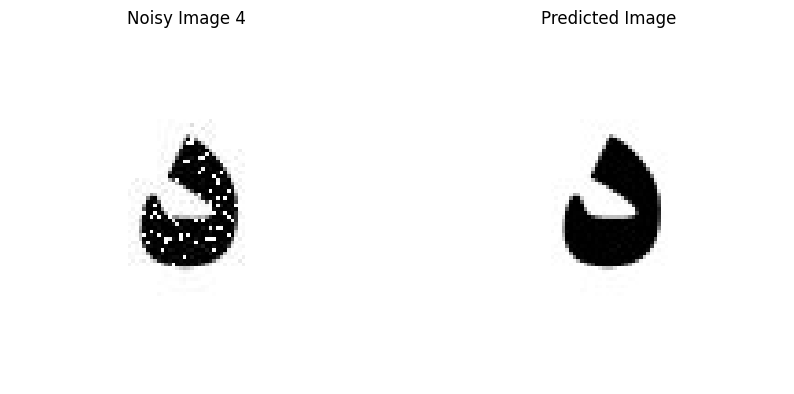

Given Image: noisy4.jpg, Predicted Image Index: 4


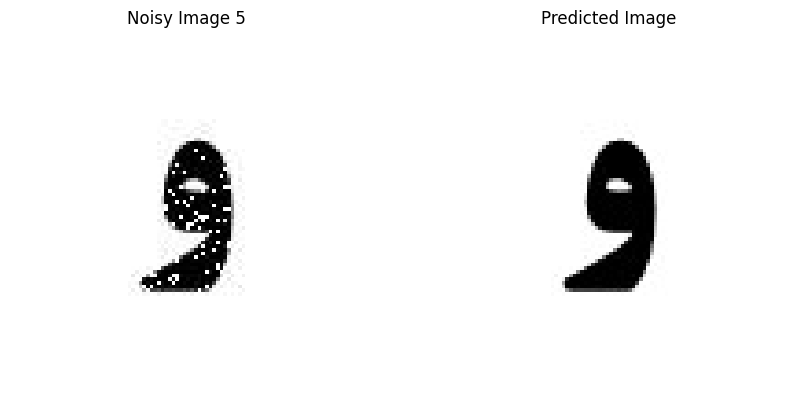

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 66 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 92 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 110 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 65 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 70 missing points and saved as noisy5.jpg


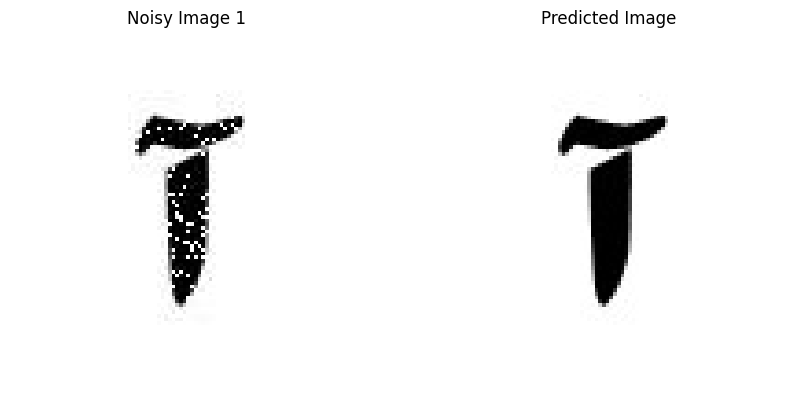

Given Image: noisy1.jpg, Predicted Image Index: 1


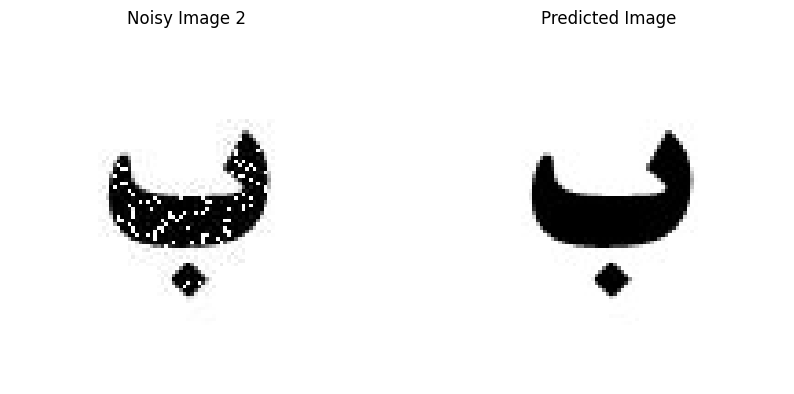

Given Image: noisy2.jpg, Predicted Image Index: 2


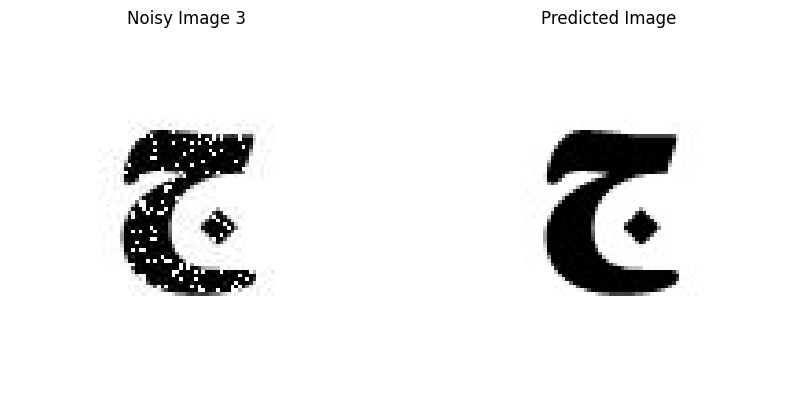

Given Image: noisy3.jpg, Predicted Image Index: 3


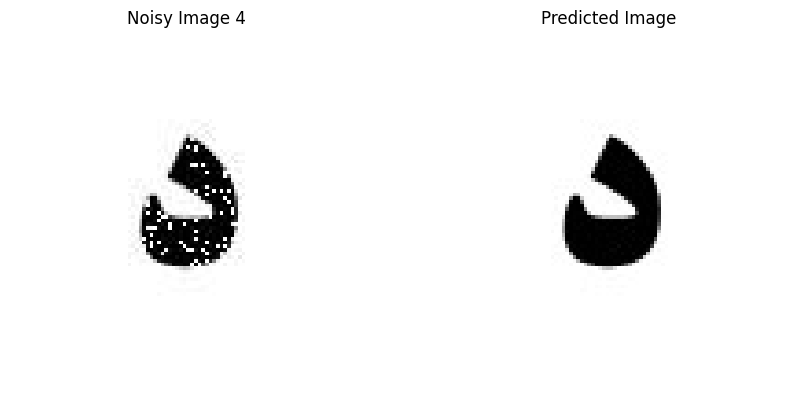

Given Image: noisy4.jpg, Predicted Image Index: 4


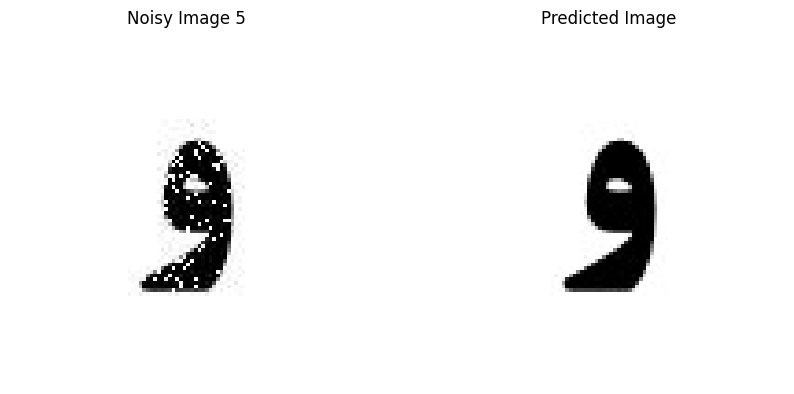

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 72 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 100 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 119 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 71 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 76 missing points and saved as noisy5.jpg


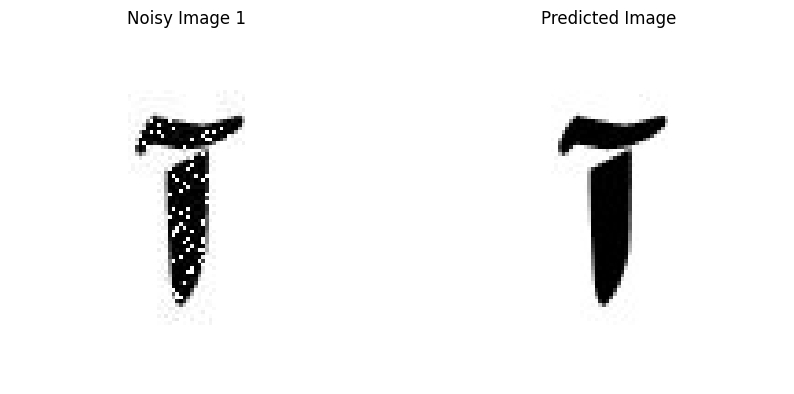

Given Image: noisy1.jpg, Predicted Image Index: 1


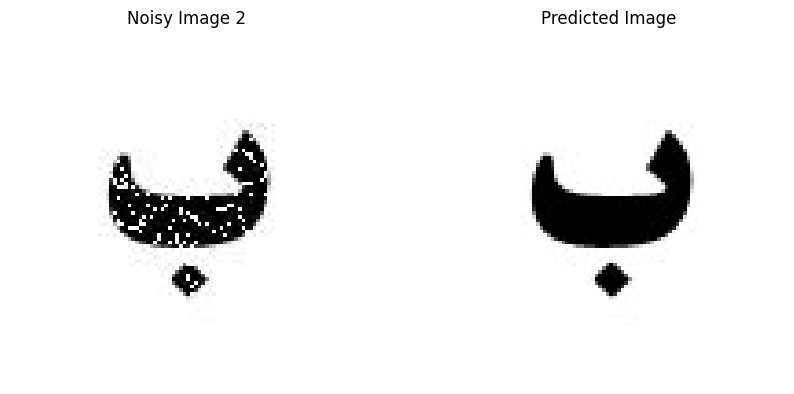

Given Image: noisy2.jpg, Predicted Image Index: 2


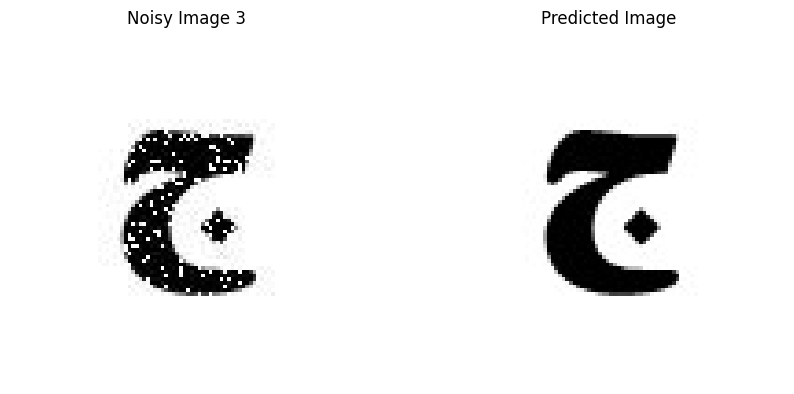

Given Image: noisy3.jpg, Predicted Image Index: 3


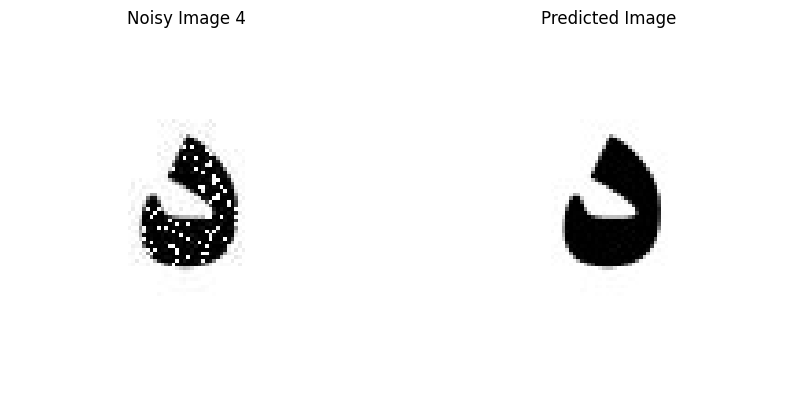

Given Image: noisy4.jpg, Predicted Image Index: 4


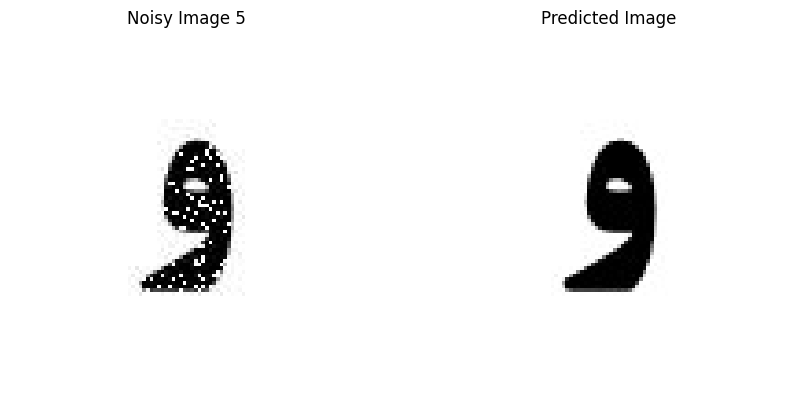

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 78 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 108 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 128 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 76 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 82 missing points and saved as noisy5.jpg


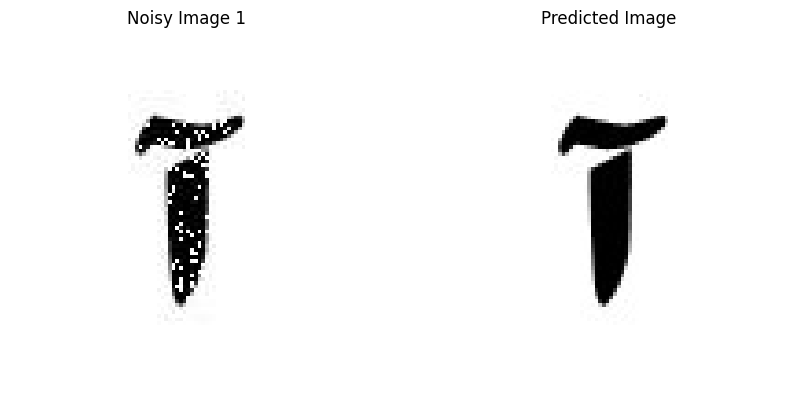

Given Image: noisy1.jpg, Predicted Image Index: 1


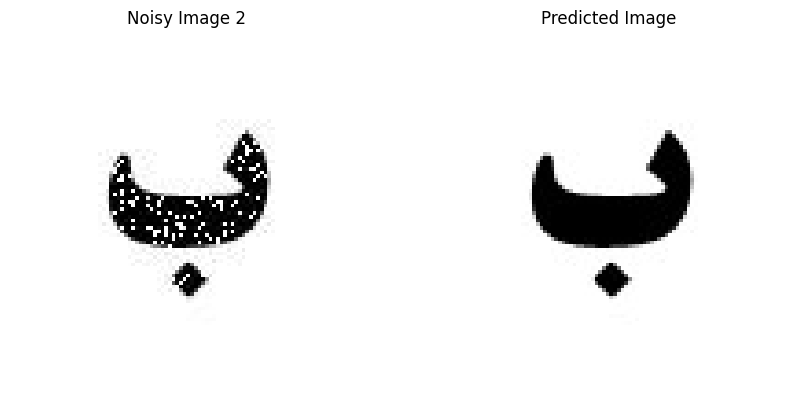

Given Image: noisy2.jpg, Predicted Image Index: 2


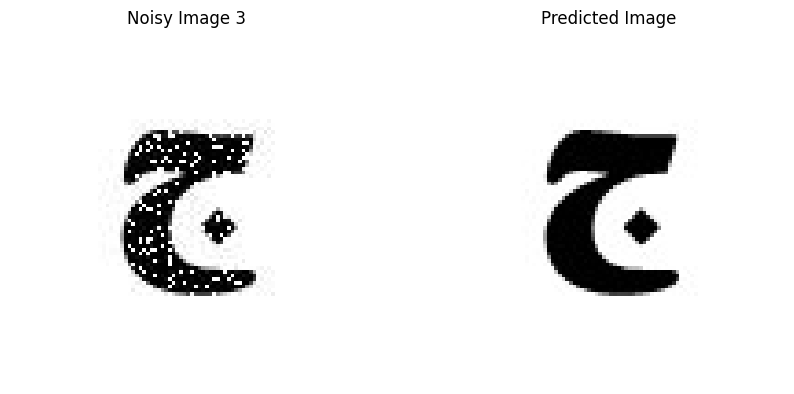

Given Image: noisy3.jpg, Predicted Image Index: 3


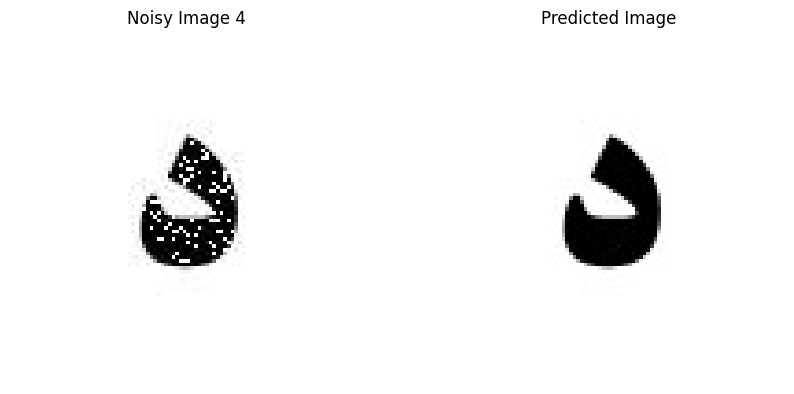

Given Image: noisy4.jpg, Predicted Image Index: 4


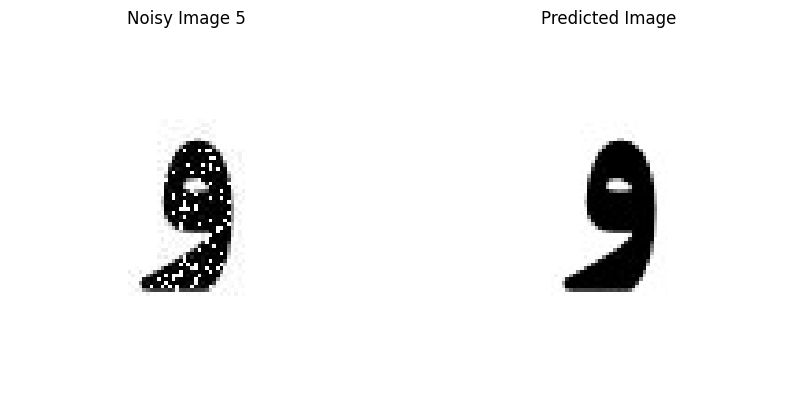

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 83 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 115 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 138 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 82 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 88 missing points and saved as noisy5.jpg


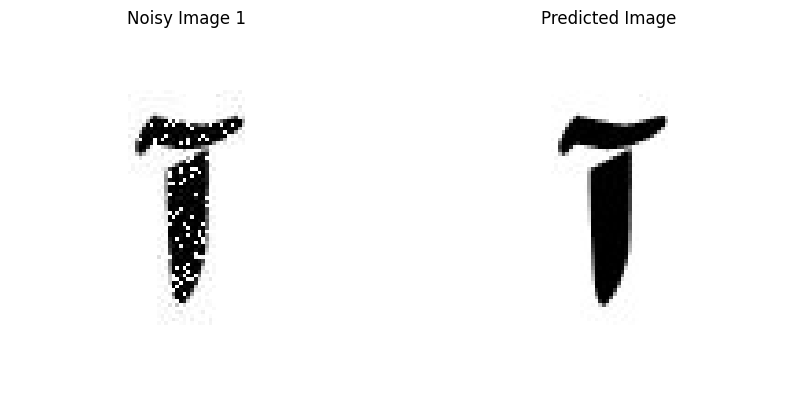

Given Image: noisy1.jpg, Predicted Image Index: 1


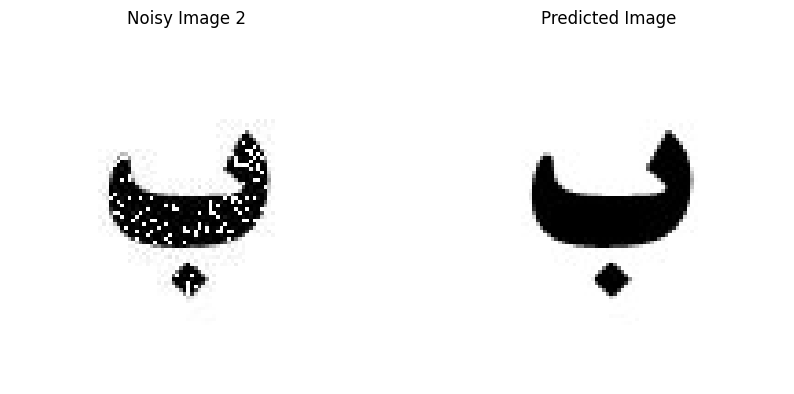

Given Image: noisy2.jpg, Predicted Image Index: 2


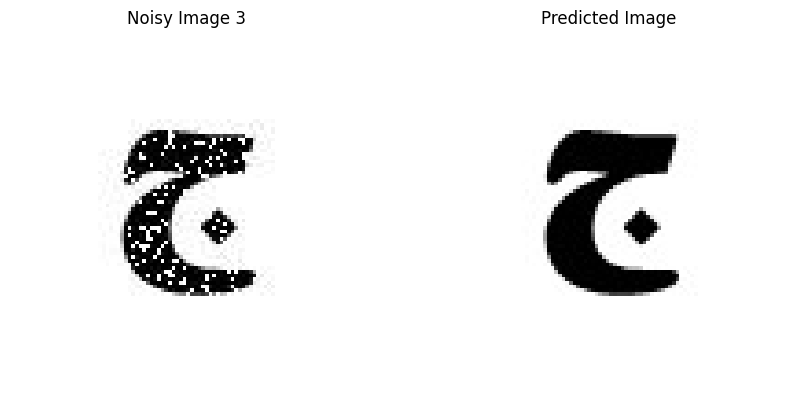

Given Image: noisy3.jpg, Predicted Image Index: 3


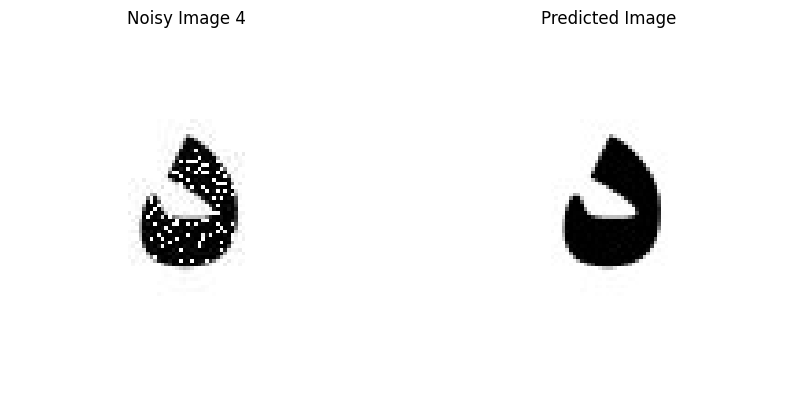

Given Image: noisy4.jpg, Predicted Image Index: 4


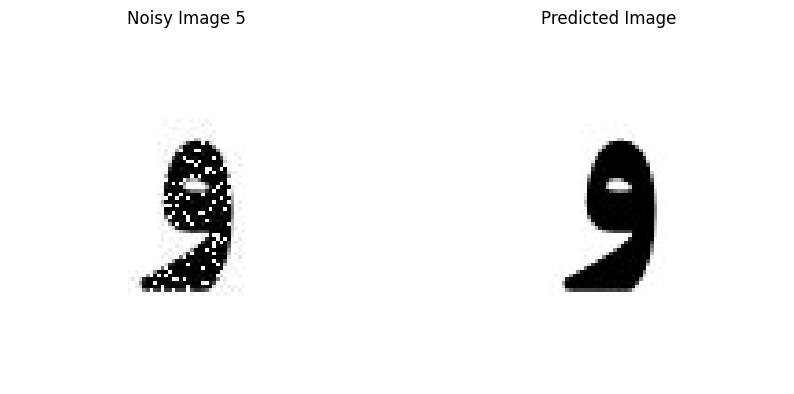

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 89 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 123 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 147 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 87 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 94 missing points and saved as noisy5.jpg


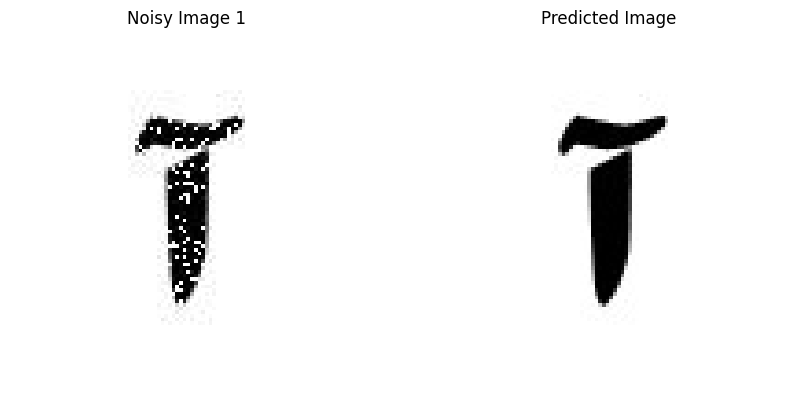

Given Image: noisy1.jpg, Predicted Image Index: 1


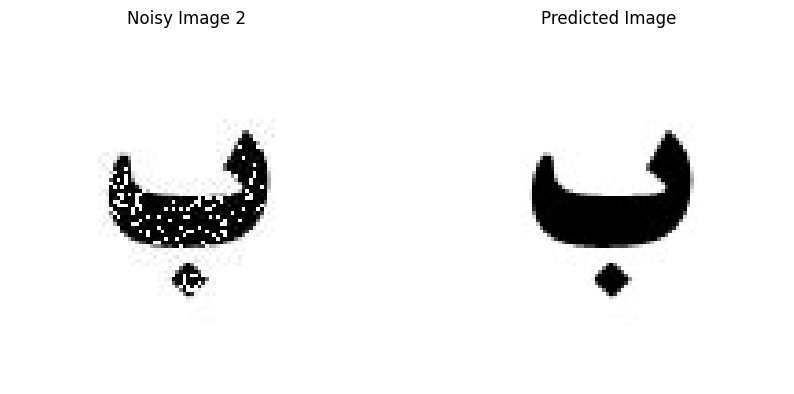

Given Image: noisy2.jpg, Predicted Image Index: 2


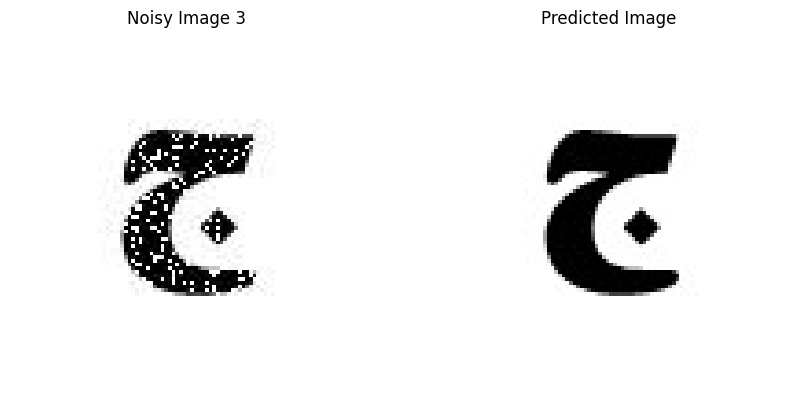

Given Image: noisy3.jpg, Predicted Image Index: 3


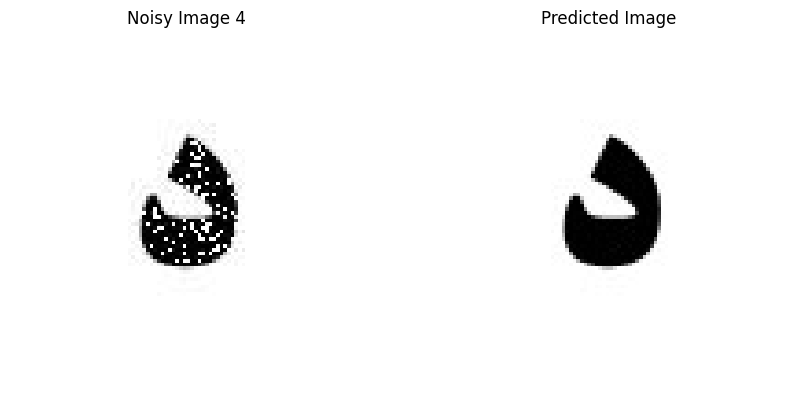

Given Image: noisy4.jpg, Predicted Image Index: 4


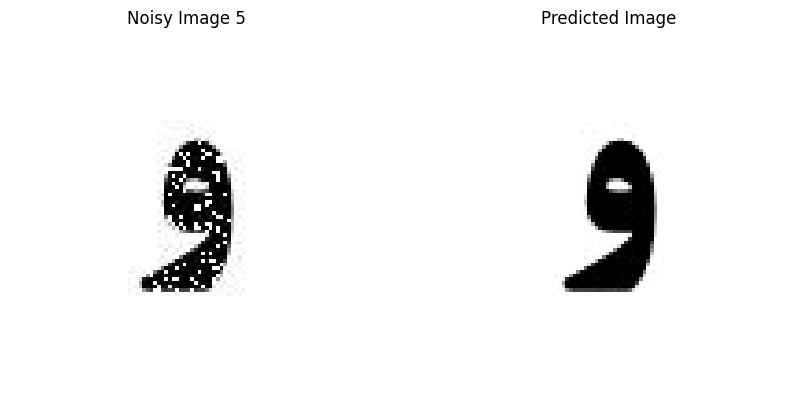

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 94 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 131 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 156 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 93 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 100 missing points and saved as noisy5.jpg


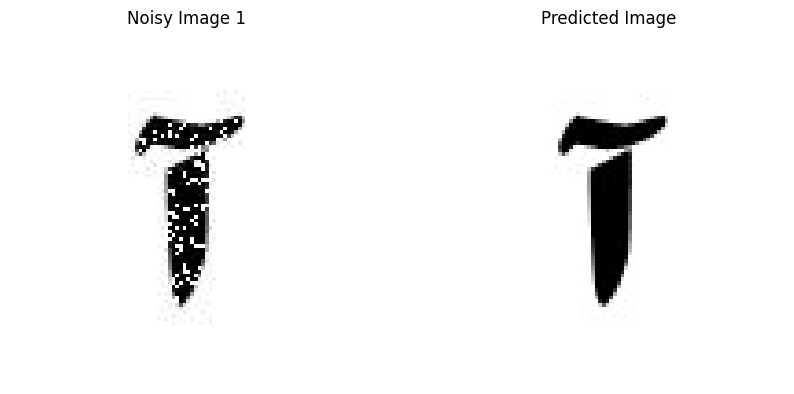

Given Image: noisy1.jpg, Predicted Image Index: 1


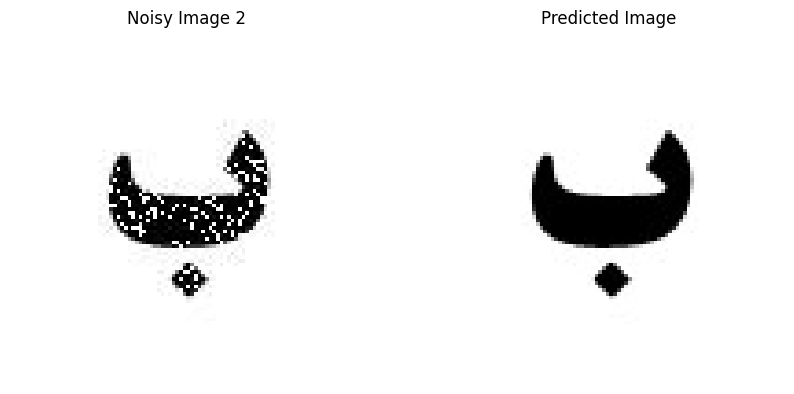

Given Image: noisy2.jpg, Predicted Image Index: 2


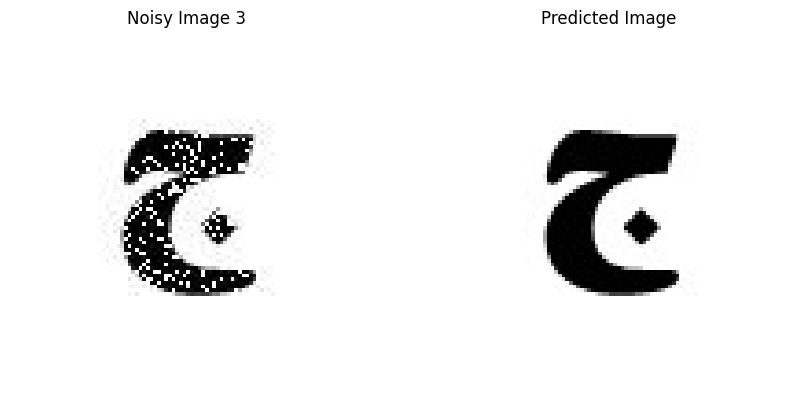

Given Image: noisy3.jpg, Predicted Image Index: 3


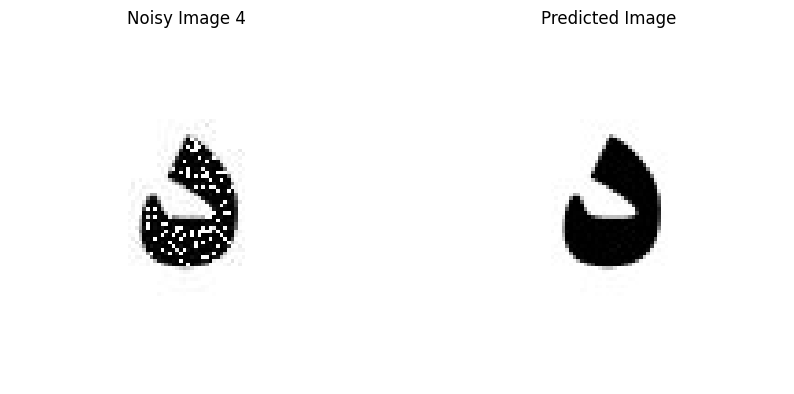

Given Image: noisy4.jpg, Predicted Image Index: 4


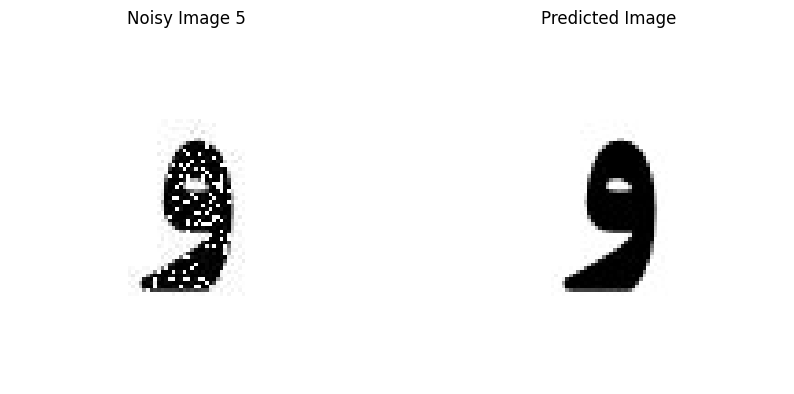

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 100 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 138 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 165 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 98 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 106 missing points and saved as noisy5.jpg


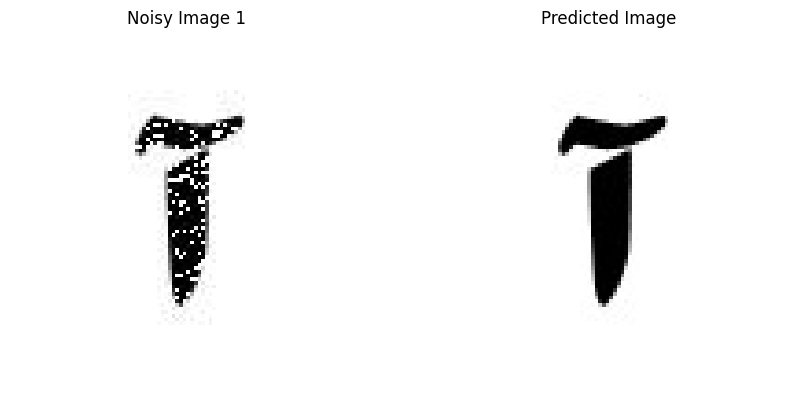

Given Image: noisy1.jpg, Predicted Image Index: 1


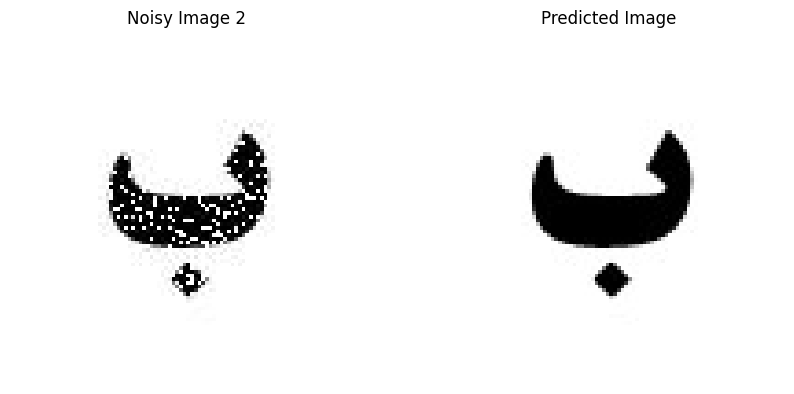

Given Image: noisy2.jpg, Predicted Image Index: 2


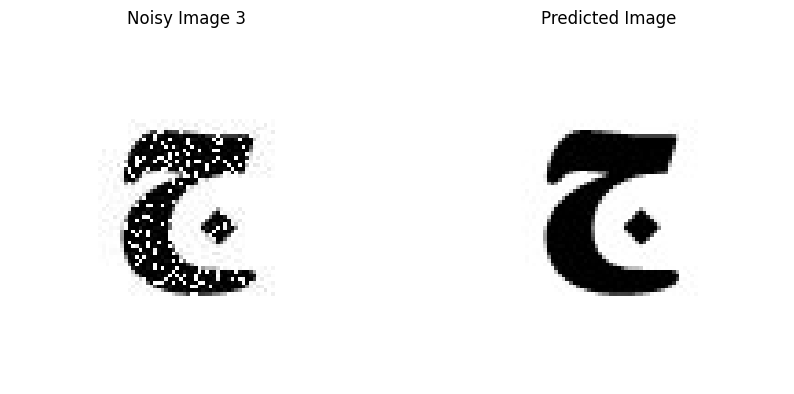

Given Image: noisy3.jpg, Predicted Image Index: 3


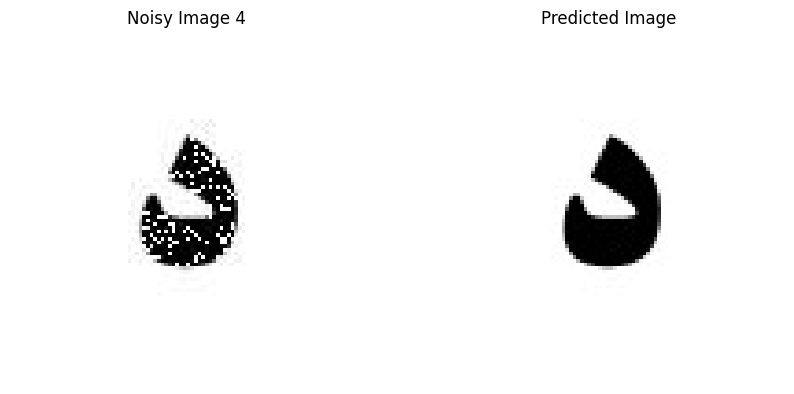

Given Image: noisy4.jpg, Predicted Image Index: 4


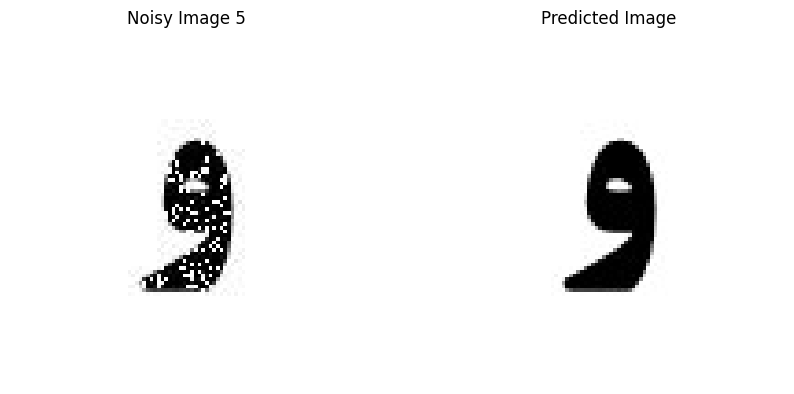

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 106 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 146 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 174 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 104 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 112 missing points and saved as noisy5.jpg


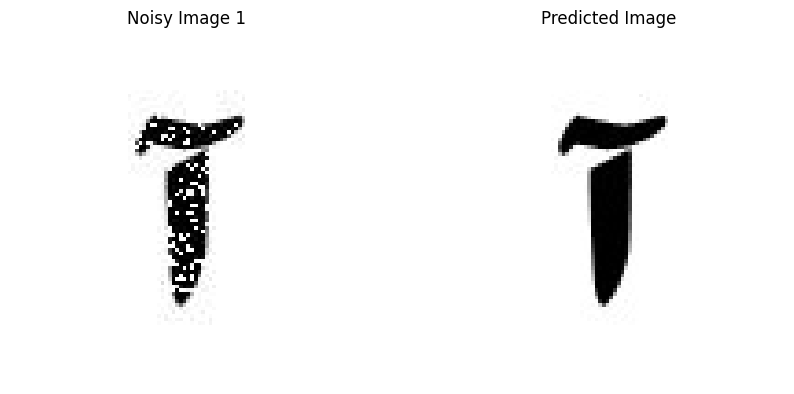

Given Image: noisy1.jpg, Predicted Image Index: 1


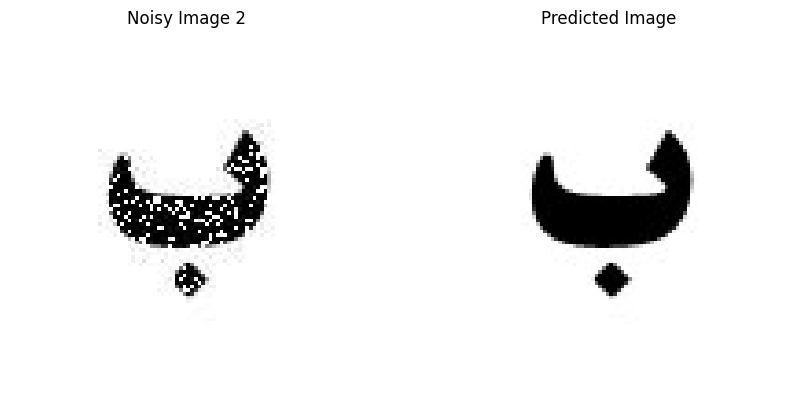

Given Image: noisy2.jpg, Predicted Image Index: 2


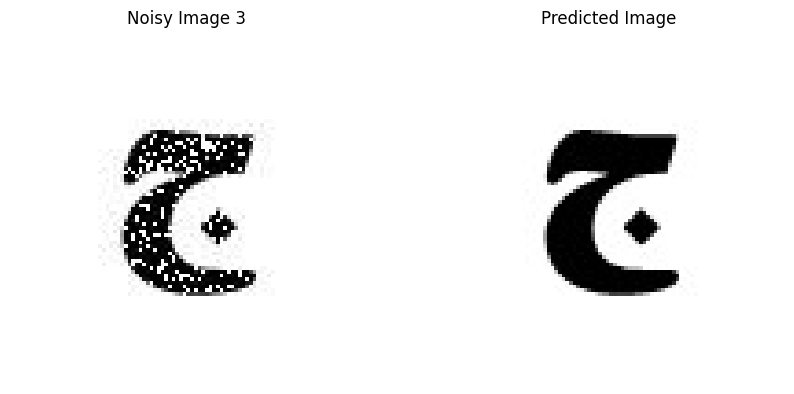

Given Image: noisy3.jpg, Predicted Image Index: 3


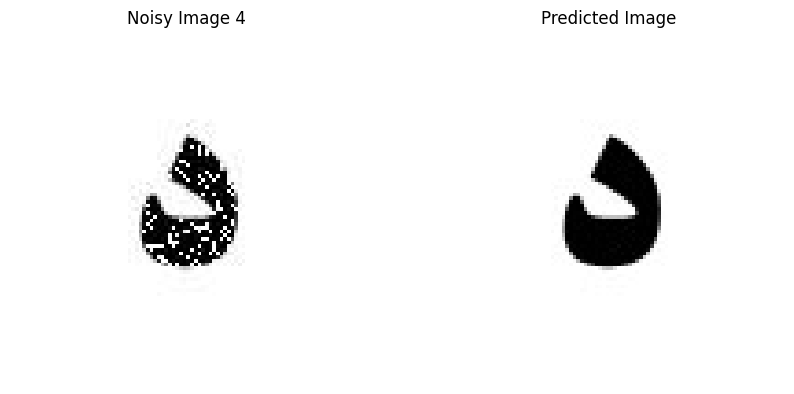

Given Image: noisy4.jpg, Predicted Image Index: 4


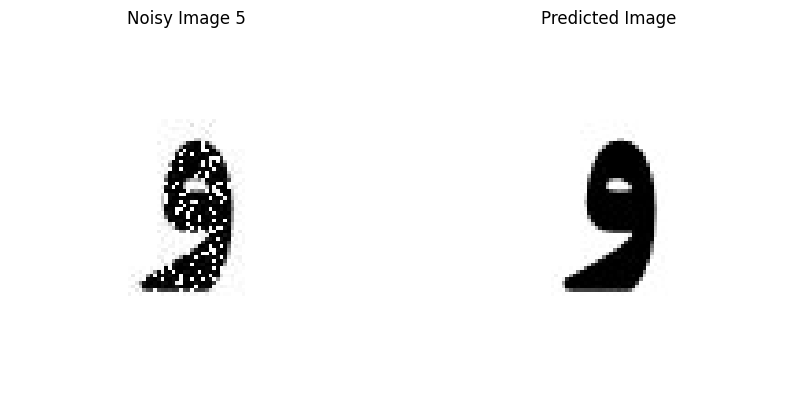

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 111 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 154 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 184 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 109 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 118 missing points and saved as noisy5.jpg


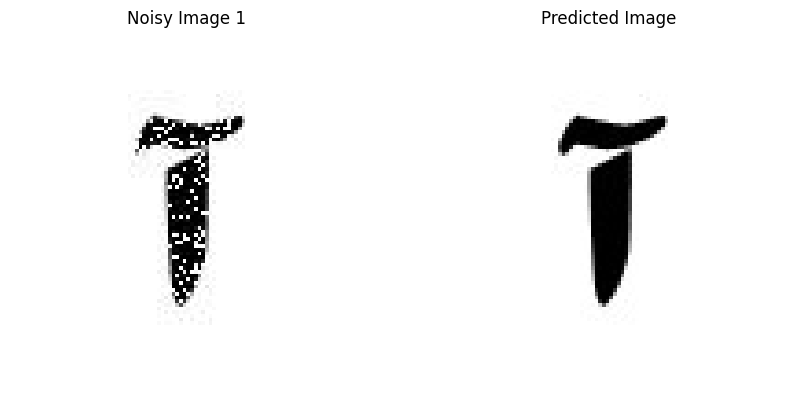

Given Image: noisy1.jpg, Predicted Image Index: 1


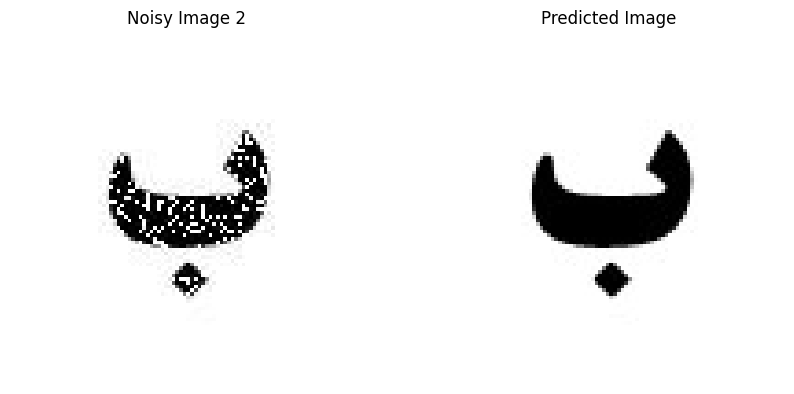

Given Image: noisy2.jpg, Predicted Image Index: 2


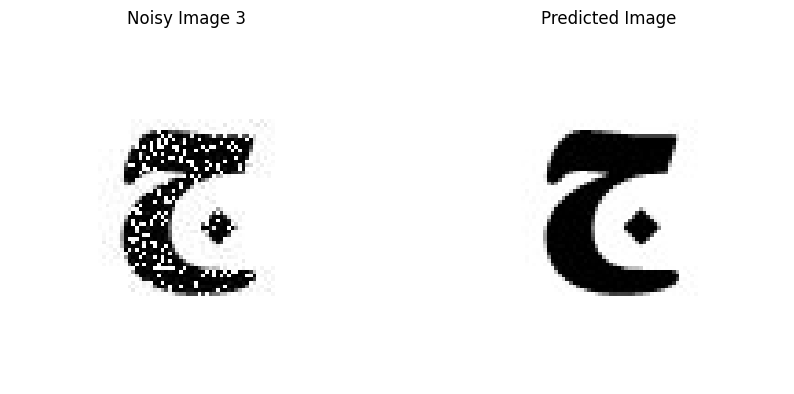

Given Image: noisy3.jpg, Predicted Image Index: 3


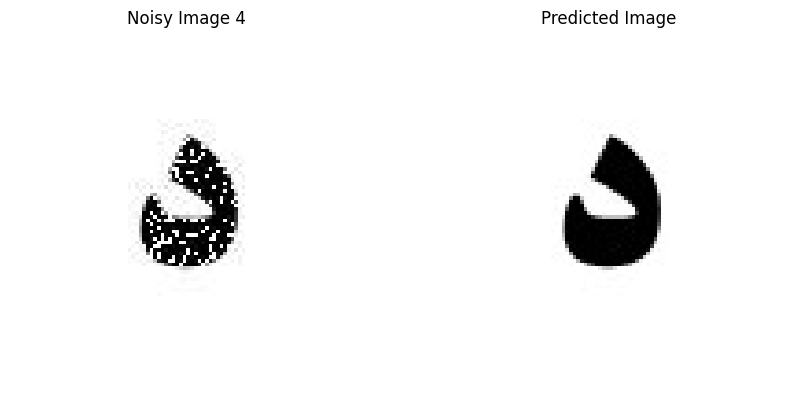

Given Image: noisy4.jpg, Predicted Image Index: 4


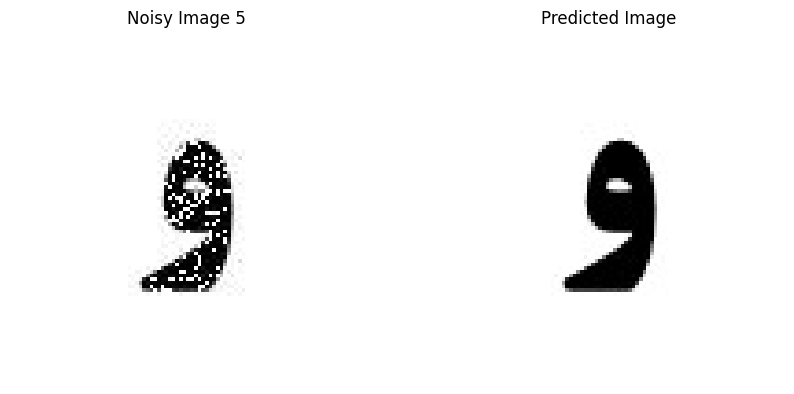

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 117 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 162 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 193 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 115 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 123 missing points and saved as noisy5.jpg


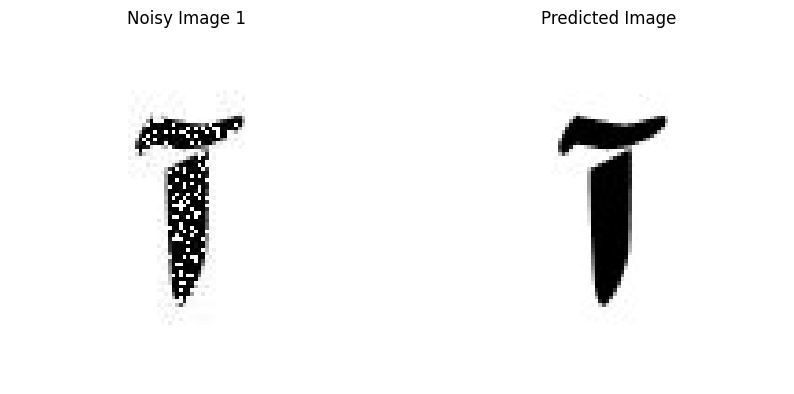

Given Image: noisy1.jpg, Predicted Image Index: 1


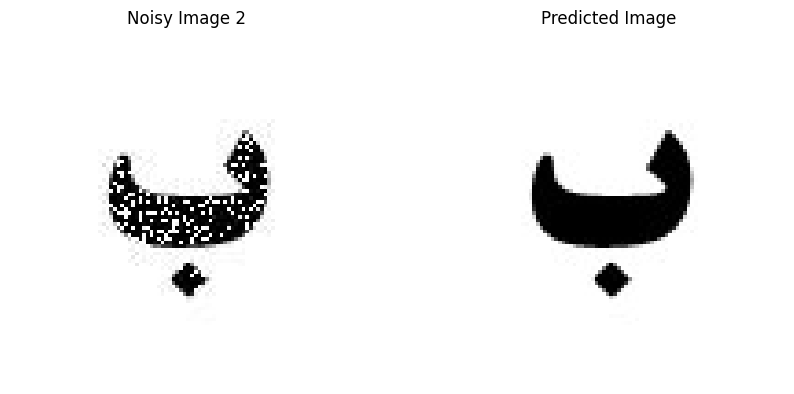

Given Image: noisy2.jpg, Predicted Image Index: 2


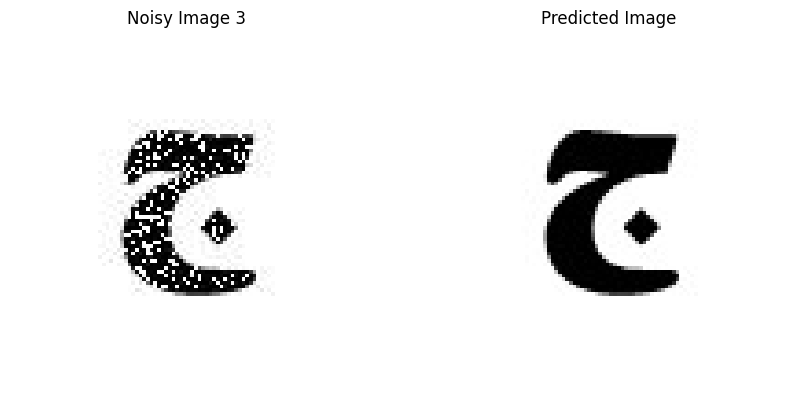

Given Image: noisy3.jpg, Predicted Image Index: 3


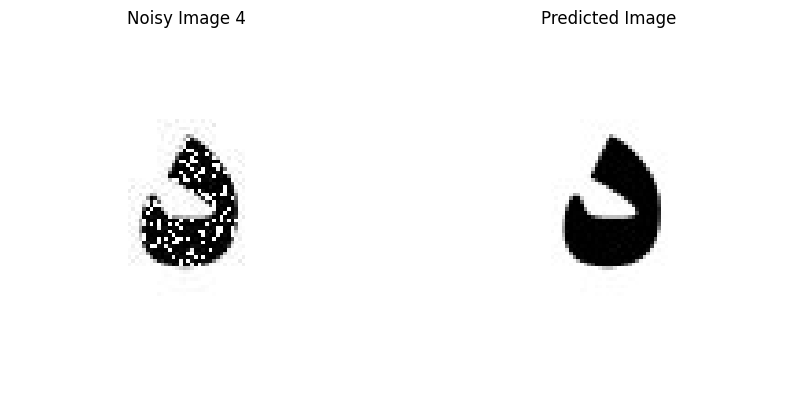

Given Image: noisy4.jpg, Predicted Image Index: 4


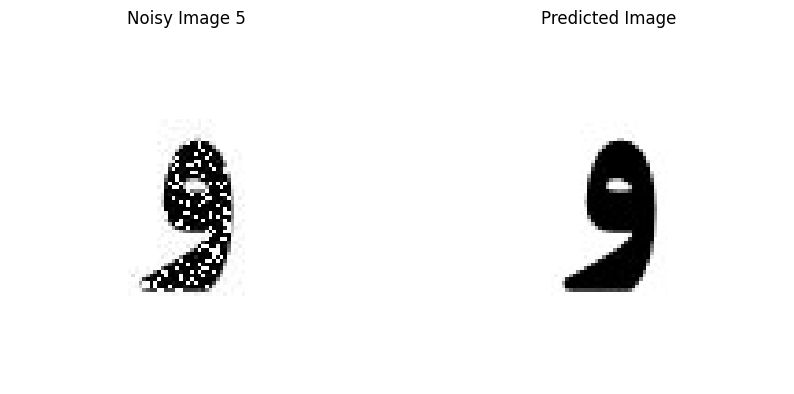

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 122 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 169 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 202 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 120 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 129 missing points and saved as noisy5.jpg


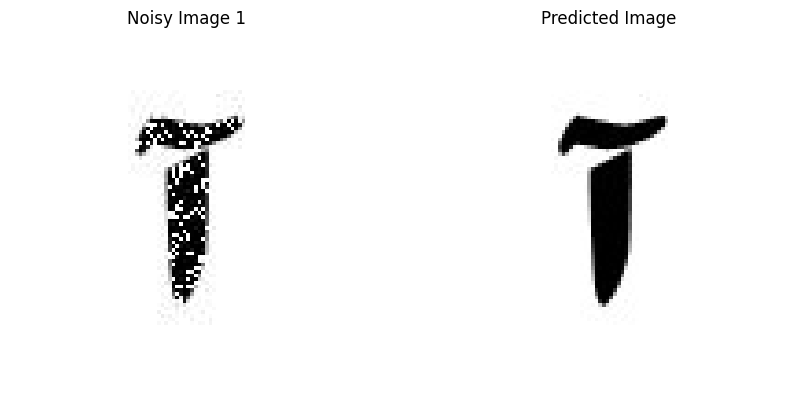

Given Image: noisy1.jpg, Predicted Image Index: 1


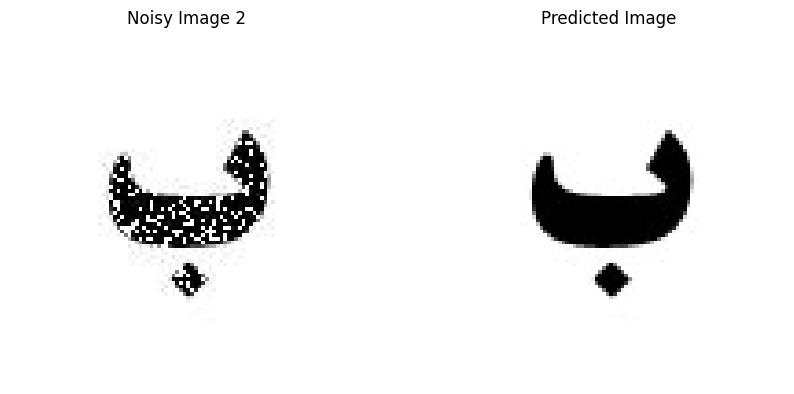

Given Image: noisy2.jpg, Predicted Image Index: 2


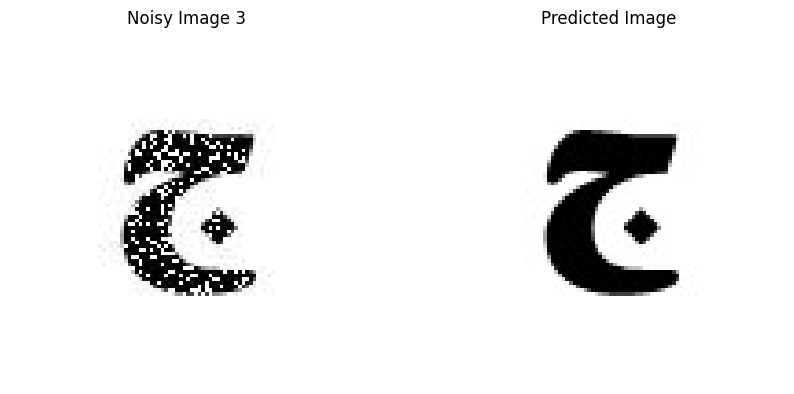

Given Image: noisy3.jpg, Predicted Image Index: 3


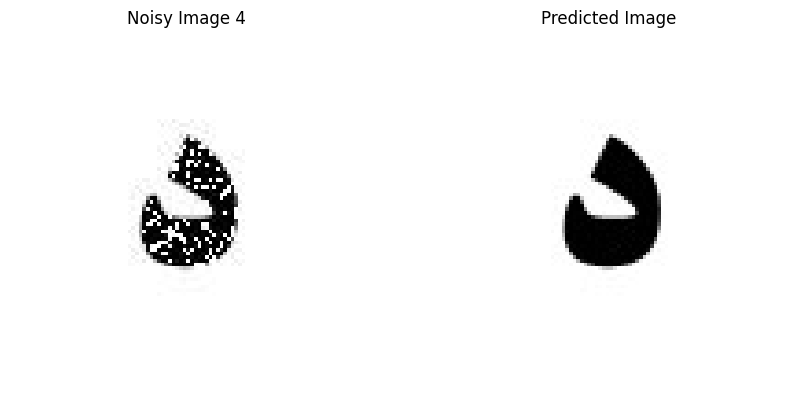

Given Image: noisy4.jpg, Predicted Image Index: 4


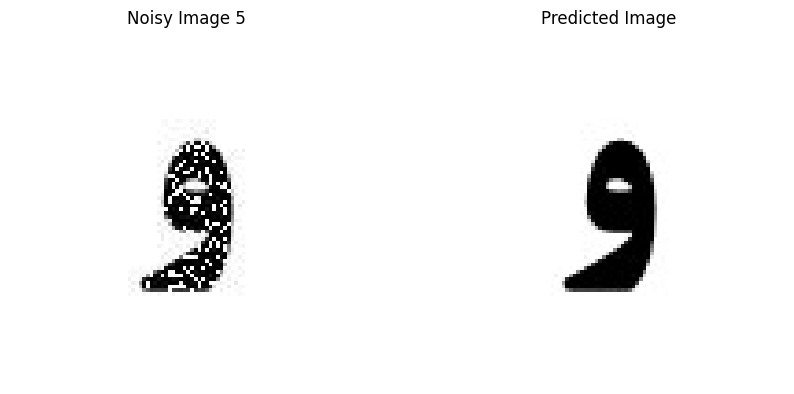

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 128 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 177 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 211 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 126 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 135 missing points and saved as noisy5.jpg


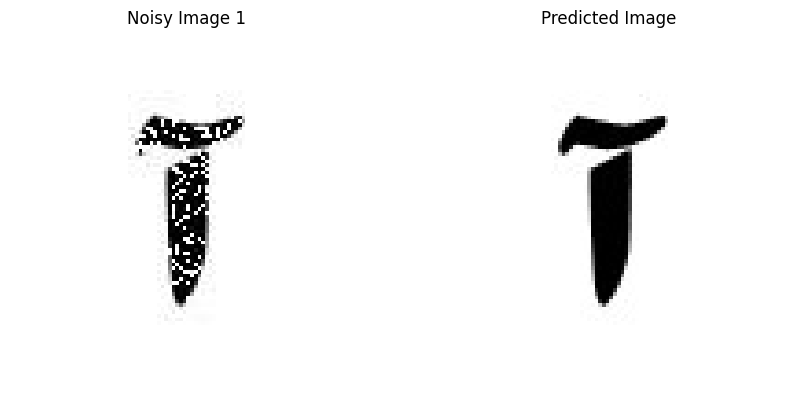

Given Image: noisy1.jpg, Predicted Image Index: 1


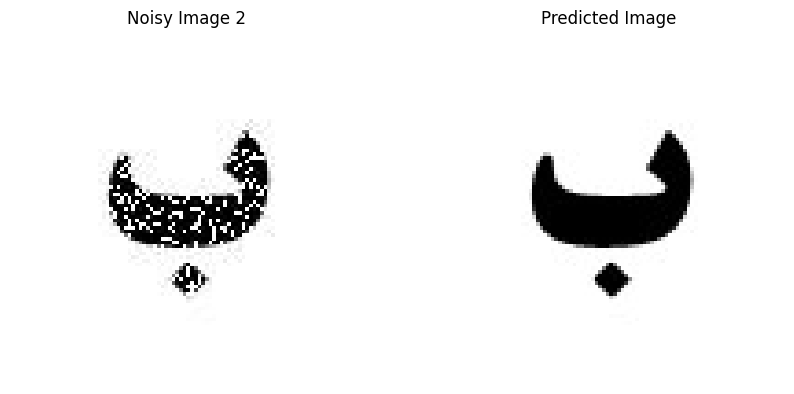

Given Image: noisy2.jpg, Predicted Image Index: 2


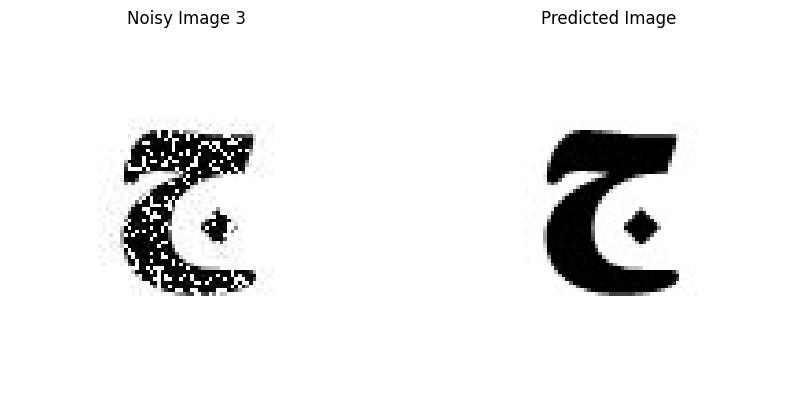

Given Image: noisy3.jpg, Predicted Image Index: 3


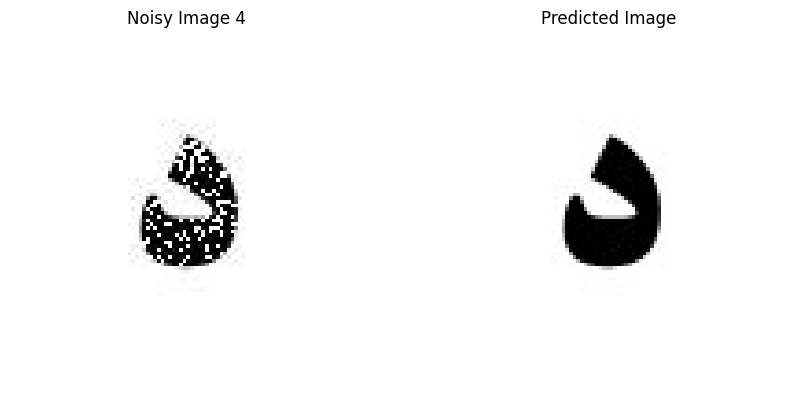

Given Image: noisy4.jpg, Predicted Image Index: 4


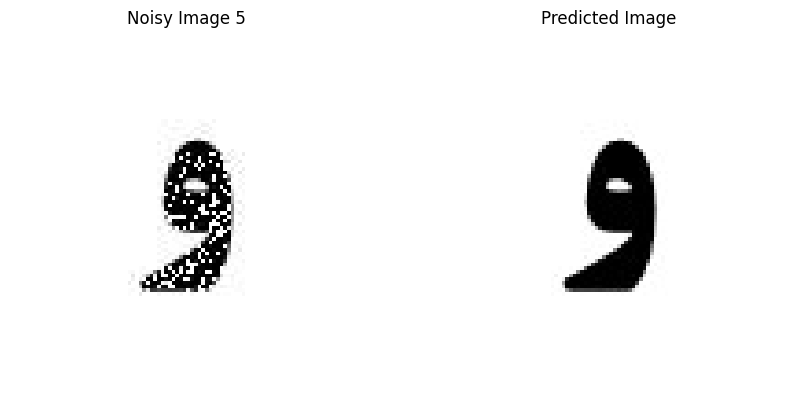

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 133 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 185 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 221 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 131 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 141 missing points and saved as noisy5.jpg


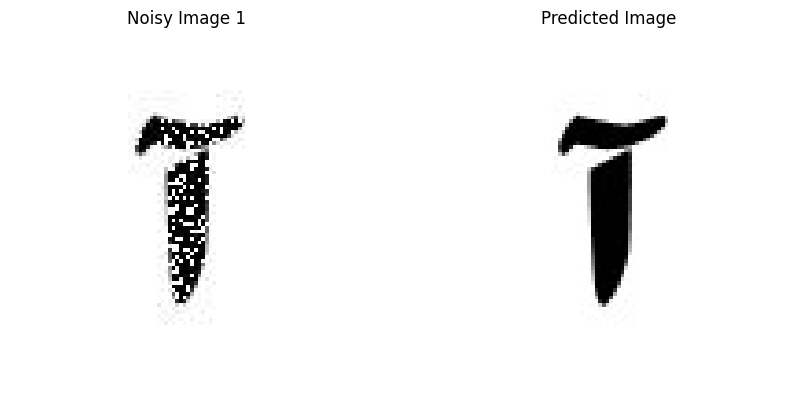

Given Image: noisy1.jpg, Predicted Image Index: 1


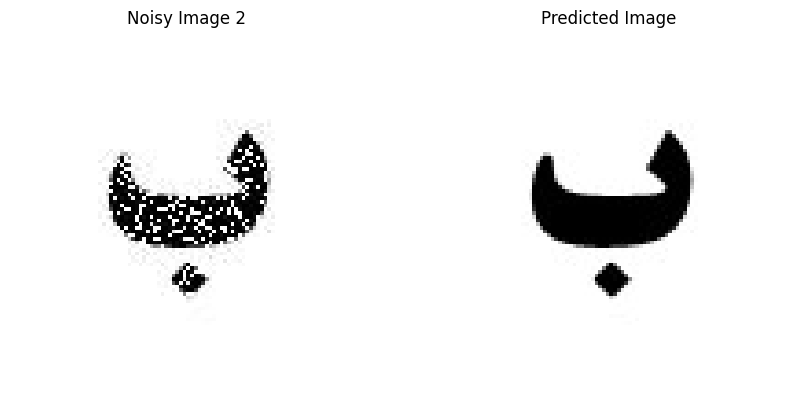

Given Image: noisy2.jpg, Predicted Image Index: 2


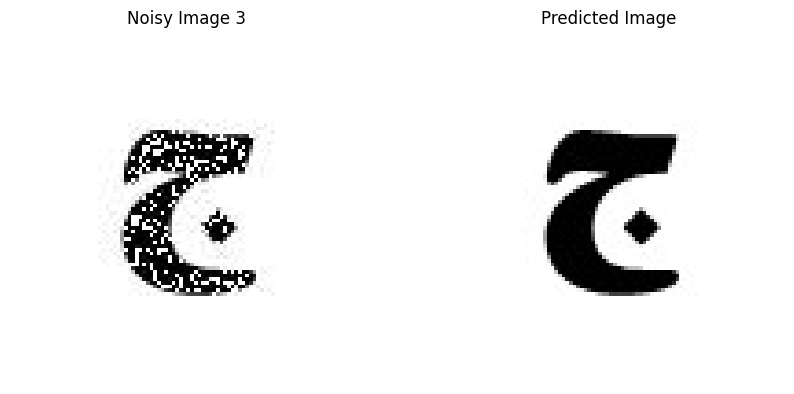

Given Image: noisy3.jpg, Predicted Image Index: 3


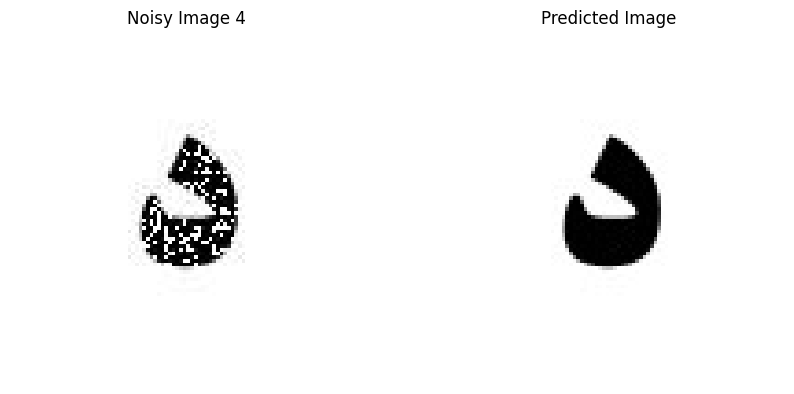

Given Image: noisy4.jpg, Predicted Image Index: 4


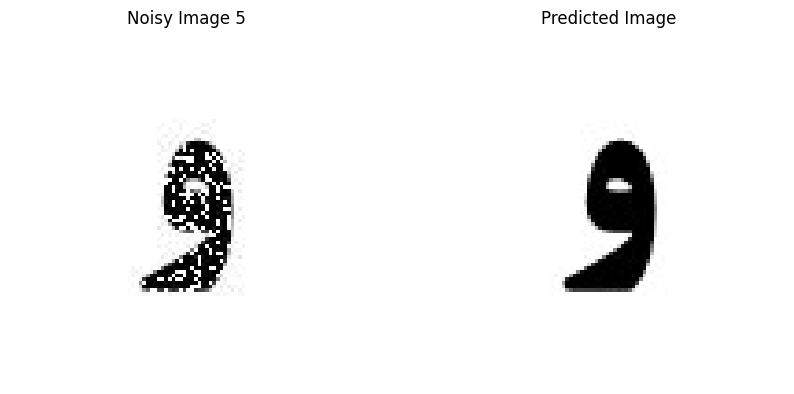

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 139 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 193 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 230 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 137 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 147 missing points and saved as noisy5.jpg


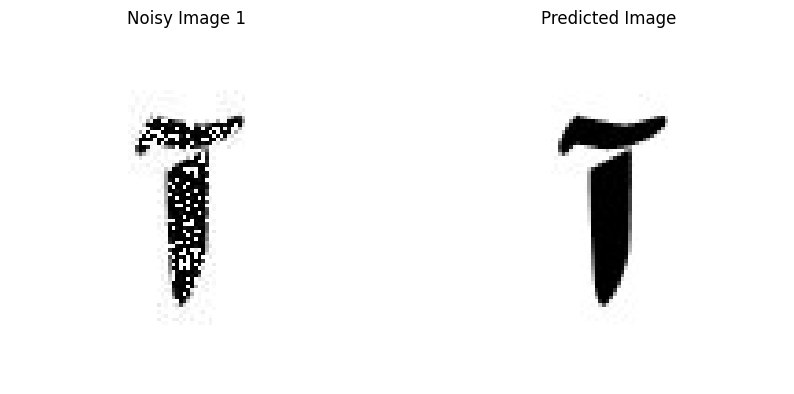

Given Image: noisy1.jpg, Predicted Image Index: 1


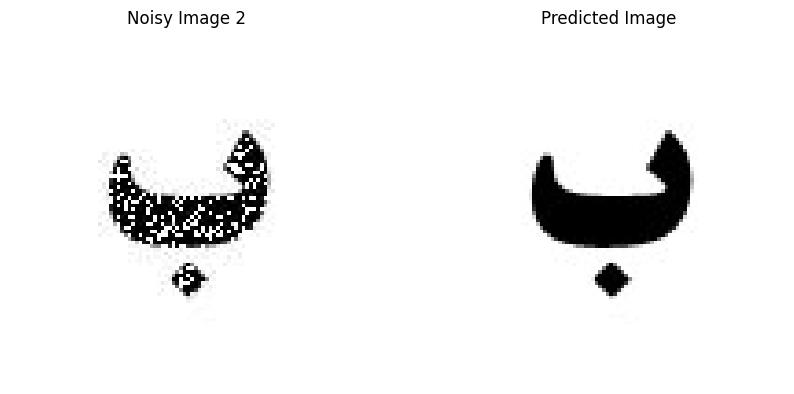

Given Image: noisy2.jpg, Predicted Image Index: 2


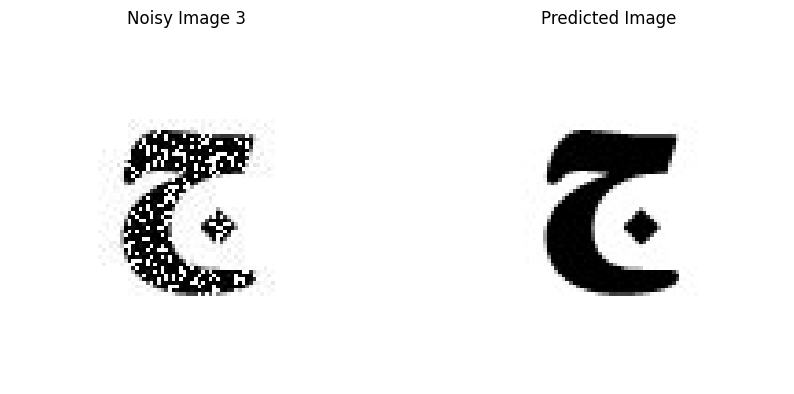

Given Image: noisy3.jpg, Predicted Image Index: 3


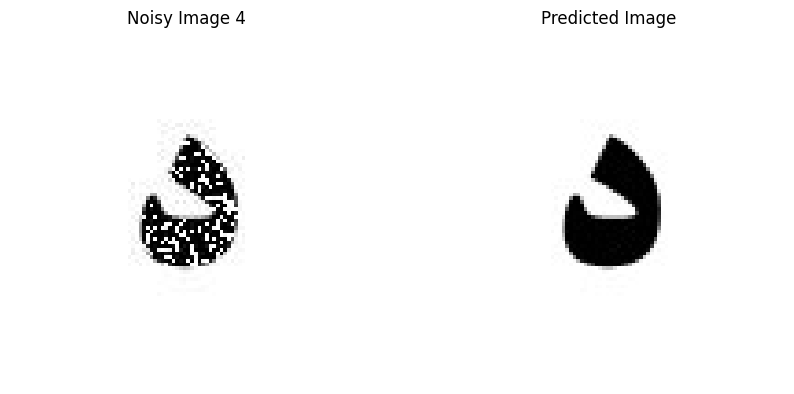

Given Image: noisy4.jpg, Predicted Image Index: 4


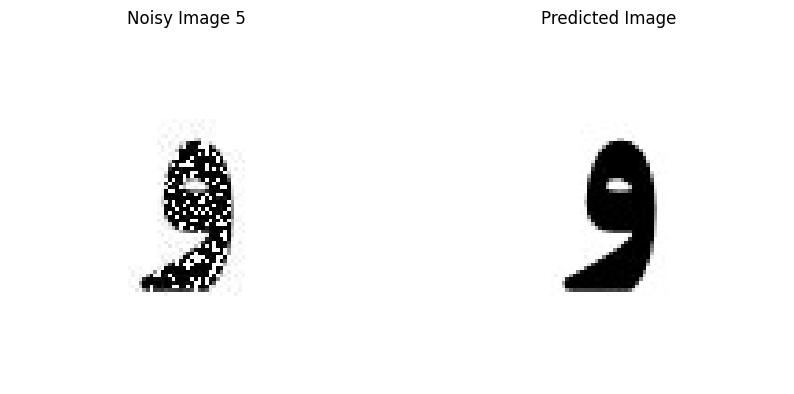

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 145 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 200 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 239 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 142 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 153 missing points and saved as noisy5.jpg


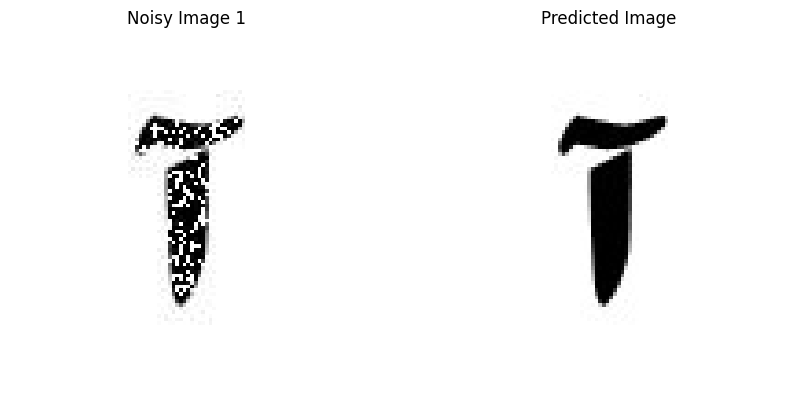

Given Image: noisy1.jpg, Predicted Image Index: 1


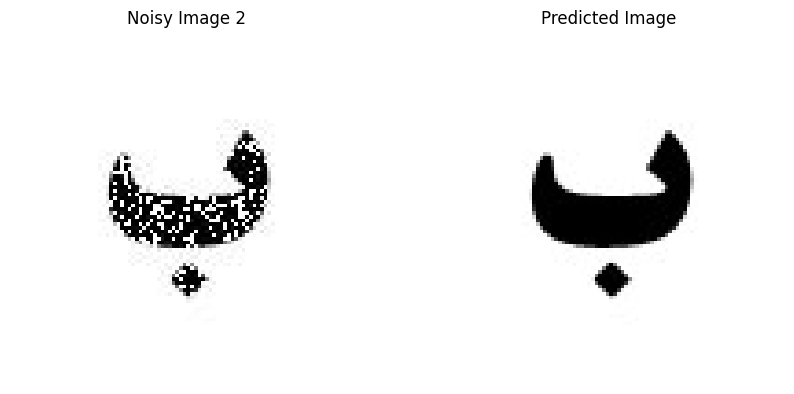

Given Image: noisy2.jpg, Predicted Image Index: 2


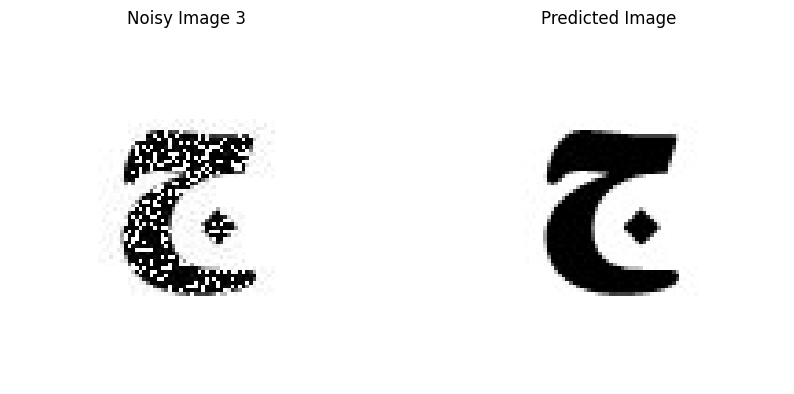

Given Image: noisy3.jpg, Predicted Image Index: 3


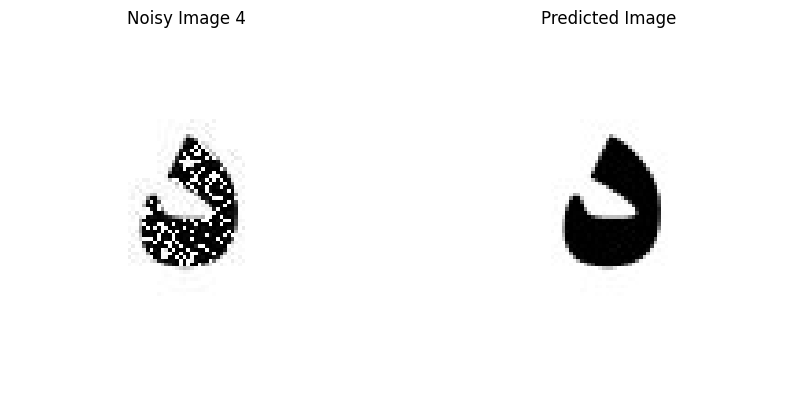

Given Image: noisy4.jpg, Predicted Image Index: 4


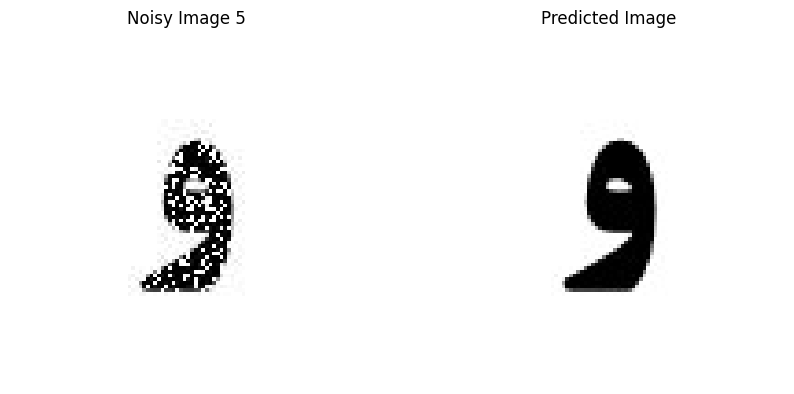

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 150 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 208 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 248 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 148 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 159 missing points and saved as noisy5.jpg


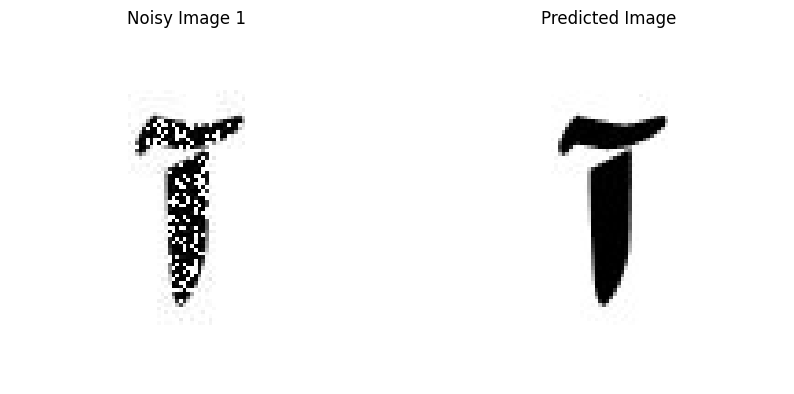

Given Image: noisy1.jpg, Predicted Image Index: 1


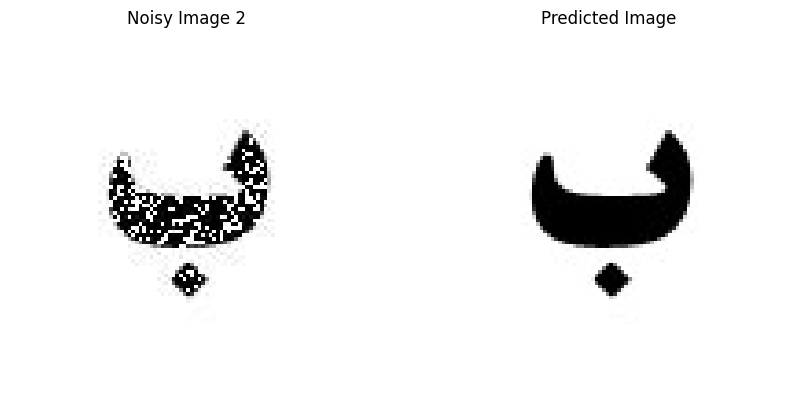

Given Image: noisy2.jpg, Predicted Image Index: 2


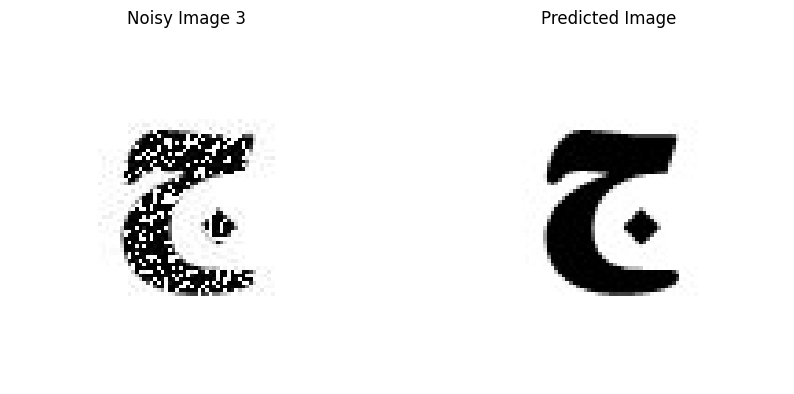

Given Image: noisy3.jpg, Predicted Image Index: 3


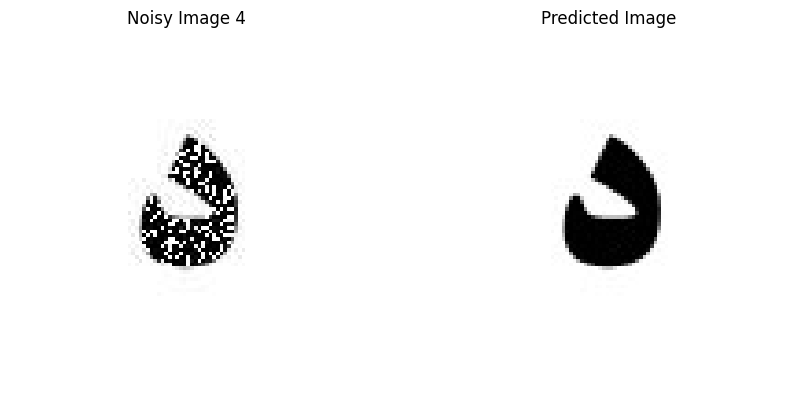

Given Image: noisy4.jpg, Predicted Image Index: 4


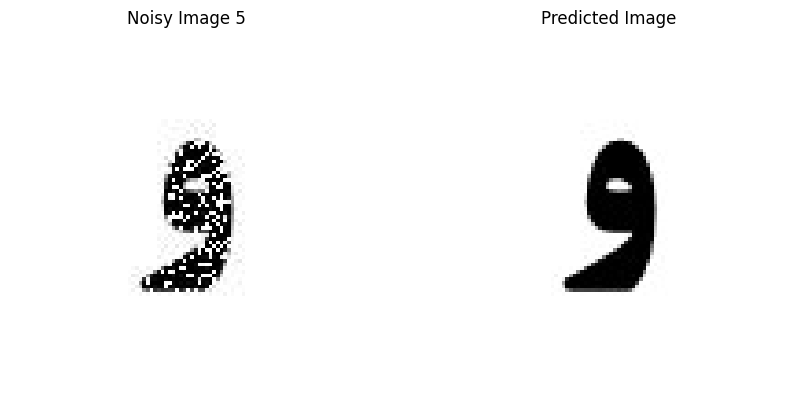

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 156 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 216 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 257 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 153 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 165 missing points and saved as noisy5.jpg


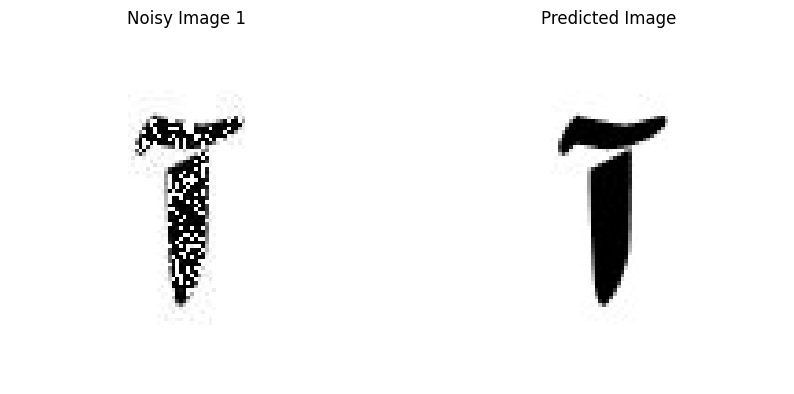

Given Image: noisy1.jpg, Predicted Image Index: 1


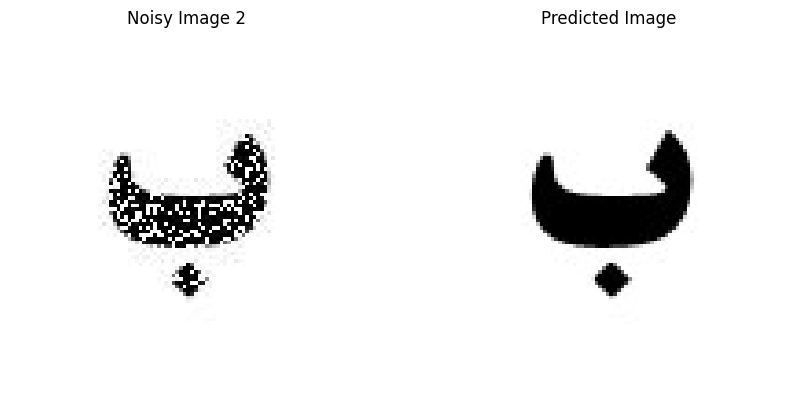

Given Image: noisy2.jpg, Predicted Image Index: 2


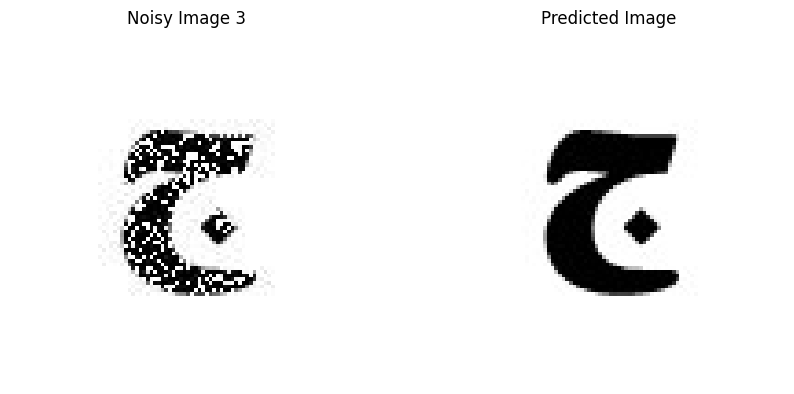

Given Image: noisy3.jpg, Predicted Image Index: 3


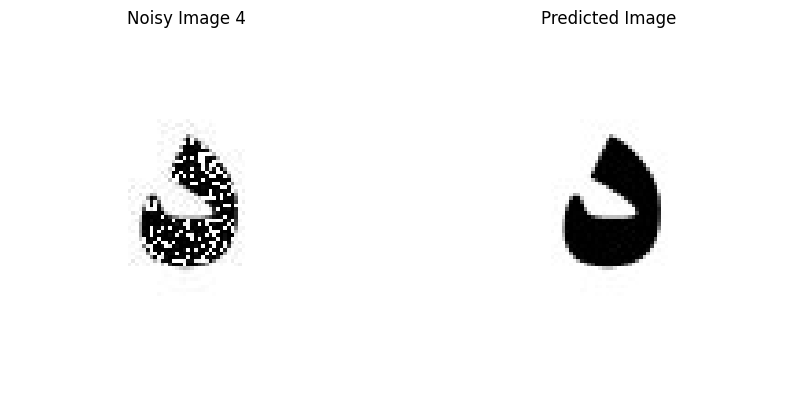

Given Image: noisy4.jpg, Predicted Image Index: 4


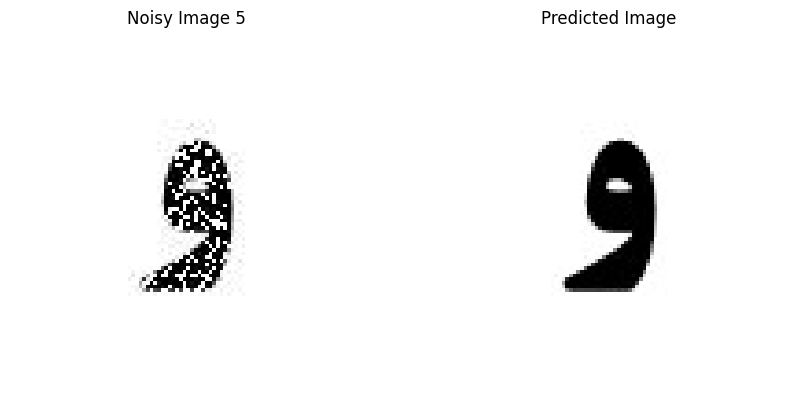

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 161 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 223 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 267 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 159 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 171 missing points and saved as noisy5.jpg


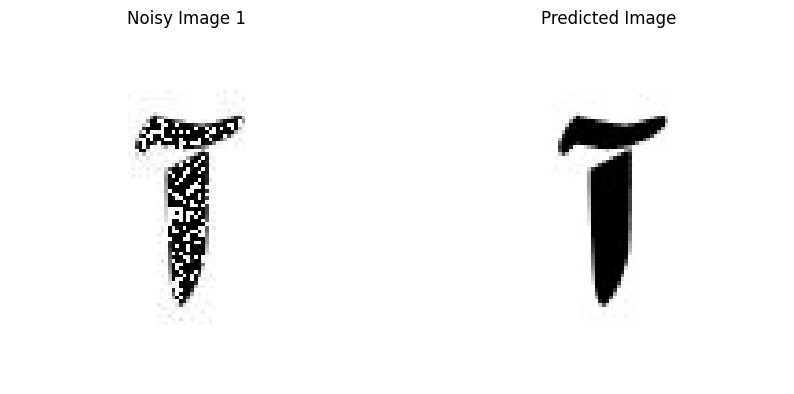

Given Image: noisy1.jpg, Predicted Image Index: 1


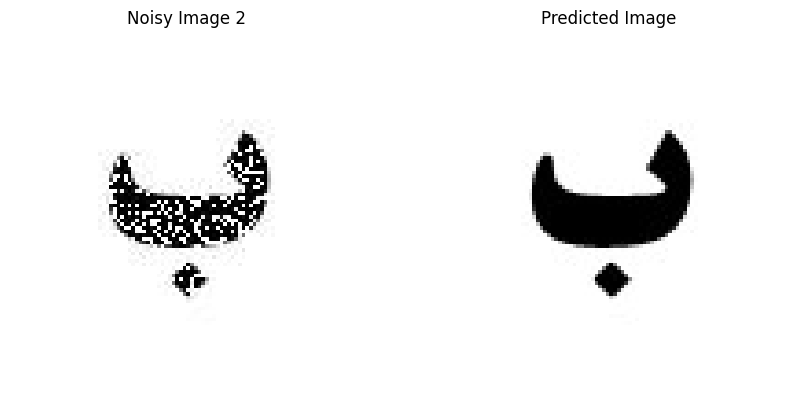

Given Image: noisy2.jpg, Predicted Image Index: 2


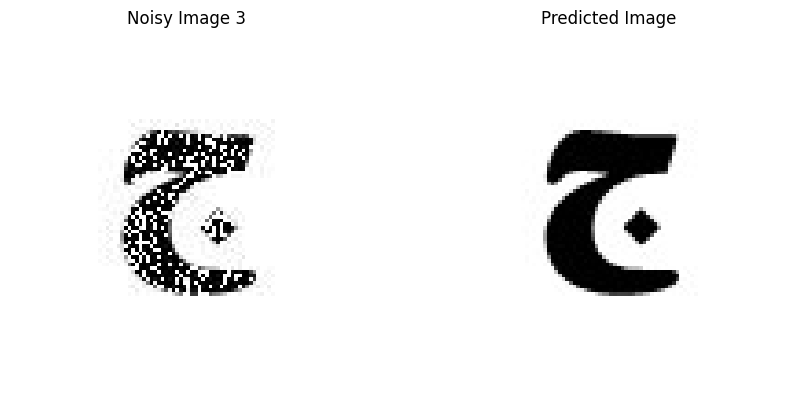

Given Image: noisy3.jpg, Predicted Image Index: 3


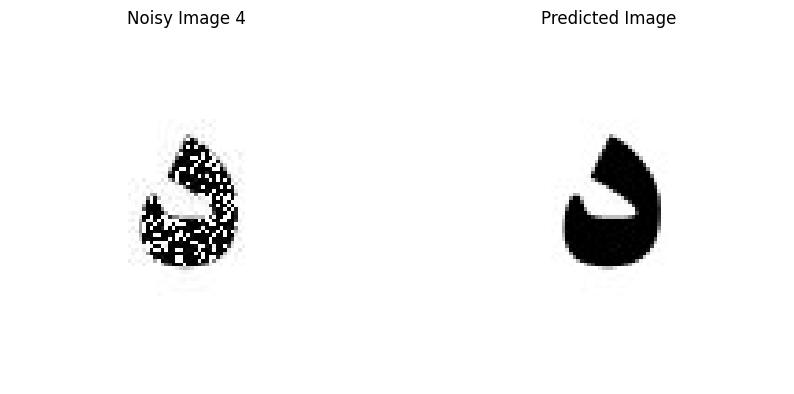

Given Image: noisy4.jpg, Predicted Image Index: 4


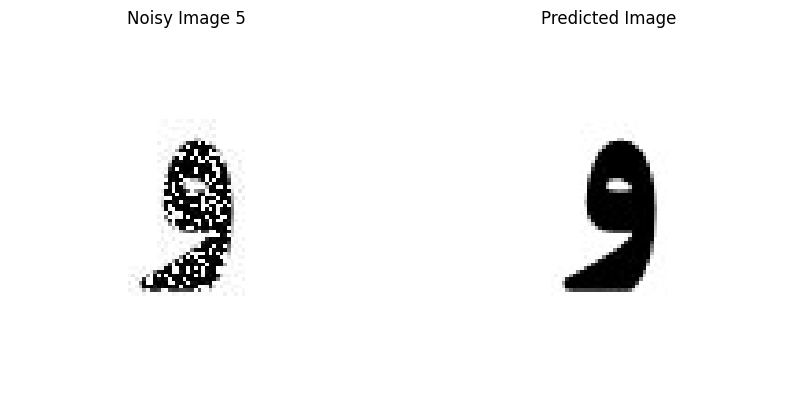

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 167 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 231 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 276 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 164 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 177 missing points and saved as noisy5.jpg


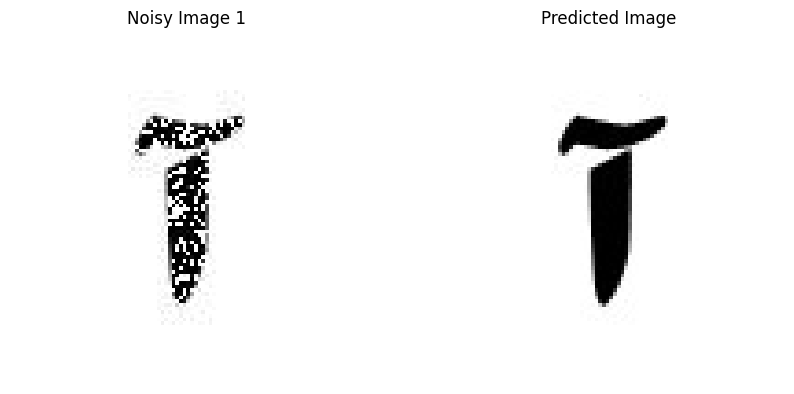

Given Image: noisy1.jpg, Predicted Image Index: 1


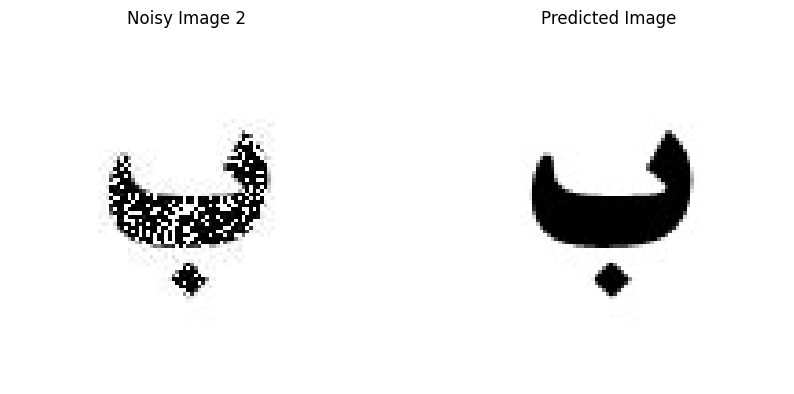

Given Image: noisy2.jpg, Predicted Image Index: 2


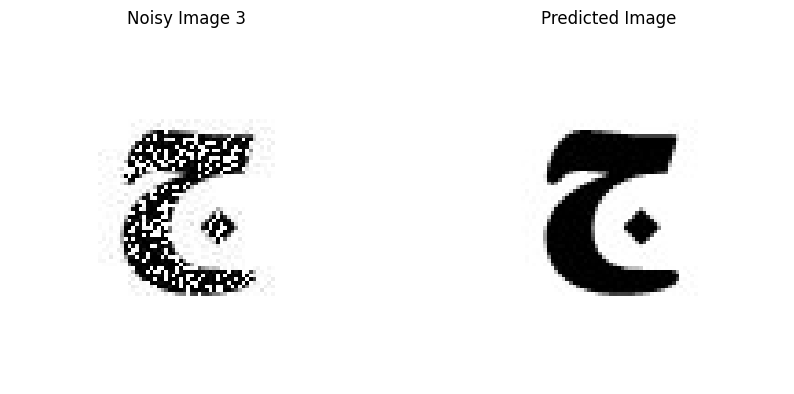

Given Image: noisy3.jpg, Predicted Image Index: 3


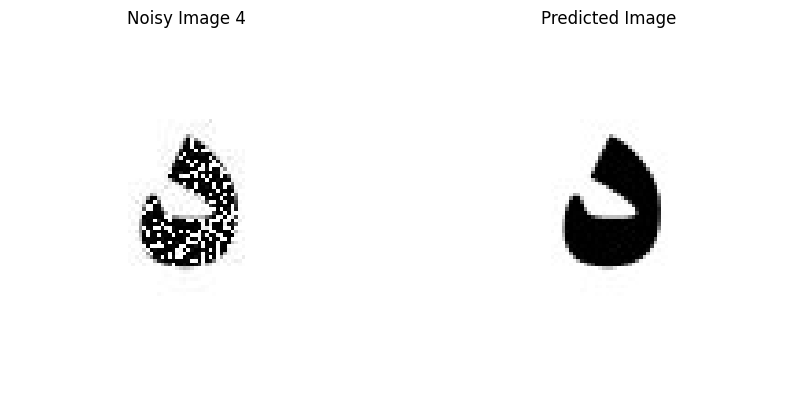

Given Image: noisy4.jpg, Predicted Image Index: 4


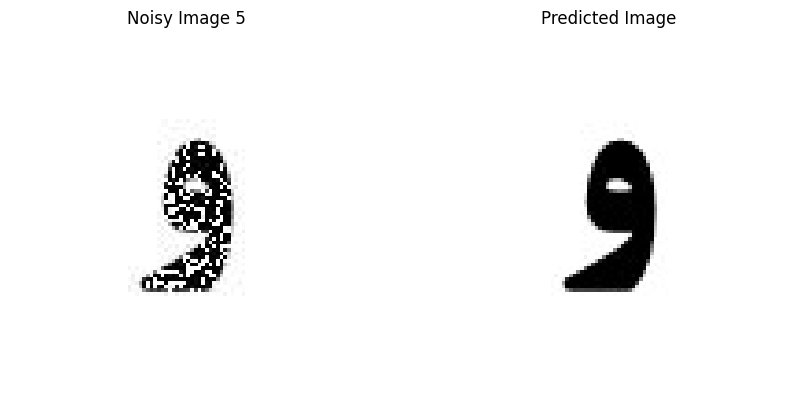

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 172 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 239 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 285 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 170 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 182 missing points and saved as noisy5.jpg


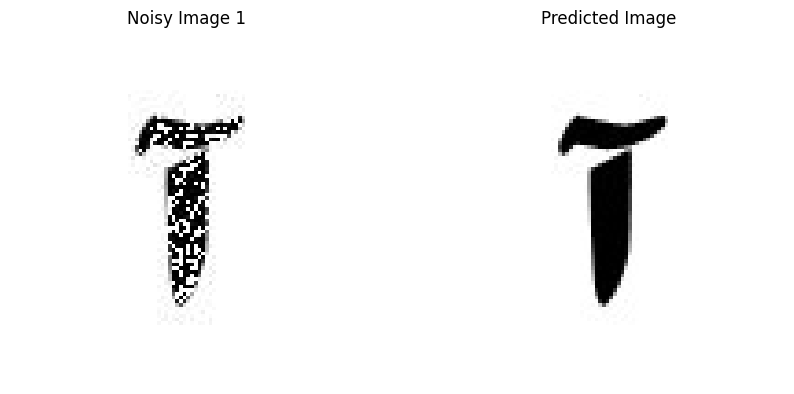

Given Image: noisy1.jpg, Predicted Image Index: 1


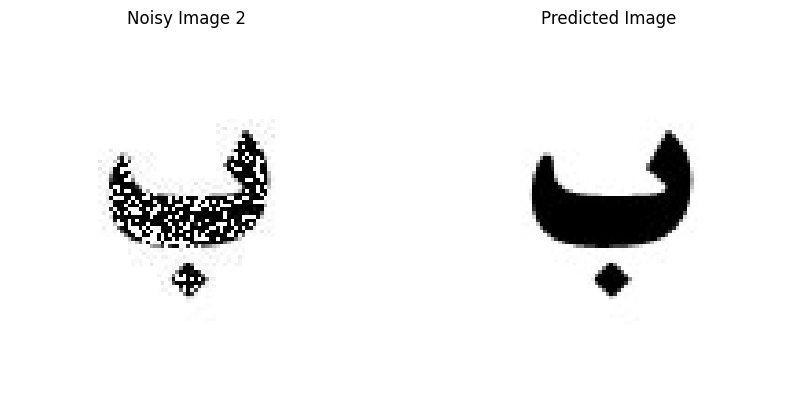

Given Image: noisy2.jpg, Predicted Image Index: 2


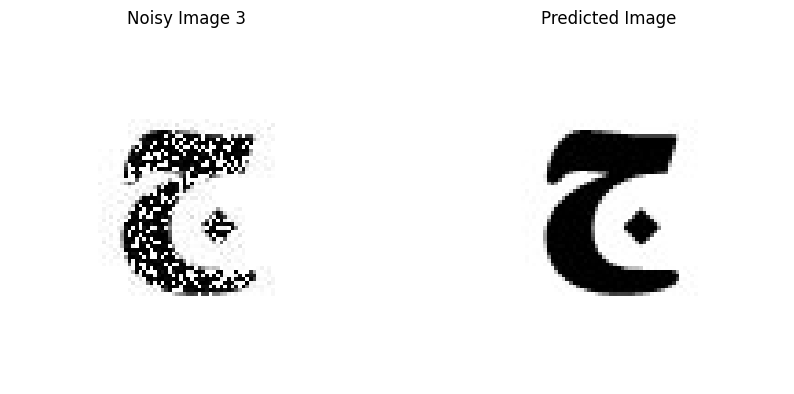

Given Image: noisy3.jpg, Predicted Image Index: 3


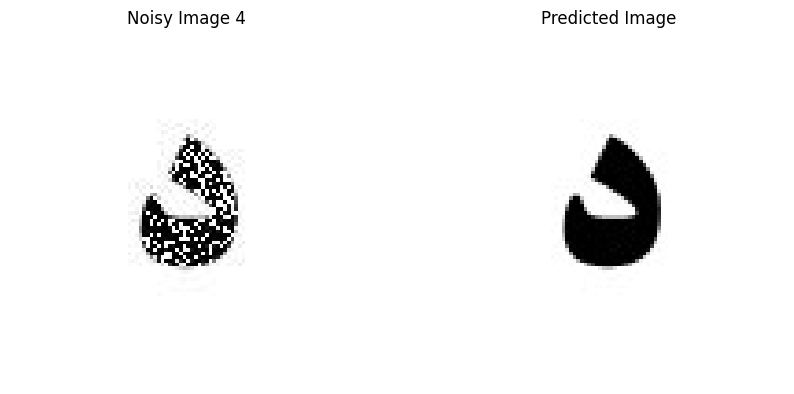

Given Image: noisy4.jpg, Predicted Image Index: 4


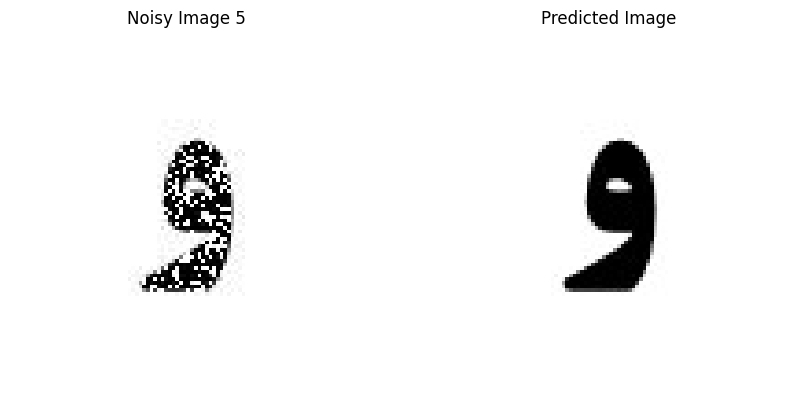

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 178 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 247 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 294 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 175 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 188 missing points and saved as noisy5.jpg


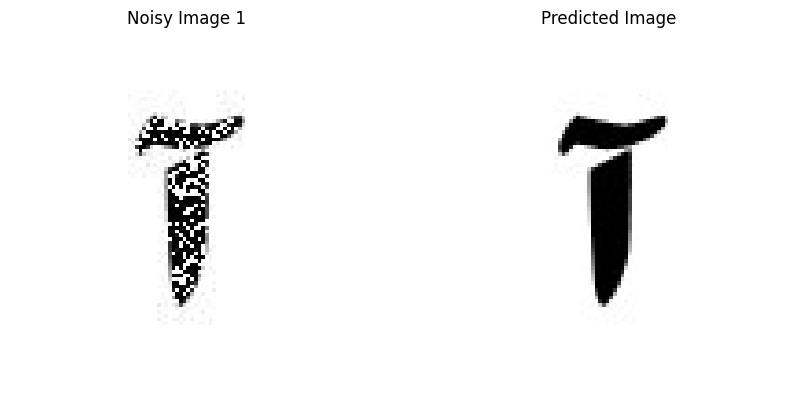

Given Image: noisy1.jpg, Predicted Image Index: 1


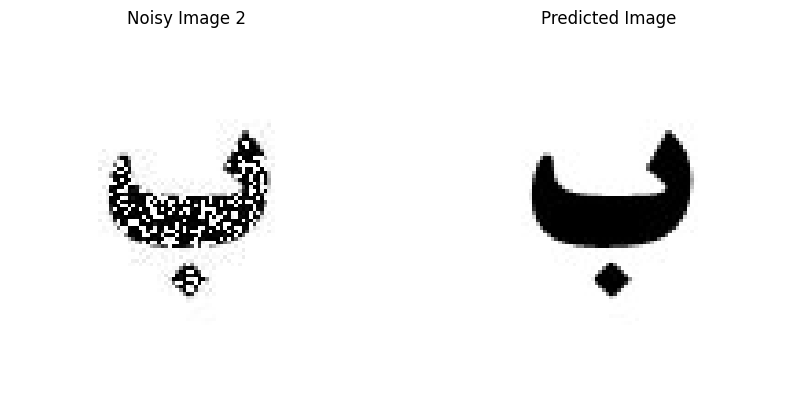

Given Image: noisy2.jpg, Predicted Image Index: 2


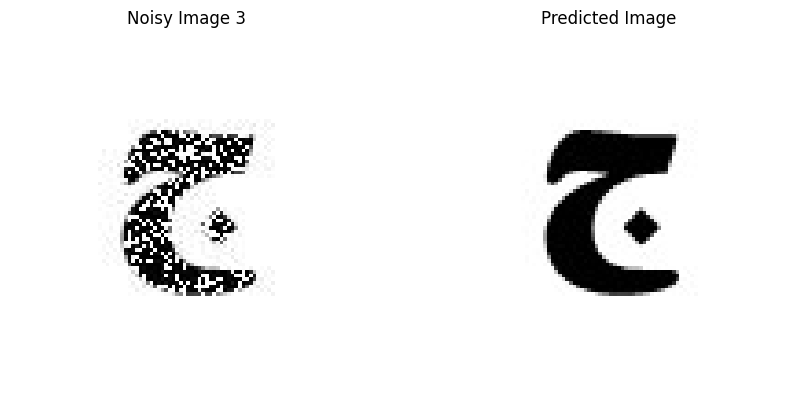

Given Image: noisy3.jpg, Predicted Image Index: 3


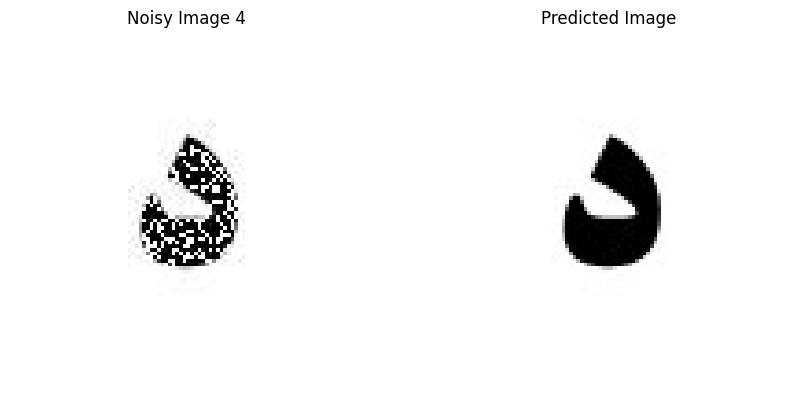

Given Image: noisy4.jpg, Predicted Image Index: 4


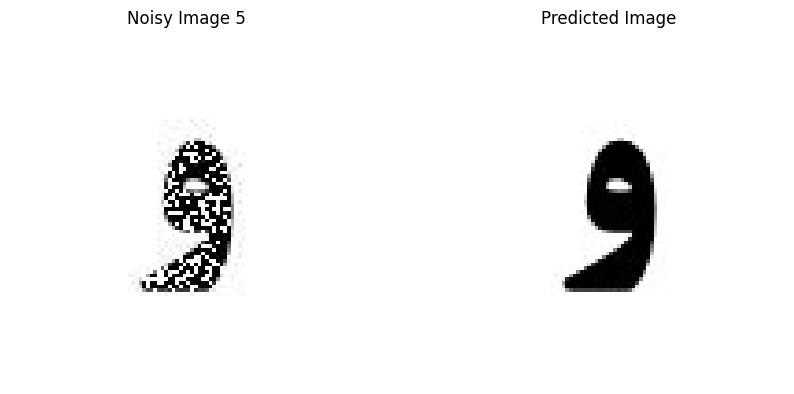

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 184 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 254 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 303 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 181 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 194 missing points and saved as noisy5.jpg


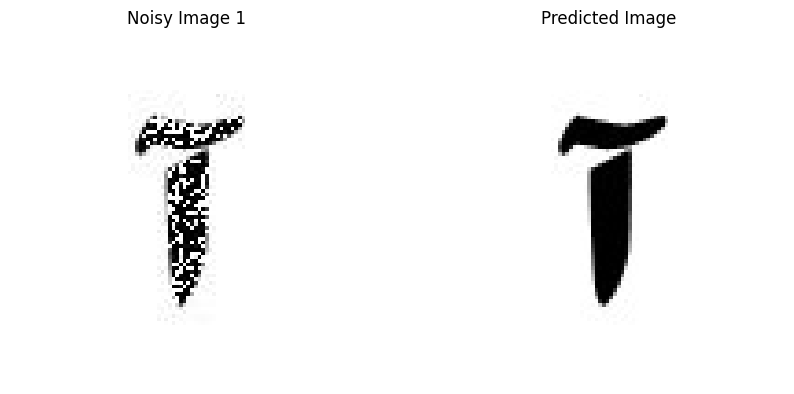

Given Image: noisy1.jpg, Predicted Image Index: 1


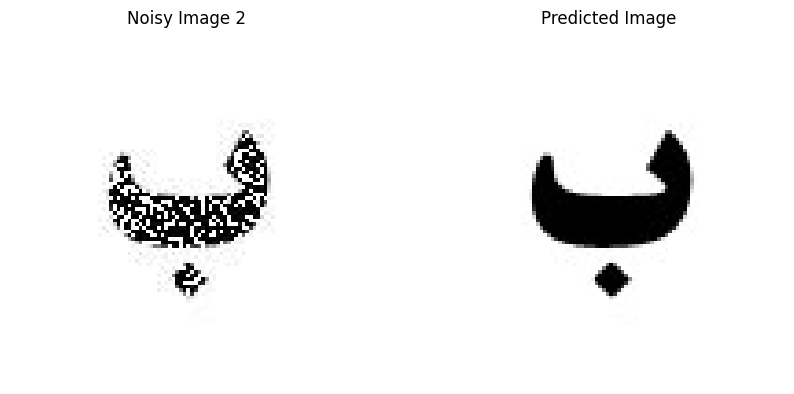

Given Image: noisy2.jpg, Predicted Image Index: 2


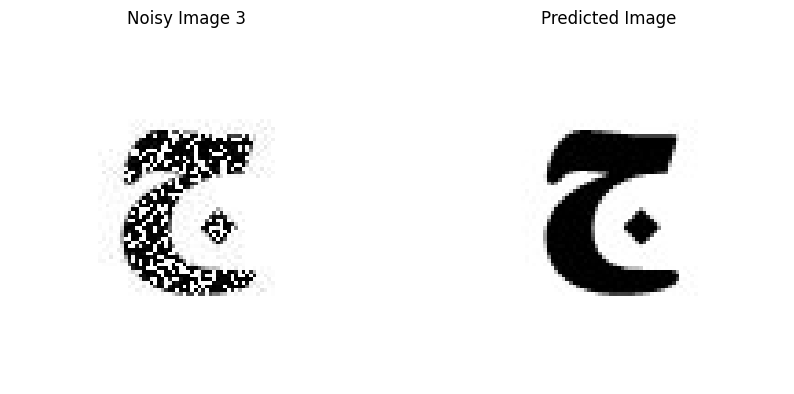

Given Image: noisy3.jpg, Predicted Image Index: 3


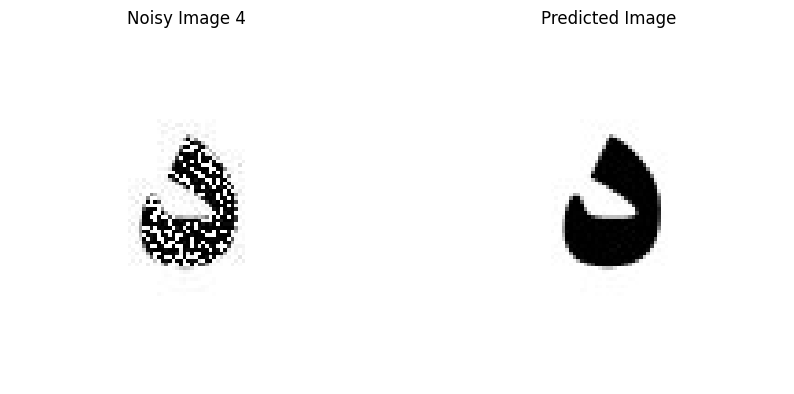

Given Image: noisy4.jpg, Predicted Image Index: 4


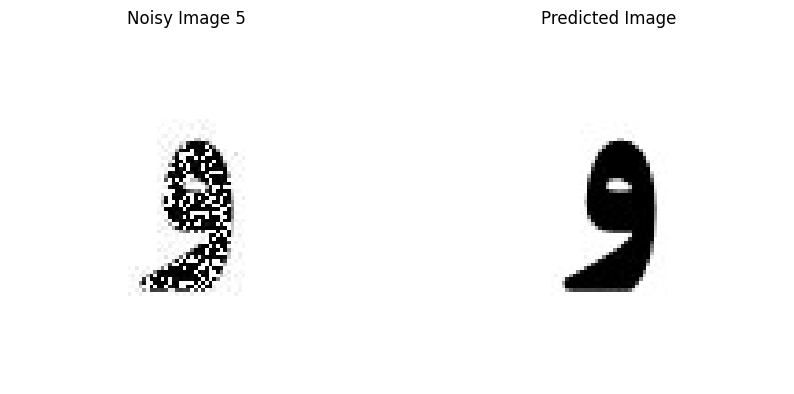

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 189 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 262 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 313 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 186 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 200 missing points and saved as noisy5.jpg


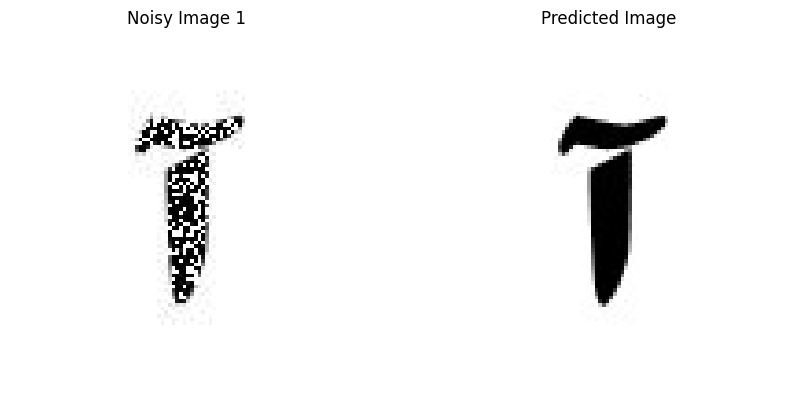

Given Image: noisy1.jpg, Predicted Image Index: 1


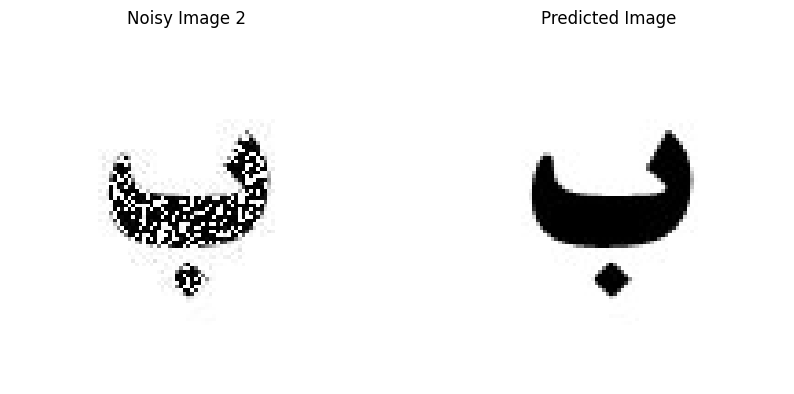

Given Image: noisy2.jpg, Predicted Image Index: 2


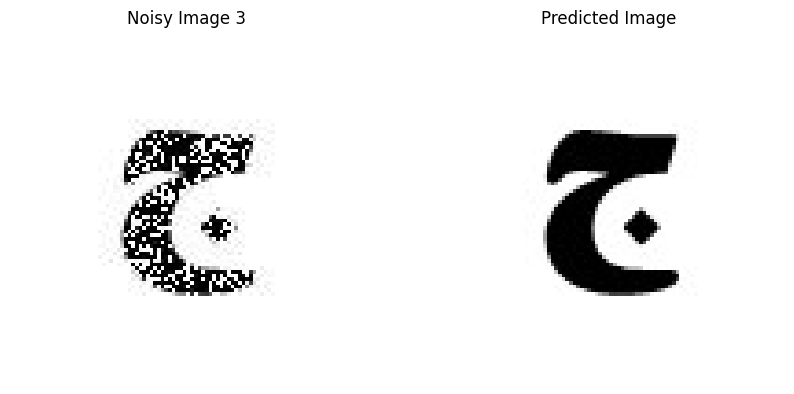

Given Image: noisy3.jpg, Predicted Image Index: 3


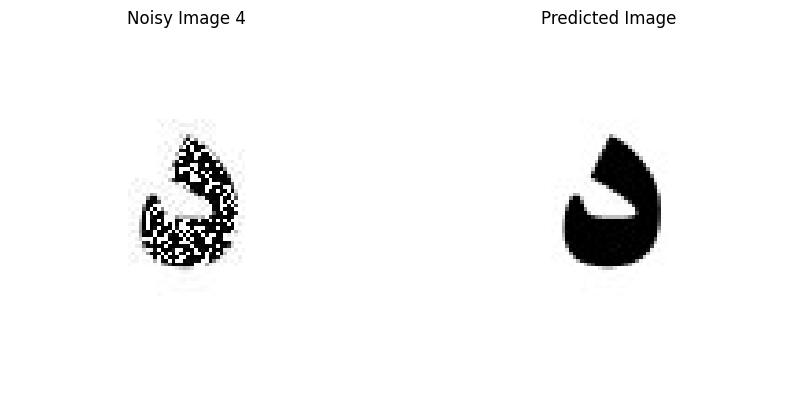

Given Image: noisy4.jpg, Predicted Image Index: 4


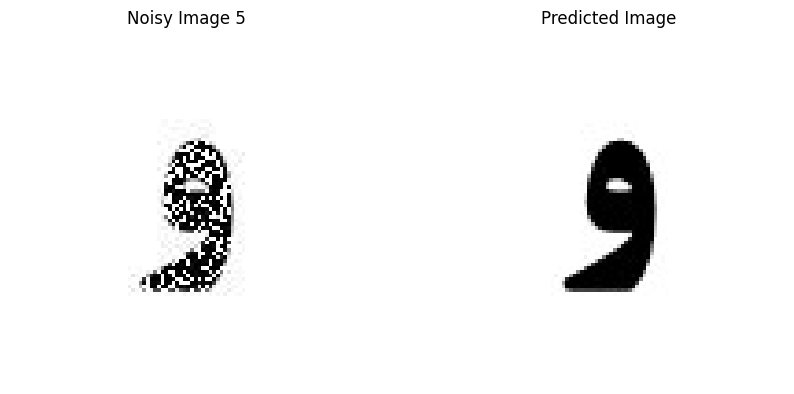

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 195 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 270 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 322 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 192 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 206 missing points and saved as noisy5.jpg


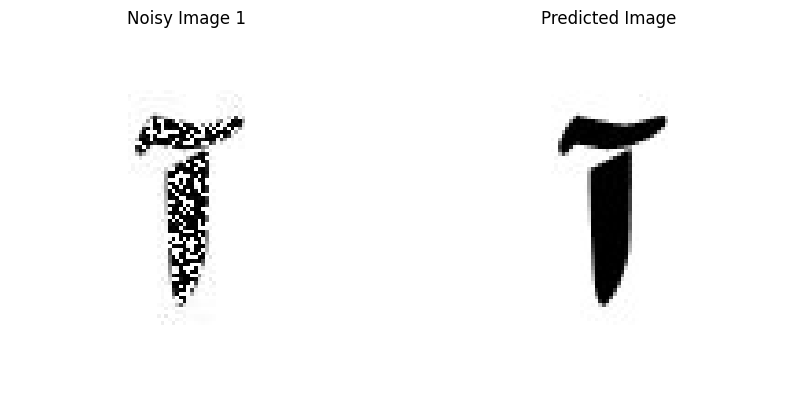

Given Image: noisy1.jpg, Predicted Image Index: 1


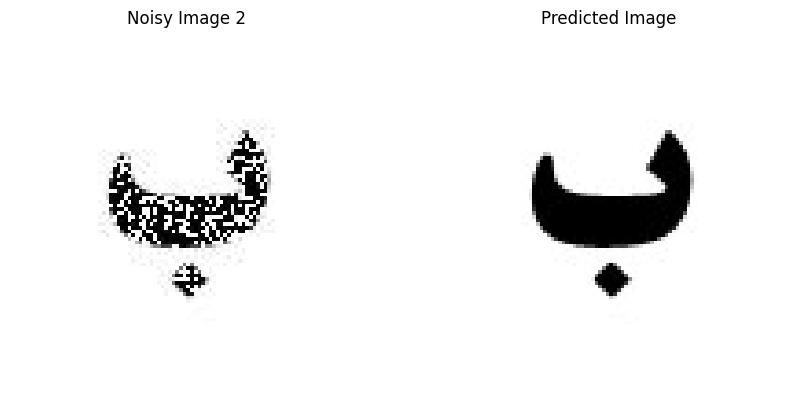

Given Image: noisy2.jpg, Predicted Image Index: 2


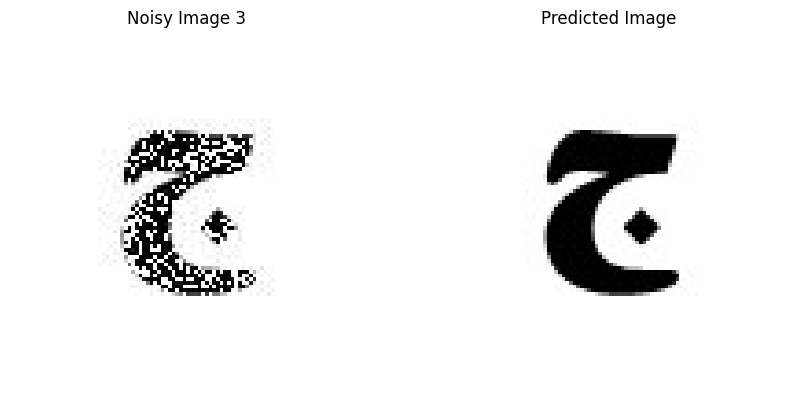

Given Image: noisy3.jpg, Predicted Image Index: 3


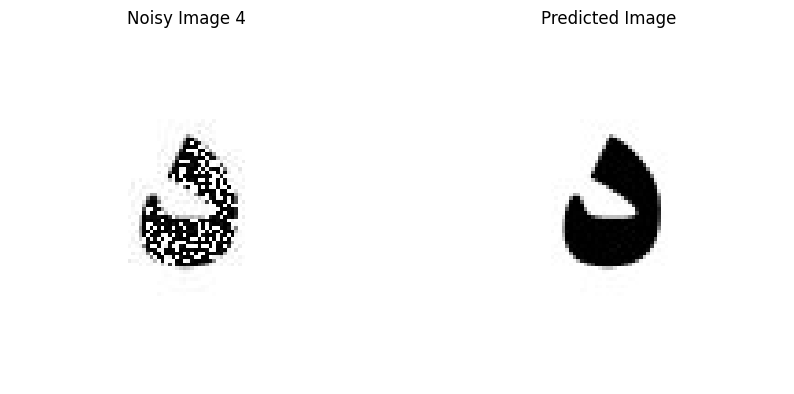

Given Image: noisy4.jpg, Predicted Image Index: 4


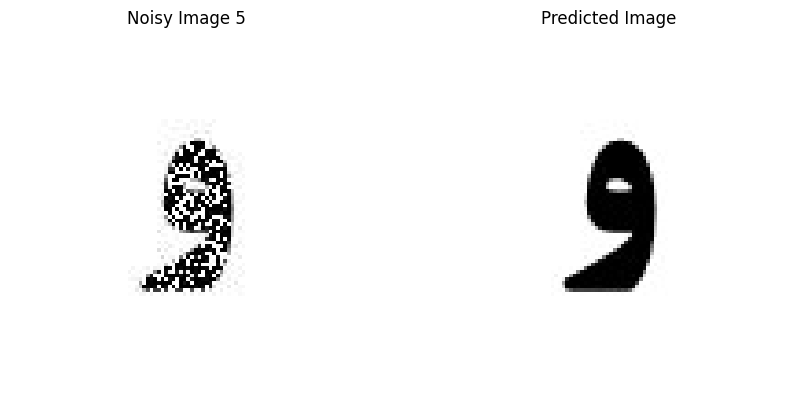

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 200 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 277 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 331 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 197 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 212 missing points and saved as noisy5.jpg


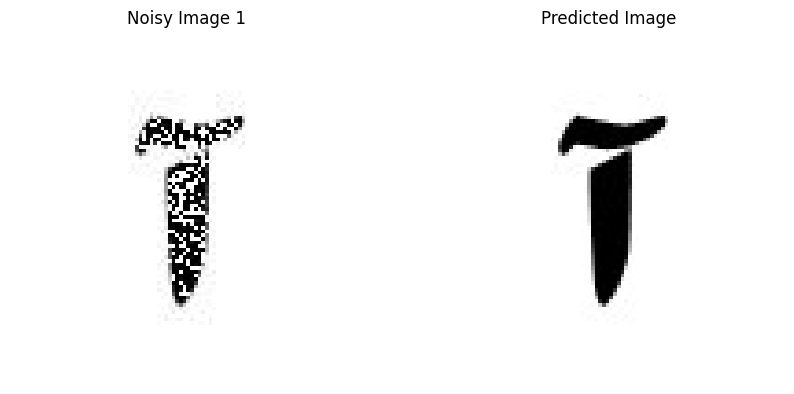

Given Image: noisy1.jpg, Predicted Image Index: 1


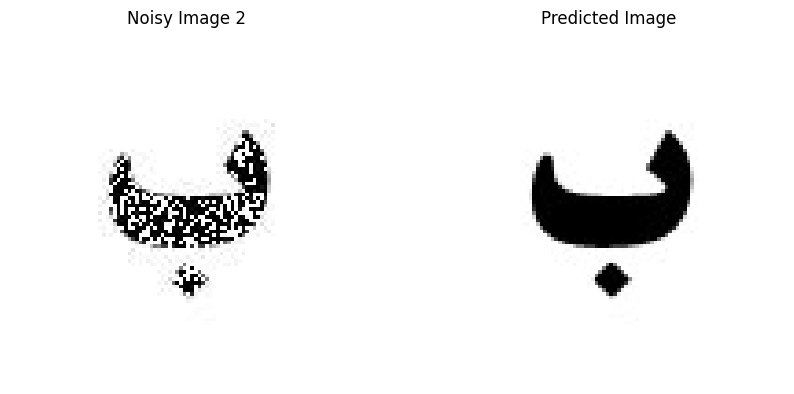

Given Image: noisy2.jpg, Predicted Image Index: 2


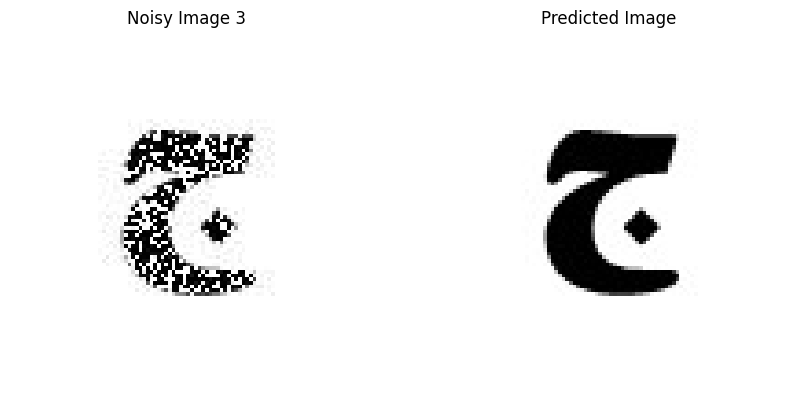

Given Image: noisy3.jpg, Predicted Image Index: 3


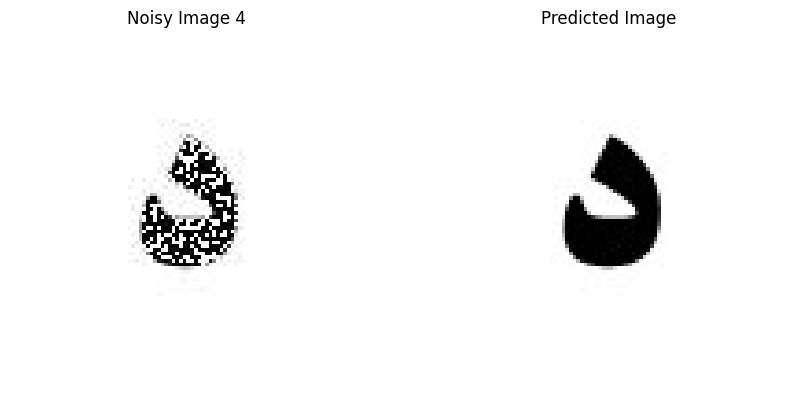

Given Image: noisy4.jpg, Predicted Image Index: 4


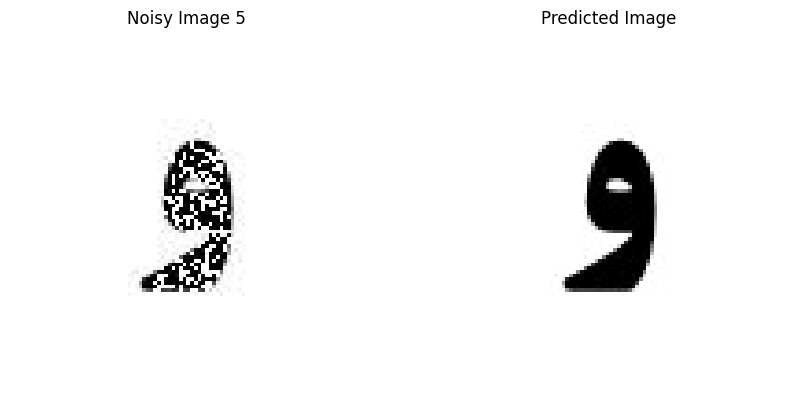

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 206 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 285 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 340 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 203 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 218 missing points and saved as noisy5.jpg


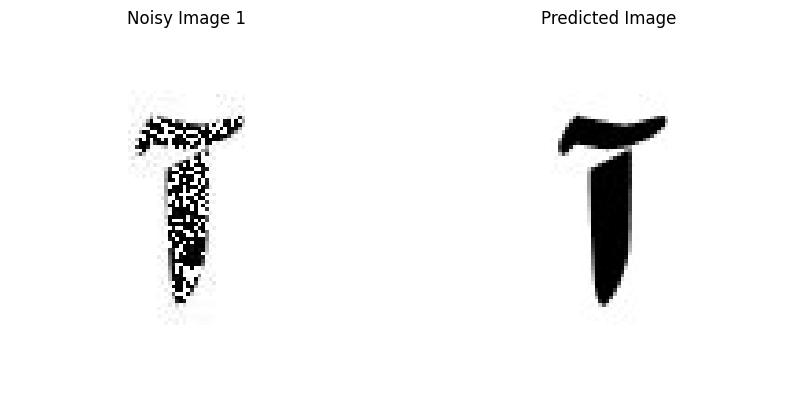

Given Image: noisy1.jpg, Predicted Image Index: 1


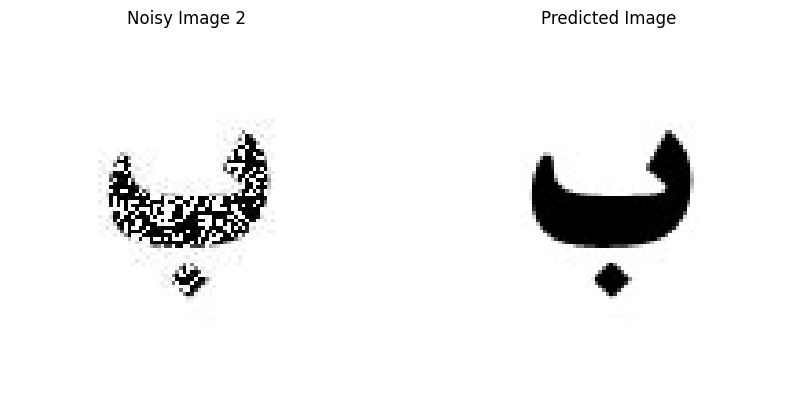

Given Image: noisy2.jpg, Predicted Image Index: 2


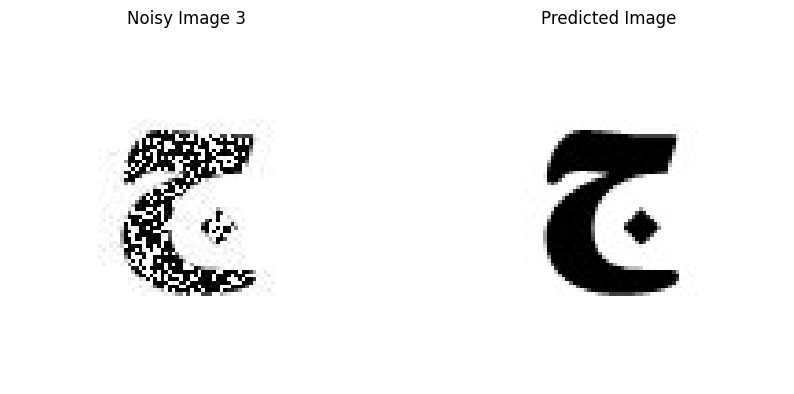

Given Image: noisy3.jpg, Predicted Image Index: 3


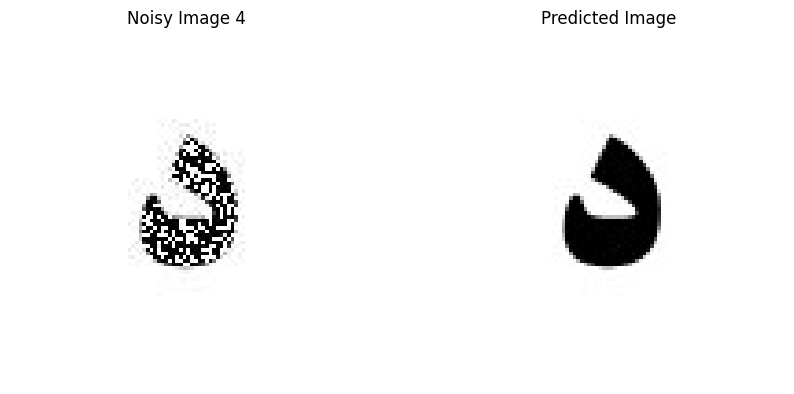

Given Image: noisy4.jpg, Predicted Image Index: 4


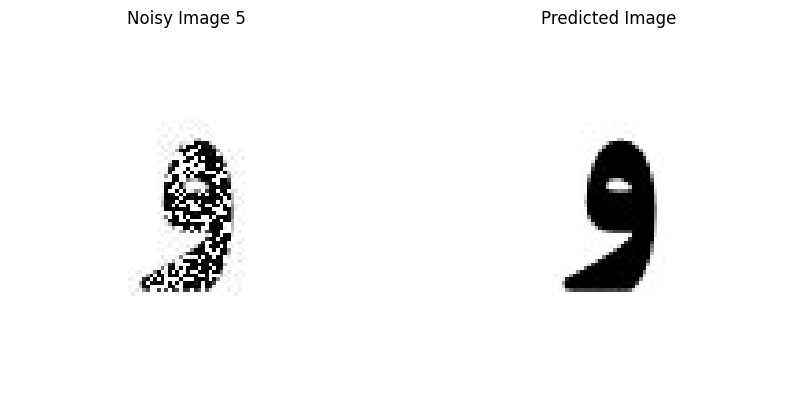

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 212 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 293 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 349 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 208 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 224 missing points and saved as noisy5.jpg


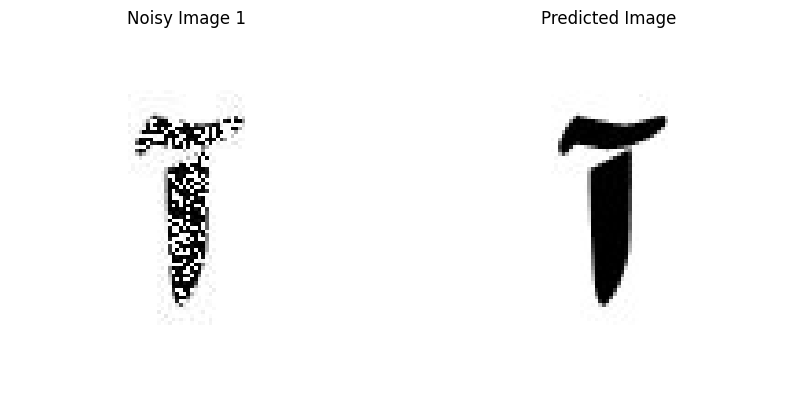

Given Image: noisy1.jpg, Predicted Image Index: 1


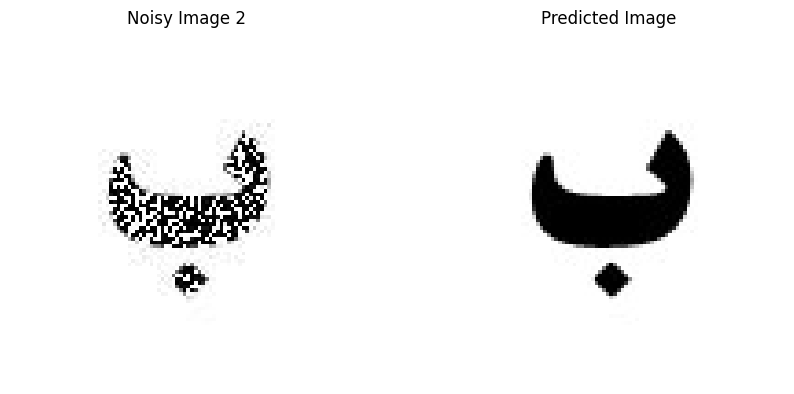

Given Image: noisy2.jpg, Predicted Image Index: 2


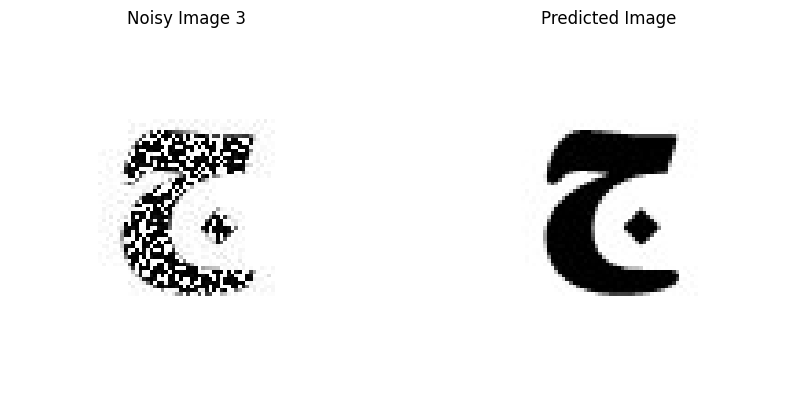

Given Image: noisy3.jpg, Predicted Image Index: 3


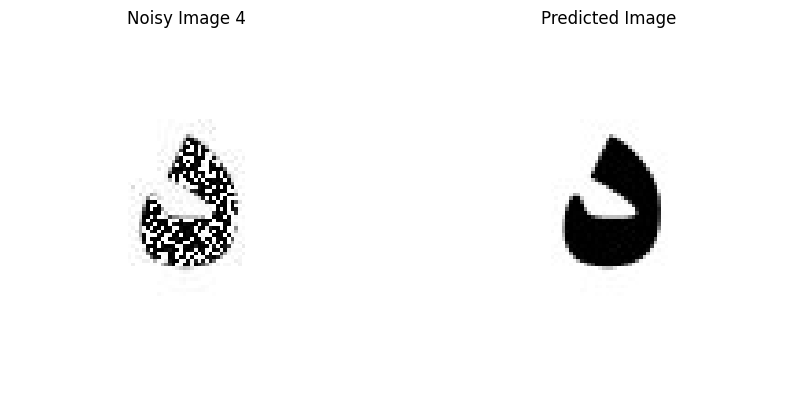

Given Image: noisy4.jpg, Predicted Image Index: 4


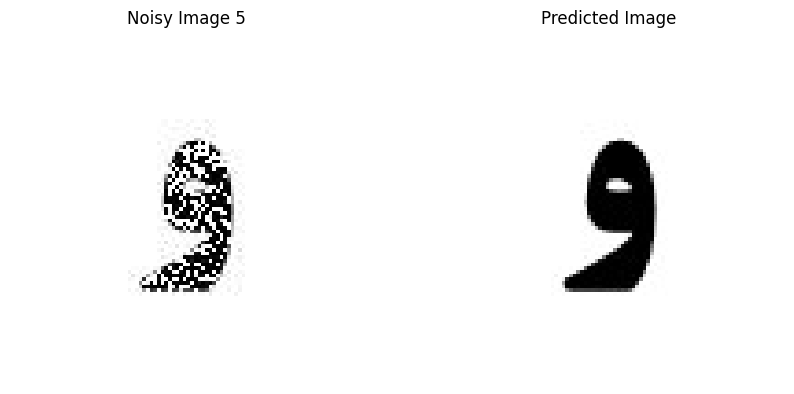

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 217 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 301 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 359 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 214 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 230 missing points and saved as noisy5.jpg


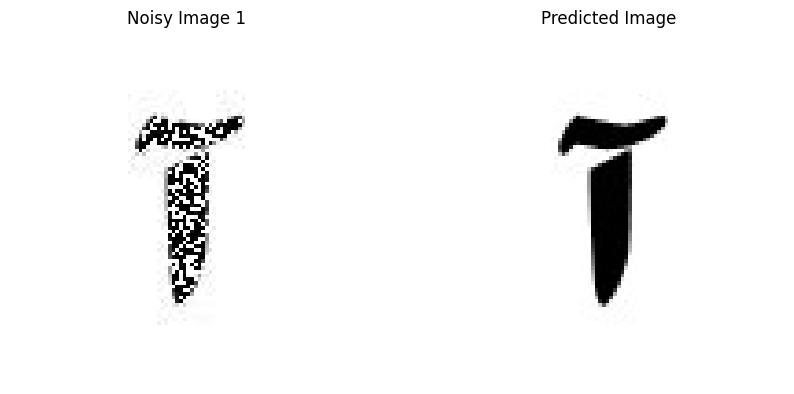

Given Image: noisy1.jpg, Predicted Image Index: 1


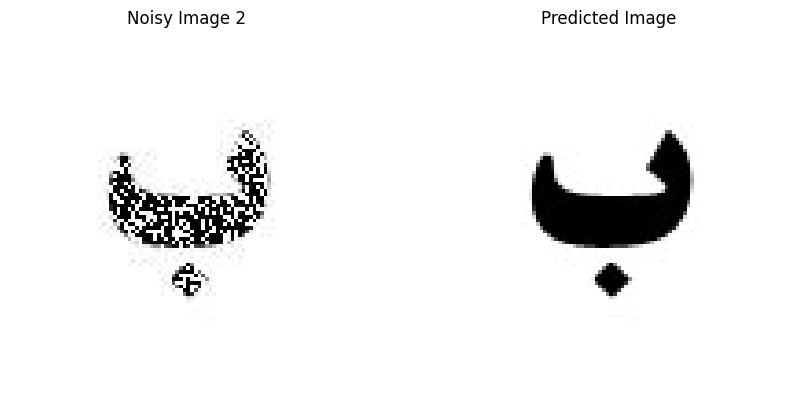

Given Image: noisy2.jpg, Predicted Image Index: 2


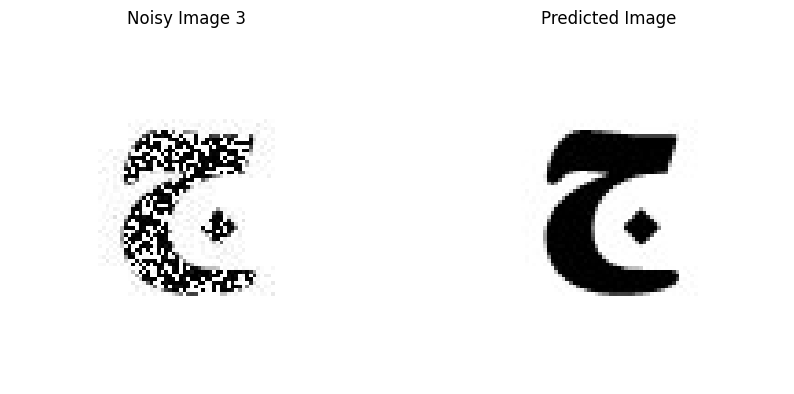

Given Image: noisy3.jpg, Predicted Image Index: 3


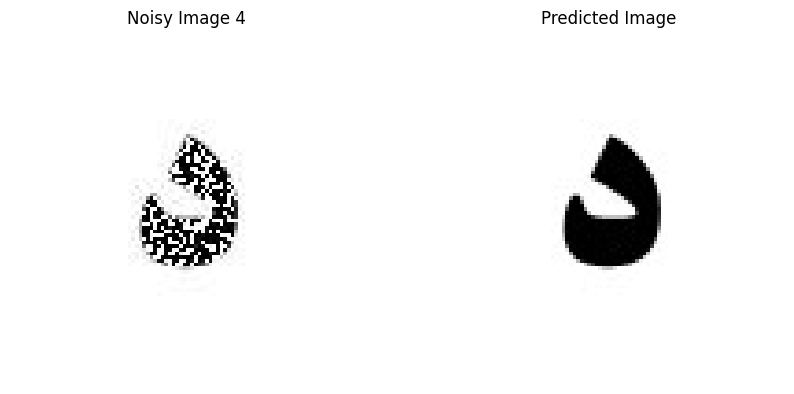

Given Image: noisy4.jpg, Predicted Image Index: 4


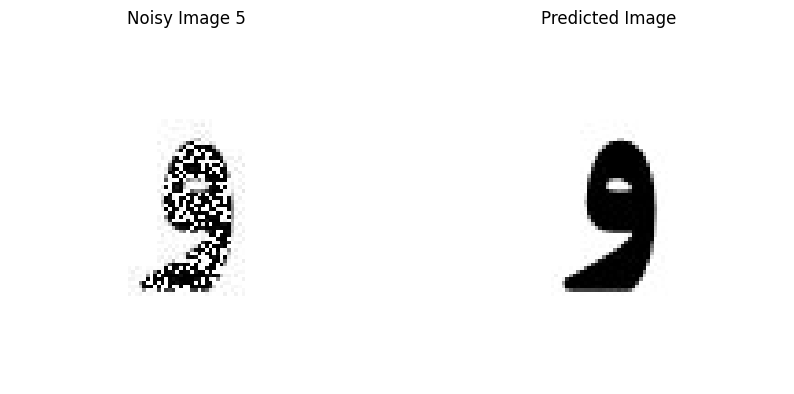

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 223 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 308 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 368 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 219 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 236 missing points and saved as noisy5.jpg


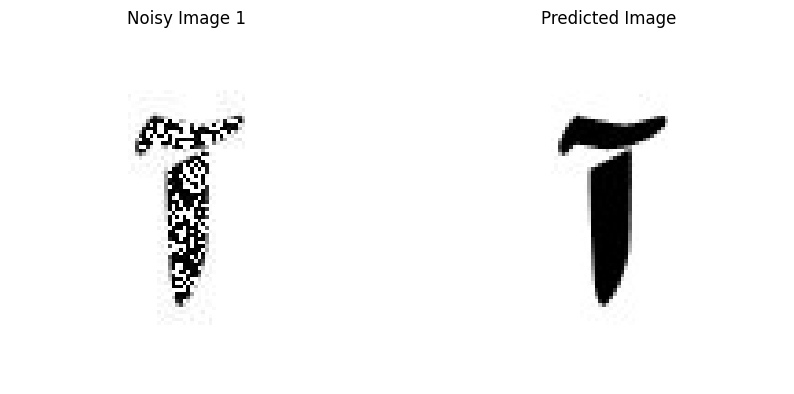

Given Image: noisy1.jpg, Predicted Image Index: 1


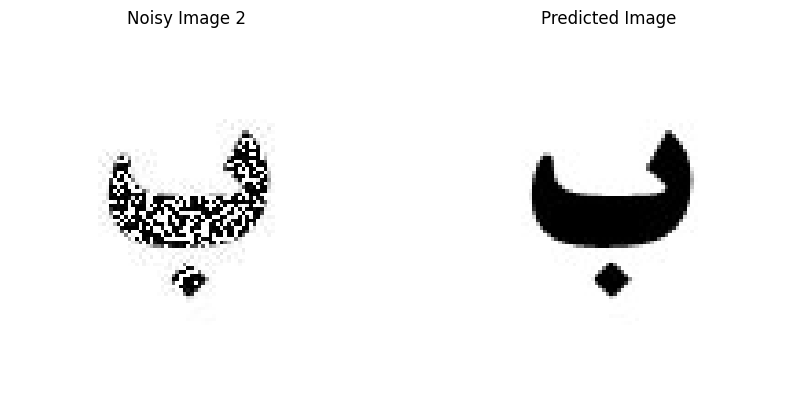

Given Image: noisy2.jpg, Predicted Image Index: 2


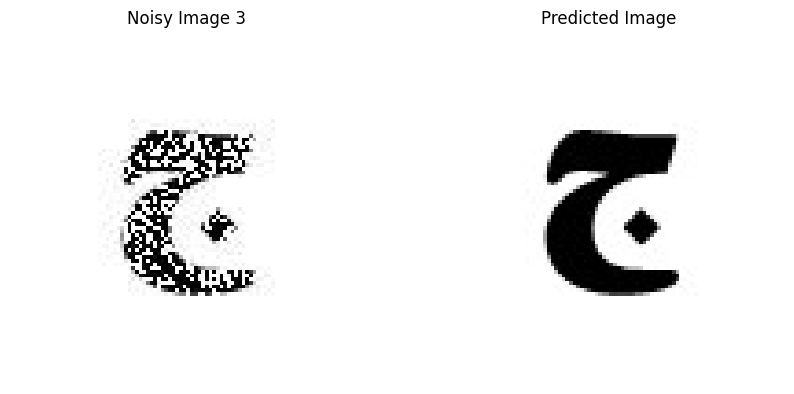

Given Image: noisy3.jpg, Predicted Image Index: 3


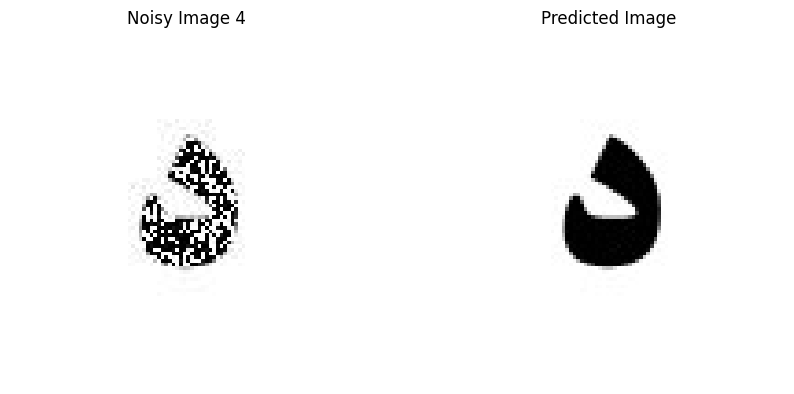

Given Image: noisy4.jpg, Predicted Image Index: 4


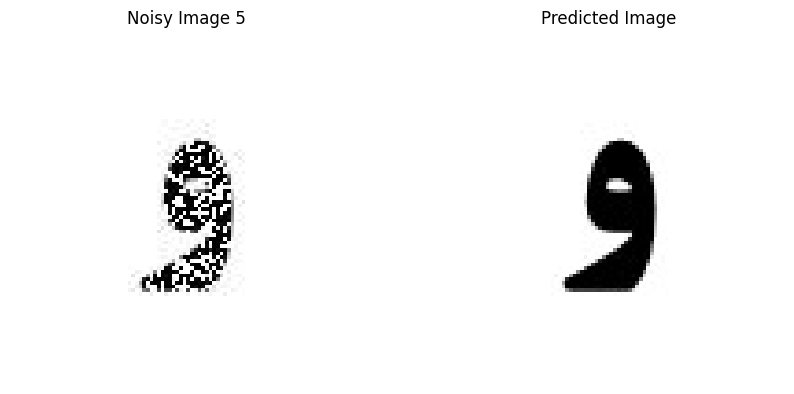

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 228 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 316 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 377 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 225 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 241 missing points and saved as noisy5.jpg


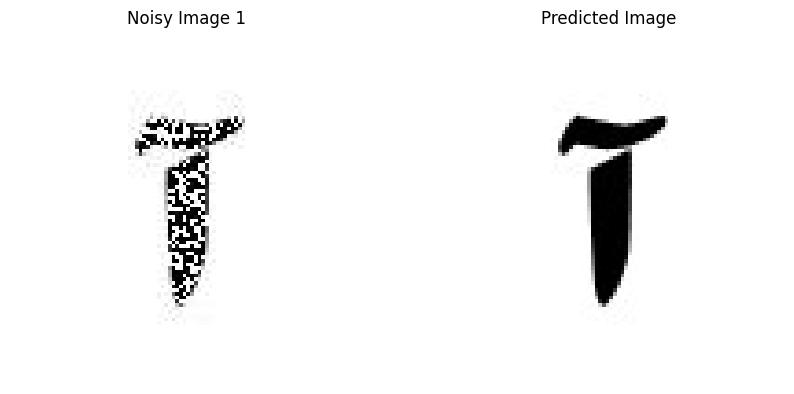

Given Image: noisy1.jpg, Predicted Image Index: 1


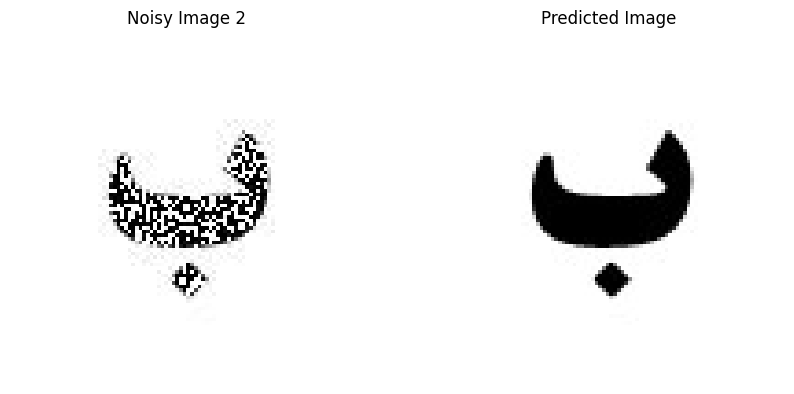

Given Image: noisy2.jpg, Predicted Image Index: 2


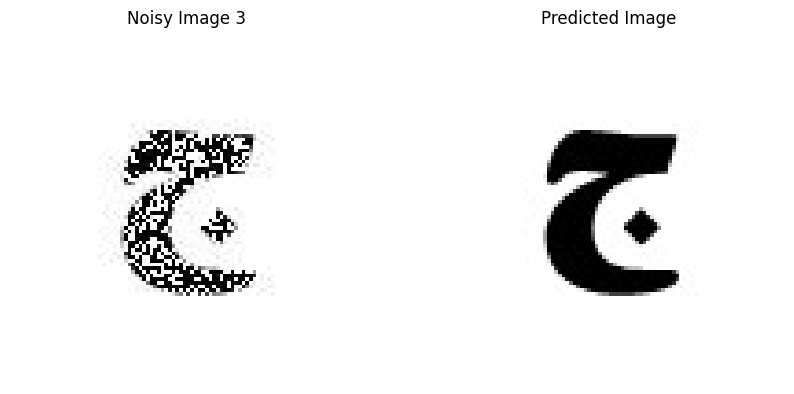

Given Image: noisy3.jpg, Predicted Image Index: 3


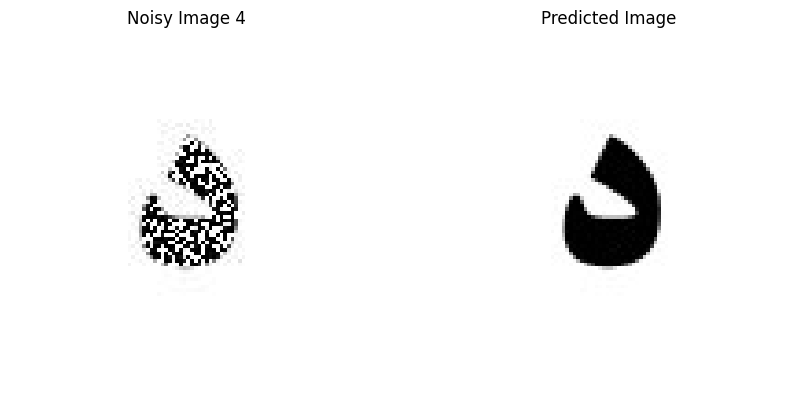

Given Image: noisy4.jpg, Predicted Image Index: 4


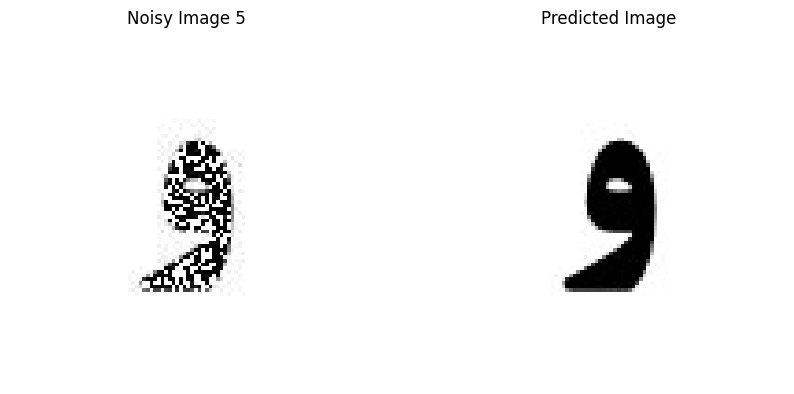

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 234 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 324 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 386 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 230 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 247 missing points and saved as noisy5.jpg


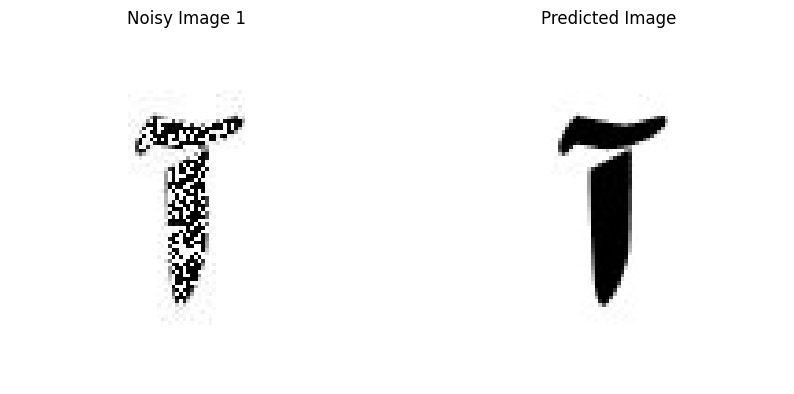

Given Image: noisy1.jpg, Predicted Image Index: 1


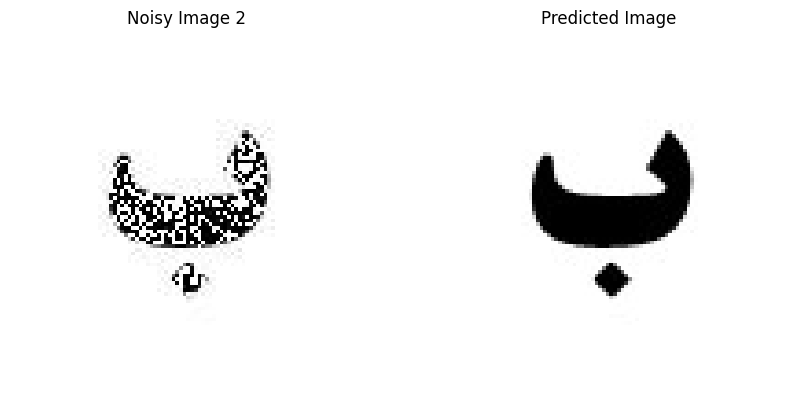

Given Image: noisy2.jpg, Predicted Image Index: 2


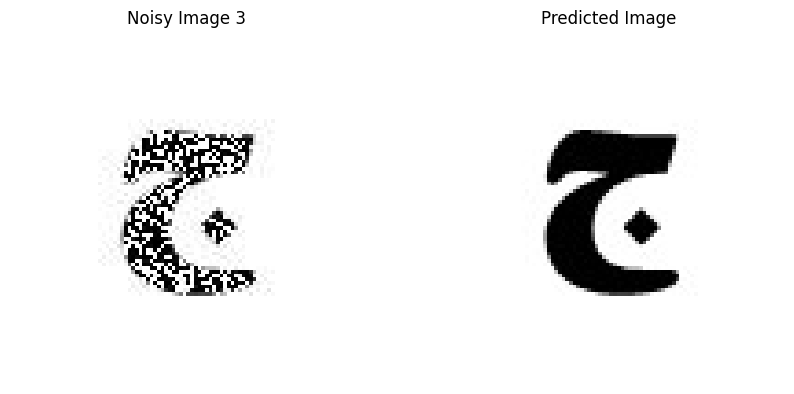

Given Image: noisy3.jpg, Predicted Image Index: 3


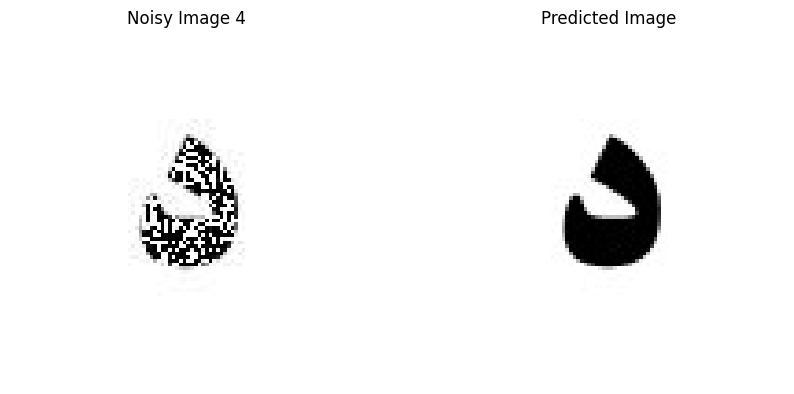

Given Image: noisy4.jpg, Predicted Image Index: 4


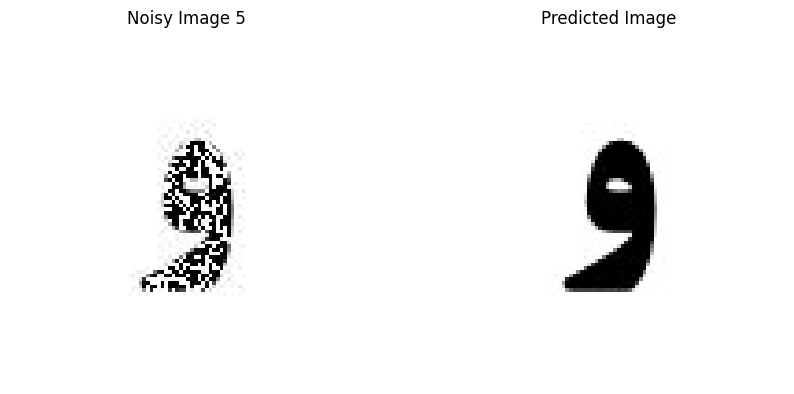

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 239 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 331 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 396 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 236 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 253 missing points and saved as noisy5.jpg


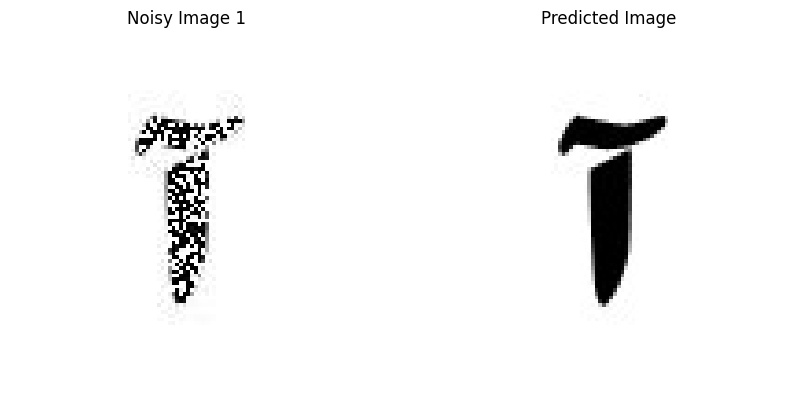

Given Image: noisy1.jpg, Predicted Image Index: 1


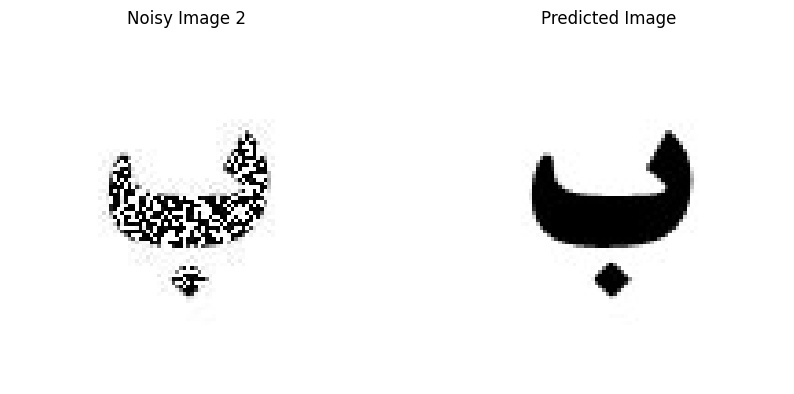

Given Image: noisy2.jpg, Predicted Image Index: 2


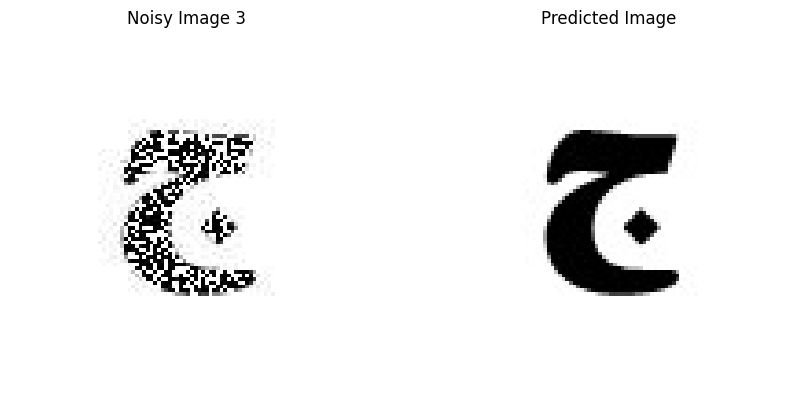

Given Image: noisy3.jpg, Predicted Image Index: 3


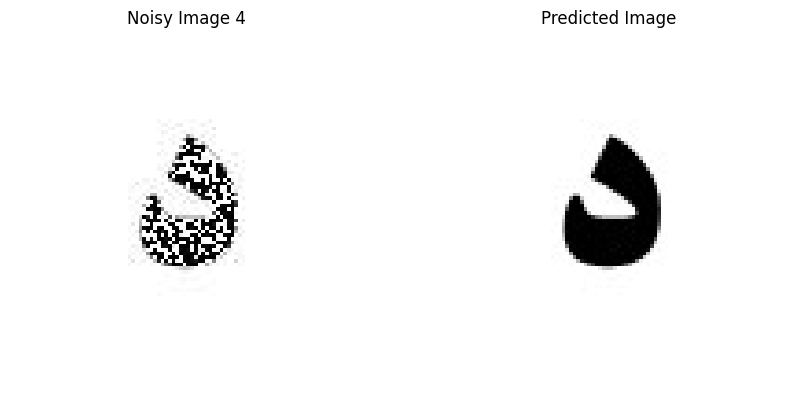

Given Image: noisy4.jpg, Predicted Image Index: 4


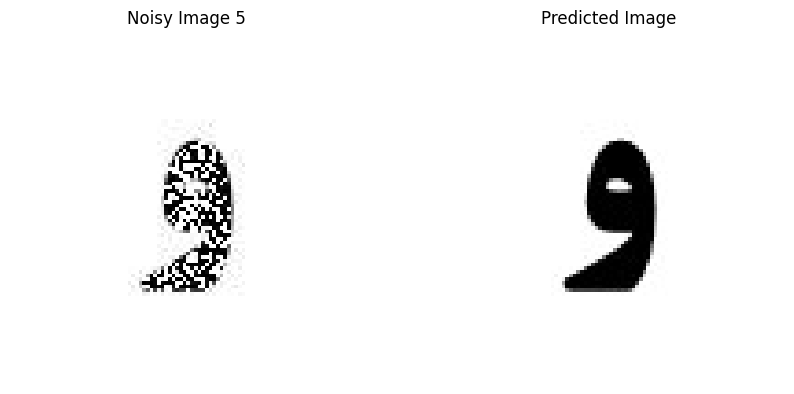

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 245 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 339 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 405 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 241 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 259 missing points and saved as noisy5.jpg


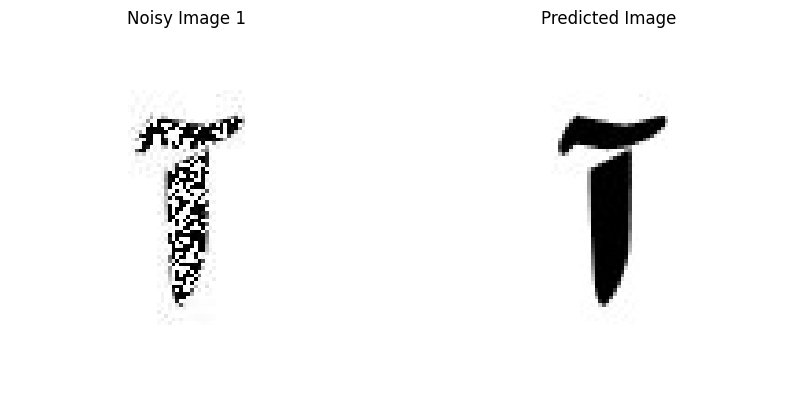

Given Image: noisy1.jpg, Predicted Image Index: 1


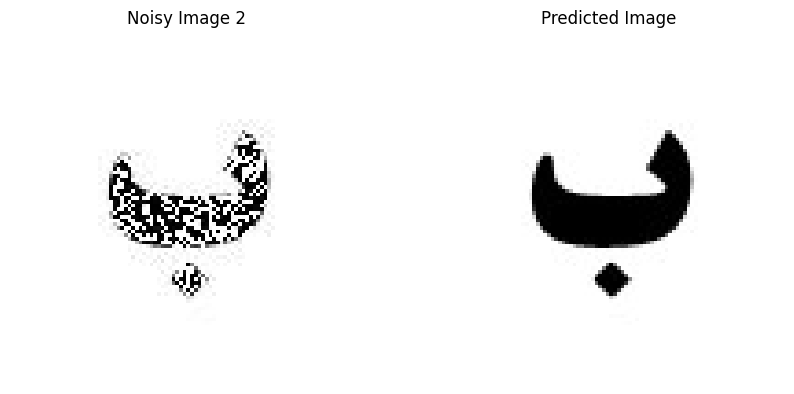

Given Image: noisy2.jpg, Predicted Image Index: 2


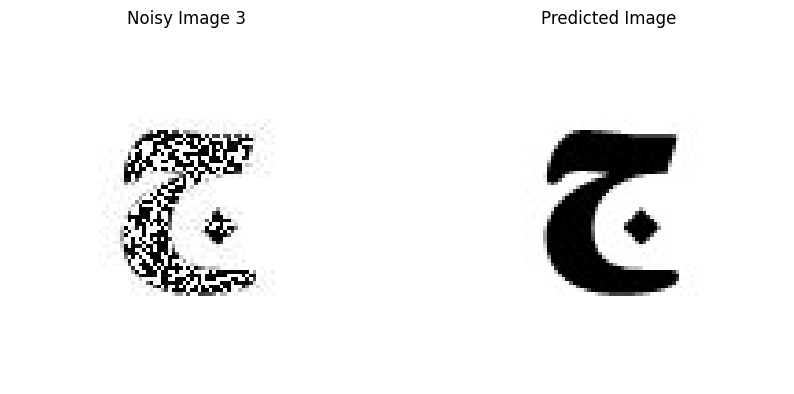

Given Image: noisy3.jpg, Predicted Image Index: 3


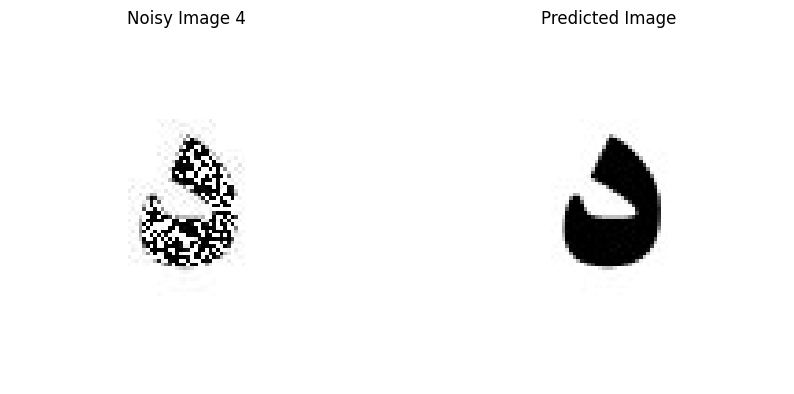

Given Image: noisy4.jpg, Predicted Image Index: 4


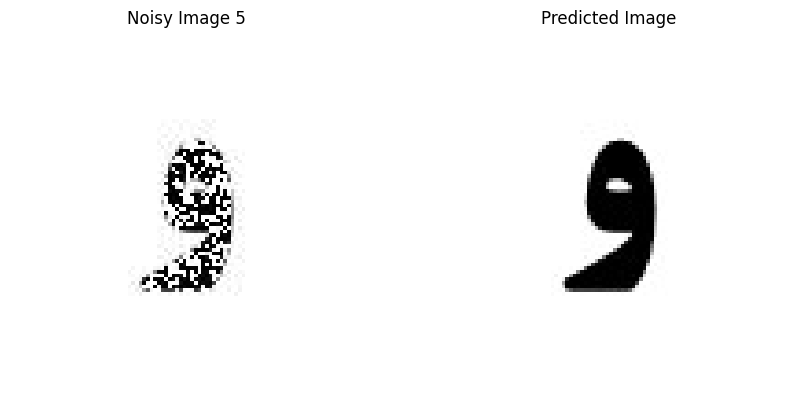

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 251 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 347 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 414 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 247 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 265 missing points and saved as noisy5.jpg


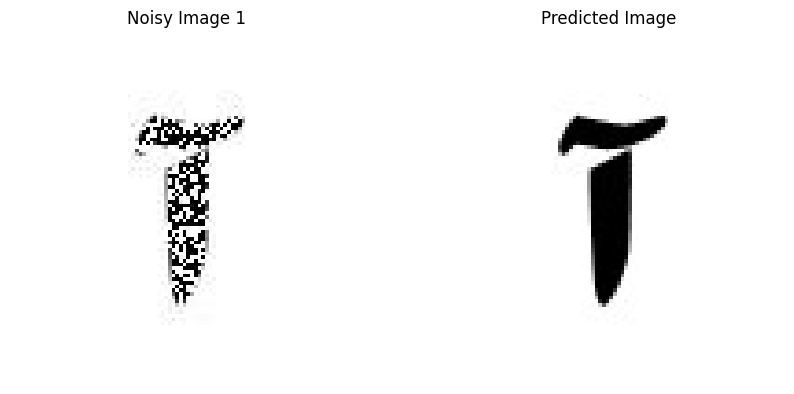

Given Image: noisy1.jpg, Predicted Image Index: 1


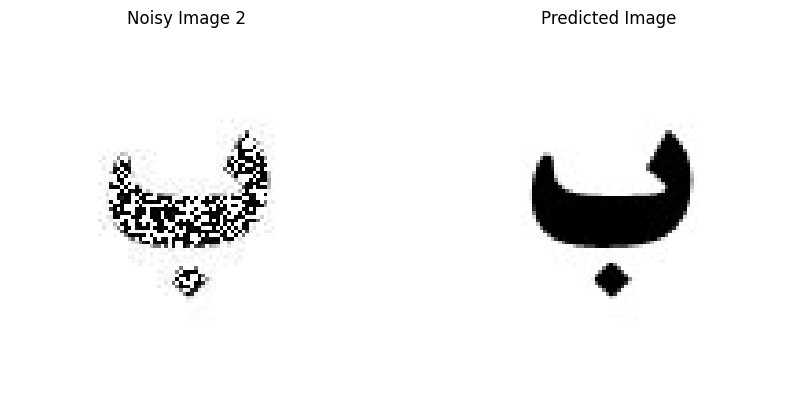

Given Image: noisy2.jpg, Predicted Image Index: 2


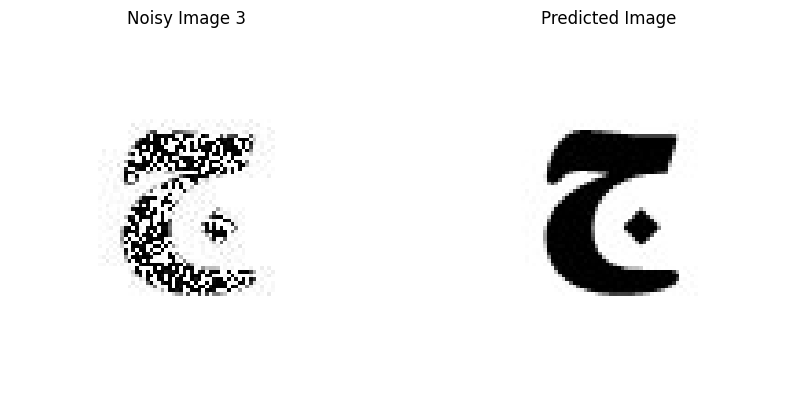

Given Image: noisy3.jpg, Predicted Image Index: 3


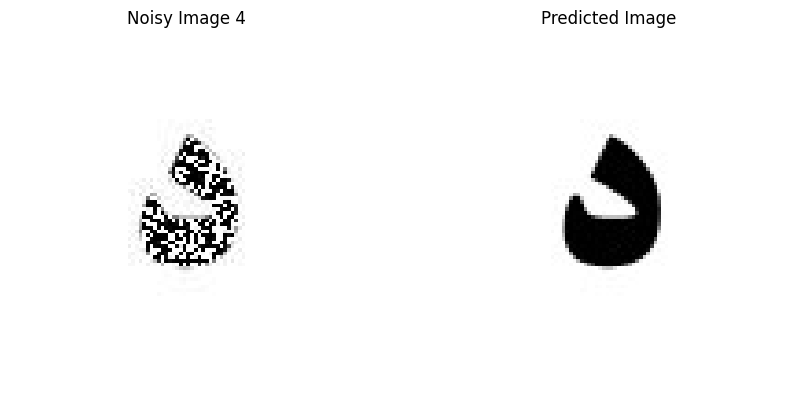

Given Image: noisy4.jpg, Predicted Image Index: 4


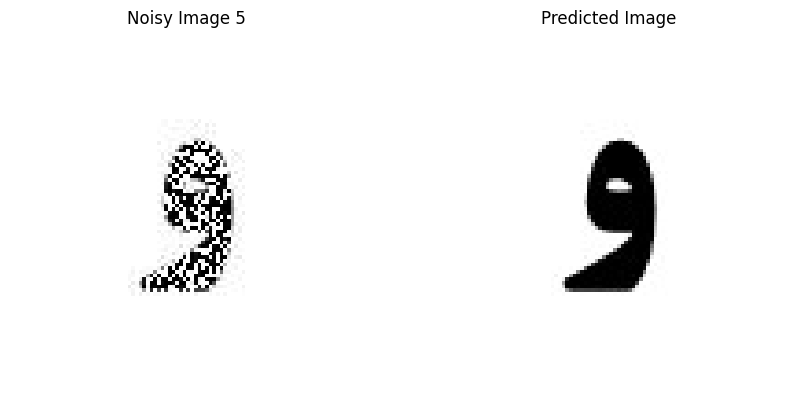

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 256 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 355 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 423 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 252 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 271 missing points and saved as noisy5.jpg


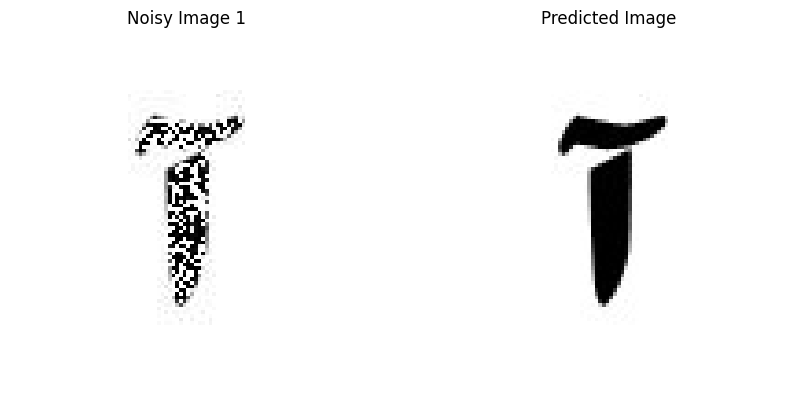

Given Image: noisy1.jpg, Predicted Image Index: 1


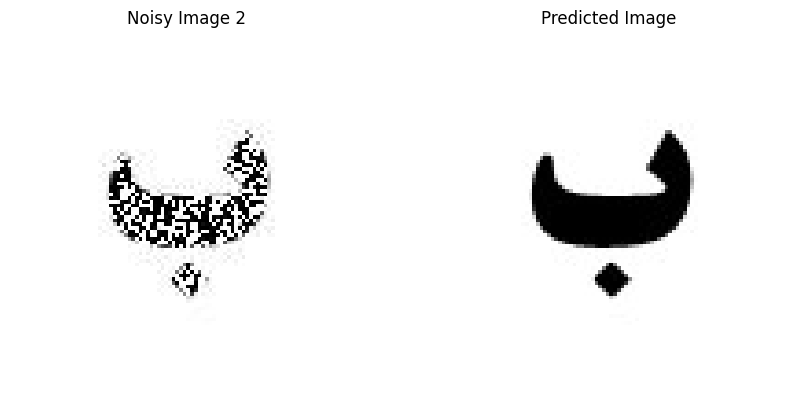

Given Image: noisy2.jpg, Predicted Image Index: 2


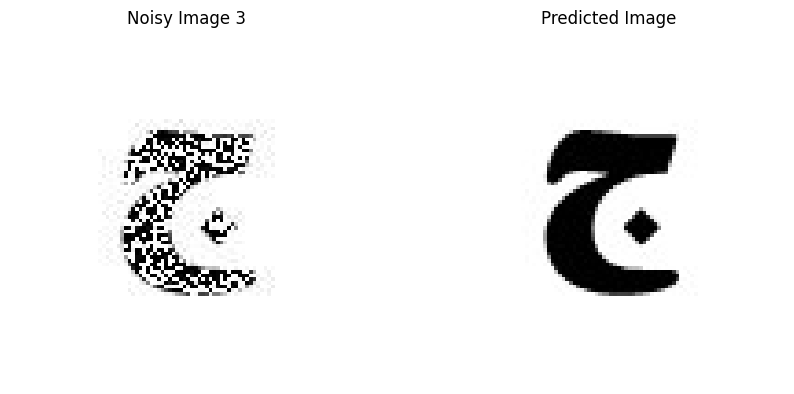

Given Image: noisy3.jpg, Predicted Image Index: 3


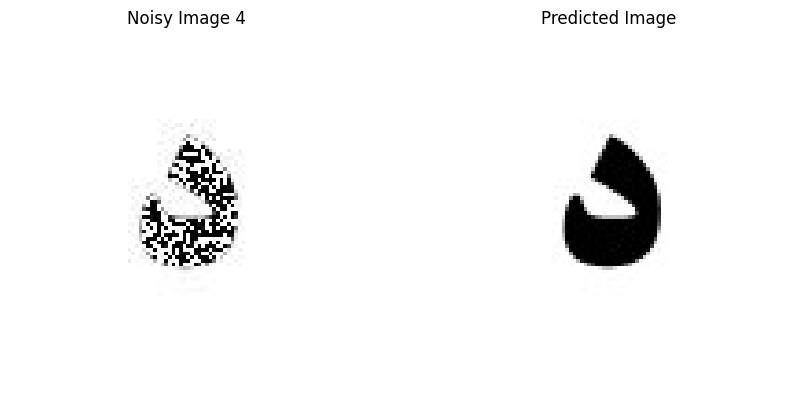

Given Image: noisy4.jpg, Predicted Image Index: 4


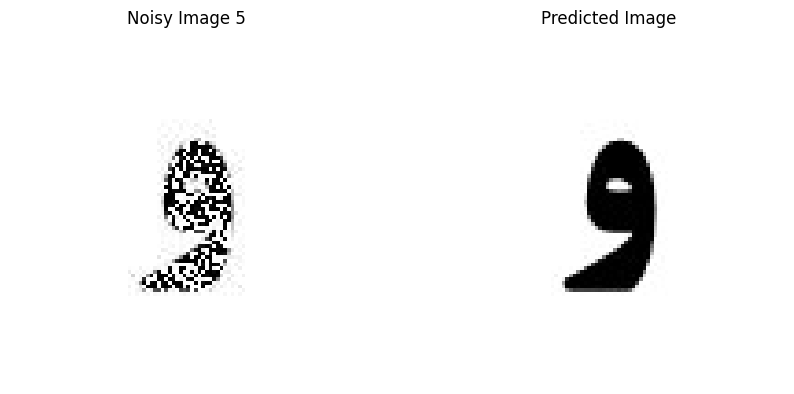

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 262 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 362 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 432 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 258 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 277 missing points and saved as noisy5.jpg


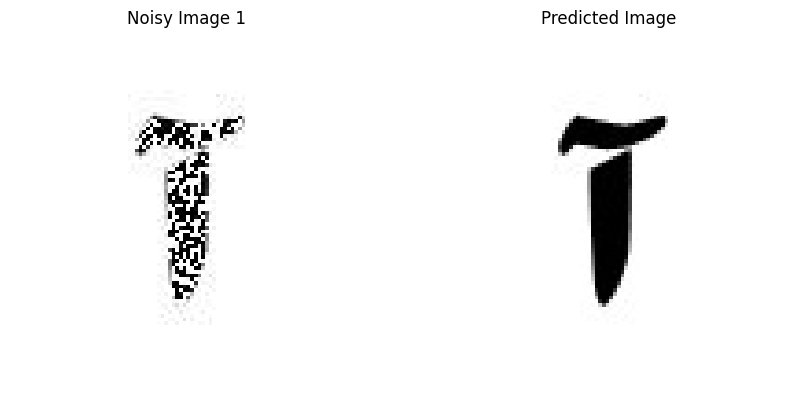

Given Image: noisy1.jpg, Predicted Image Index: 1


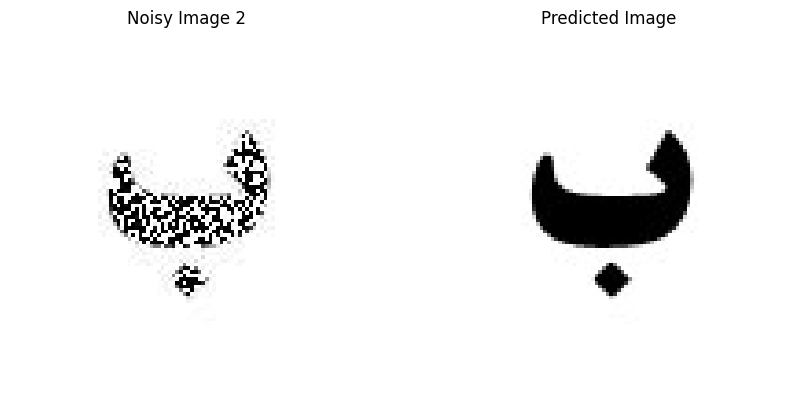

Given Image: noisy2.jpg, Predicted Image Index: 2


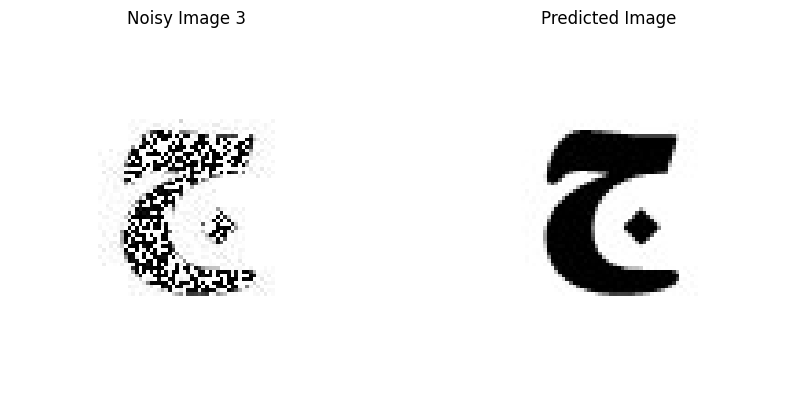

Given Image: noisy3.jpg, Predicted Image Index: 3


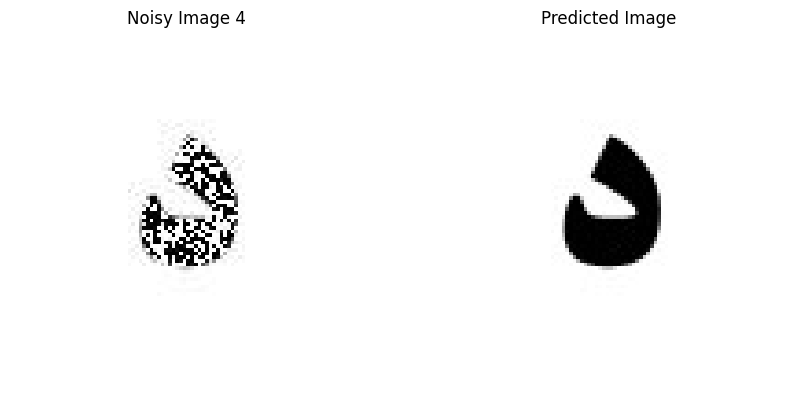

Given Image: noisy4.jpg, Predicted Image Index: 4


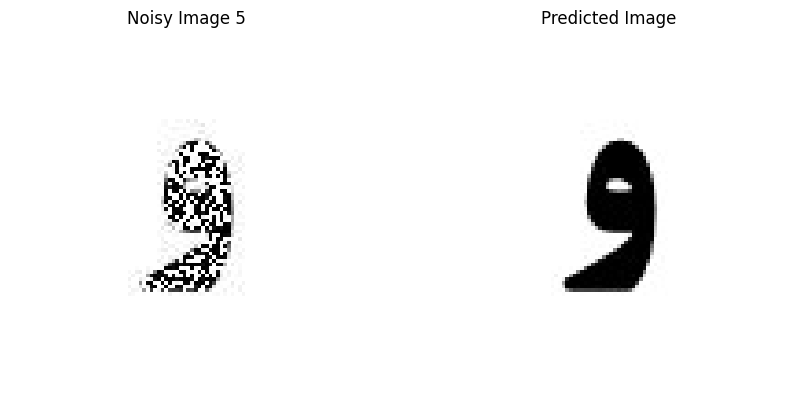

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 267 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 370 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 442 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 263 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 283 missing points and saved as noisy5.jpg


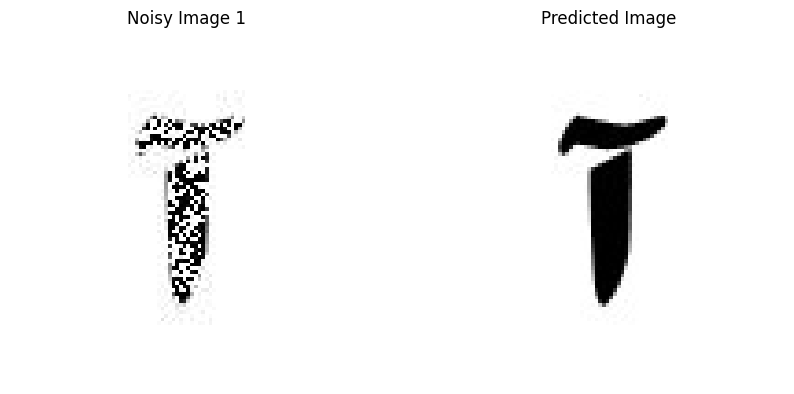

Given Image: noisy1.jpg, Predicted Image Index: 1


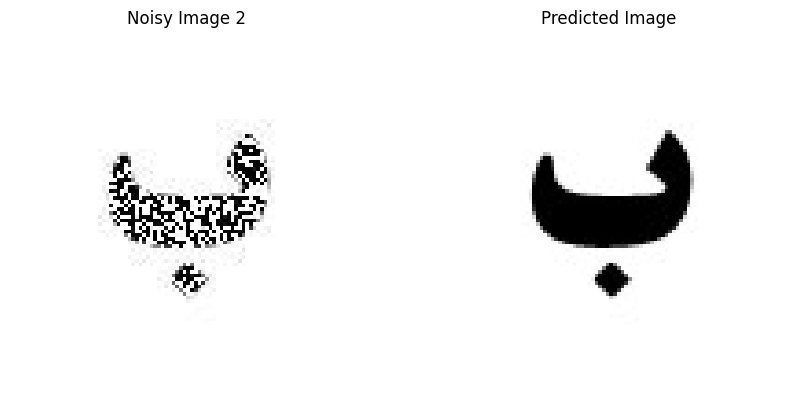

Given Image: noisy2.jpg, Predicted Image Index: 2


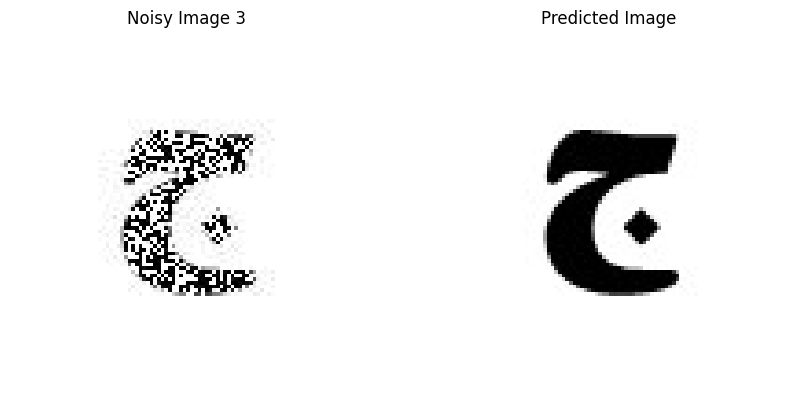

Given Image: noisy3.jpg, Predicted Image Index: 3


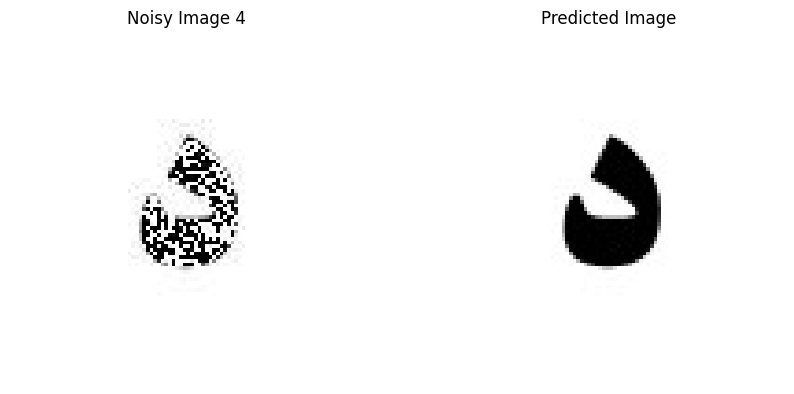

Given Image: noisy4.jpg, Predicted Image Index: 4


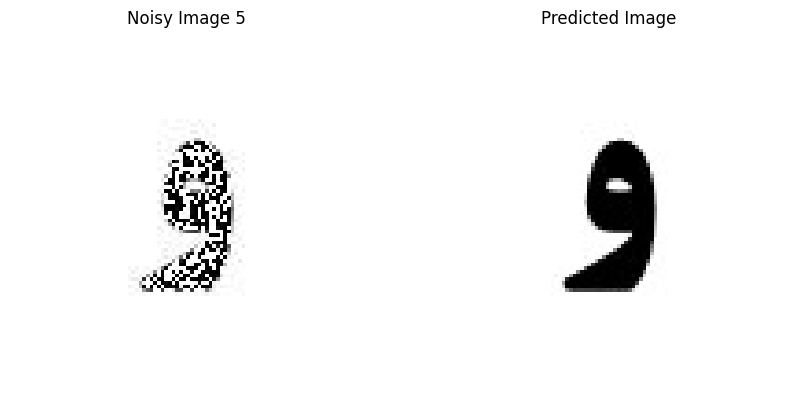

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 273 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 378 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 451 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 269 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 289 missing points and saved as noisy5.jpg


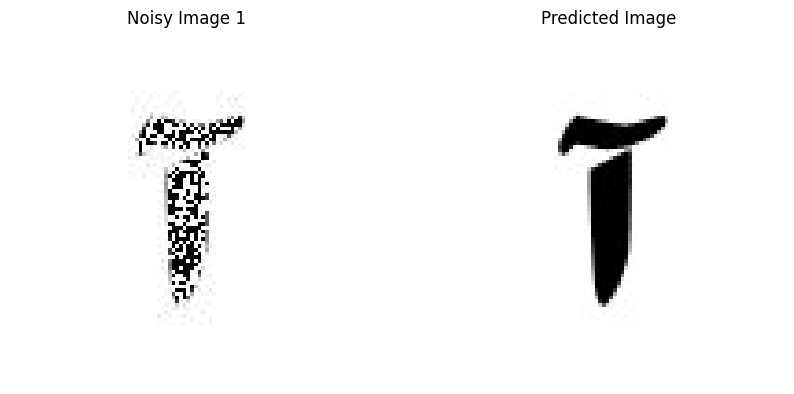

Given Image: noisy1.jpg, Predicted Image Index: 1


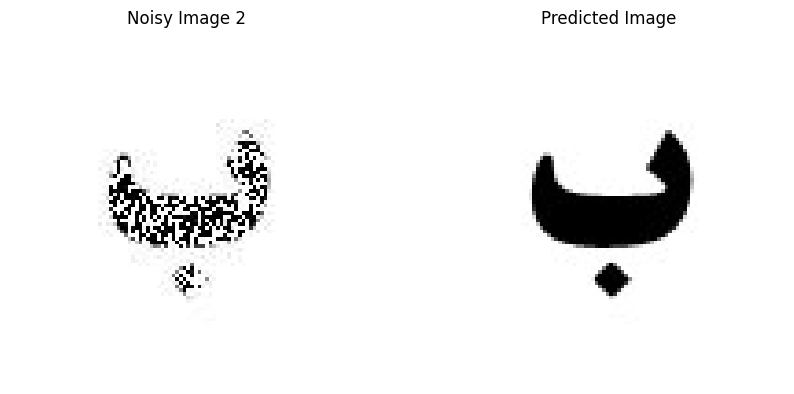

Given Image: noisy2.jpg, Predicted Image Index: 2


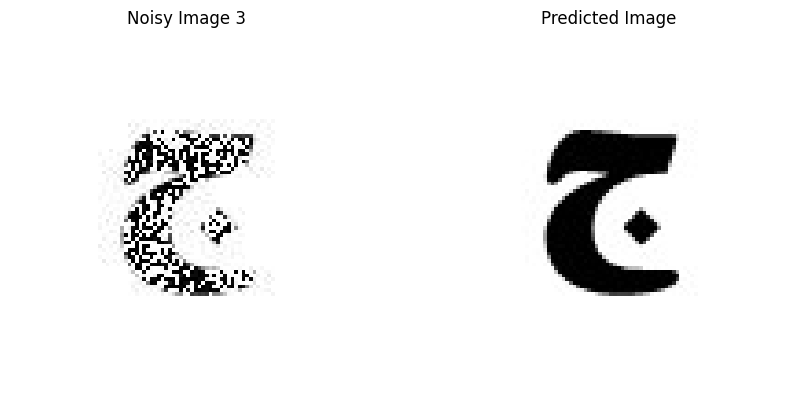

Given Image: noisy3.jpg, Predicted Image Index: 3


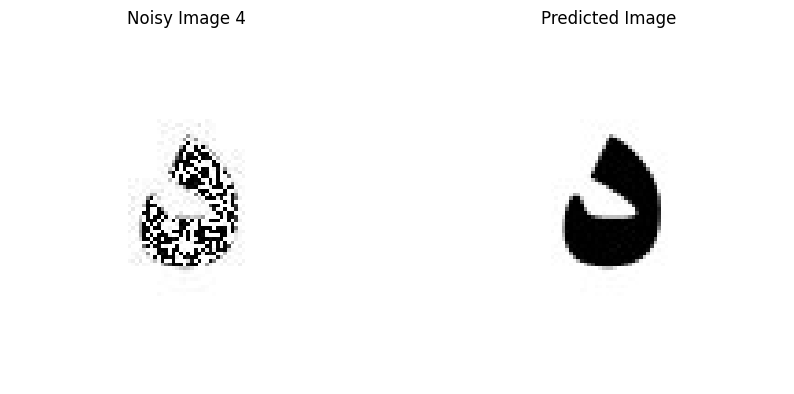

Given Image: noisy4.jpg, Predicted Image Index: 4


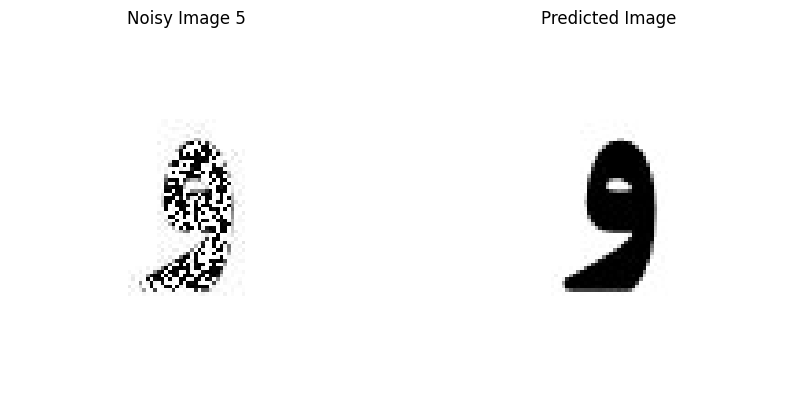

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 279 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 386 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 460 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 274 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 295 missing points and saved as noisy5.jpg


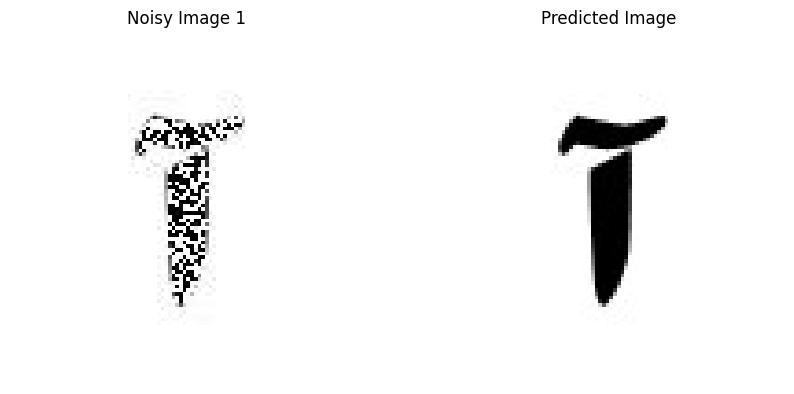

Given Image: noisy1.jpg, Predicted Image Index: 1


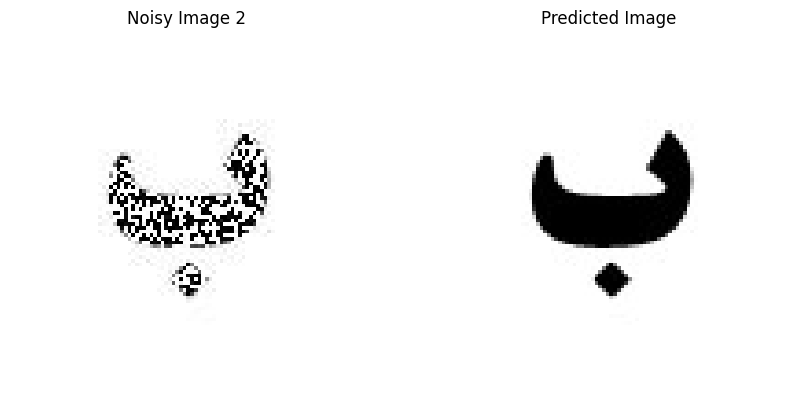

Given Image: noisy2.jpg, Predicted Image Index: 2


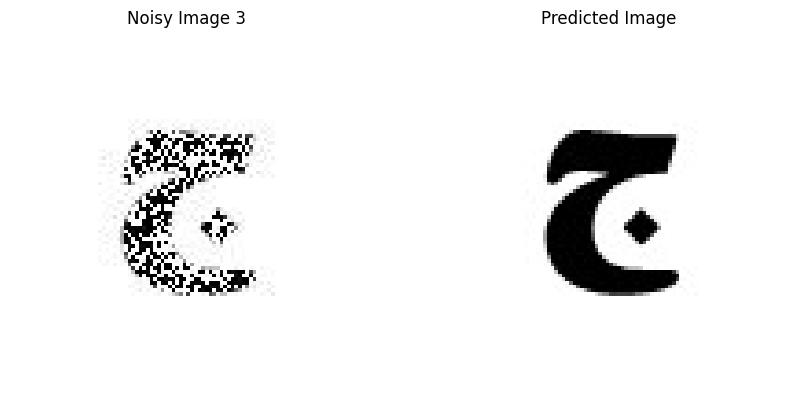

Given Image: noisy3.jpg, Predicted Image Index: 3


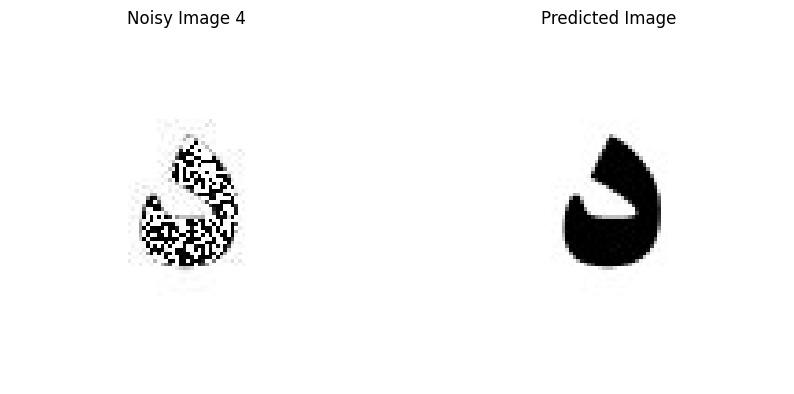

Given Image: noisy4.jpg, Predicted Image Index: 4


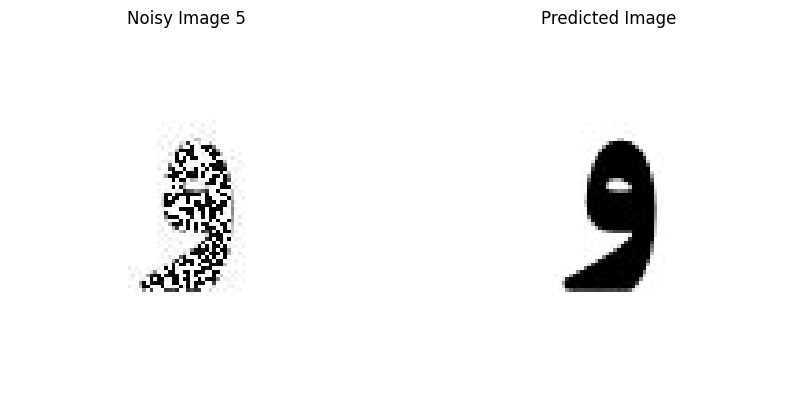

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 284 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 393 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 469 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 279 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 300 missing points and saved as noisy5.jpg


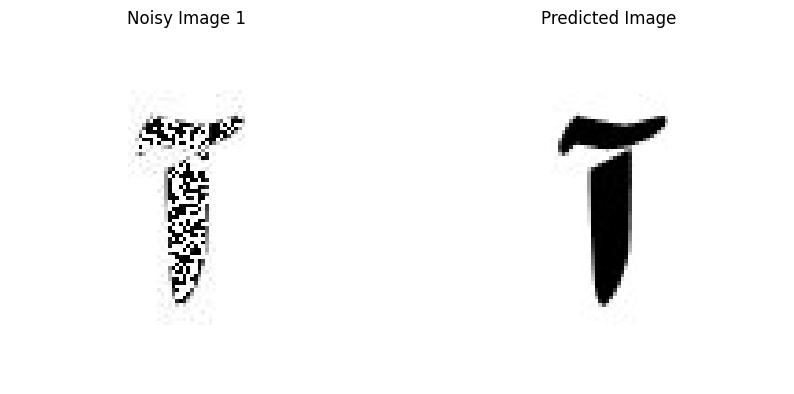

Given Image: noisy1.jpg, Predicted Image Index: 1


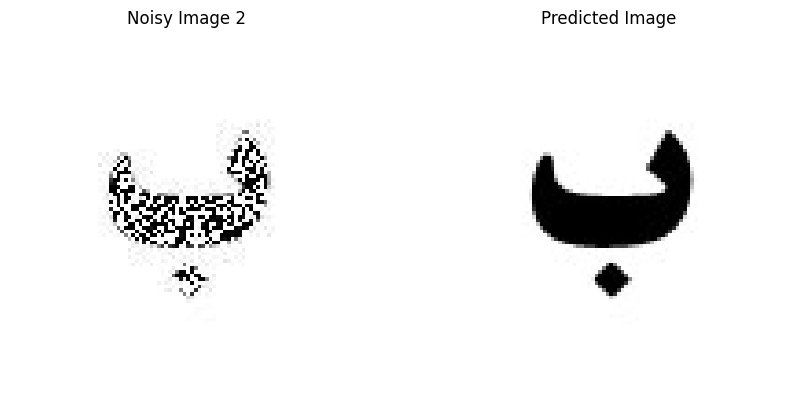

Given Image: noisy2.jpg, Predicted Image Index: 2


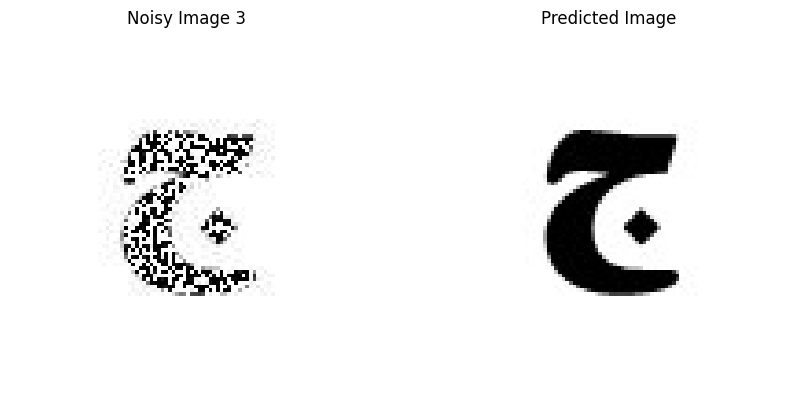

Given Image: noisy3.jpg, Predicted Image Index: 3


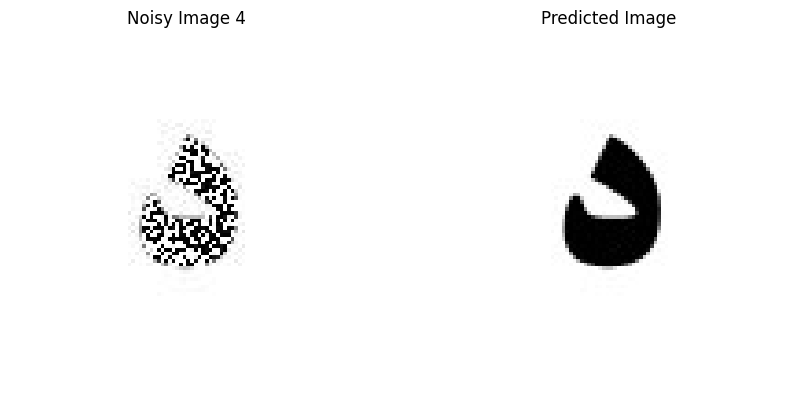

Given Image: noisy4.jpg, Predicted Image Index: 4


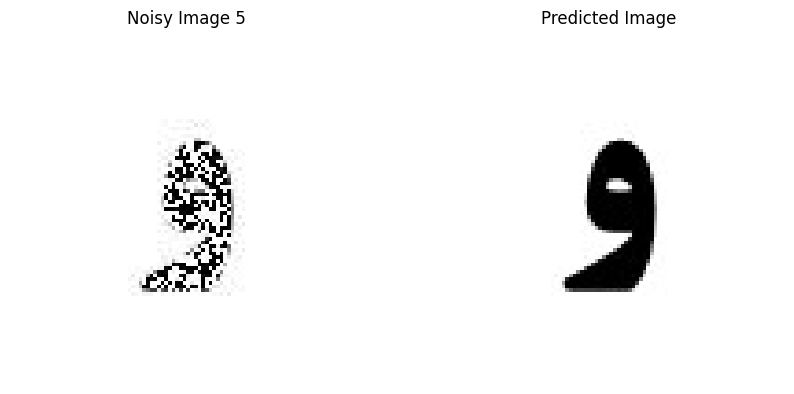

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 290 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 401 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 478 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 285 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 306 missing points and saved as noisy5.jpg


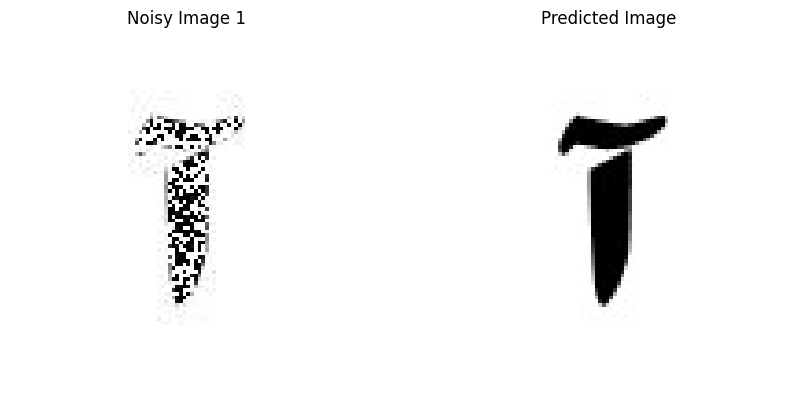

Given Image: noisy1.jpg, Predicted Image Index: 1


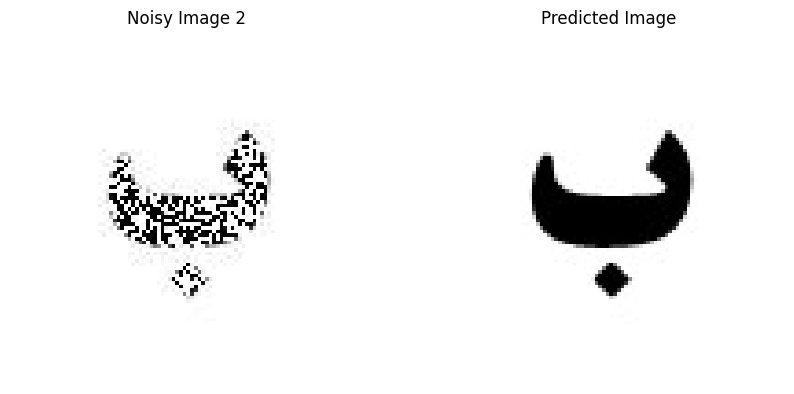

Given Image: noisy2.jpg, Predicted Image Index: 2


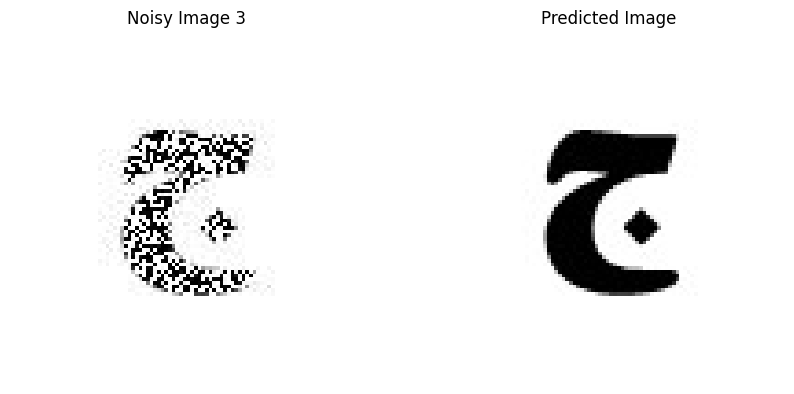

Given Image: noisy3.jpg, Predicted Image Index: 3


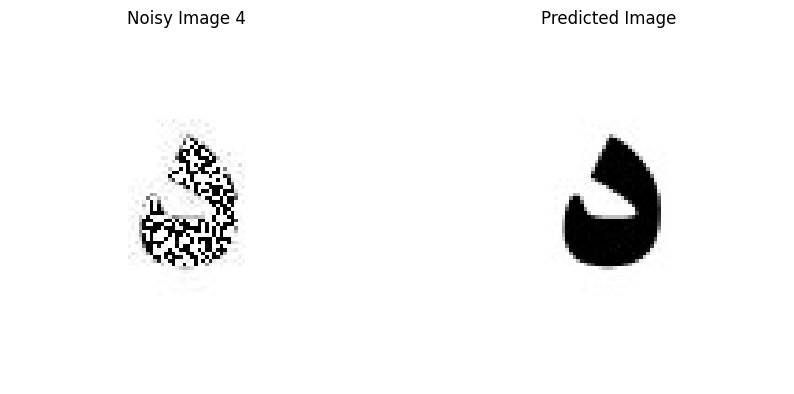

Given Image: noisy4.jpg, Predicted Image Index: 4


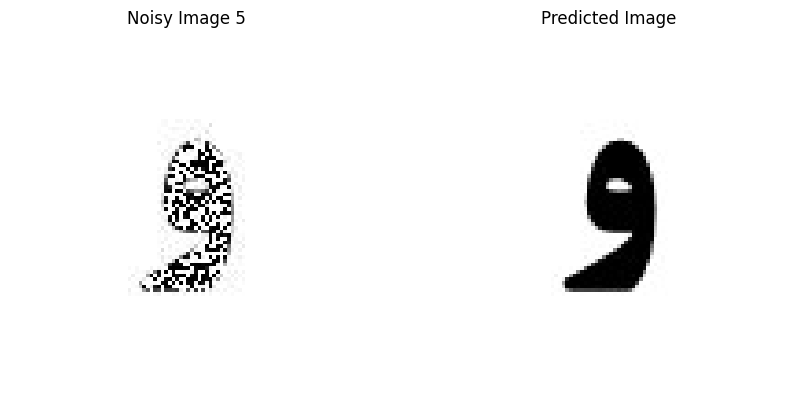

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 295 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 409 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 488 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 290 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 312 missing points and saved as noisy5.jpg


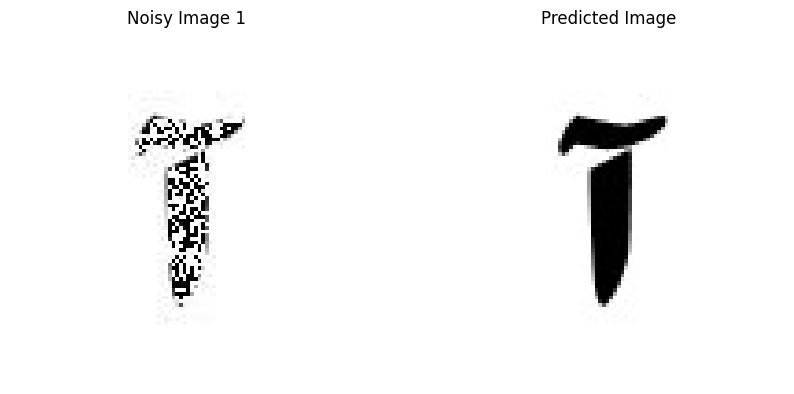

Given Image: noisy1.jpg, Predicted Image Index: 1


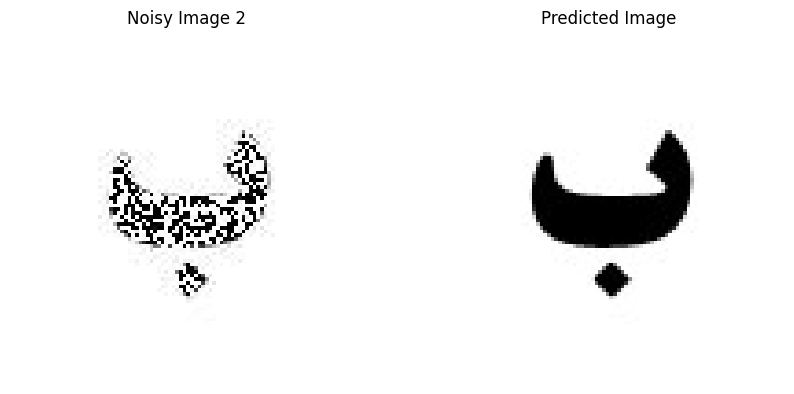

Given Image: noisy2.jpg, Predicted Image Index: 2


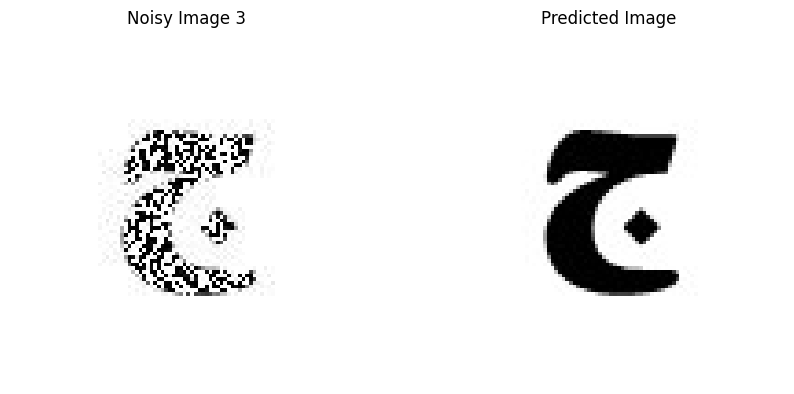

Given Image: noisy3.jpg, Predicted Image Index: 3


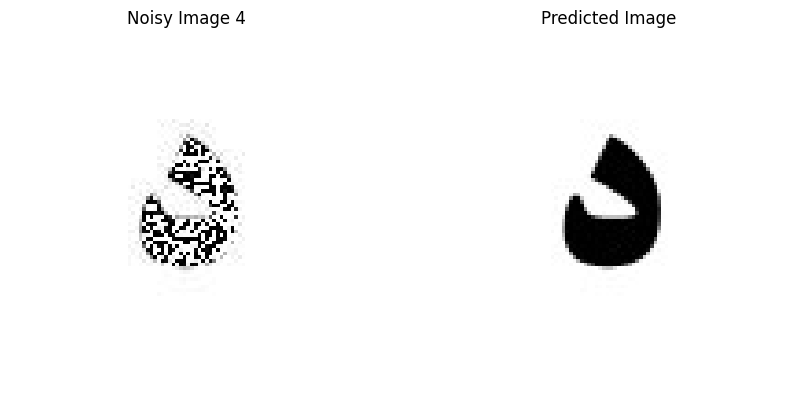

Given Image: noisy4.jpg, Predicted Image Index: 4


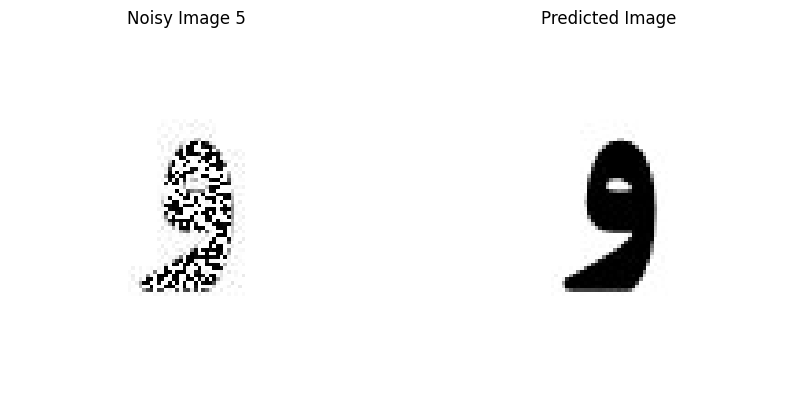

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 301 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 416 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 497 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 296 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 318 missing points and saved as noisy5.jpg


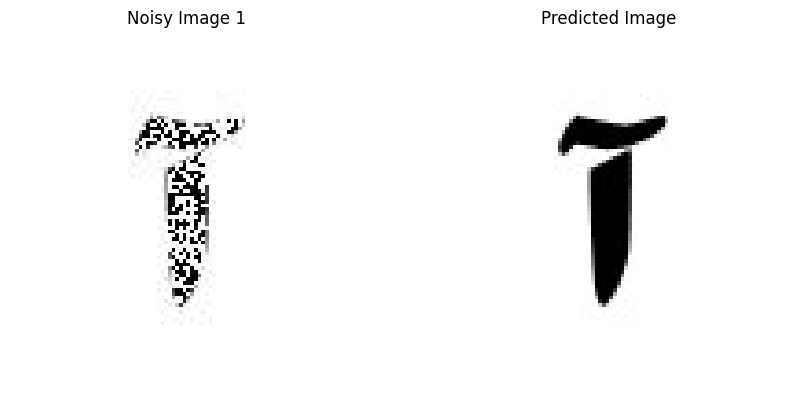

Given Image: noisy1.jpg, Predicted Image Index: 1


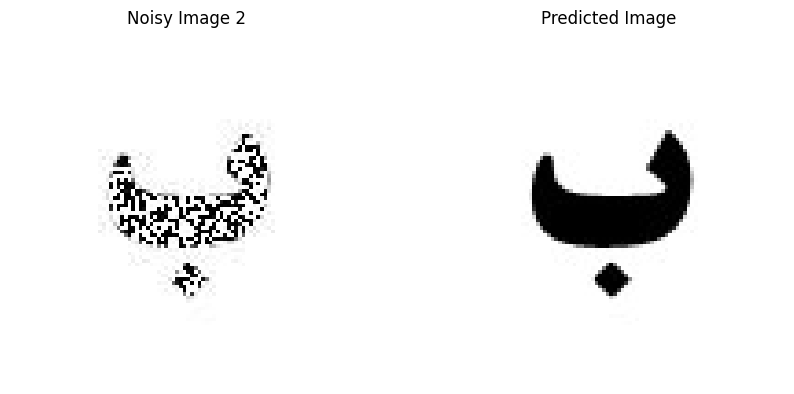

Given Image: noisy2.jpg, Predicted Image Index: 2


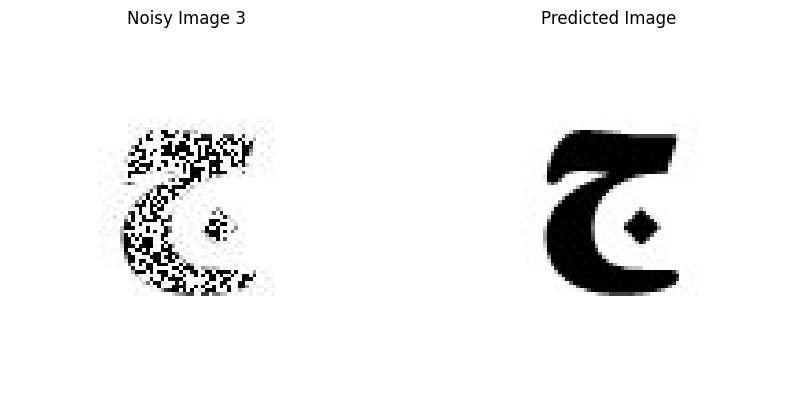

Given Image: noisy3.jpg, Predicted Image Index: 3


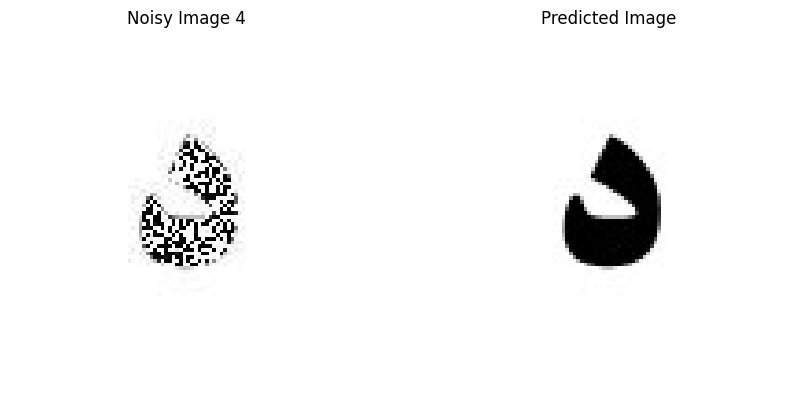

Given Image: noisy4.jpg, Predicted Image Index: 4


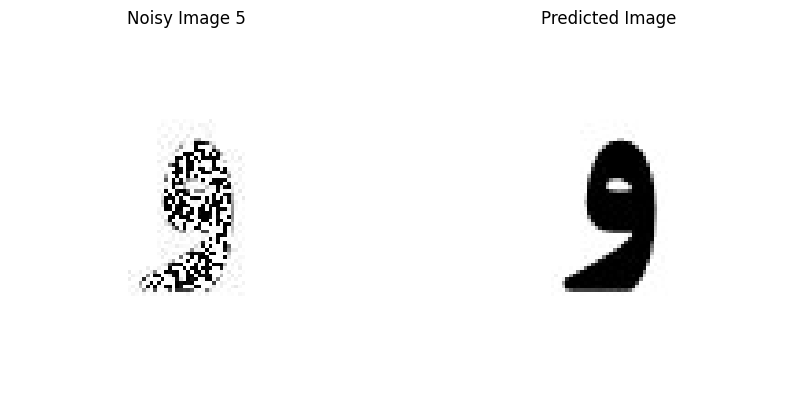

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 306 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 424 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 506 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 301 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 324 missing points and saved as noisy5.jpg


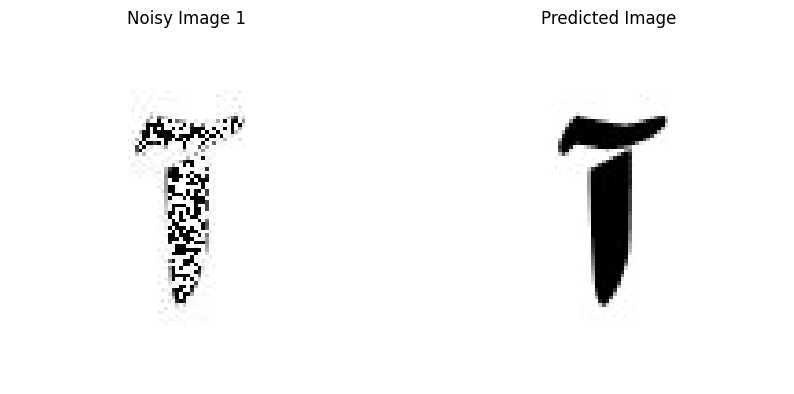

Given Image: noisy1.jpg, Predicted Image Index: 1


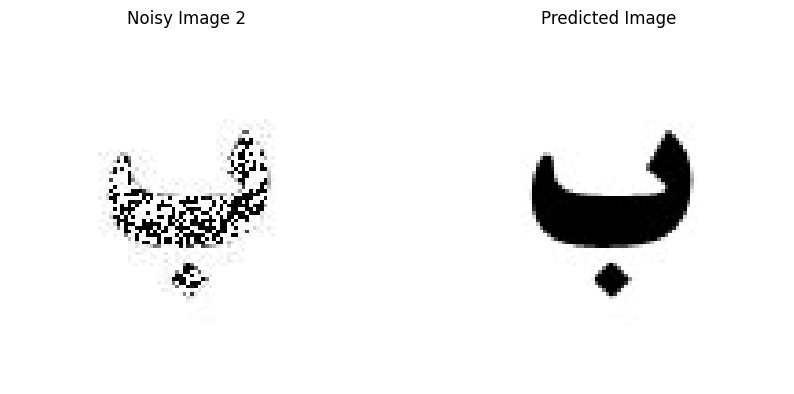

Given Image: noisy2.jpg, Predicted Image Index: 2


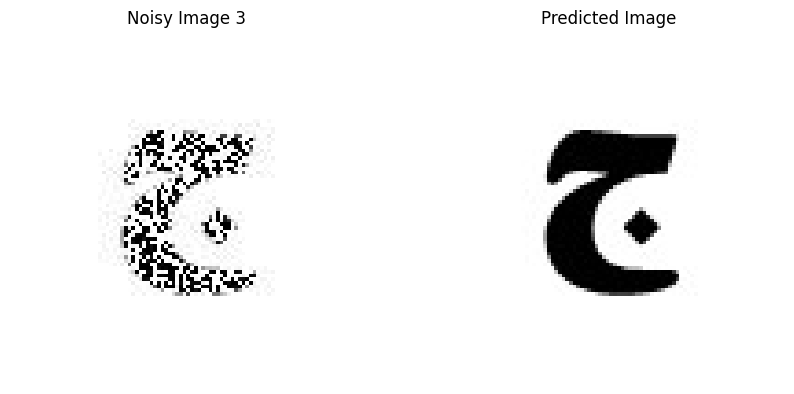

Given Image: noisy3.jpg, Predicted Image Index: 3


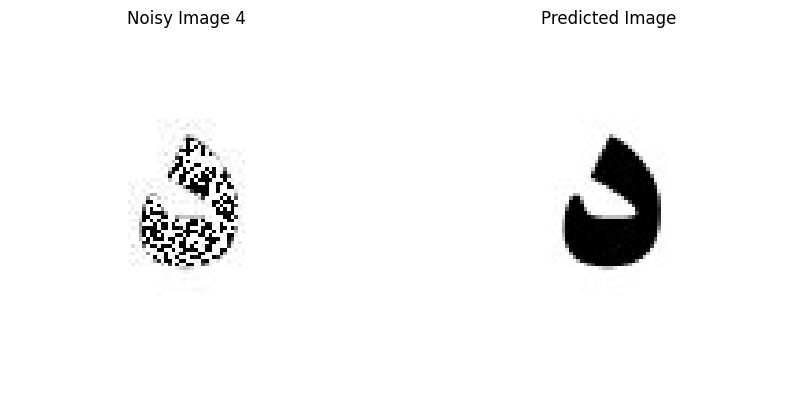

Given Image: noisy4.jpg, Predicted Image Index: 4


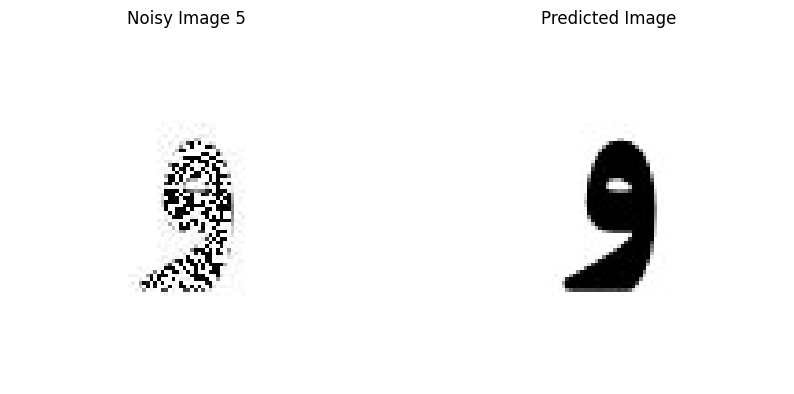

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 312 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 432 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 515 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 307 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 330 missing points and saved as noisy5.jpg


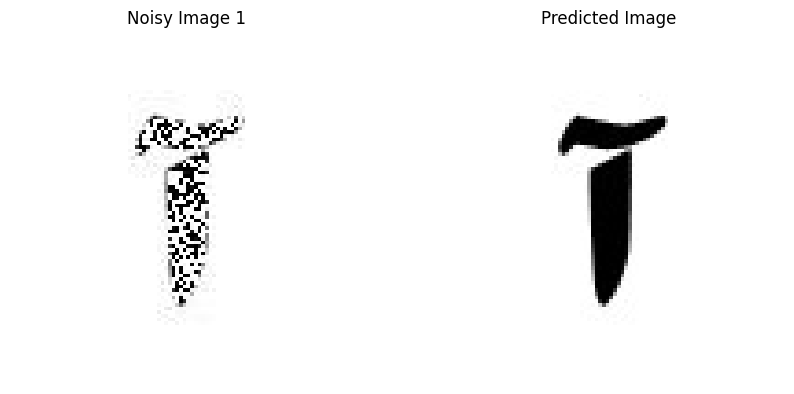

Given Image: noisy1.jpg, Predicted Image Index: 1


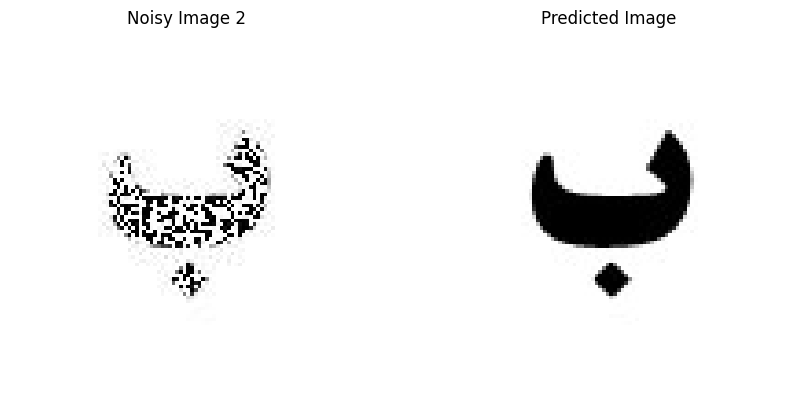

Given Image: noisy2.jpg, Predicted Image Index: 2


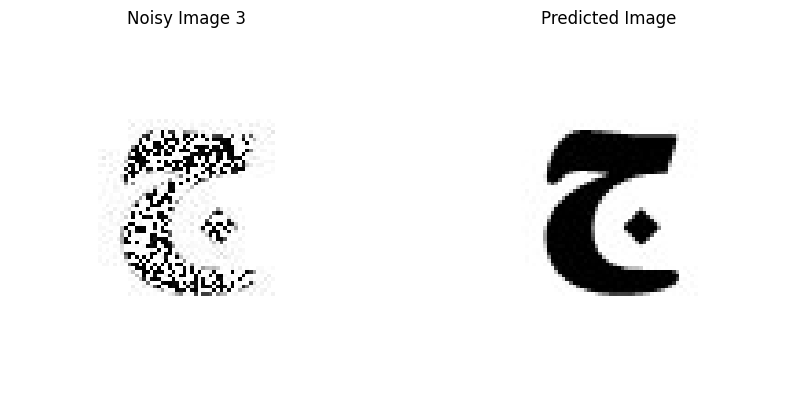

Given Image: noisy3.jpg, Predicted Image Index: 3


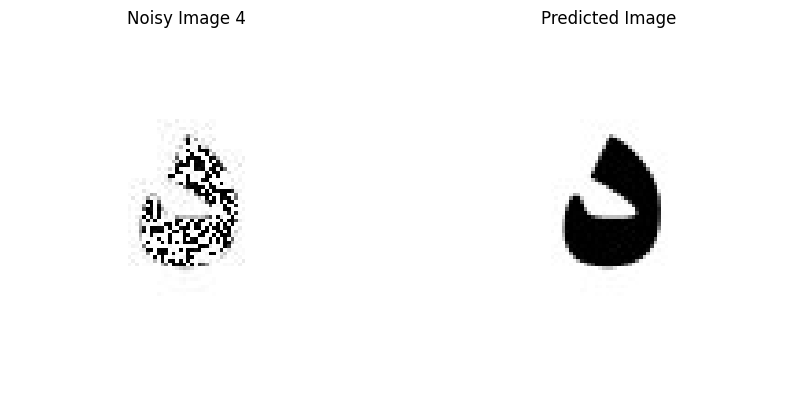

Given Image: noisy4.jpg, Predicted Image Index: 4


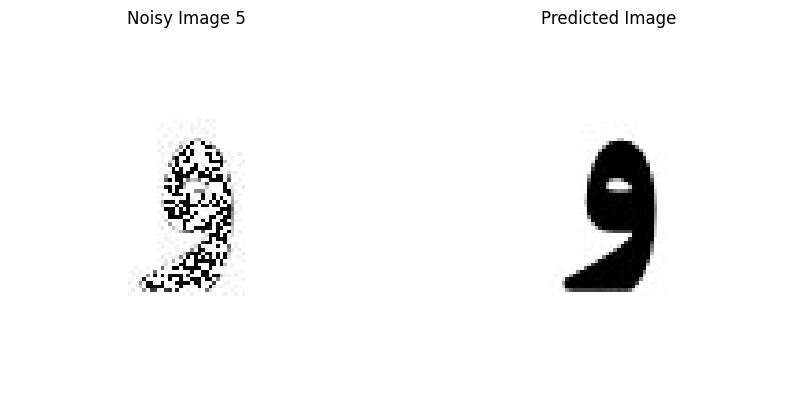

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 318 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 440 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 524 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 312 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 336 missing points and saved as noisy5.jpg


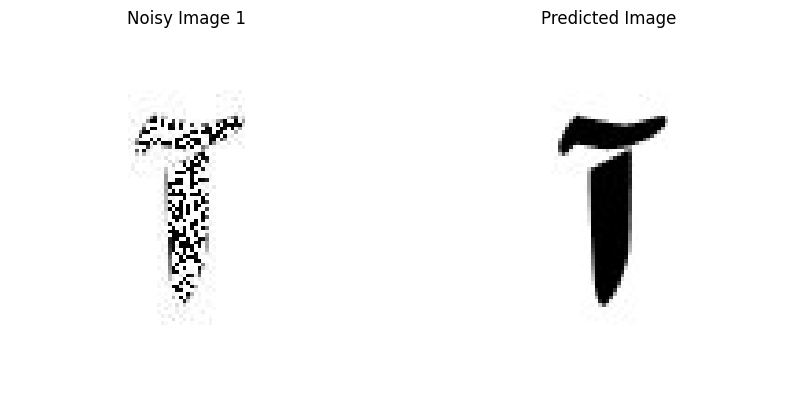

Given Image: noisy1.jpg, Predicted Image Index: 1


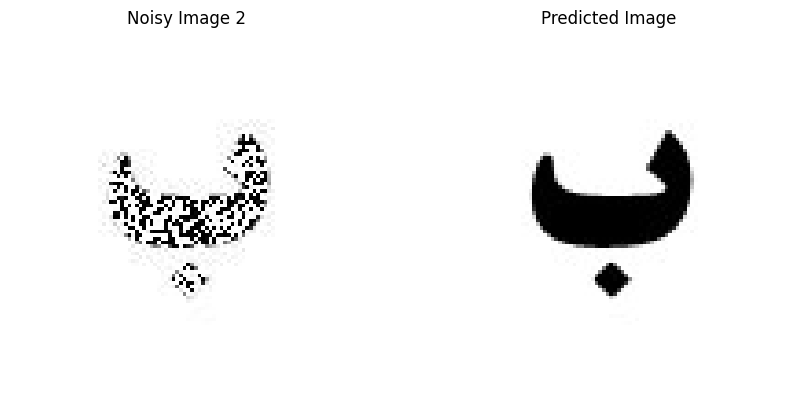

Given Image: noisy2.jpg, Predicted Image Index: 2


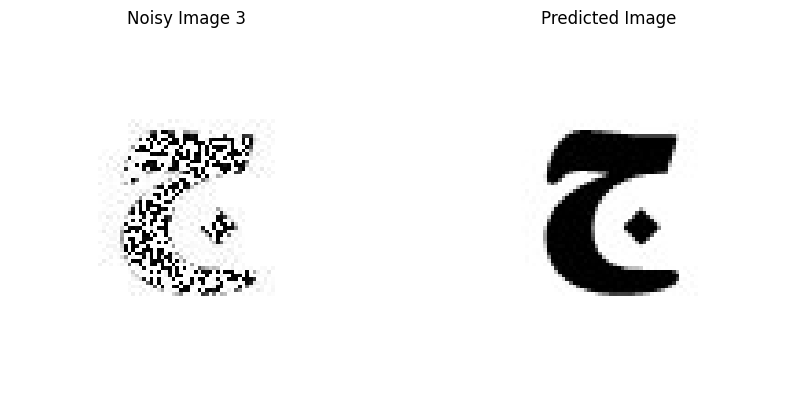

Given Image: noisy3.jpg, Predicted Image Index: 3


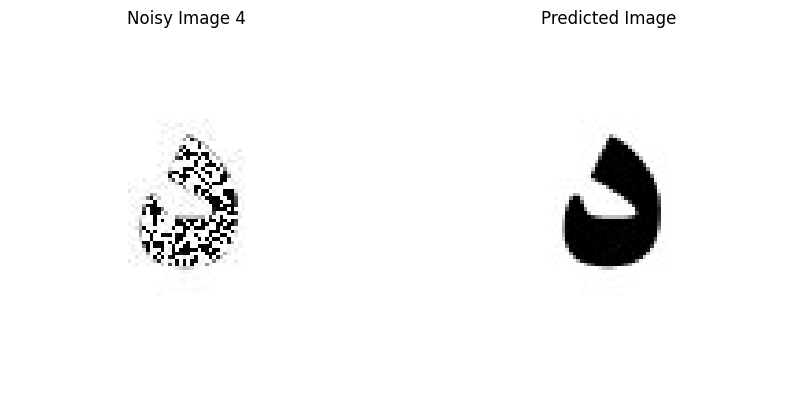

Given Image: noisy4.jpg, Predicted Image Index: 4


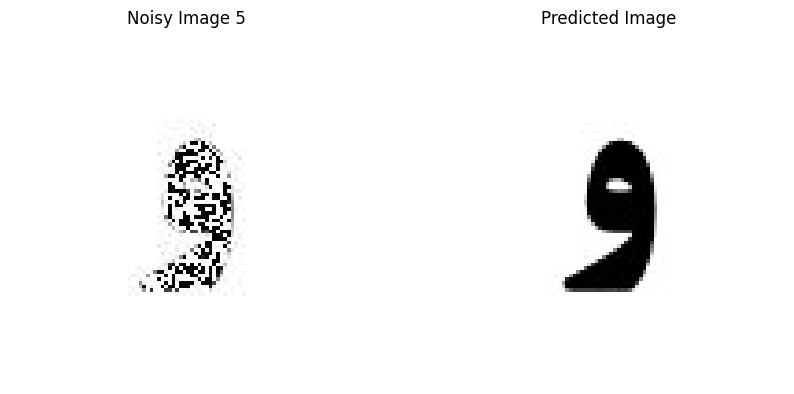

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 323 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 447 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 534 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 318 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 342 missing points and saved as noisy5.jpg


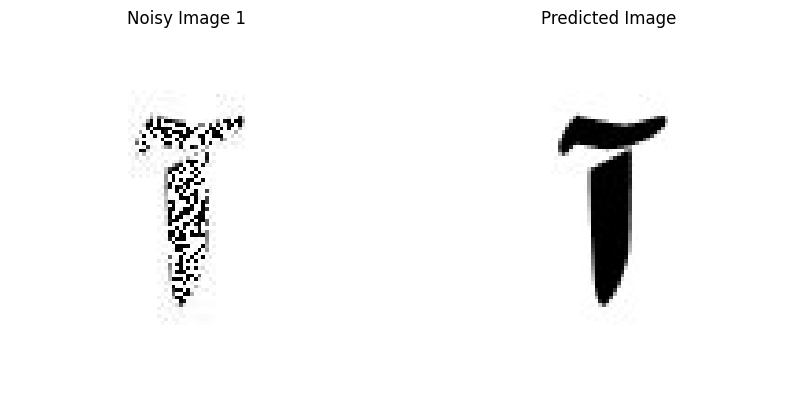

Given Image: noisy1.jpg, Predicted Image Index: 1


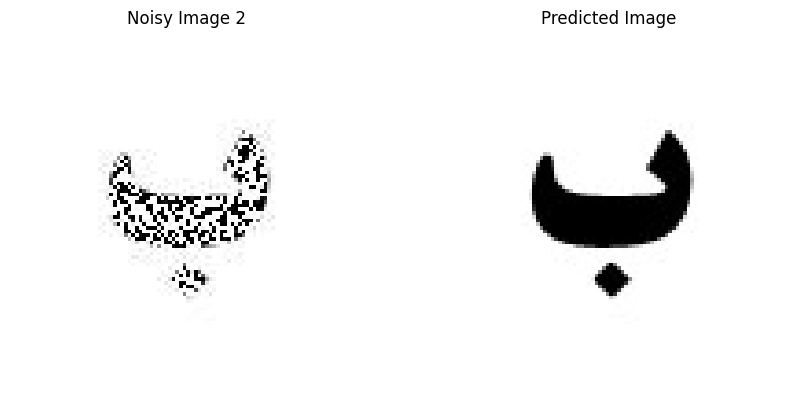

Given Image: noisy2.jpg, Predicted Image Index: 2


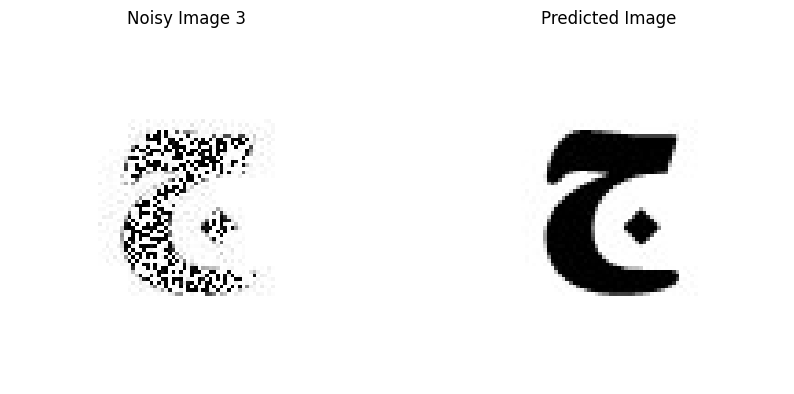

Given Image: noisy3.jpg, Predicted Image Index: 3


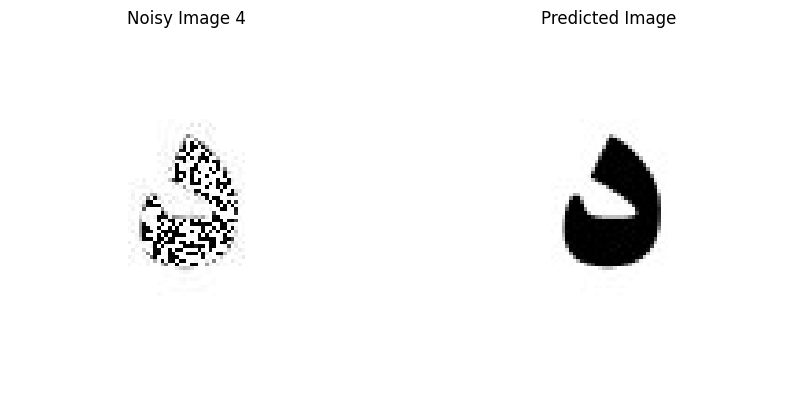

Given Image: noisy4.jpg, Predicted Image Index: 4


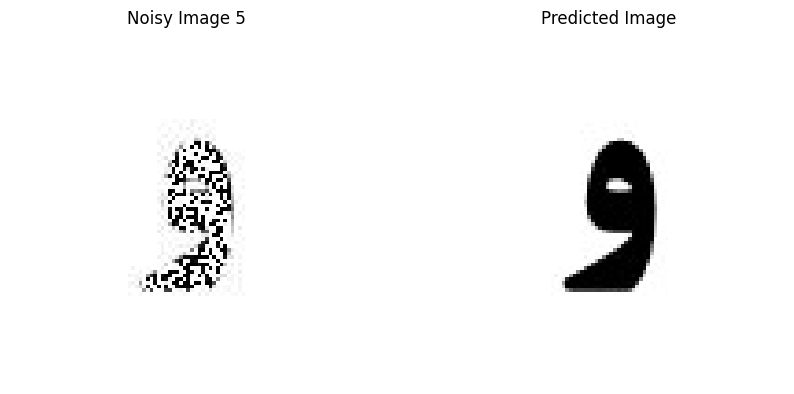

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 329 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 455 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 543 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 323 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 348 missing points and saved as noisy5.jpg


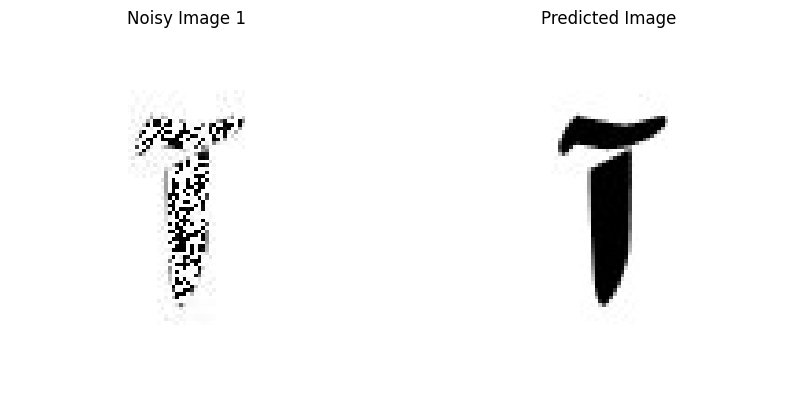

Given Image: noisy1.jpg, Predicted Image Index: 1


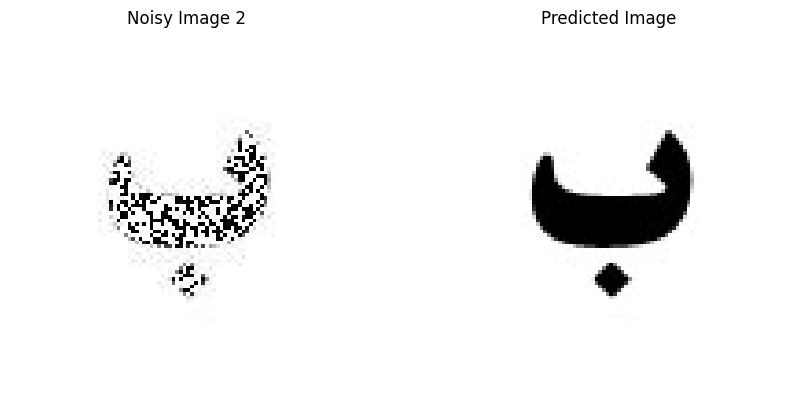

Given Image: noisy2.jpg, Predicted Image Index: 2


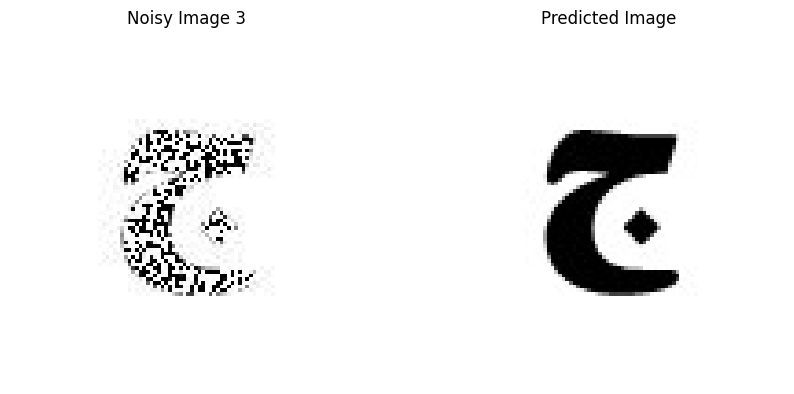

Given Image: noisy3.jpg, Predicted Image Index: 3


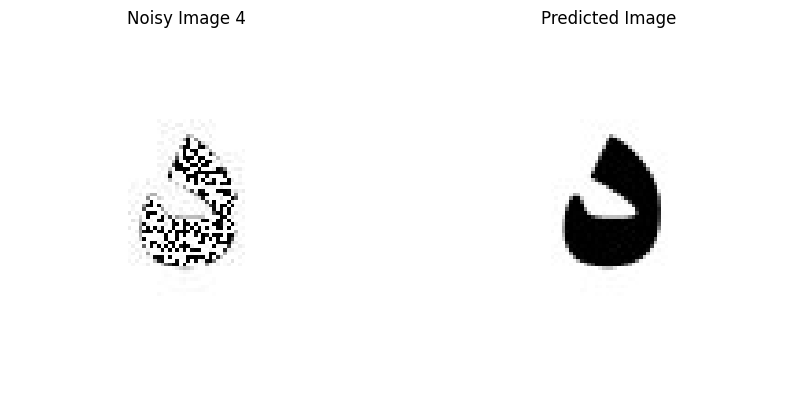

Given Image: noisy4.jpg, Predicted Image Index: 4


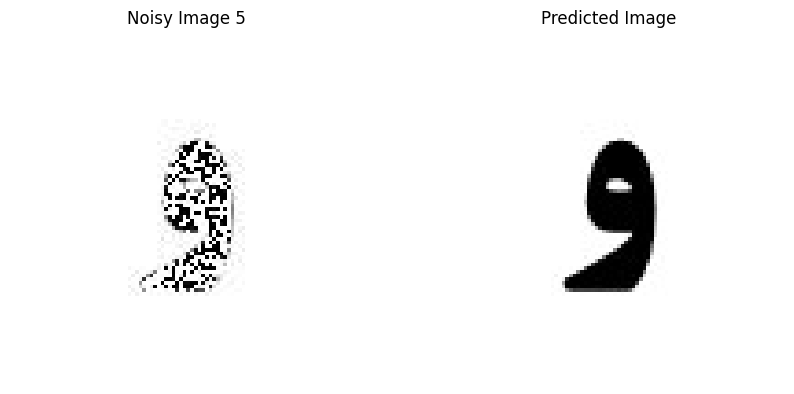

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 334 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 463 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 552 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 329 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 354 missing points and saved as noisy5.jpg


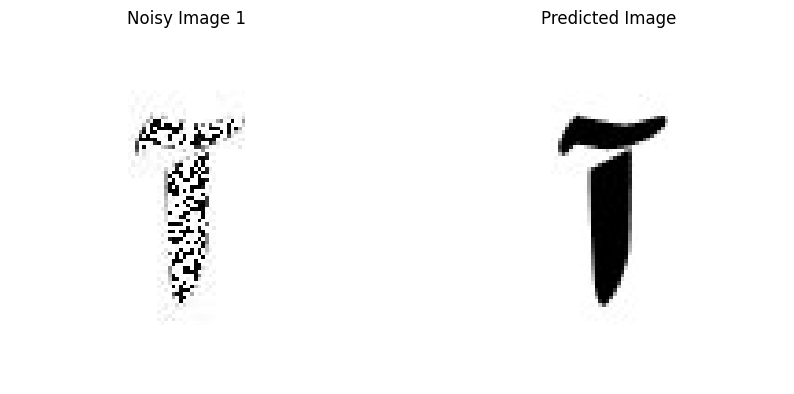

Given Image: noisy1.jpg, Predicted Image Index: 1


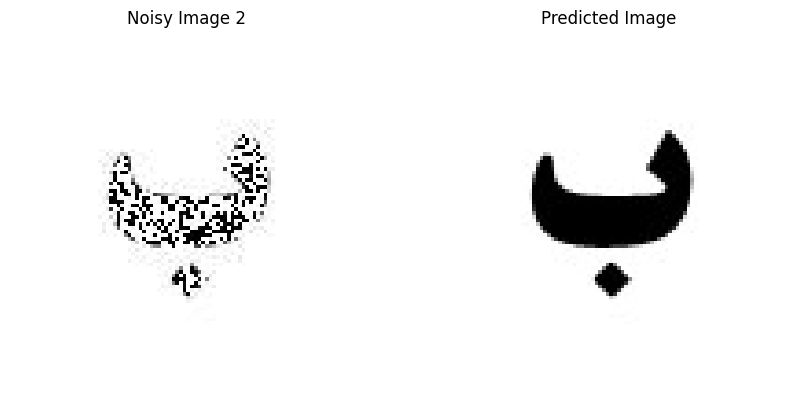

Given Image: noisy2.jpg, Predicted Image Index: 2


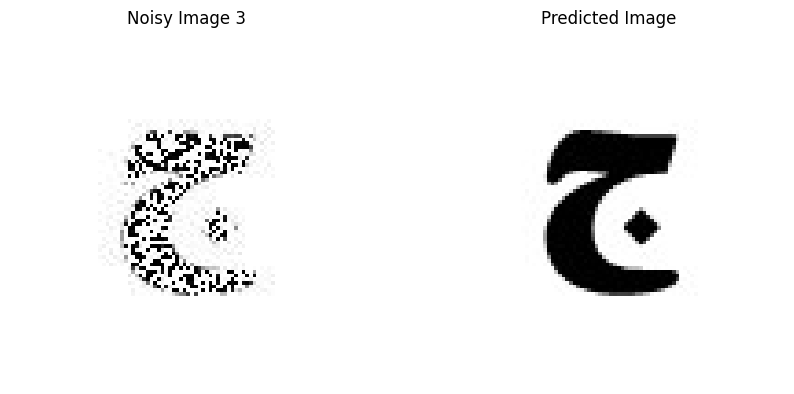

Given Image: noisy3.jpg, Predicted Image Index: 3


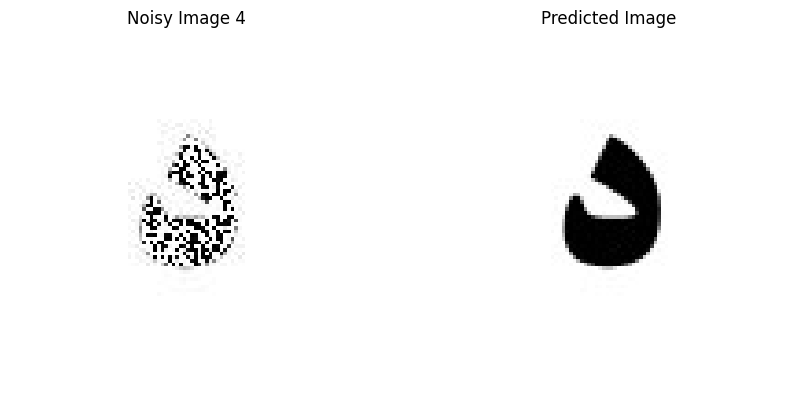

Given Image: noisy4.jpg, Predicted Image Index: 4


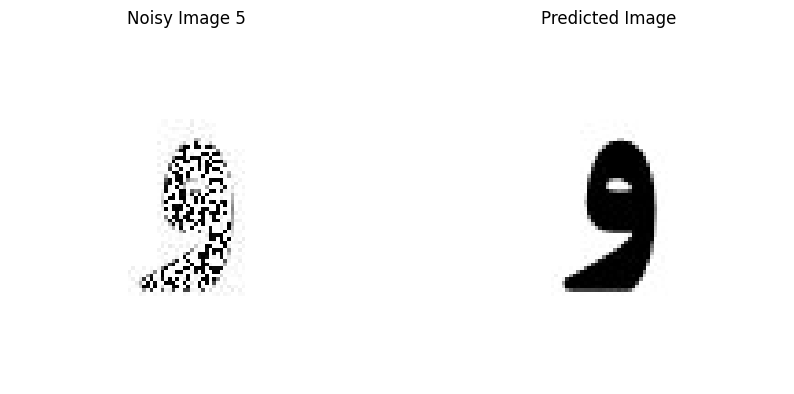

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 340 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 470 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 561 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 334 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 359 missing points and saved as noisy5.jpg


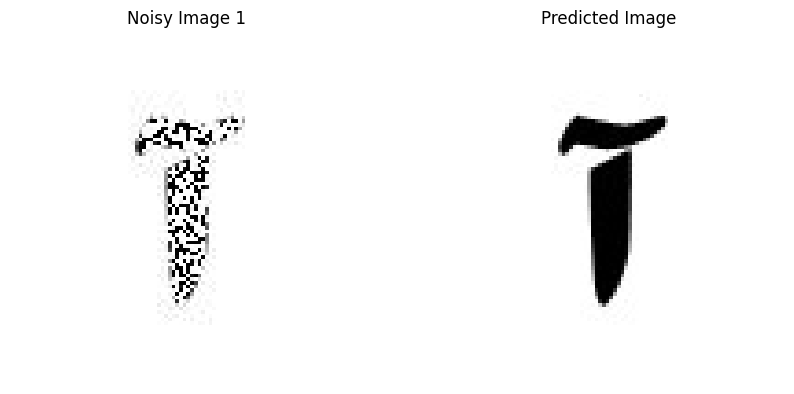

Given Image: noisy1.jpg, Predicted Image Index: 1


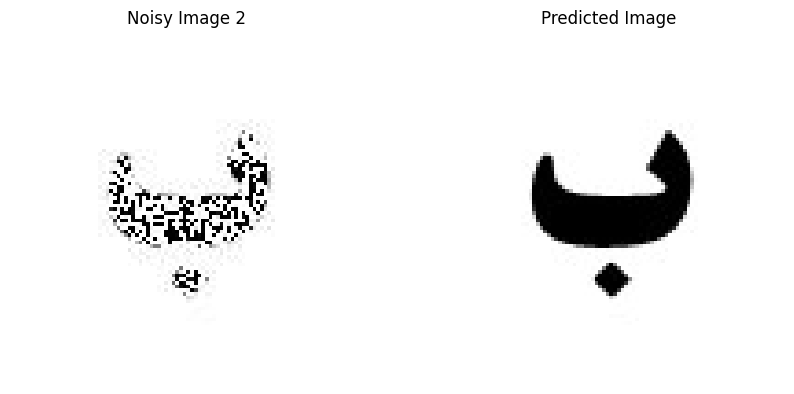

Given Image: noisy2.jpg, Predicted Image Index: 2


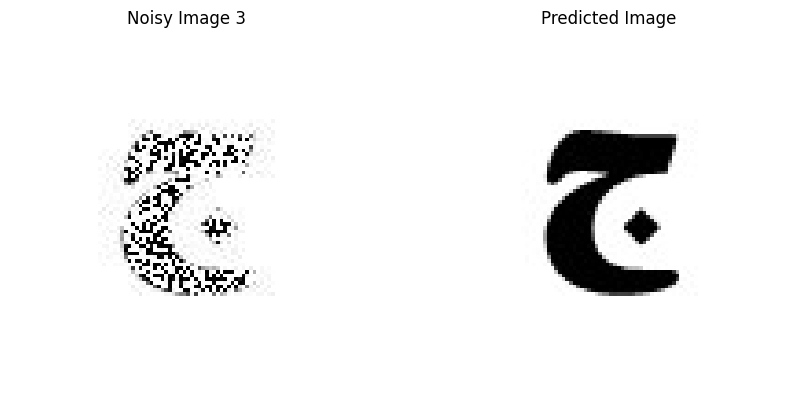

Given Image: noisy3.jpg, Predicted Image Index: 3


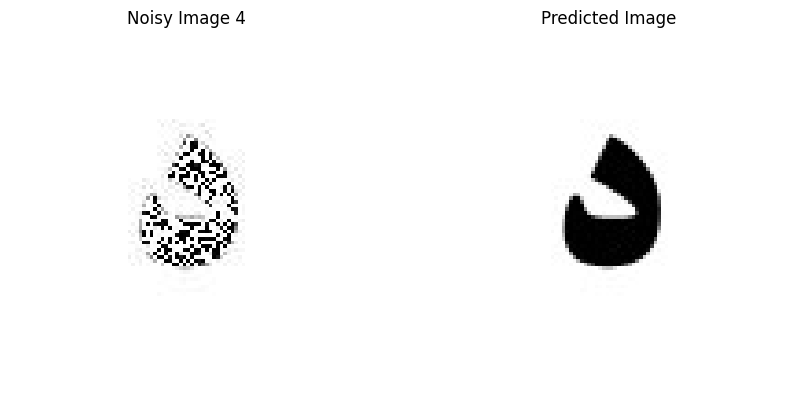

Given Image: noisy4.jpg, Predicted Image Index: 4


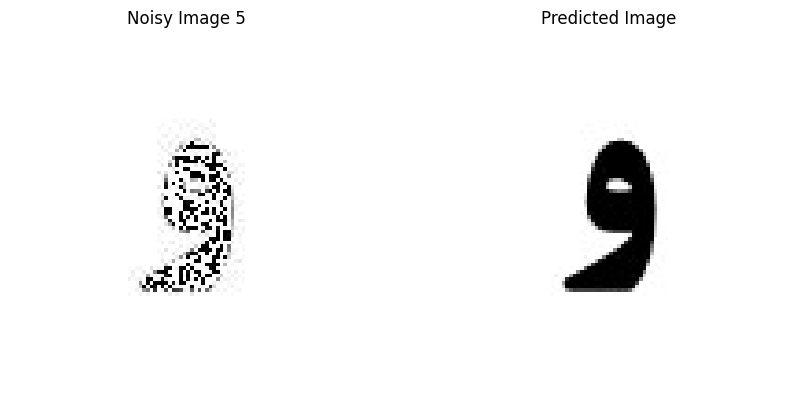

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 345 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 478 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 571 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 340 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 365 missing points and saved as noisy5.jpg


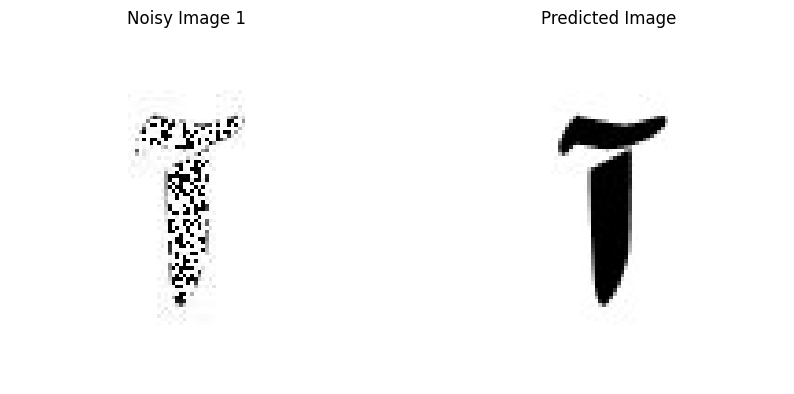

Given Image: noisy1.jpg, Predicted Image Index: 1


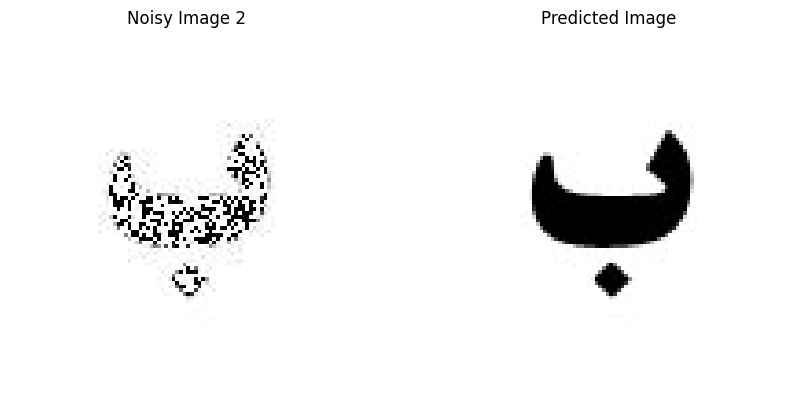

Given Image: noisy2.jpg, Predicted Image Index: 2


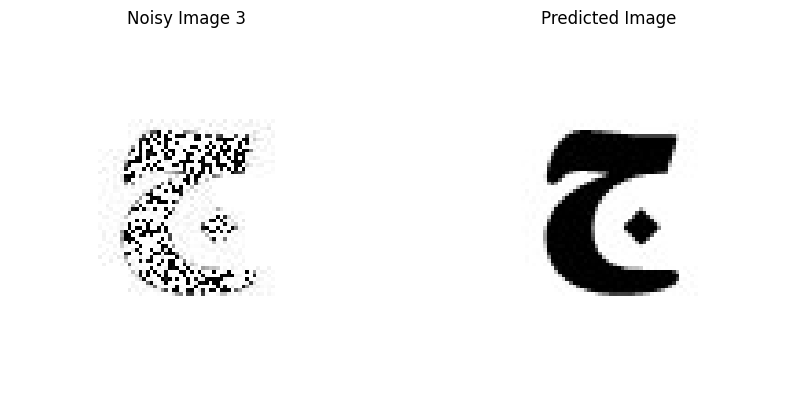

Given Image: noisy3.jpg, Predicted Image Index: 3


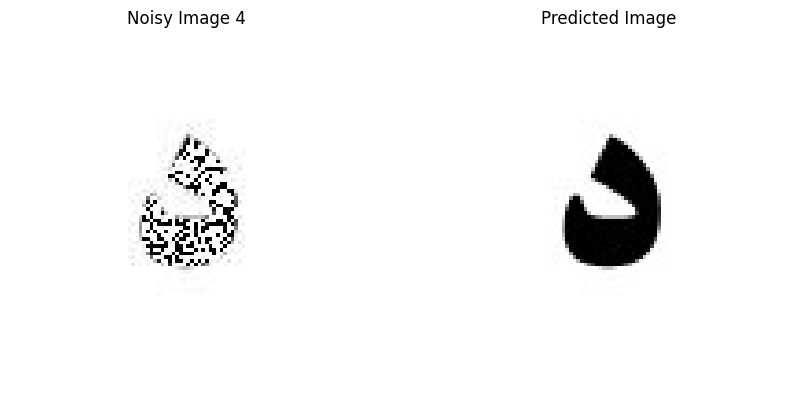

Given Image: noisy4.jpg, Predicted Image Index: 4


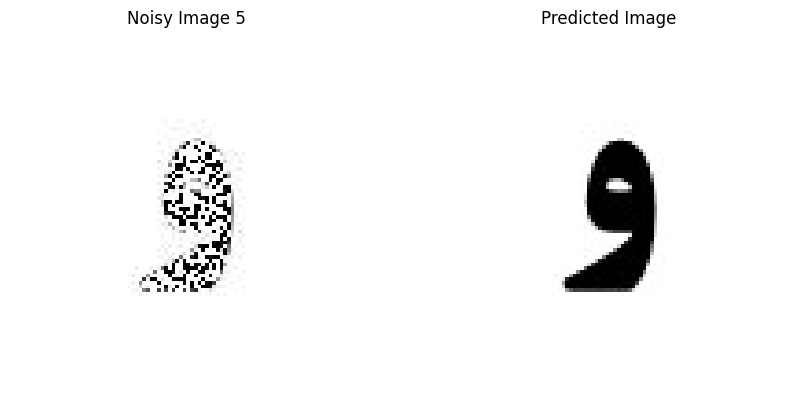

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 351 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 486 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 580 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 345 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 371 missing points and saved as noisy5.jpg


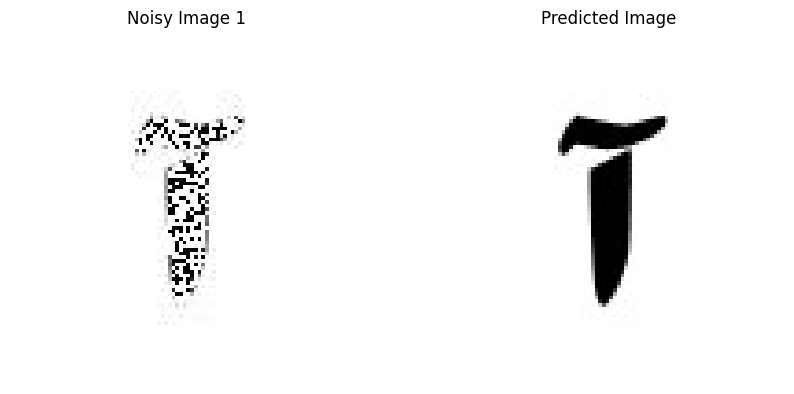

Given Image: noisy1.jpg, Predicted Image Index: 1


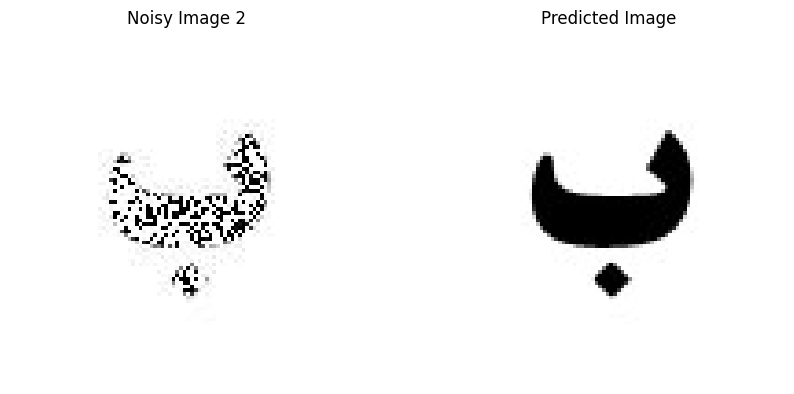

Given Image: noisy2.jpg, Predicted Image Index: 2


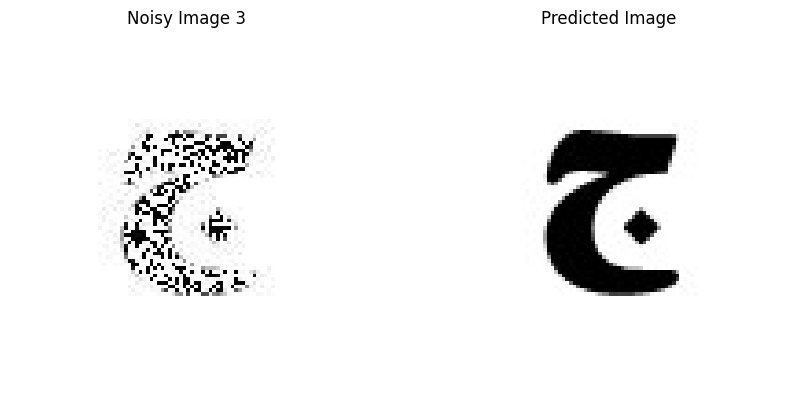

Given Image: noisy3.jpg, Predicted Image Index: 3


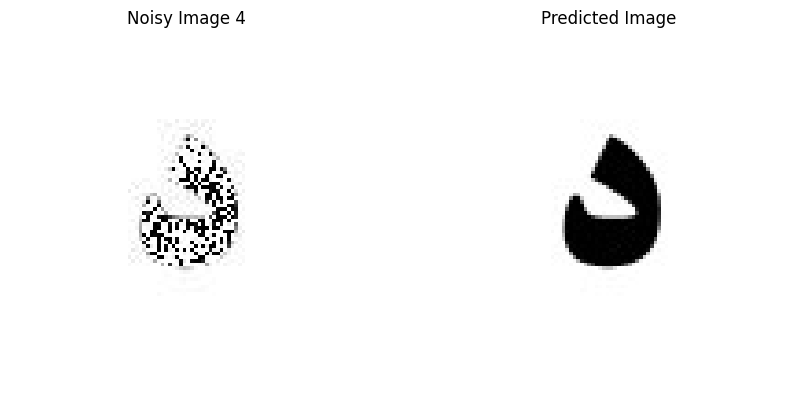

Given Image: noisy4.jpg, Predicted Image Index: 4


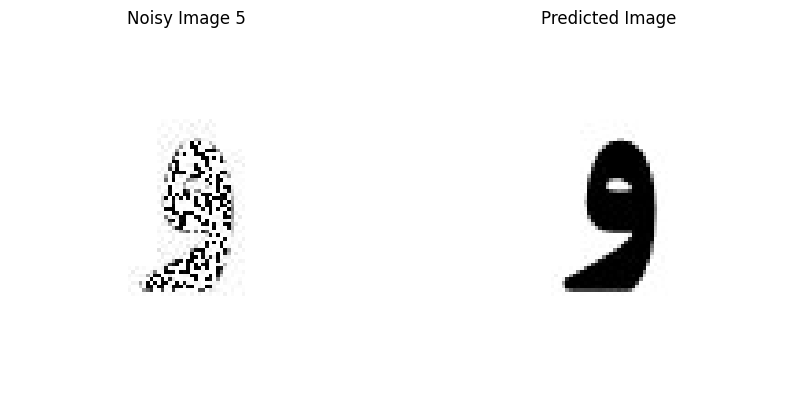

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 357 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 494 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 589 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 351 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 377 missing points and saved as noisy5.jpg


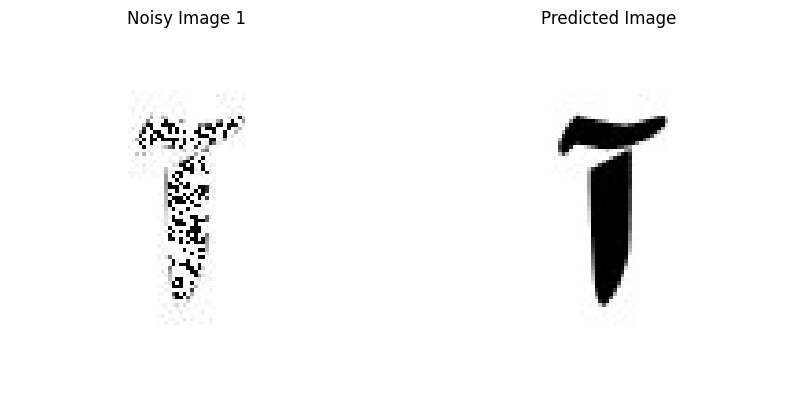

Given Image: noisy1.jpg, Predicted Image Index: 1


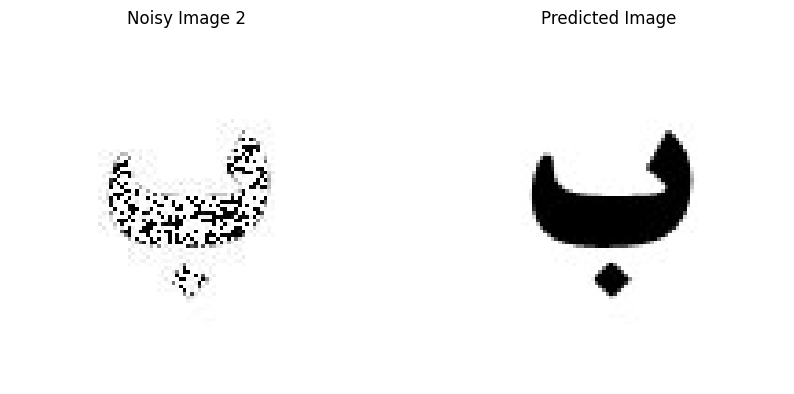

Given Image: noisy2.jpg, Predicted Image Index: 2


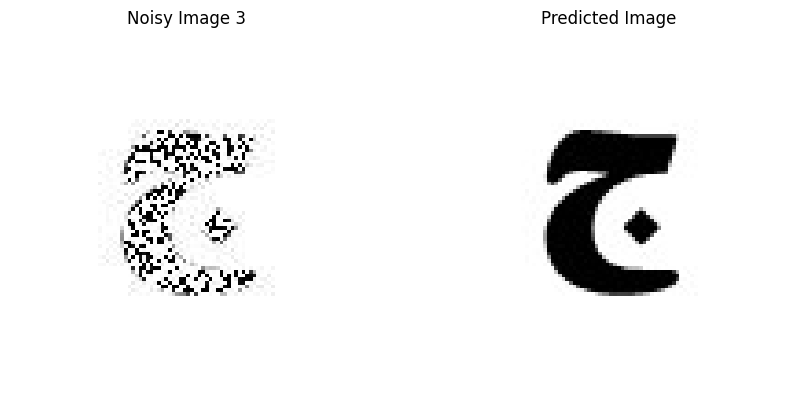

Given Image: noisy3.jpg, Predicted Image Index: 3


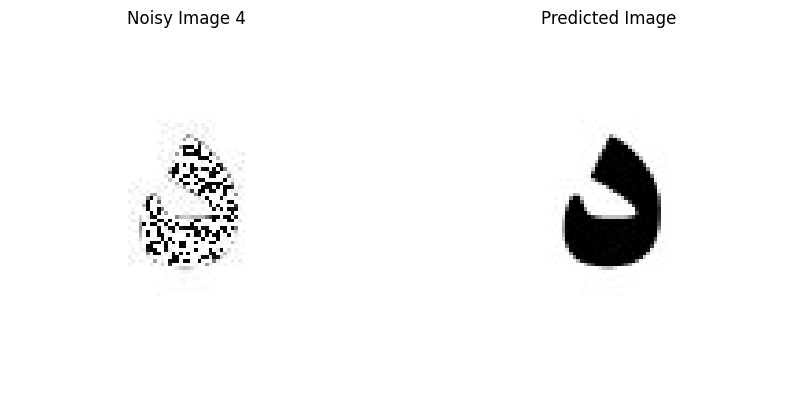

Given Image: noisy4.jpg, Predicted Image Index: 4


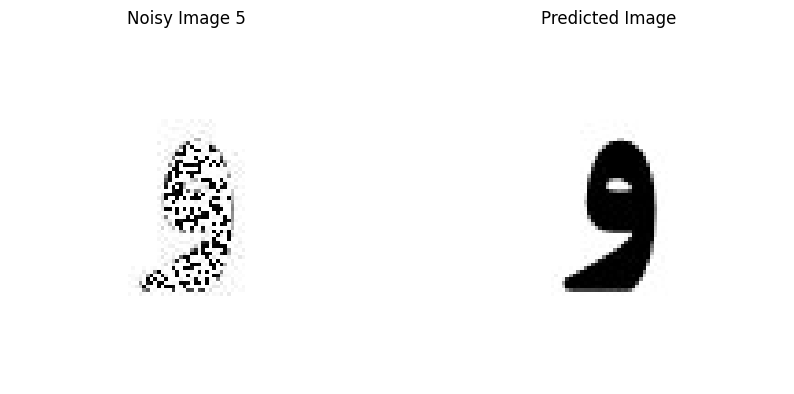

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 362 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 501 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 598 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 356 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 383 missing points and saved as noisy5.jpg


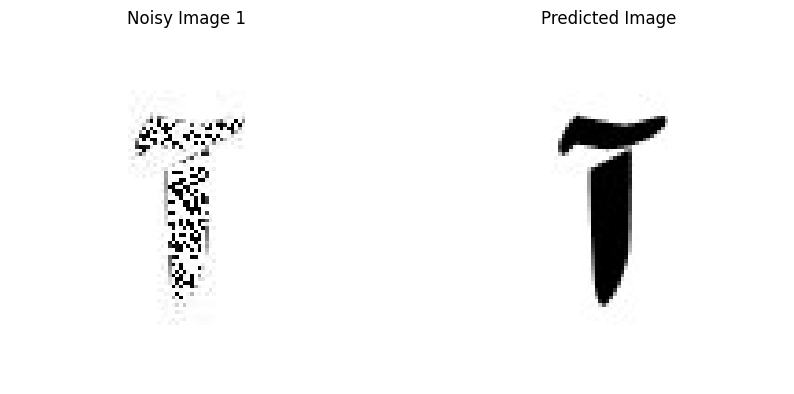

Given Image: noisy1.jpg, Predicted Image Index: 1


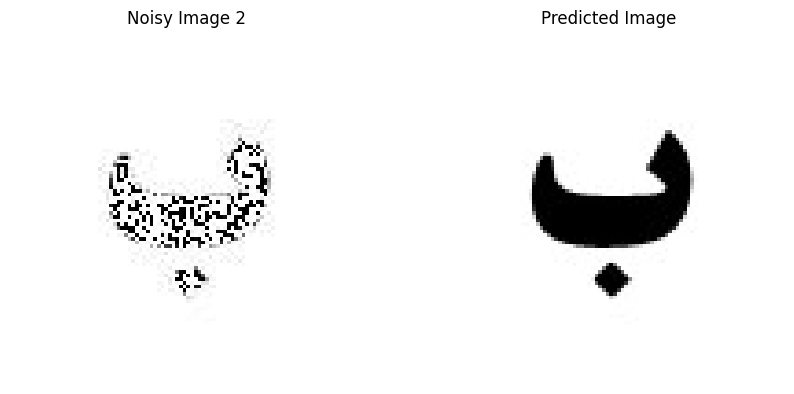

Given Image: noisy2.jpg, Predicted Image Index: 2


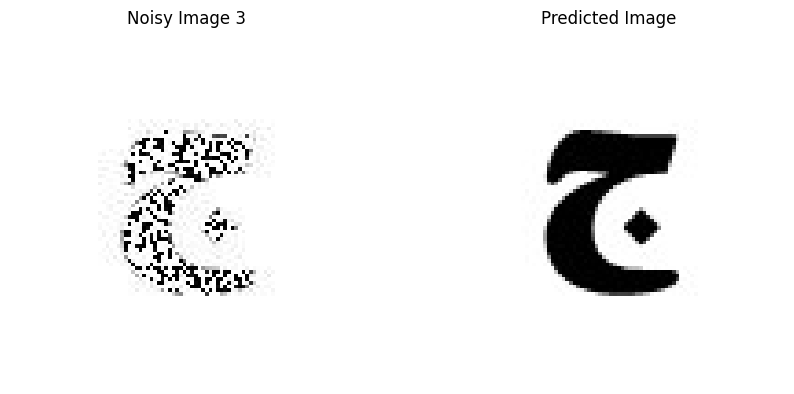

Given Image: noisy3.jpg, Predicted Image Index: 3


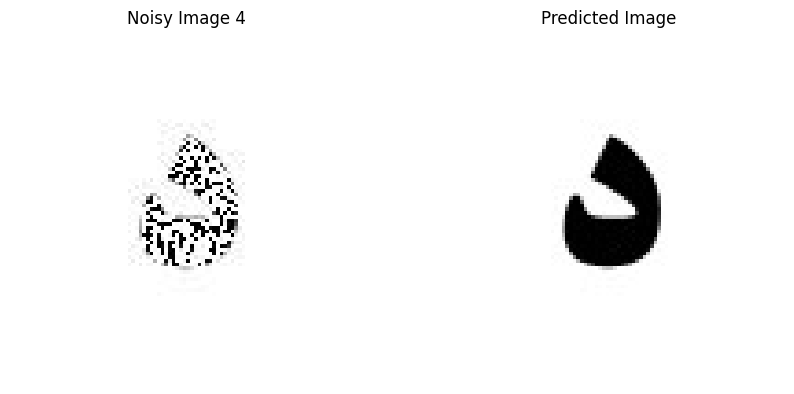

Given Image: noisy4.jpg, Predicted Image Index: 4


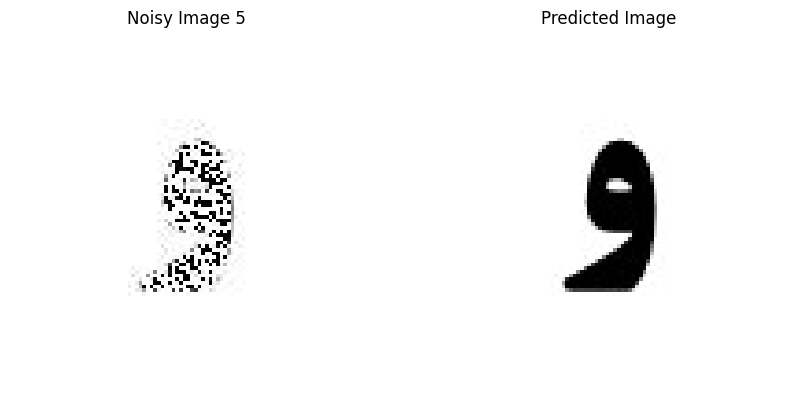

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 368 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 509 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 607 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 362 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 389 missing points and saved as noisy5.jpg


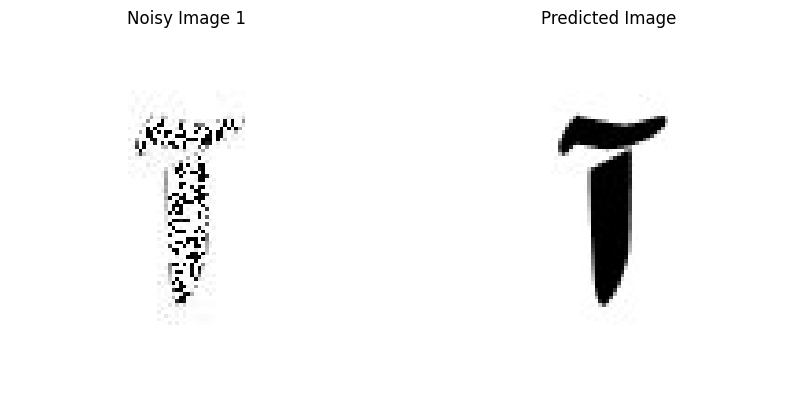

Given Image: noisy1.jpg, Predicted Image Index: 1


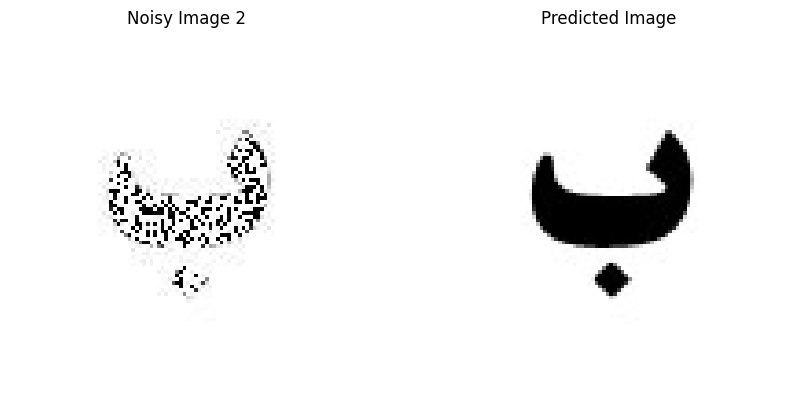

Given Image: noisy2.jpg, Predicted Image Index: 2


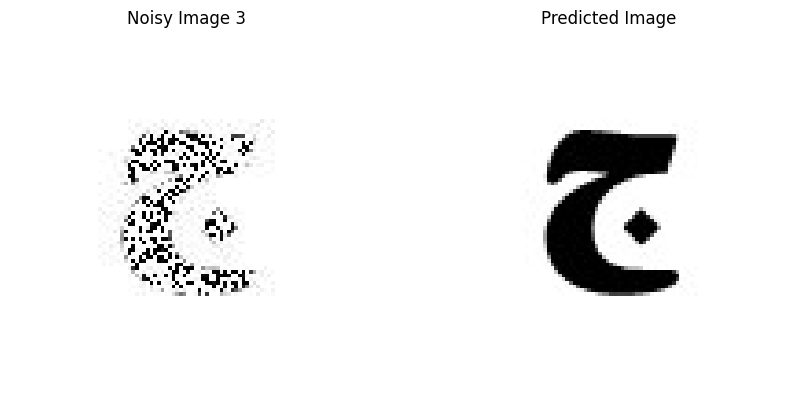

Given Image: noisy3.jpg, Predicted Image Index: 3


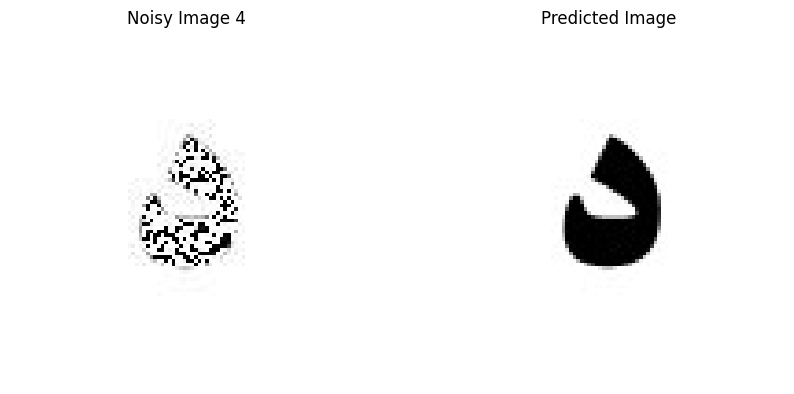

Given Image: noisy4.jpg, Predicted Image Index: 4


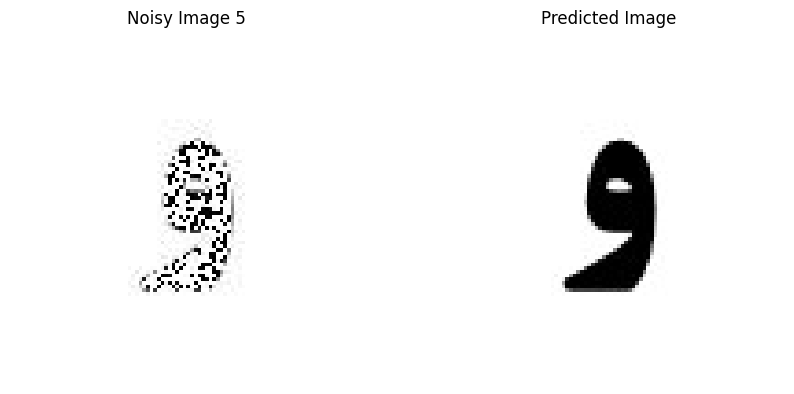

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 373 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 517 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 617 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 367 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 395 missing points and saved as noisy5.jpg


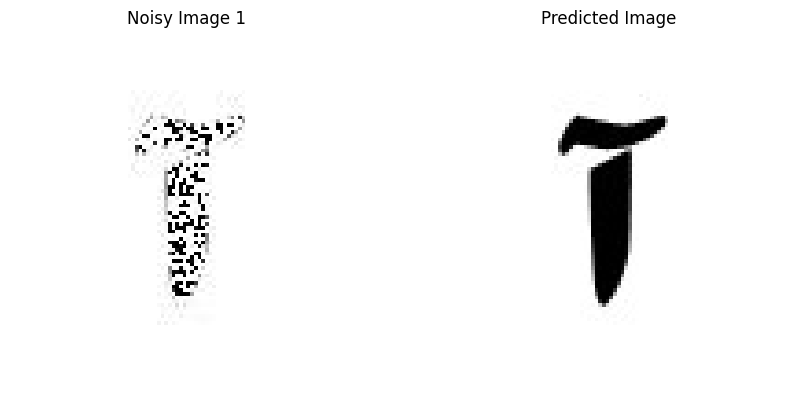

Given Image: noisy1.jpg, Predicted Image Index: 1


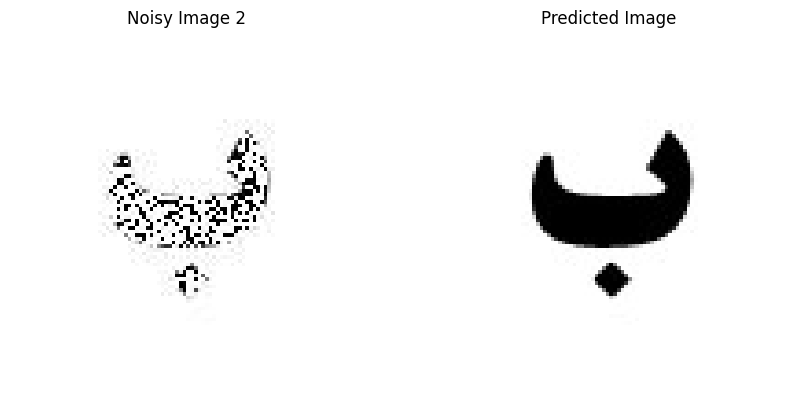

Given Image: noisy2.jpg, Predicted Image Index: 2


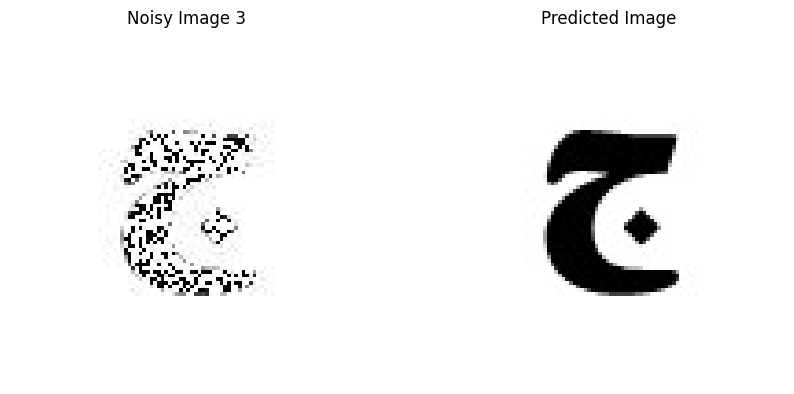

Given Image: noisy3.jpg, Predicted Image Index: 3


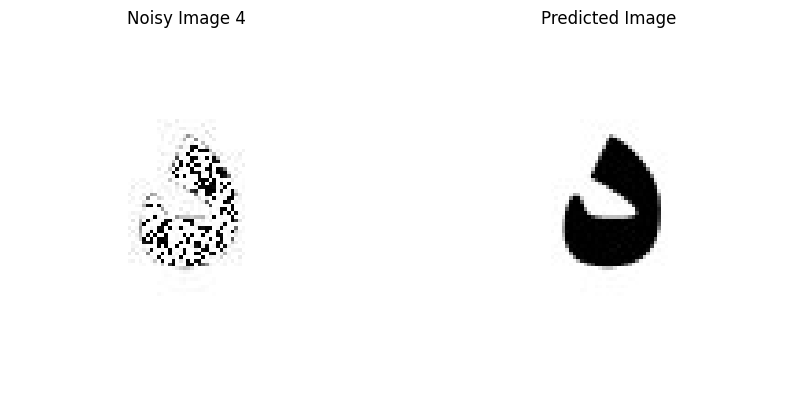

Given Image: noisy4.jpg, Predicted Image Index: 4


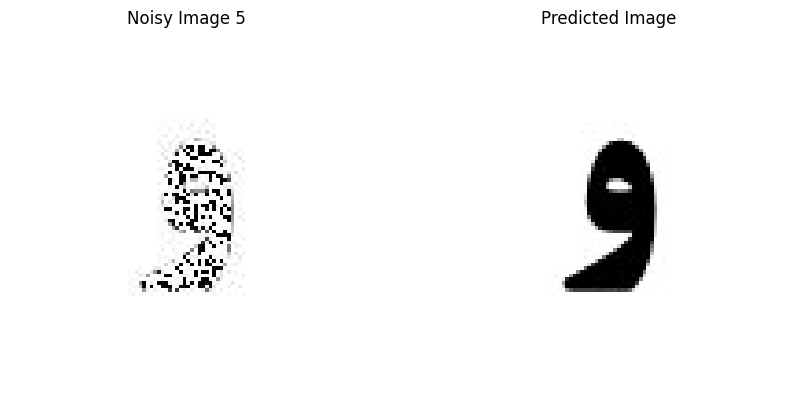

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 379 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 524 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 626 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 373 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 401 missing points and saved as noisy5.jpg


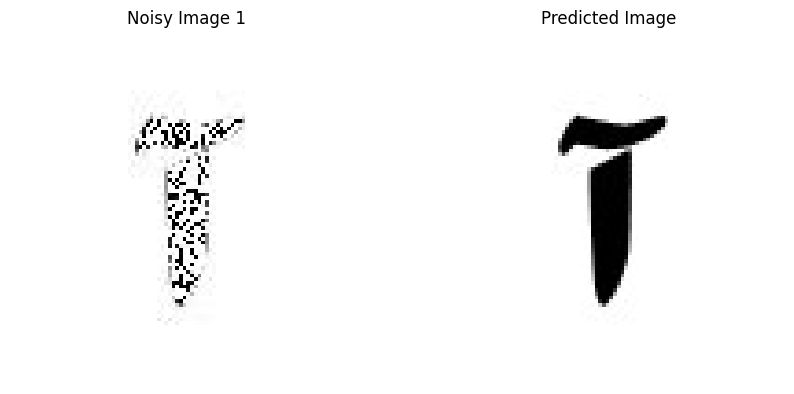

Given Image: noisy1.jpg, Predicted Image Index: 1


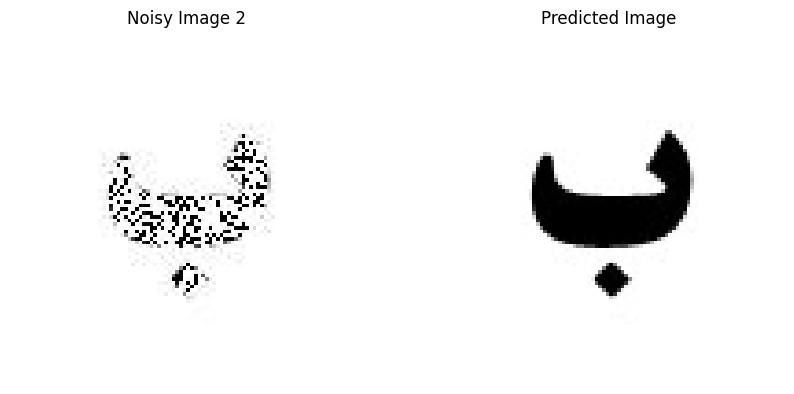

Given Image: noisy2.jpg, Predicted Image Index: 2


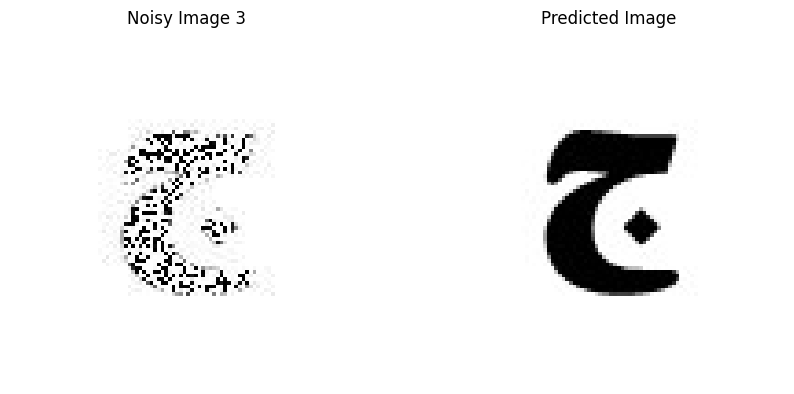

Given Image: noisy3.jpg, Predicted Image Index: 3


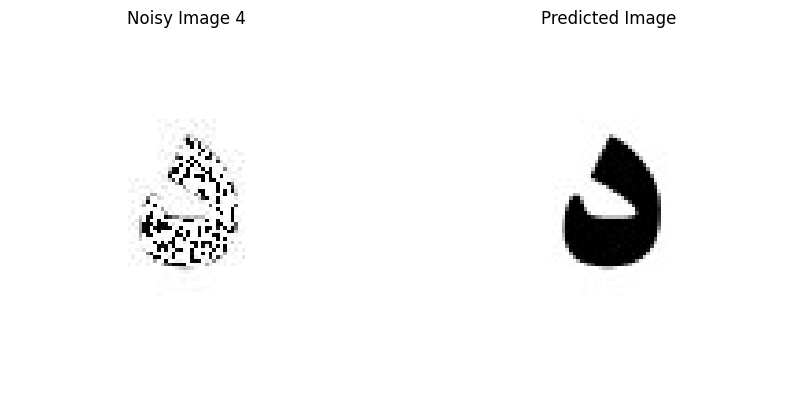

Given Image: noisy4.jpg, Predicted Image Index: 4


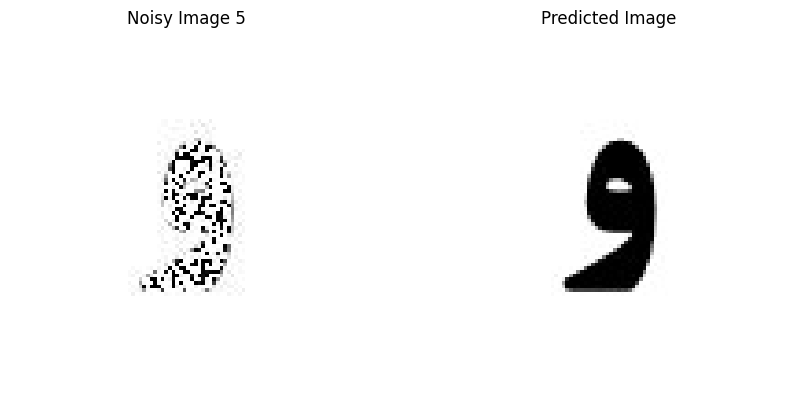

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 385 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 532 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 635 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 378 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 407 missing points and saved as noisy5.jpg


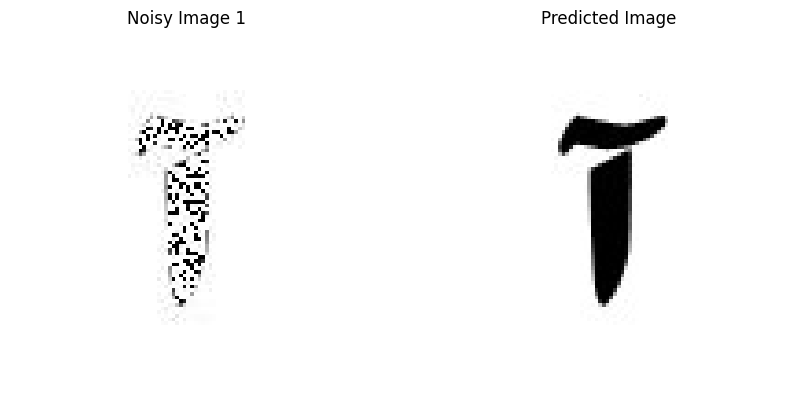

Given Image: noisy1.jpg, Predicted Image Index: 1


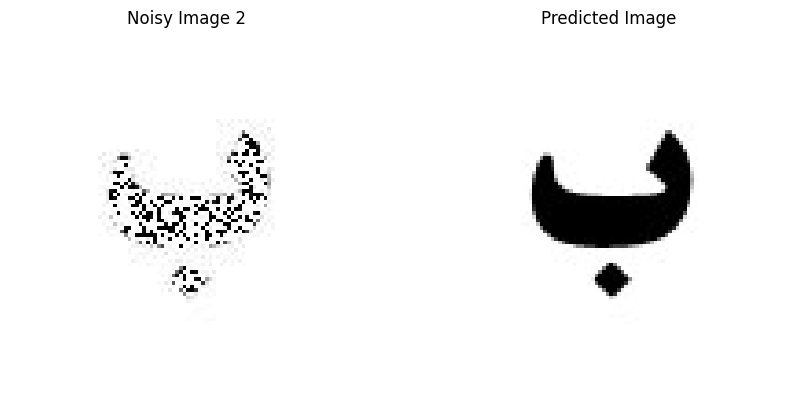

Given Image: noisy2.jpg, Predicted Image Index: 2


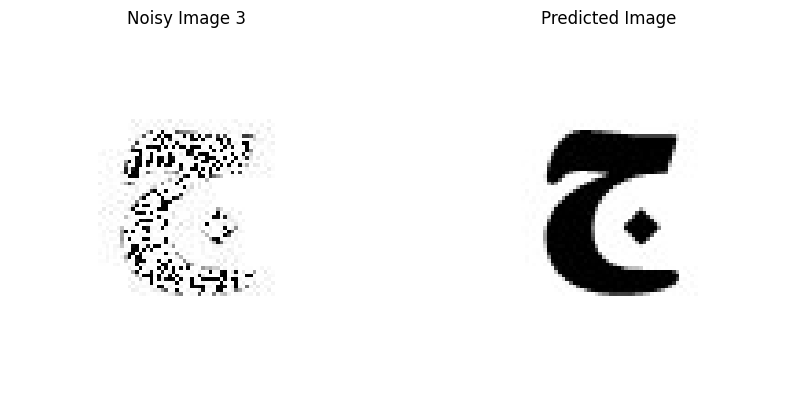

Given Image: noisy3.jpg, Predicted Image Index: 3


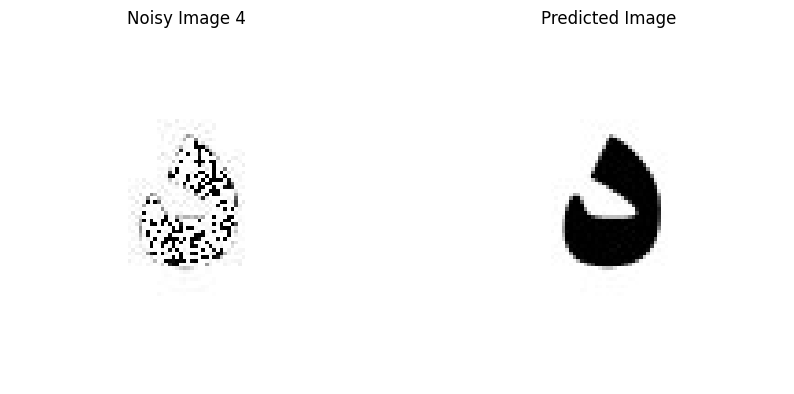

Given Image: noisy4.jpg, Predicted Image Index: 4


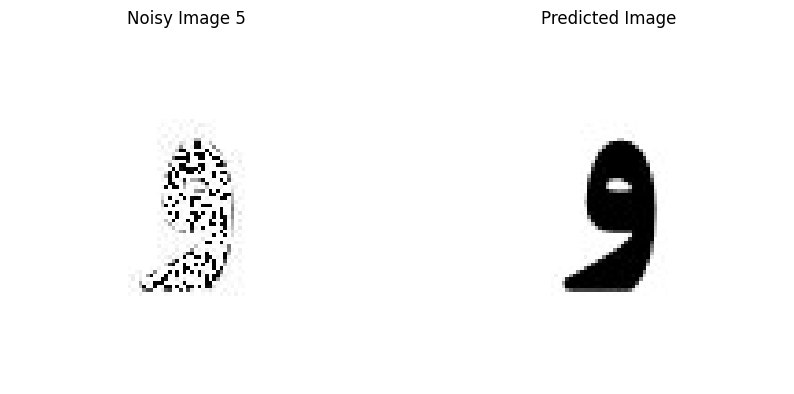

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 390 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 540 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 644 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 384 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 413 missing points and saved as noisy5.jpg


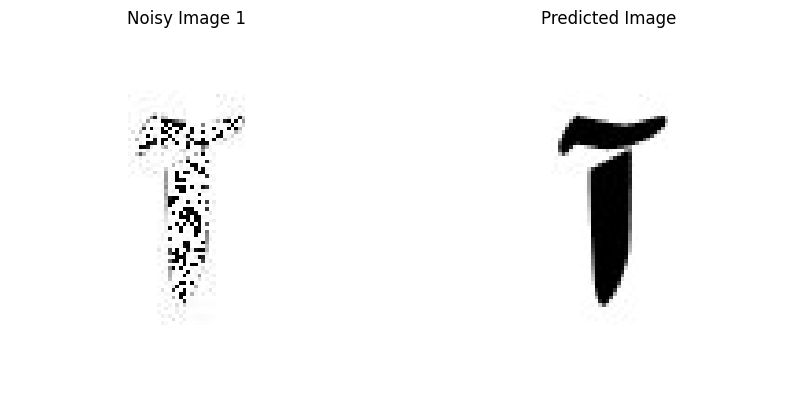

Given Image: noisy1.jpg, Predicted Image Index: 1


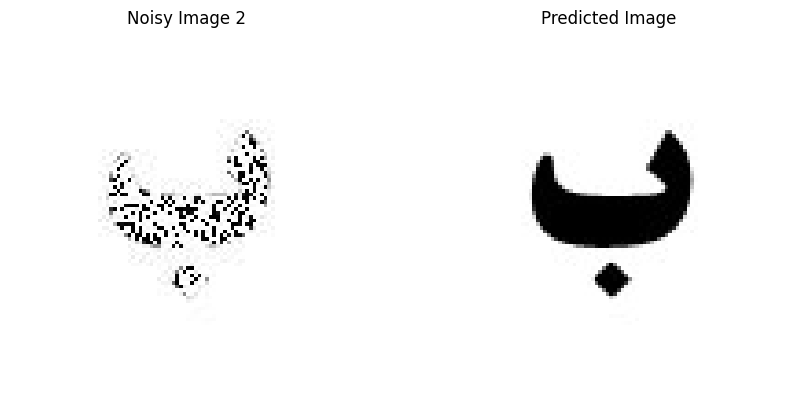

Given Image: noisy2.jpg, Predicted Image Index: 2


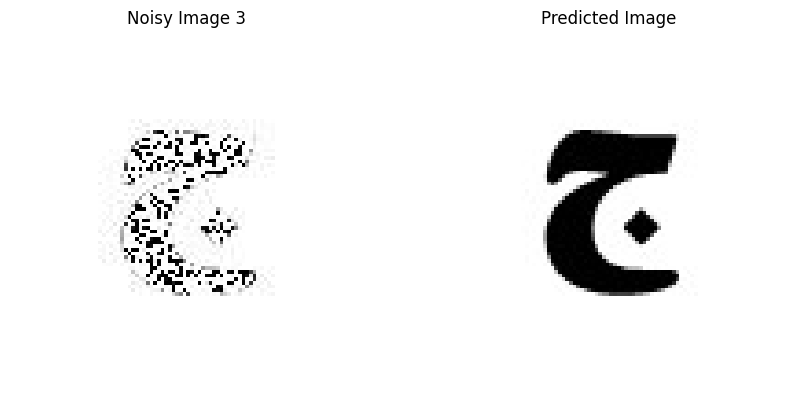

Given Image: noisy3.jpg, Predicted Image Index: 3


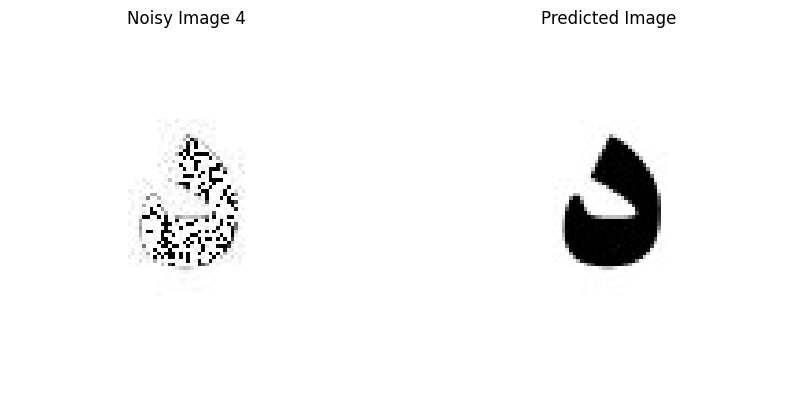

Given Image: noisy4.jpg, Predicted Image Index: 4


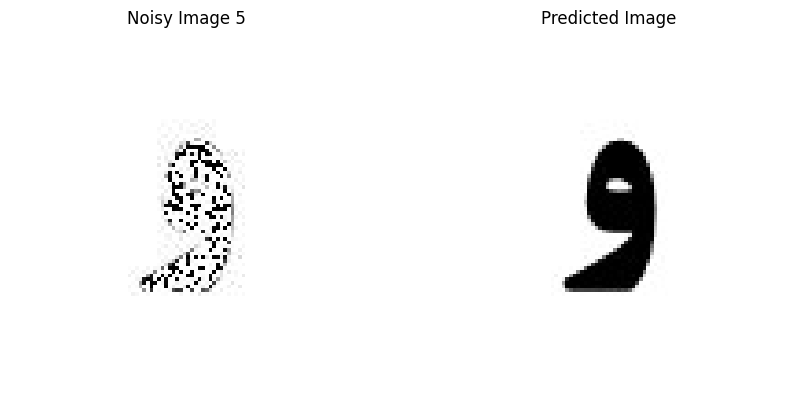

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 396 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 548 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 653 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 389 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 418 missing points and saved as noisy5.jpg


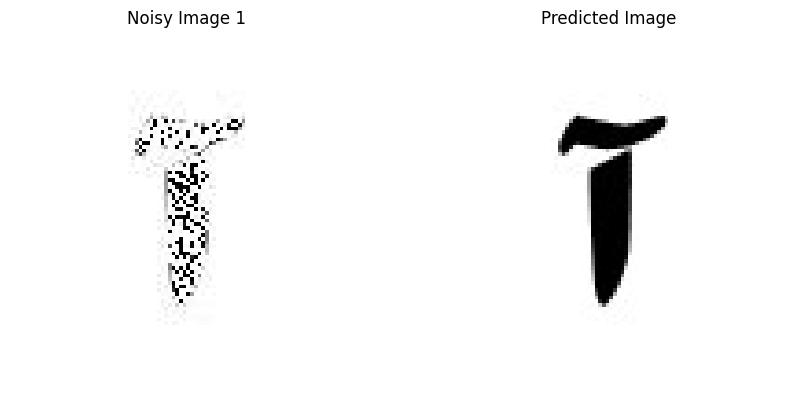

Given Image: noisy1.jpg, Predicted Image Index: 1


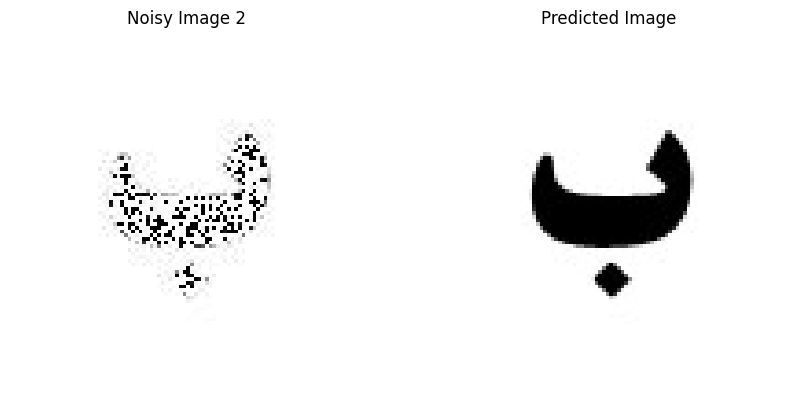

Given Image: noisy2.jpg, Predicted Image Index: 2


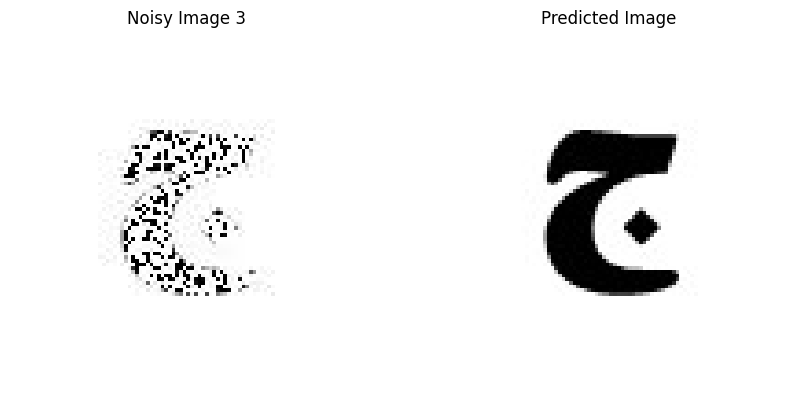

Given Image: noisy3.jpg, Predicted Image Index: 3


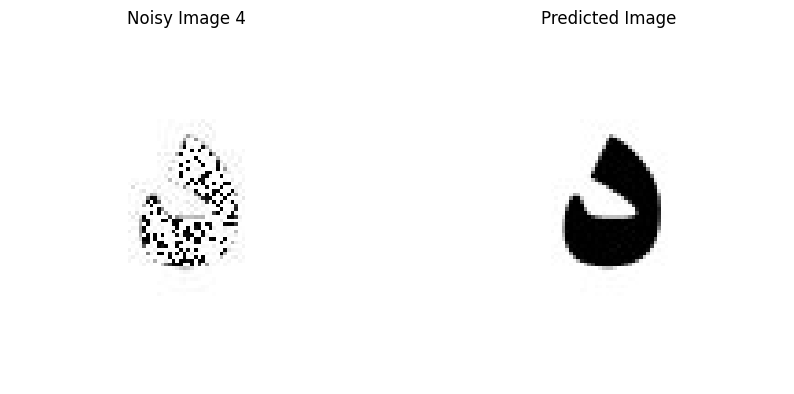

Given Image: noisy4.jpg, Predicted Image Index: 4


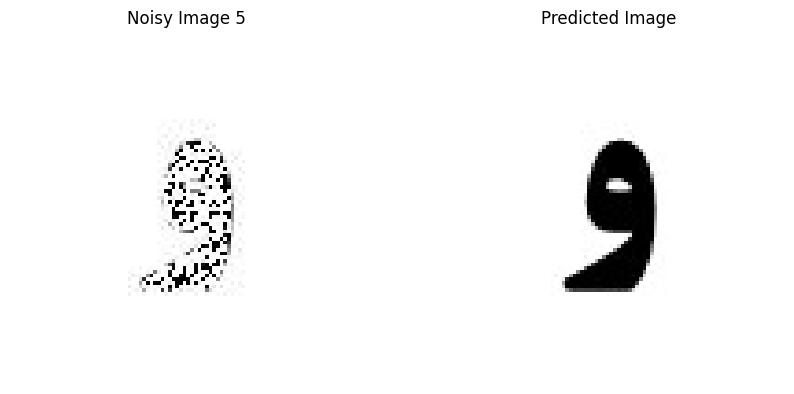

Given Image: noisy5.jpg, Predicted Image Index: 5
Noisy image for 1.jpg generated with 401 missing points and saved as noisy1.jpg
Noisy image for 2.jpg generated with 555 missing points and saved as noisy2.jpg
Noisy image for 3.jpg generated with 663 missing points and saved as noisy3.jpg
Noisy image for 4.jpg generated with 395 missing points and saved as noisy4.jpg
Noisy image for 5.jpg generated with 424 missing points and saved as noisy5.jpg


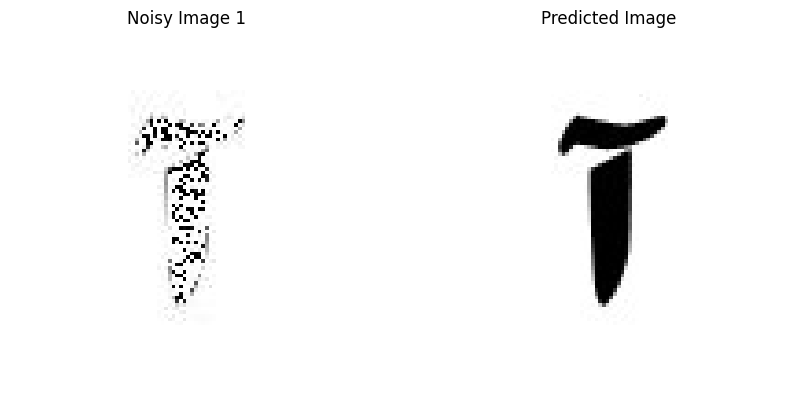

Given Image: noisy1.jpg, Predicted Image Index: 1


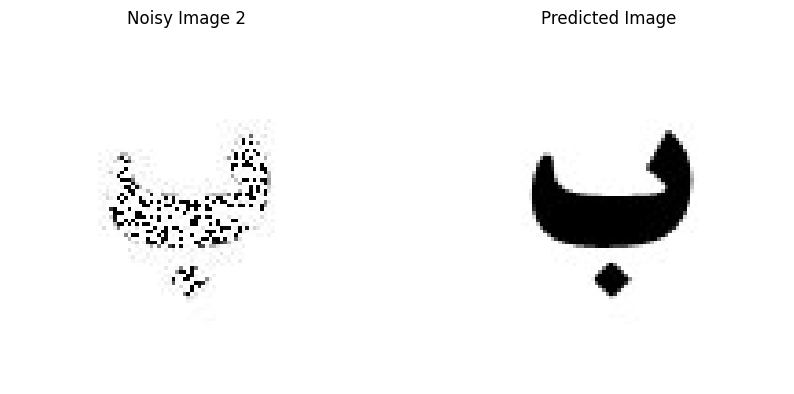

Given Image: noisy2.jpg, Predicted Image Index: 2


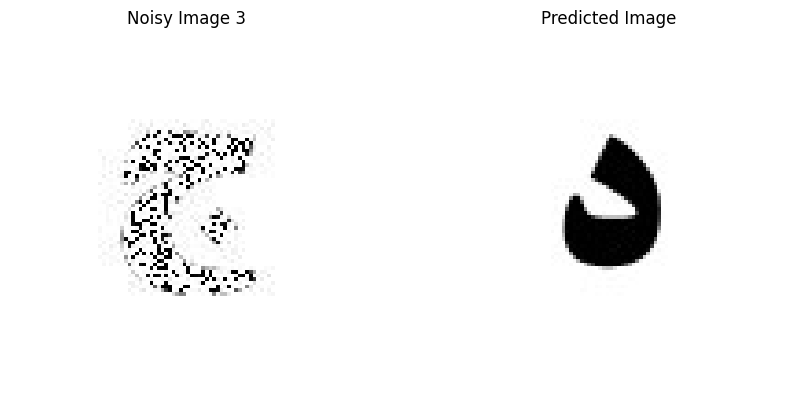

Given Image: noisy3.jpg, Predicted Image Index: 4
Prediction error. The image was image 3 but the network predicted image 4
The highest number of missing points where the network was still accurate: 88910


In [29]:
from PIL import Image, ImageDraw
import numpy as np
import random
import matplotlib.pyplot as plt


# Improved function to change black/gray-like pixels to white gradually
def addingMissingPoint(input_path, output_path, change_rate):

    # Open the input image.
    image = Image.open(input_path).convert('RGB')
    draw = ImageDraw.Draw(image)
    width, height = image.size
    pix = image.load()

    missing_points = 0
    # Threshold to consider gray-like points as black
    threshold = 128

    black_pixels = [(i, j) for i in range(width) for j in range(height) if all(channel < threshold for channel in pix[i, j])]
    num_pixels_to_change = int(len(black_pixels) * change_rate)
    sampled_pixels = random.sample(black_pixels, num_pixels_to_change)

    for i, j in sampled_pixels:
        draw.point((i, j), (255, 255, 255))  # Change black/gray-like pixel to white
        missing_points += 1

    image.save(output_path, "JPEG")
    del draw

    return missing_points

def generateNoisyImages(change_rate, missing_points_list):
    # List of image file paths
    image_paths = [f"{i}.jpg" for i in range(1, 6)]

    for i, image_path in enumerate(image_paths, start=1):
        noisy_image_path = f"noisy{i}.jpg"
        missing_points = addingMissingPoint(image_path, noisy_image_path, change_rate)
        missing_points_list.append(missing_points)
        print(f"Noisy image for {image_path} generated with {missing_points} missing points and saved as {noisy_image_path}")

    return missing_points_list

# Define the Hamming Network class
class HammingNetwork:
    def __init__(self, num_neurons):
        self.num_neurons = num_neurons
        self.weights = None
        self.bias = None

    def train(self, inputs):
        self.weights = np.array(inputs)
        self.bias = np.ones(self.num_neurons) * 0.5 * len(inputs[0]) * 3

    def predict(self, input_image):
        product = np.dot(self.weights, input_image)
        stored = product - self.bias
        return np.argmax(stored)

# Function to display images side-by-side for comparison
def display_images(noisy_image_pil, predicted_image_pil, index):
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(noisy_image_pil)
    plt.title(f'Noisy Image {index+1}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(predicted_image_pil)
    plt.title(f'Predicted Image')
    plt.axis('off')

    plt.show()

# Paths to original images
image_paths = [f"{i}.jpg" for i in range(1, 6)]

# Initialize and train the Hamming Network using clean images
network = HammingNetwork(num_neurons=len(image_paths))
training_data = [convertImageToBinary(path) for path in image_paths]
network.train(training_data)

# Initial change rate
change_rate = 0.01  # Start with a small change rate
missing_points_list = []

# Continue adding missing points until the original picture becomes white
while True:
    correct_predictions = 0
    missing_points_list = generateNoisyImages(change_rate, missing_points_list)  # Generate noisy images by adding missing points gradually

    for i, path in enumerate([f"noisy{i}.jpg" for i in range(1, 6)]):
        noisy_image = np.array(convertImageToBinary(path)).flatten()
        prediction = network.predict(noisy_image)

        # Display the noisy image and predicted image
        noisy_image_pil = Image.open(path)
        predicted_image_pil = Image.open(image_paths[prediction])
        display_images(noisy_image_pil, predicted_image_pil, i)

        print(f"Given Image: {path}, Predicted Image Index: {prediction + 1}")

        if prediction != i:
            print(f"Prediction error. The image was image {i+1} but the network predicted image {prediction+1}")
            last_correct_missing_points = sum(missing_points_list)  # Sum the missing points up to the last correct prediction
            break
        else:
            correct_predictions += 1

    if correct_predictions != len(image_paths):
        break  # Stop loop if the network makes an incorrect prediction

    change_rate += 0.01  # Gradually increase the change rate

print(f"The highest number of missing points where the network was still accurate: {last_correct_missing_points}")


Epoch 1/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step - loss: 0.6524 - val_loss: 0.5024
Epoch 2/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.5079 - val_loss: 0.3641
Epoch 3/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 358ms/step - loss: 0.3760 - val_loss: 0.2506
Epoch 4/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step - loss: 0.2724 - val_loss: 0.2192
Epoch 5/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step - loss: 0.2550 - val_loss: 0.2443
Epoch 6/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step - loss: 0.2914 - val_loss: 0.2556
Epoch 7/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 628ms/step - loss: 0.3060 - val_loss: 0.2439
Epoch 8/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 602ms/step - loss: 0.2916 - val_loss: 0.2223
Epoch 9/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 604ms/step - loss: 0.2637 - val_loss: 0.2042
Epoch 10/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 589ms/step - loss: 0.2386 - val_loss: 0.1986
Epoch 11/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 329ms/step - loss: 0.2261 - val_loss: 0.2082
Epoch 12/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 699ms/step - loss: 0.2303 - val_loss: 0.

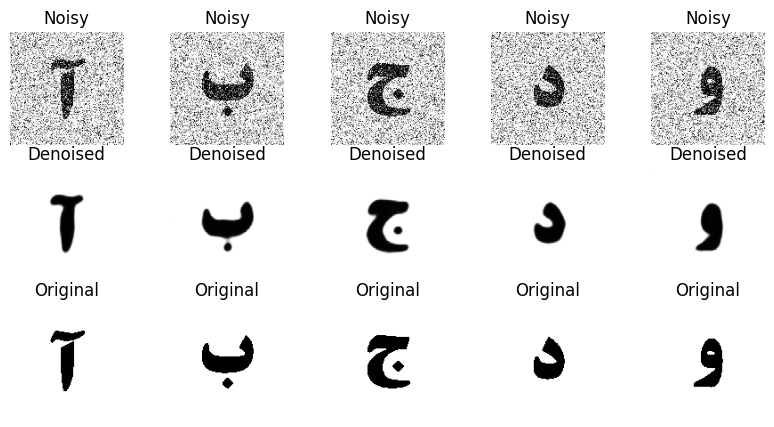

In [42]:
from keras.models import Model, Sequential
from keras.layers import Dense, Input, Flatten, Reshape, Conv2D, MaxPooling2D, UpSampling2D
from keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image, ImageDraw
import numpy as np
import matplotlib.pyplot as plt
import random

# Data Augmentation with ImageDataGenerator
def augment_images(image_paths):
    datagen = ImageDataGenerator(
        rotation_range=15,
        width_shift_range=0.1,
        height_shift_range=0.1,
        zoom_range=0.1,
        horizontal_flip=True,
        fill_mode='nearest'
    )

    augmented_images = []
    for path in image_paths:
        img = np.array(Image.open(path).resize((128, 128))) / 255.0
        img = img.reshape((1,) + img.shape)  # Add batch dimension
        augmented_images.extend([next(datagen.flow(img, batch_size=1))[0] for _ in range(5)])  # Generate 5 augmented images
    return np.array(augmented_images)

# Preprocessing: Convert Image to Binary
def convert_image_to_binary(image_path, size=(128, 128)):
    image = Image.open(image_path).convert('L').resize(size)
    return (np.array(image) > 128).astype(int)

# Denoising Autoencoder
def build_autoencoder(input_shape):
    input_img = Input(shape=input_shape)

    # Encoder
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)

    # Decoder
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)

    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy')
    return autoencoder

# Paths to clean images
image_paths = [f"{i}.jpg" for i in range(1, 6)]

# Prepare Data for Denoising Autoencoder
train_images = np.array([convert_image_to_binary(path) for path in image_paths])
train_images = train_images.reshape((-1, 128, 128, 1))  # Add channel dimension
noisy_images = train_images + 0.5 * np.random.normal(loc=0.0, scale=1.0, size=train_images.shape)  # Add Gaussian noise
noisy_images = np.clip(noisy_images, 0., 1.)  # Clip values to [0, 1]

# Build and Train the Autoencoder
autoencoder = build_autoencoder(input_shape=(128, 128, 1))
autoencoder.fit(noisy_images, train_images, epochs=50, batch_size=16, validation_split=0.2)

# Visualize Denoising Results
def display_denoising_results(noisy, denoised, original):
    plt.figure(figsize=(10, 5))

    for i in range(5):
        plt.subplot(3, 5, i + 1)
        plt.imshow(noisy[i].reshape(128, 128), cmap='gray')
        plt.axis('off')
        plt.title('Noisy')

        plt.subplot(3, 5, i + 6)
        plt.imshow(denoised[i].reshape(128, 128), cmap='gray')
        plt.axis('off')
        plt.title('Denoised')

        plt.subplot(3, 5, i + 11)
        plt.imshow(original[i].reshape(128, 128), cmap='gray')
        plt.axis('off')
        plt.title('Original')

    plt.show()

# Predict Denoised Images
denoised_images = autoencoder.predict(noisy_images)
display_denoising_results(noisy_images, denoised_images, train_images)


Epoch 1/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.6593 - val_loss: 0.5670
Epoch 2/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step - loss: 0.5705 - val_loss: 0.4642
Epoch 3/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step - loss: 0.4715 - val_loss: 0.3527
Epoch 4/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 289ms/step - loss: 0.3651 - val_loss: 0.2570
Epoch 5/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step - loss: 0.2770 - val_loss: 0.2141
Epoch 6/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 728ms/step - loss: 0.2448 - val_loss: 0.2235
Epoch 7/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step - loss: 0.2644 - val_loss: 0.2341
Epoch 8/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 645ms/step - loss: 0.2794 - val_loss: 0.2256
Epoch 9/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 483ms/step - loss: 0.2690 - val_loss: 0.2027
Epoch 10/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 654ms/step - loss: 0.2402 - val_loss: 0.1797
Epoch 11/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 435ms/step - loss: 0.2099 - val_loss: 0.1663
Epoch 12/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step - loss: 0.1896 - val_loss:

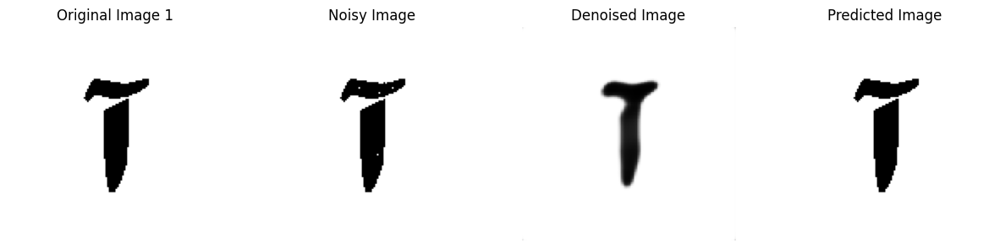

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


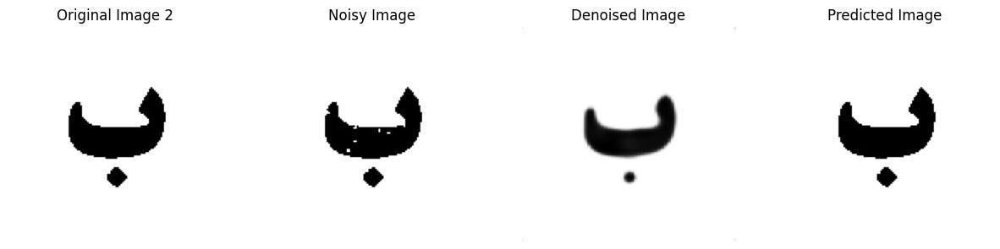

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


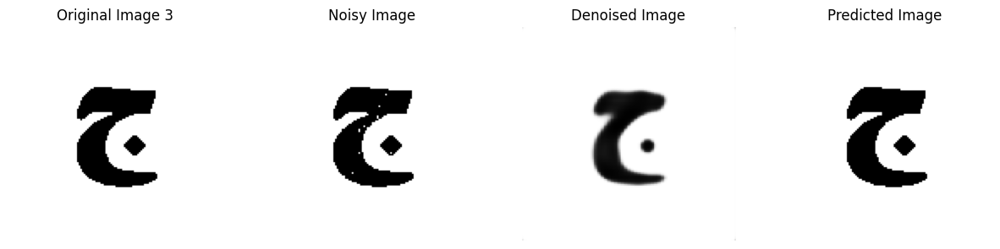

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


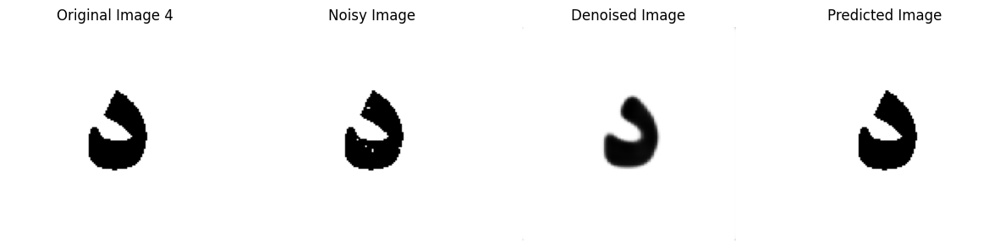

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


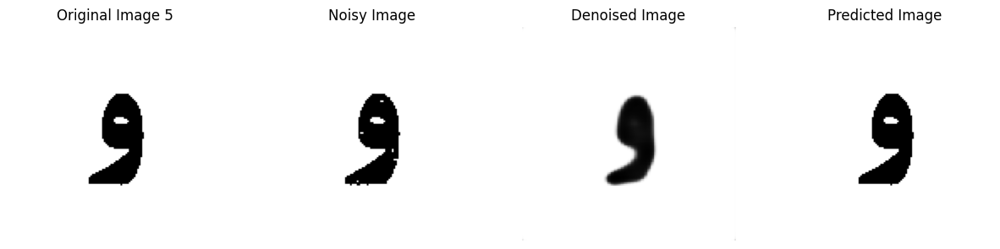

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


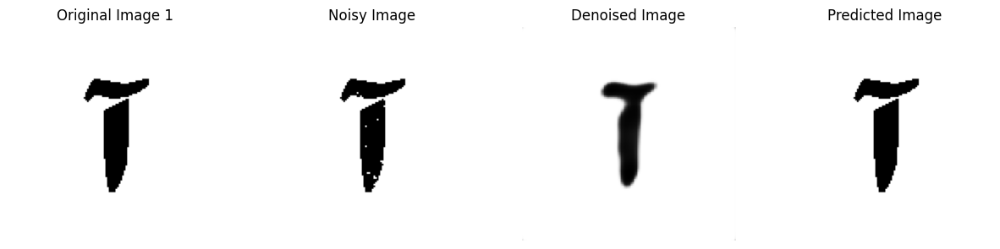

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


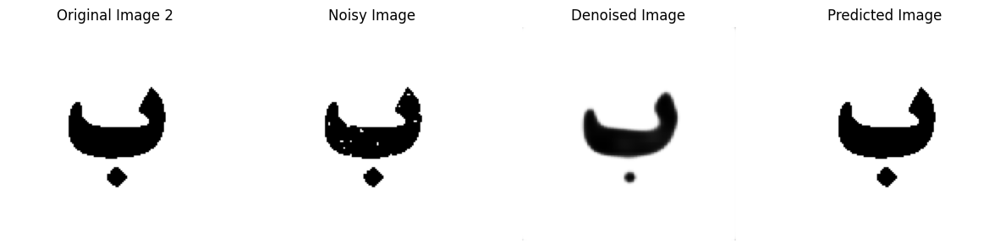

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


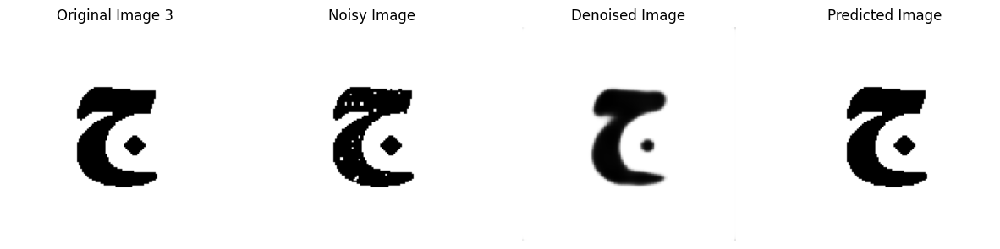

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


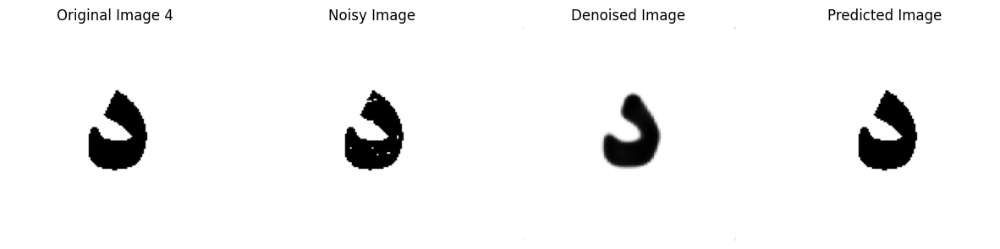

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


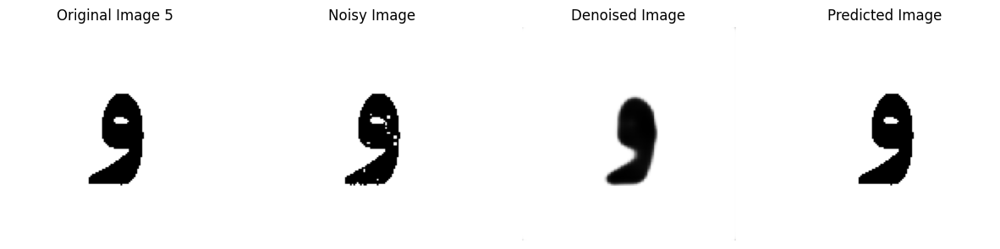

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


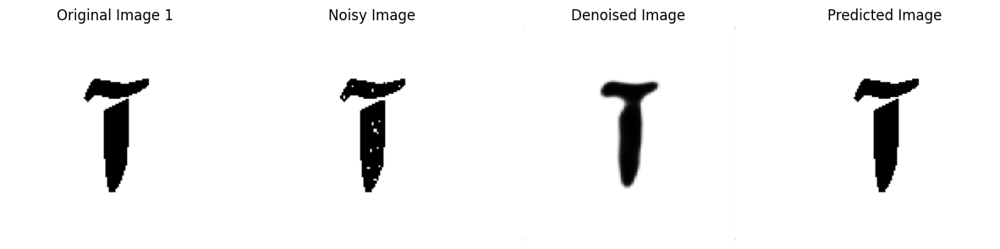

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


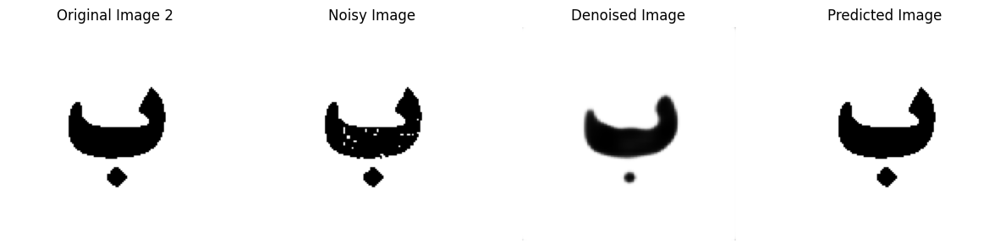

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


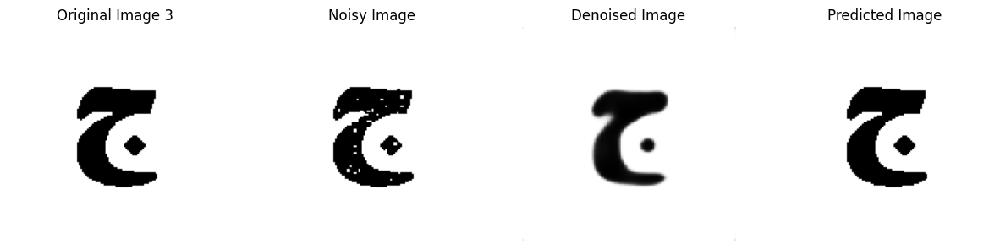

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


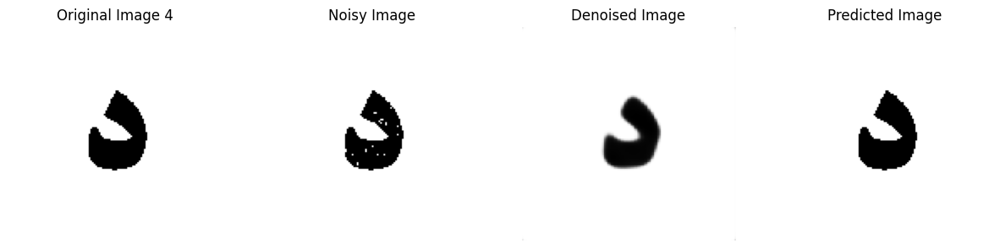

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


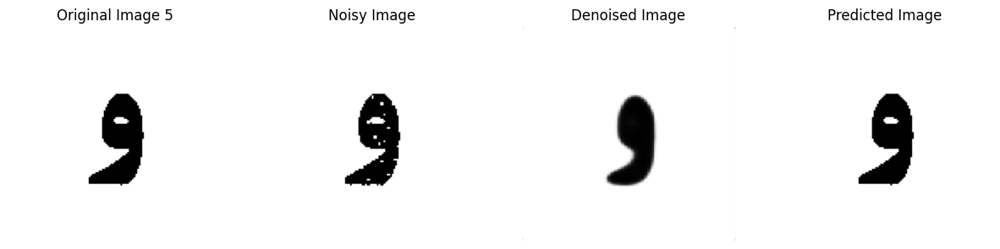

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


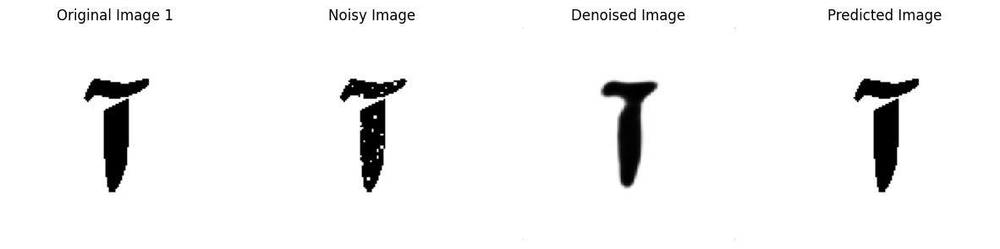

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


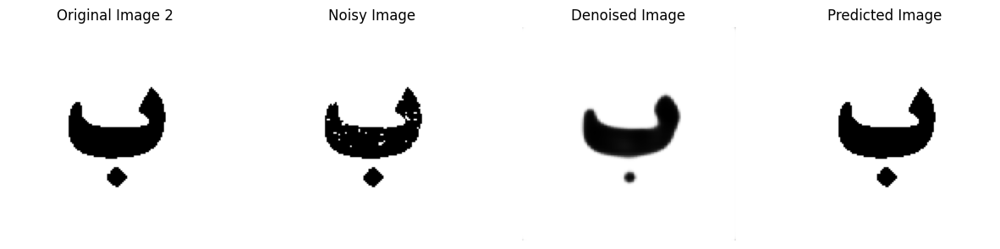

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


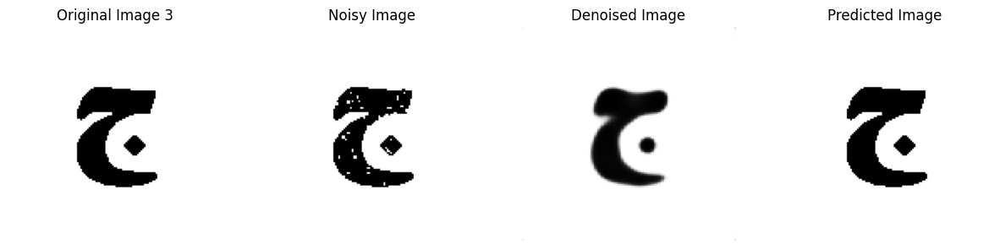

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


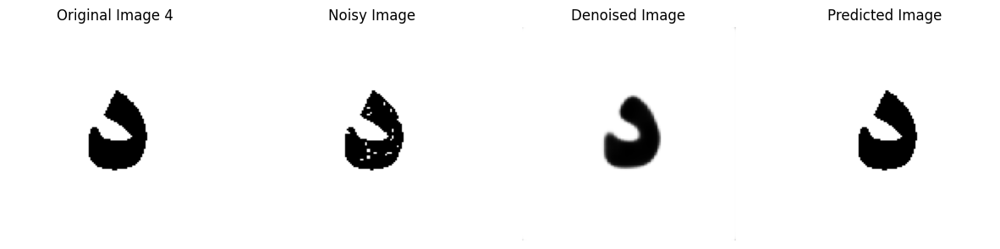

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


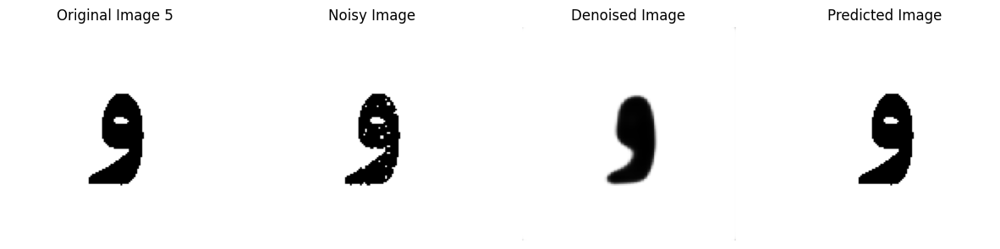

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


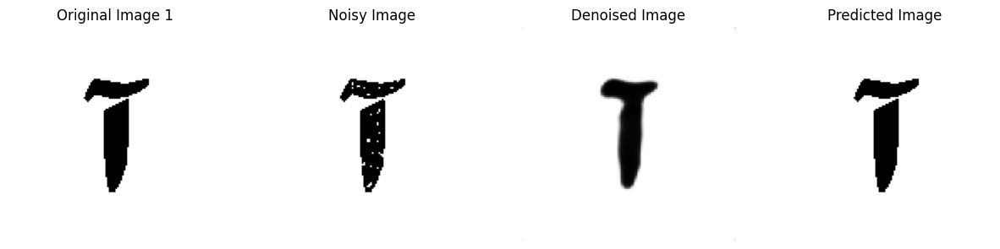

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


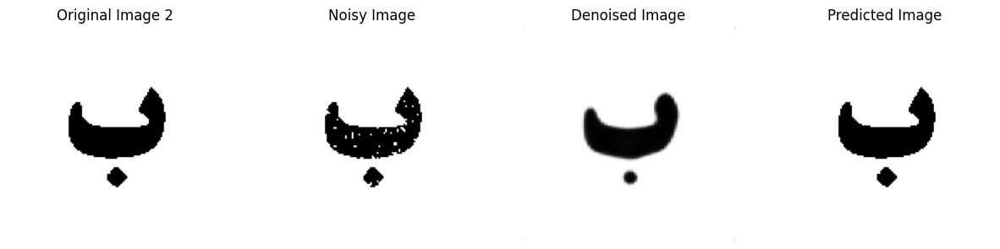

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


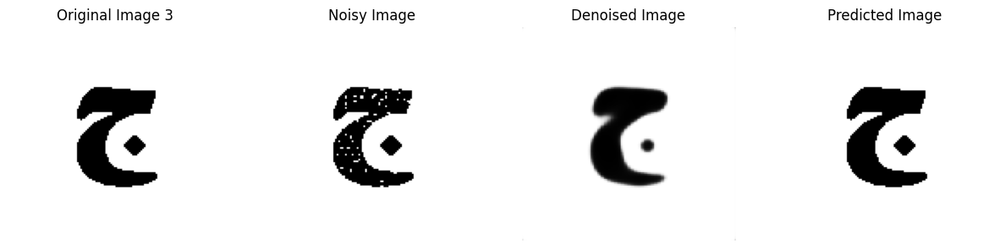

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


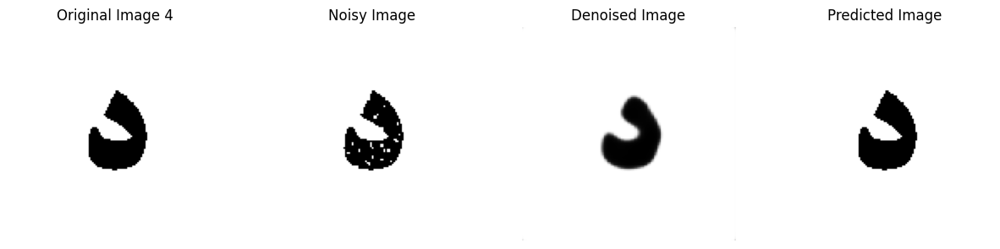

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


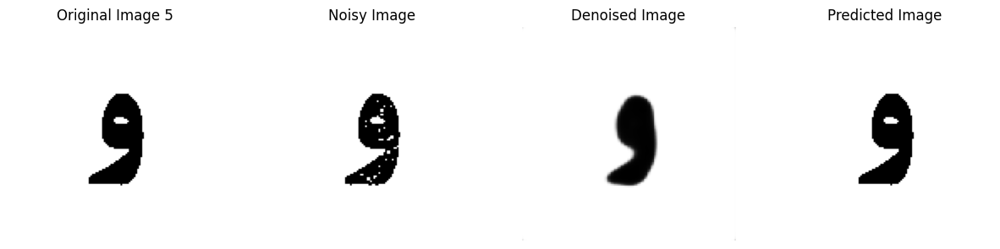

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


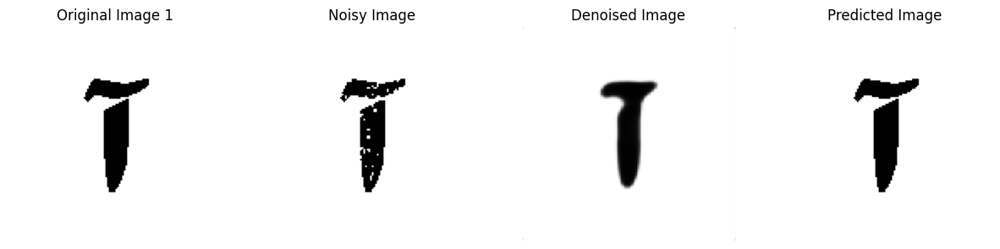

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


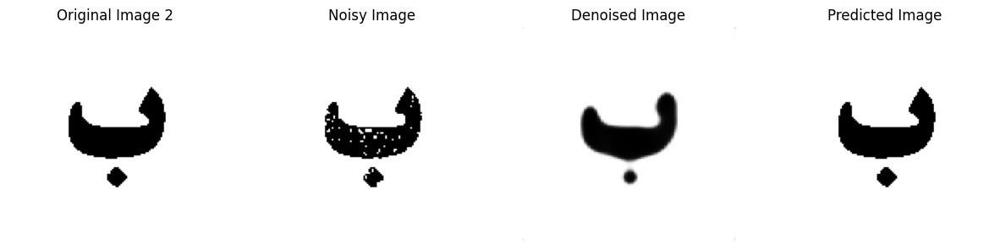

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


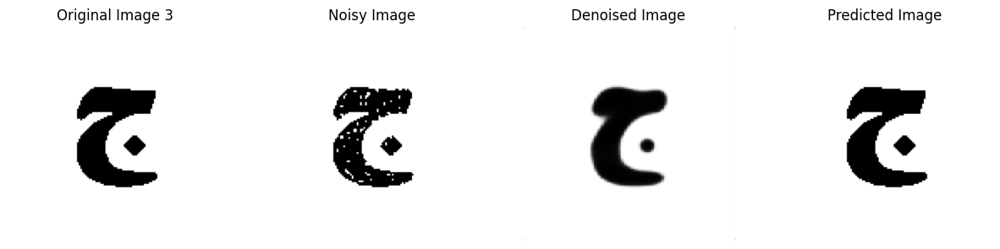

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


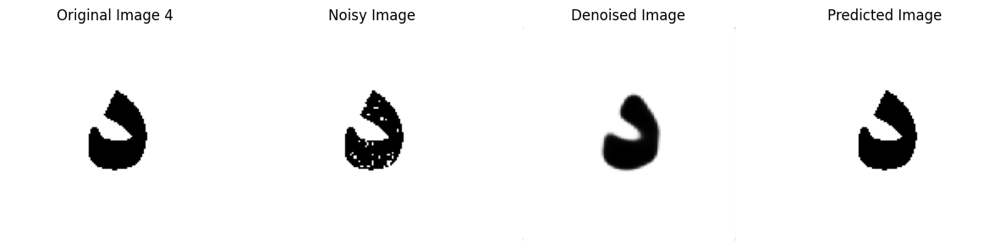

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


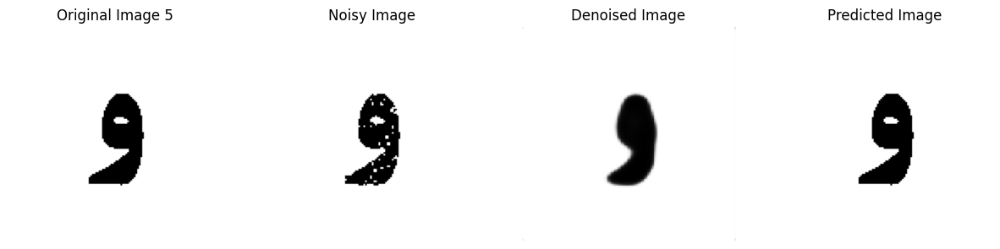

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


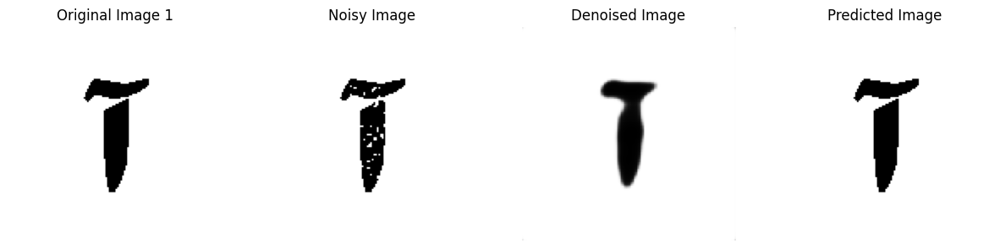

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


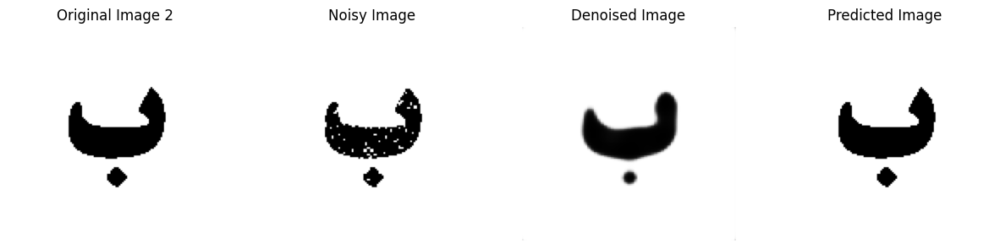

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


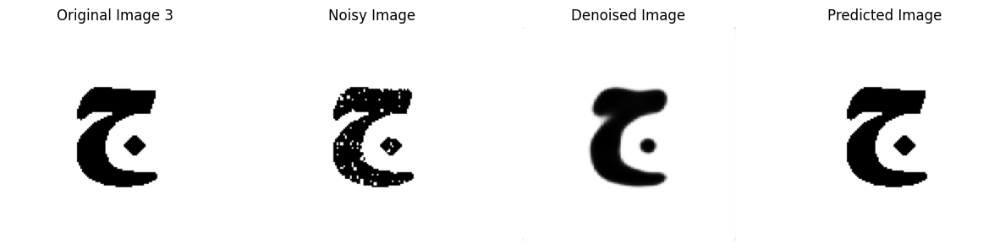

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


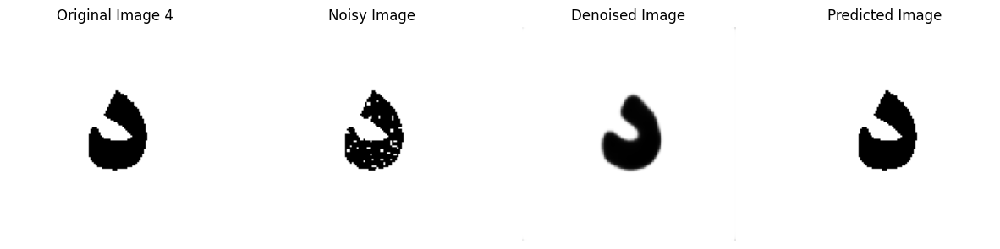

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


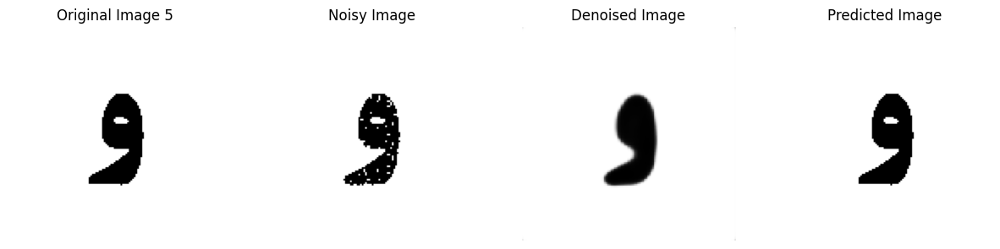

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


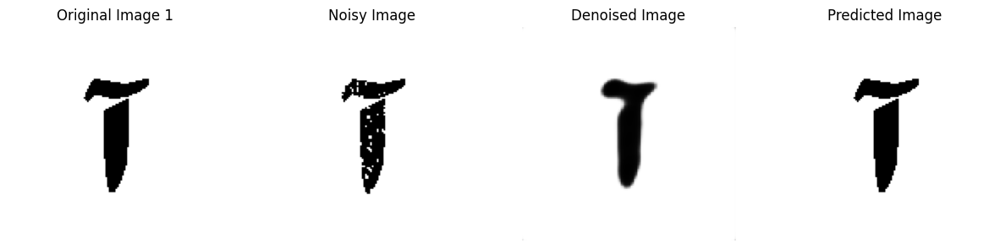

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


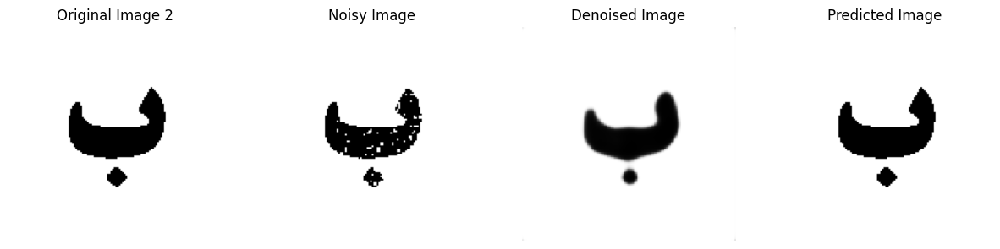

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


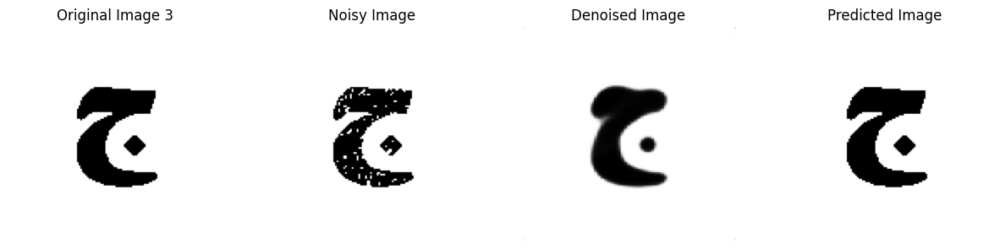

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


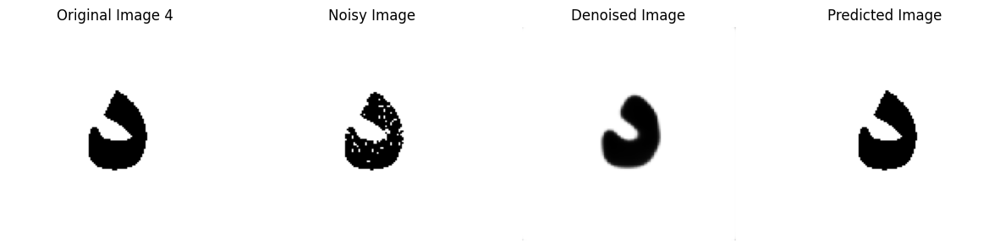

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


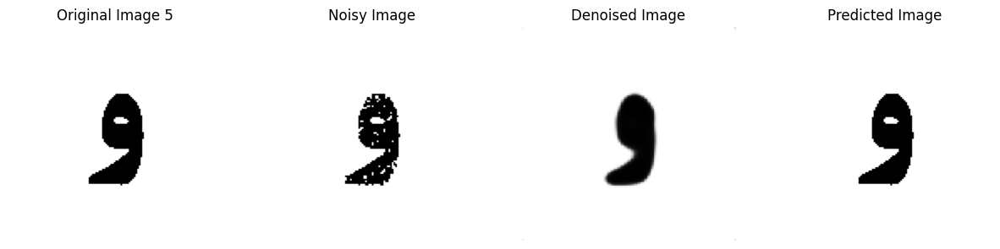

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


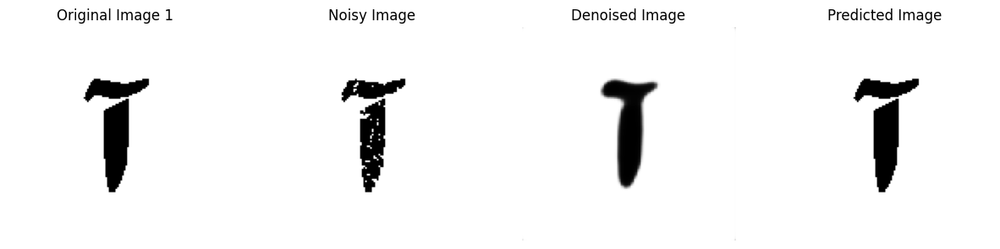

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


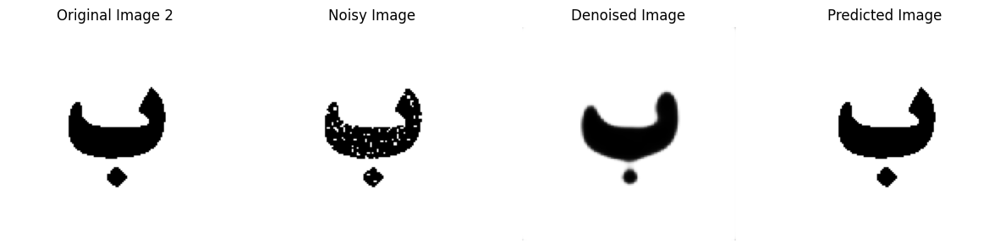

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


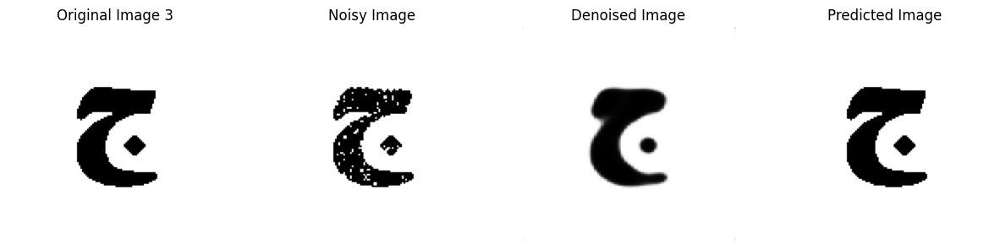

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


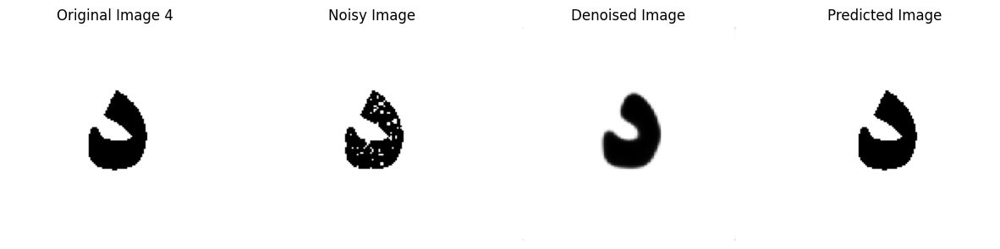

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


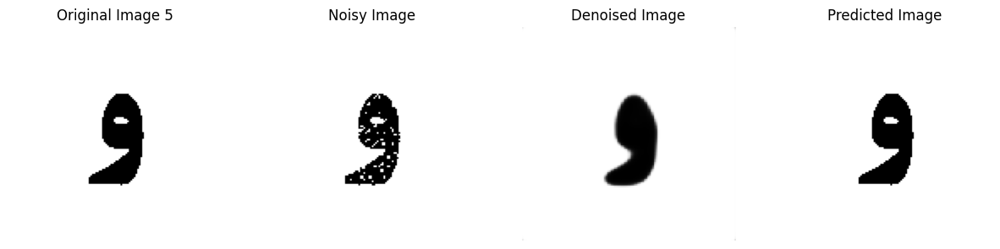

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


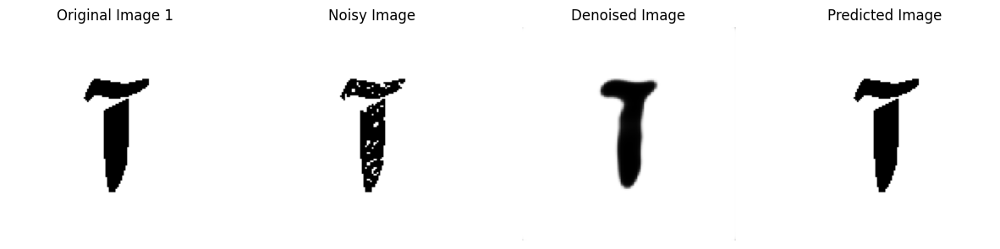

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


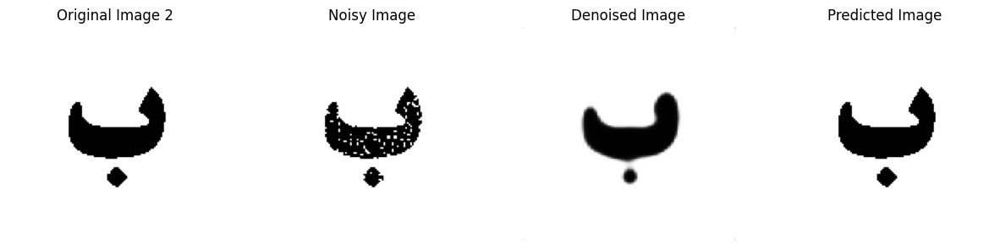

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


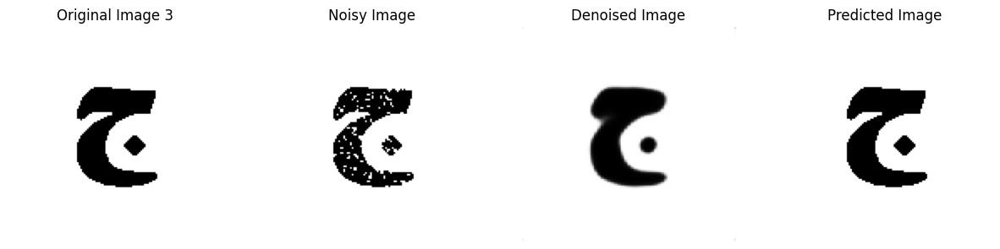

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


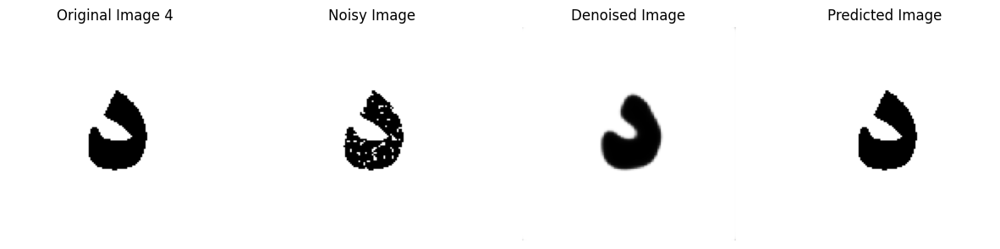

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


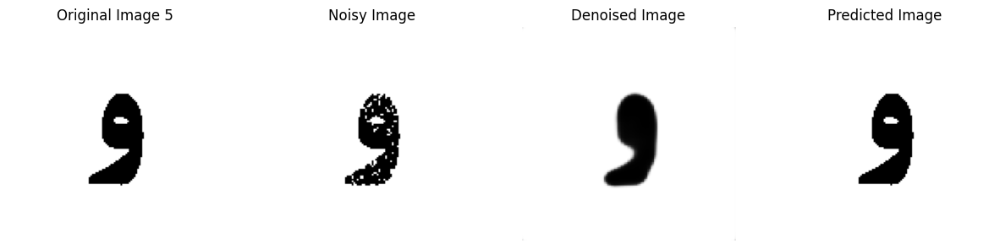

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


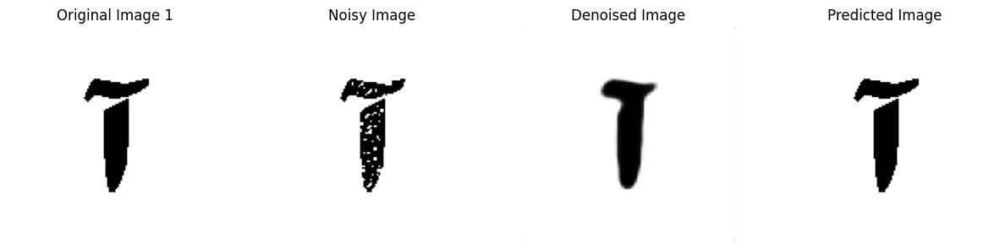

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


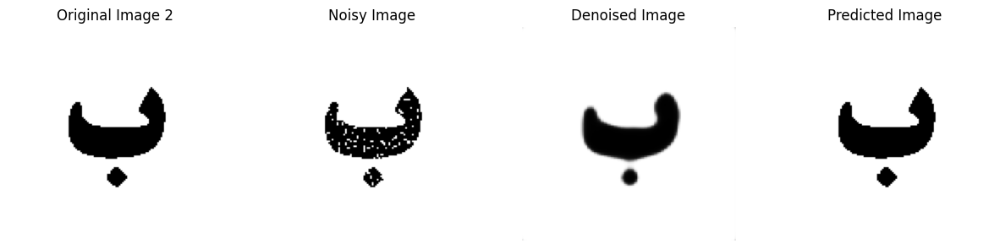

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


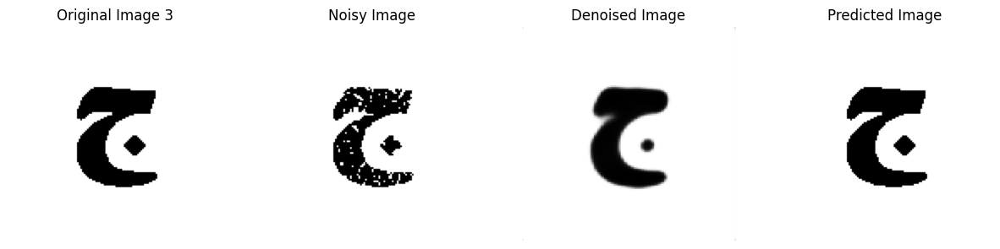

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


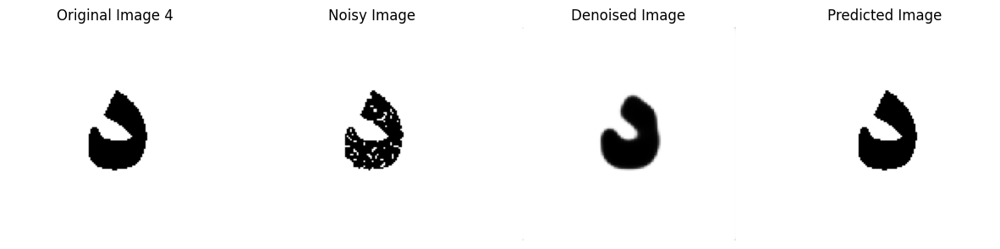

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


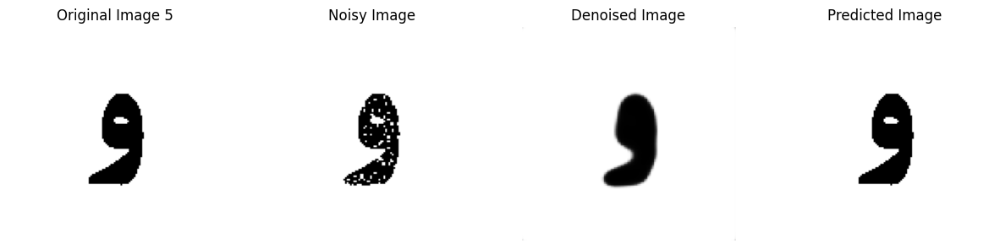

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


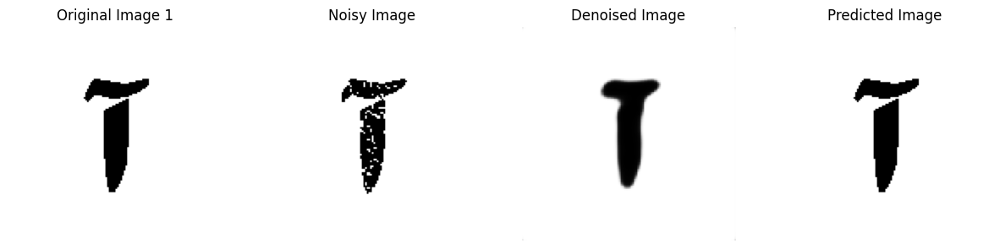

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


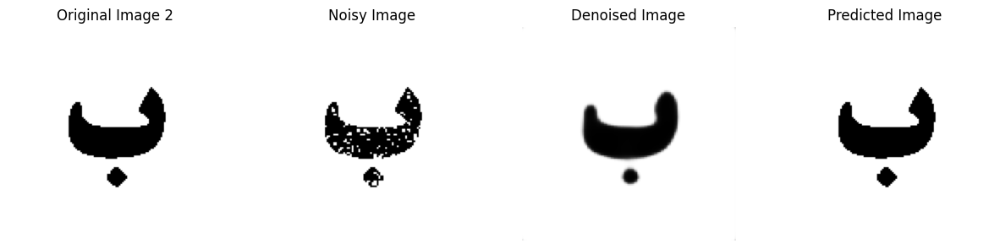

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


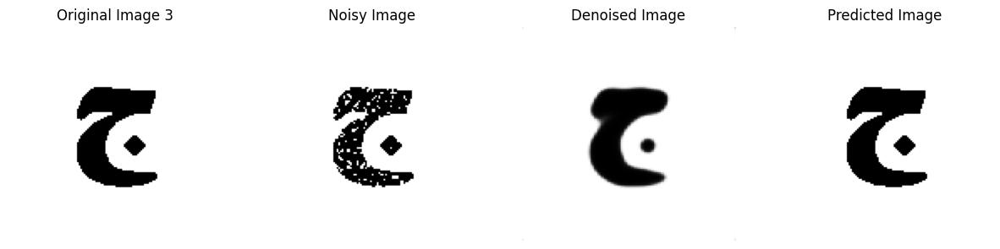

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


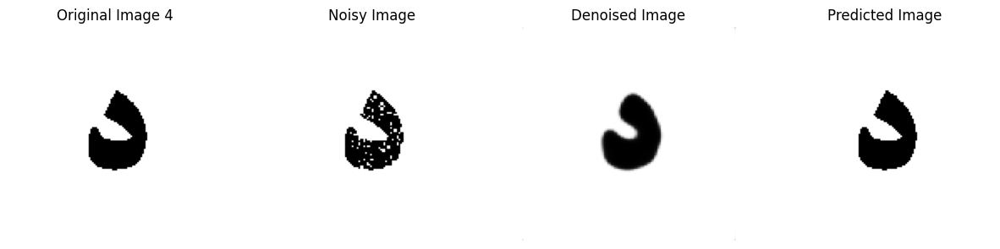

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


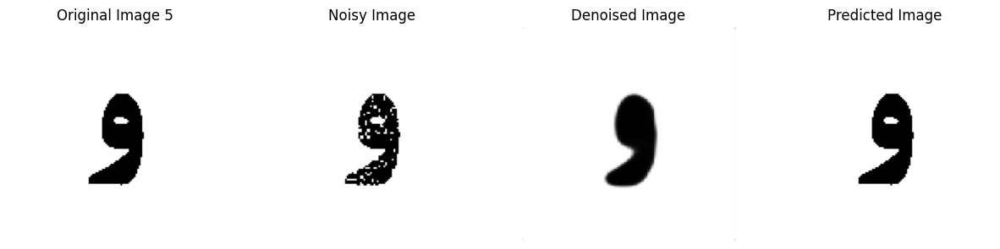

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


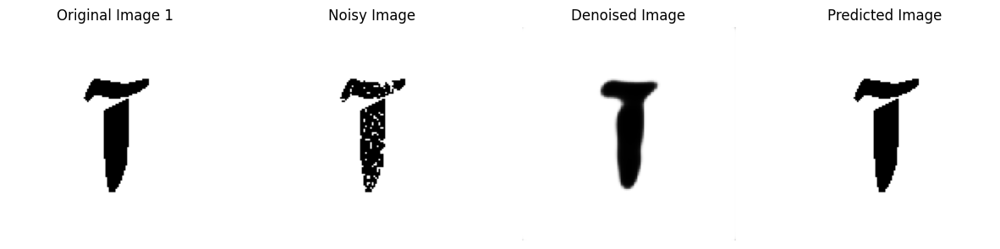

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


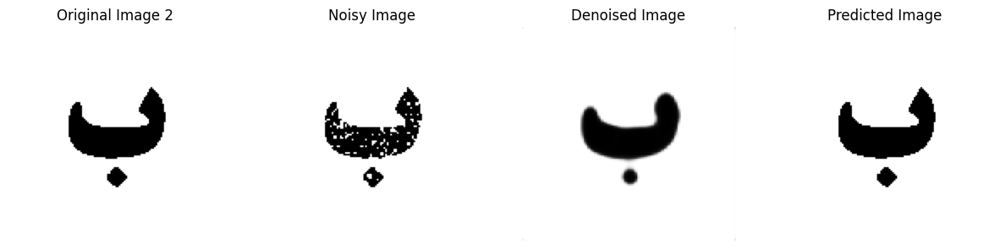

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


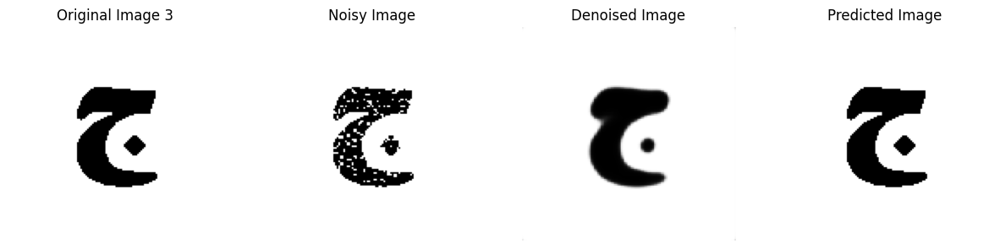

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


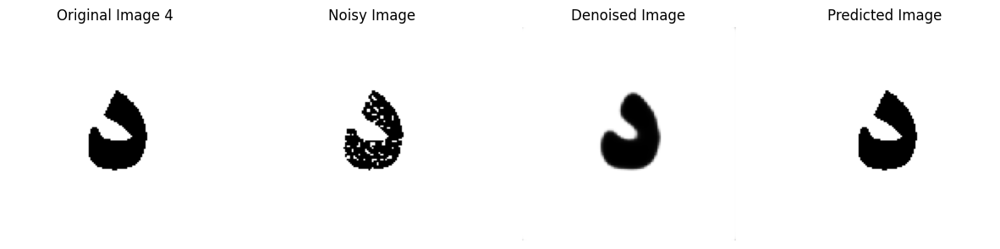

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


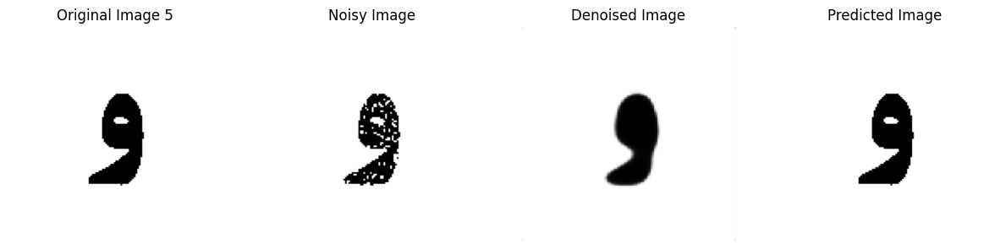

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


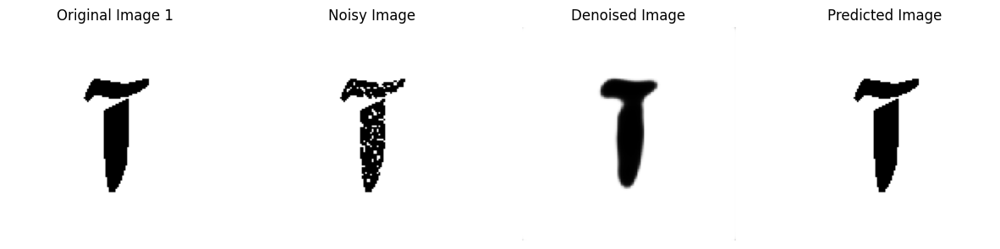

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


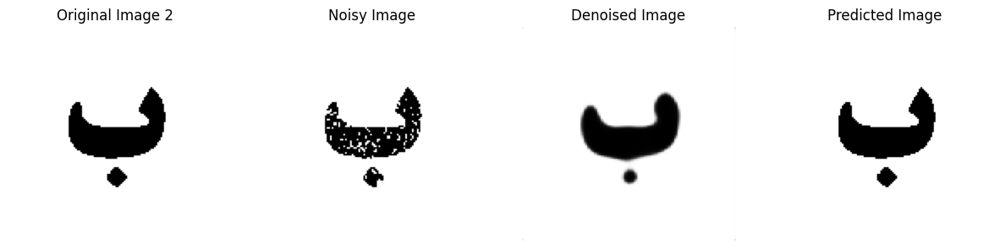

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


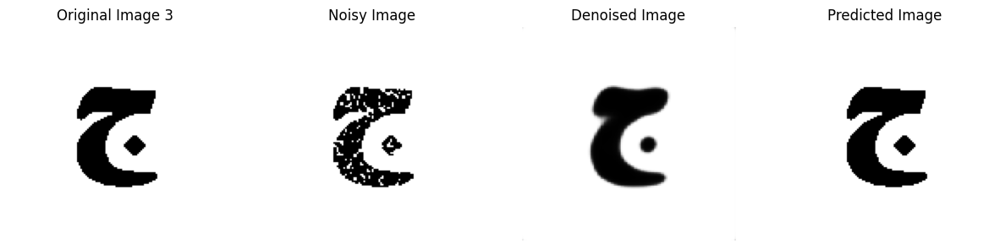

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


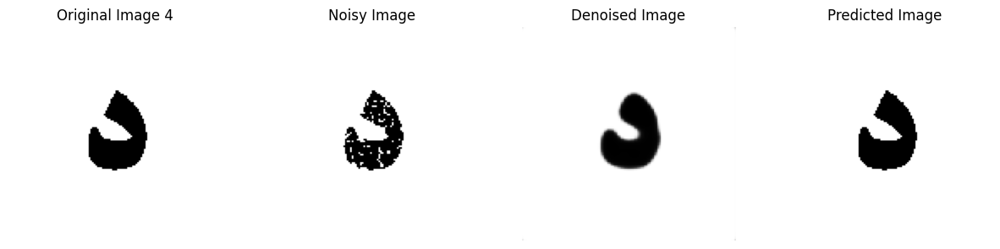

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


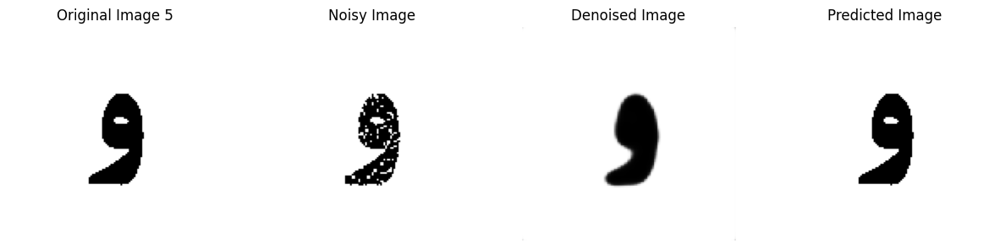

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


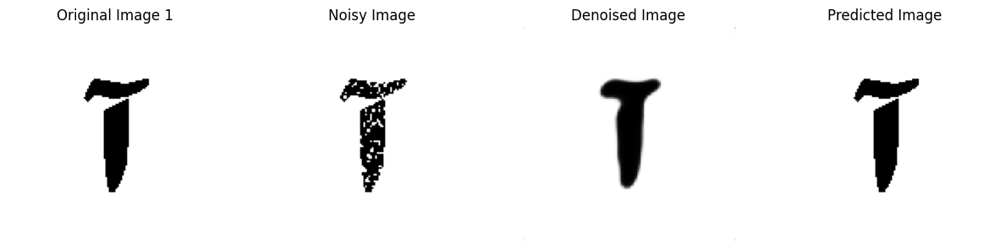

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


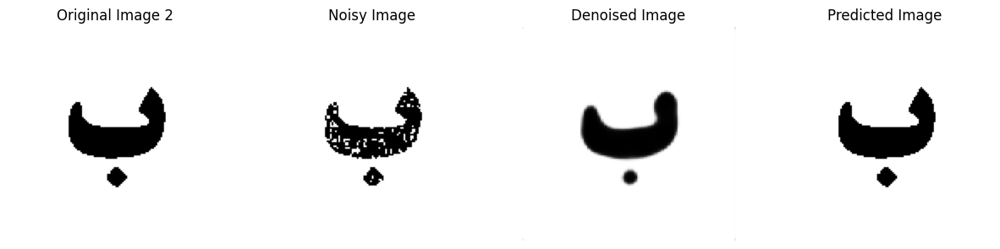

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


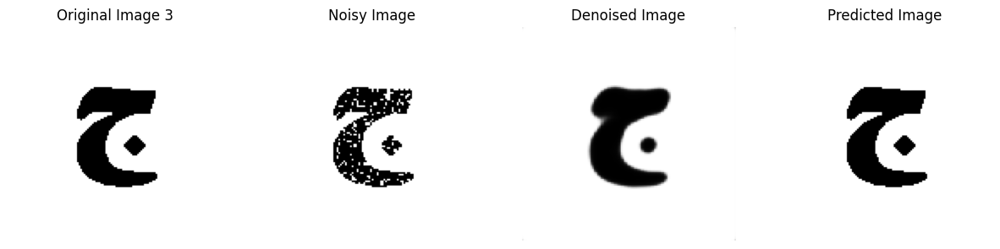

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


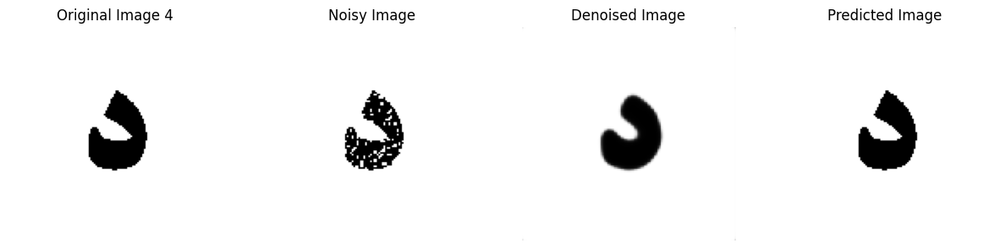

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


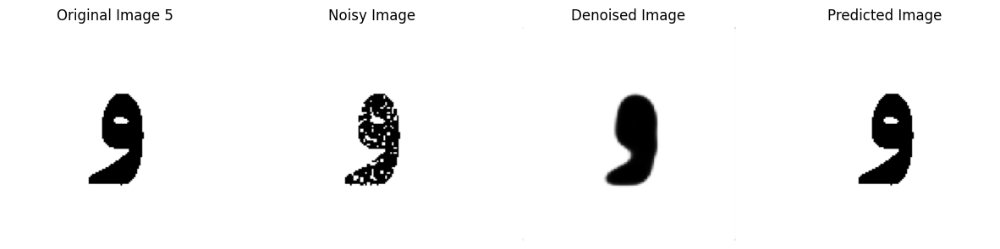

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


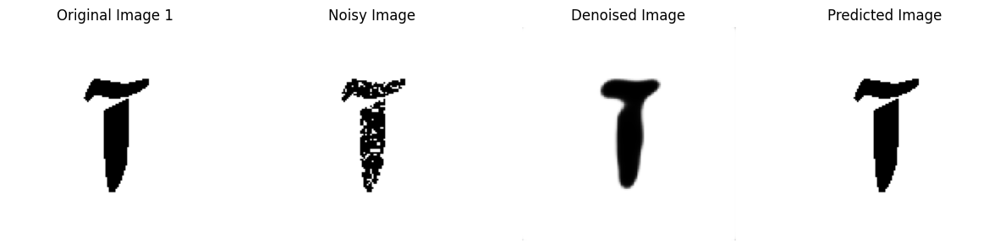

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


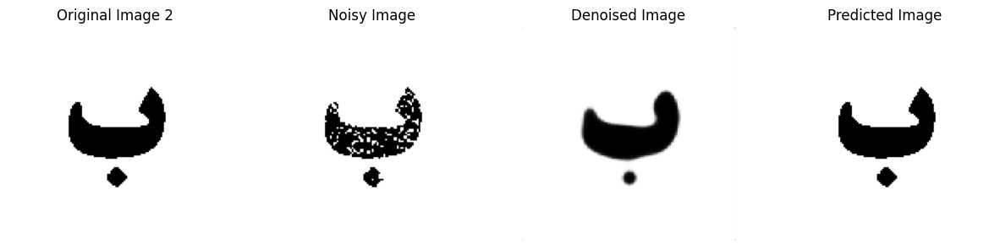

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


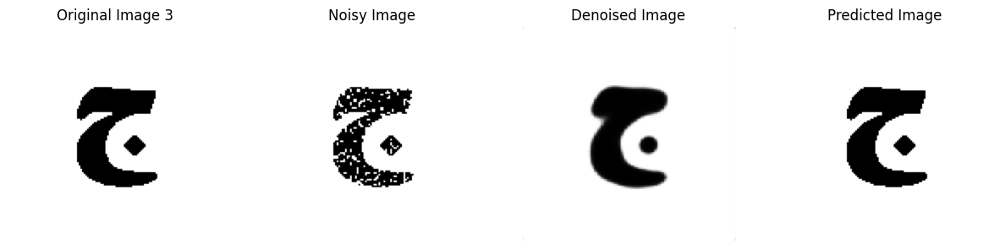

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


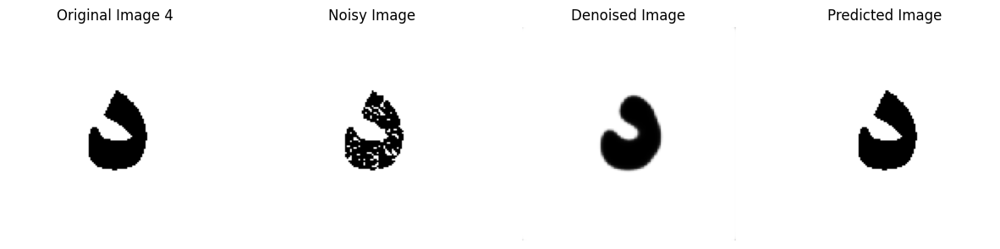

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


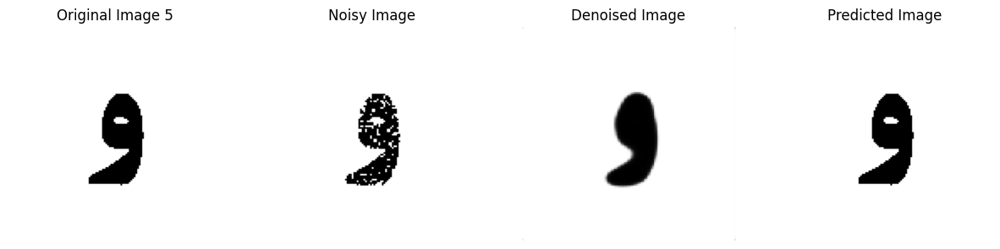

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


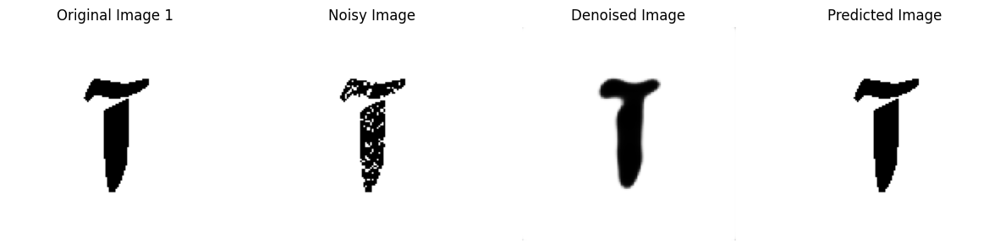

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


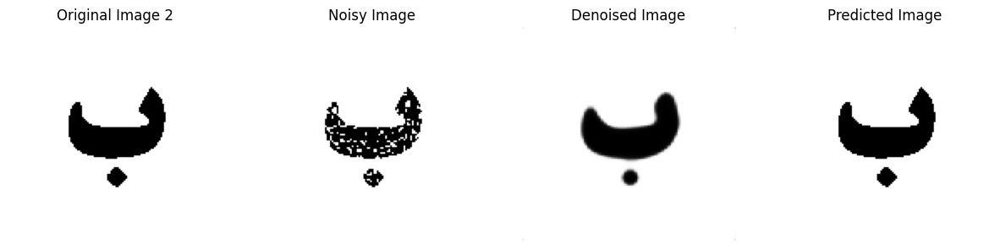

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


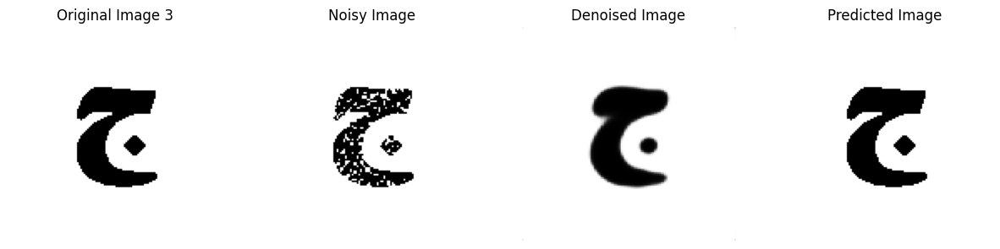

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


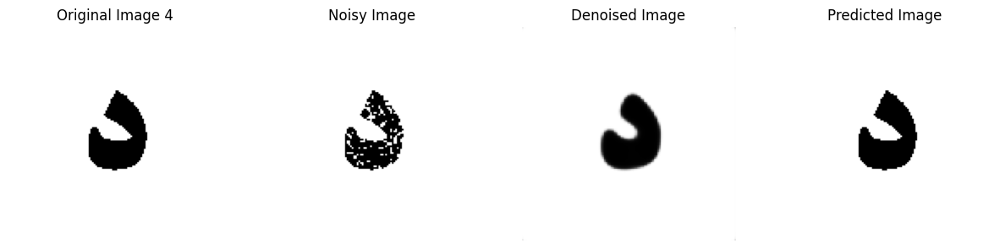

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


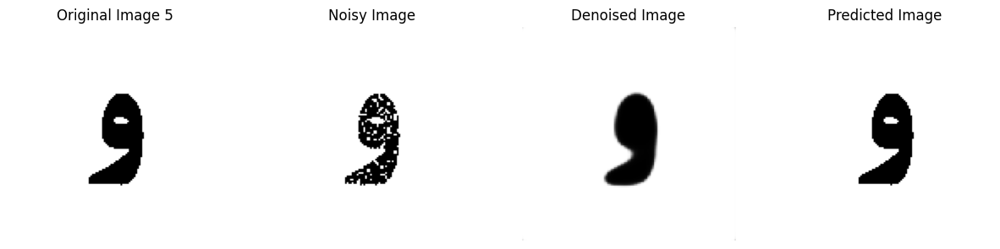

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


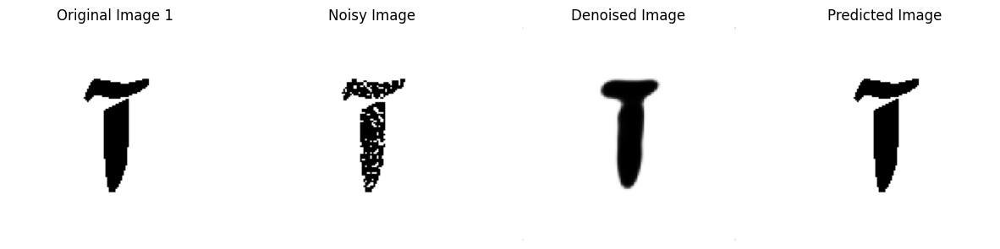

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


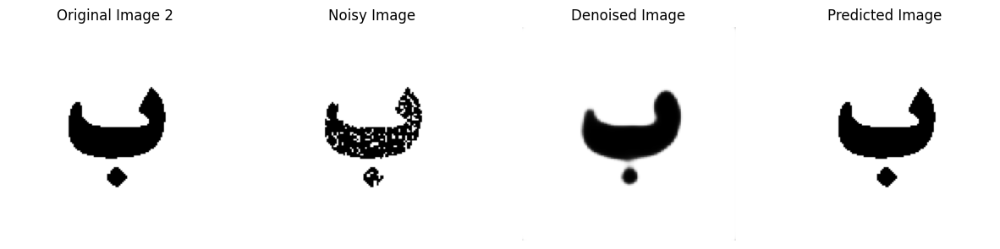

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


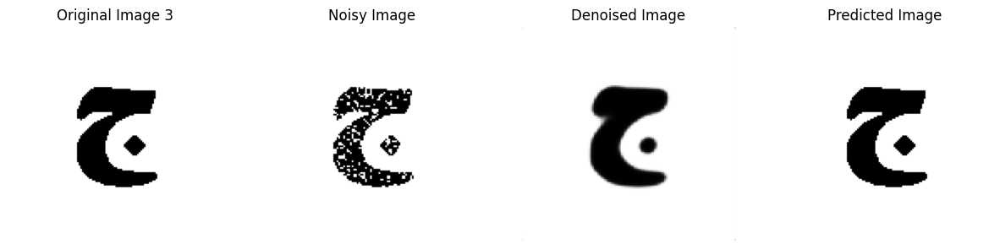

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


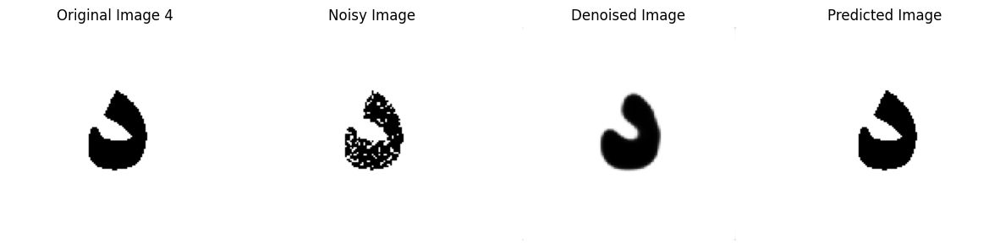

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


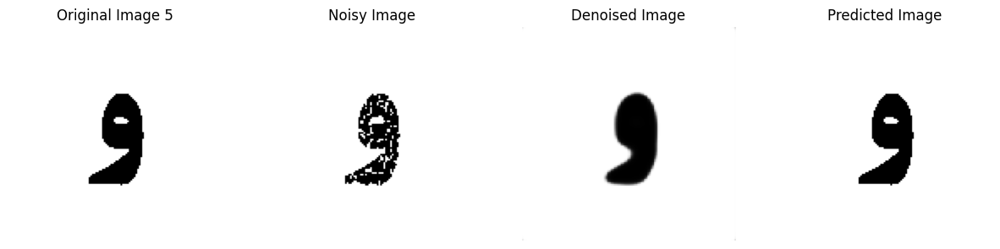

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


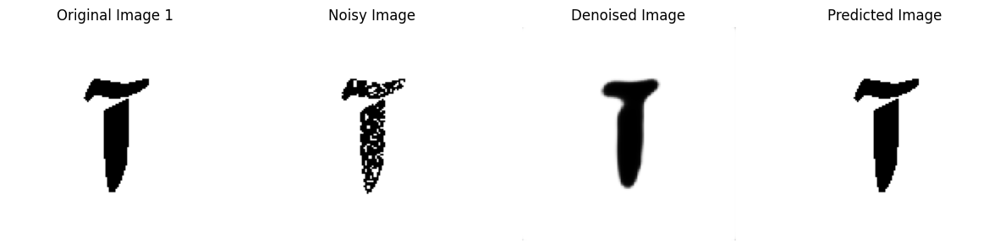

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


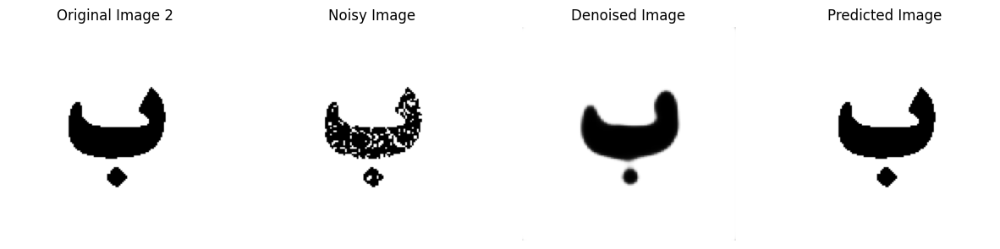

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


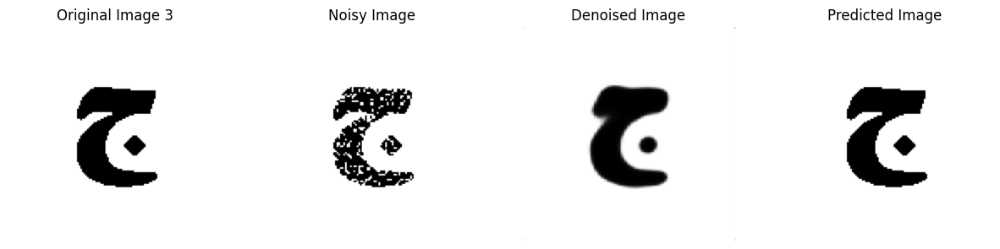

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


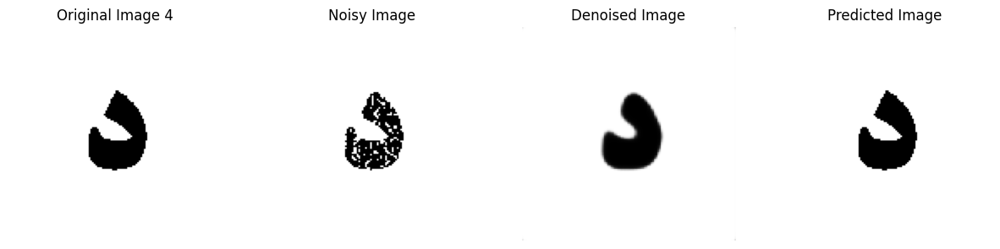

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


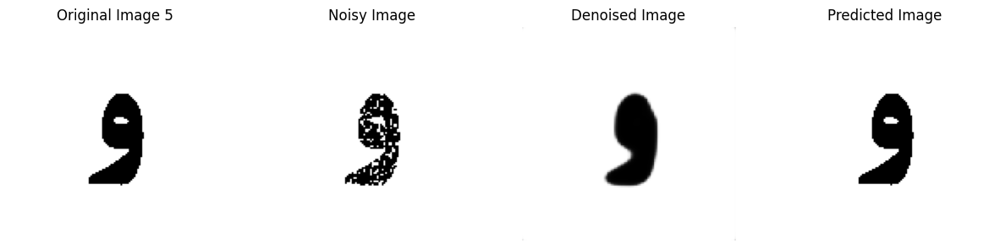

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


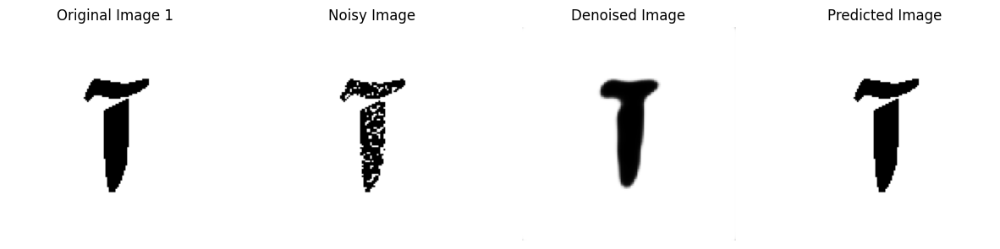

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


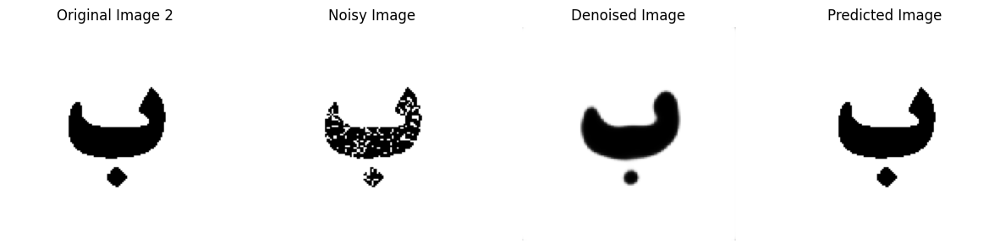

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


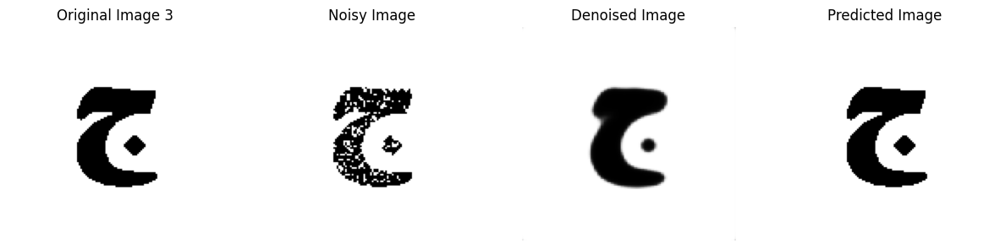

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


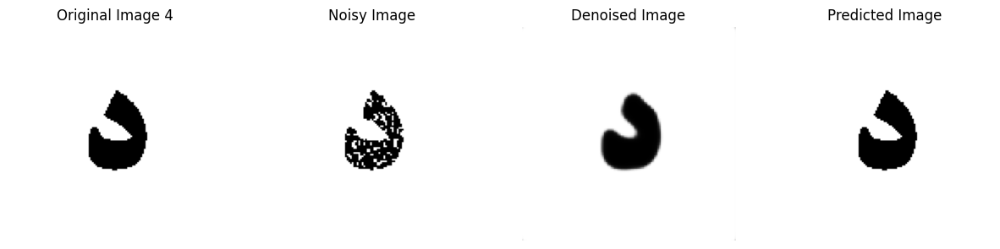

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


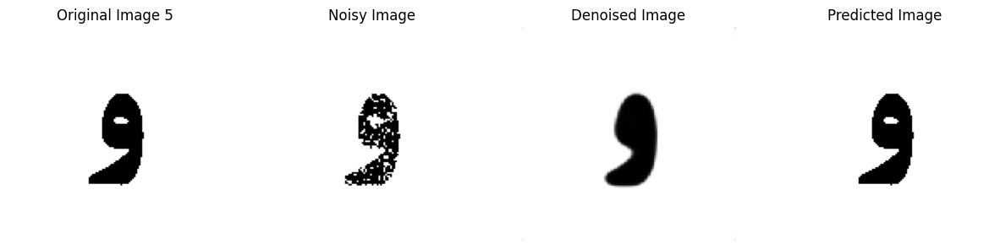

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


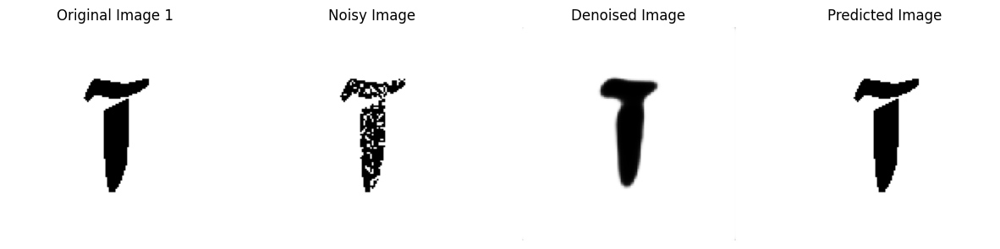

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


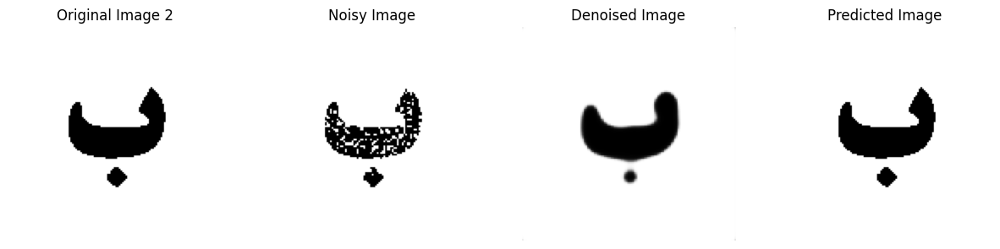

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


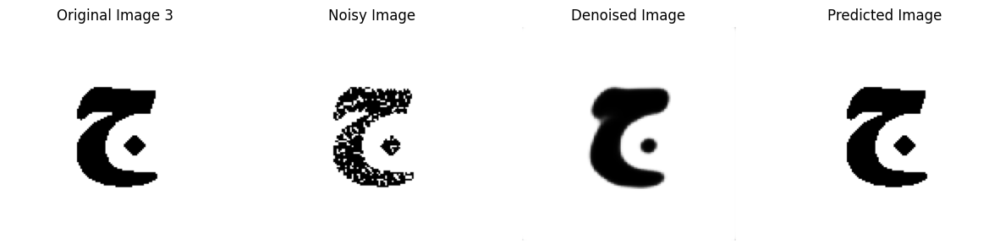

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


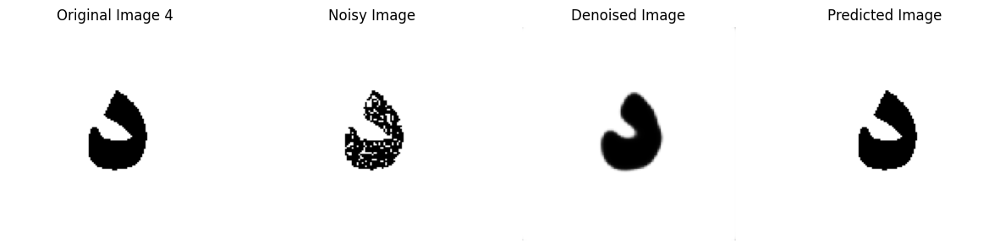

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


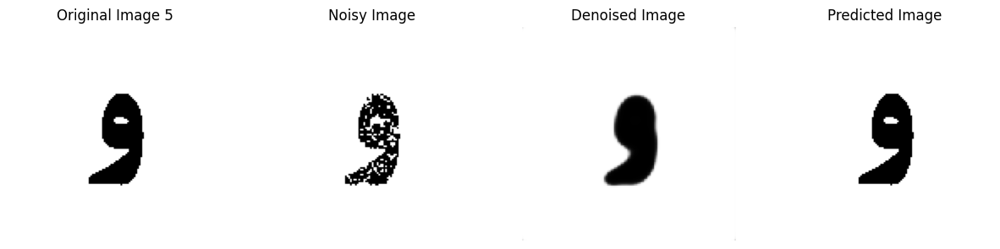

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


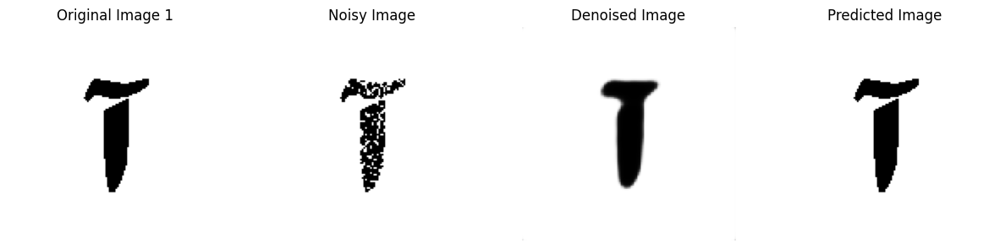

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


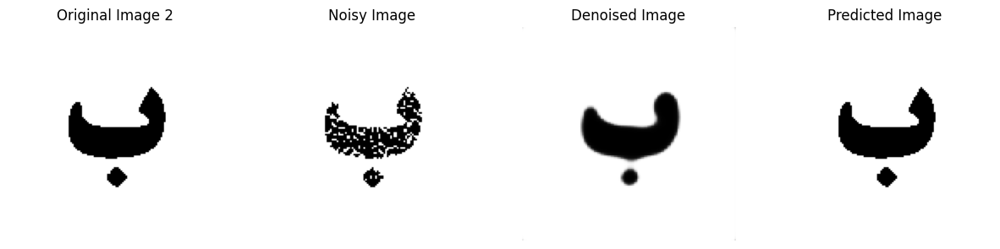

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


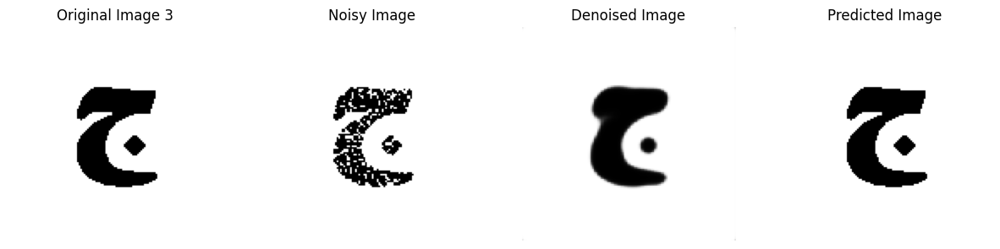

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


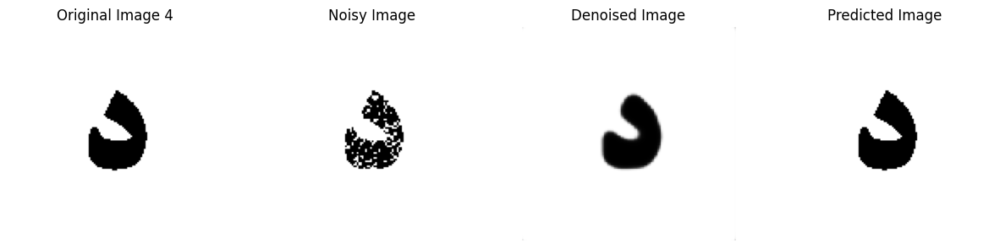

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


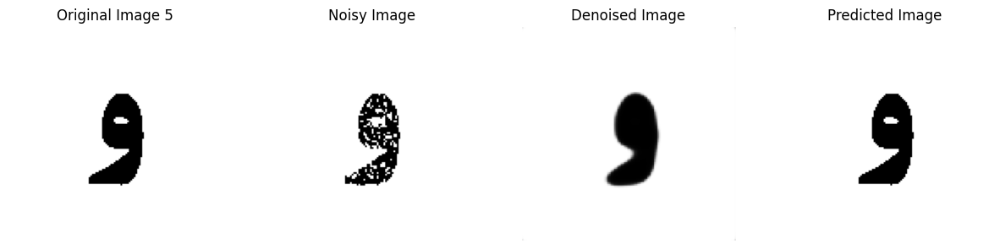

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


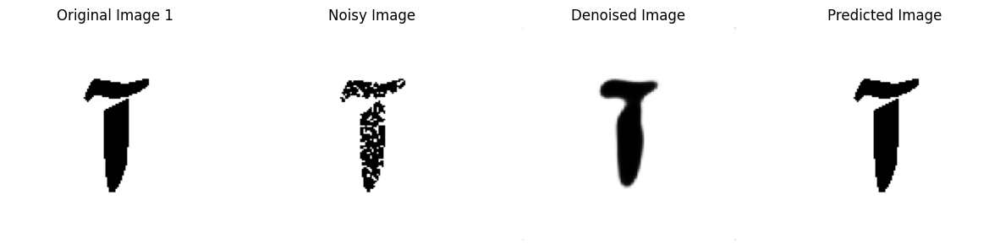

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


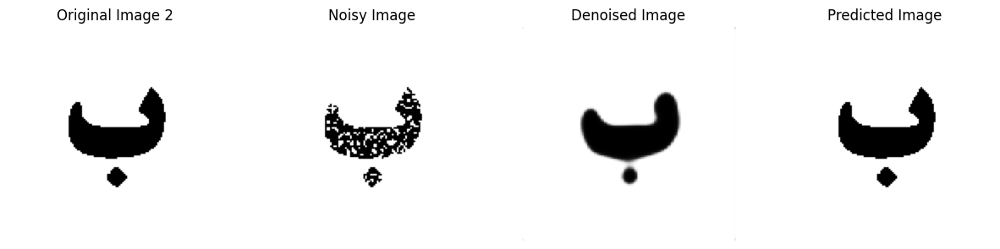

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


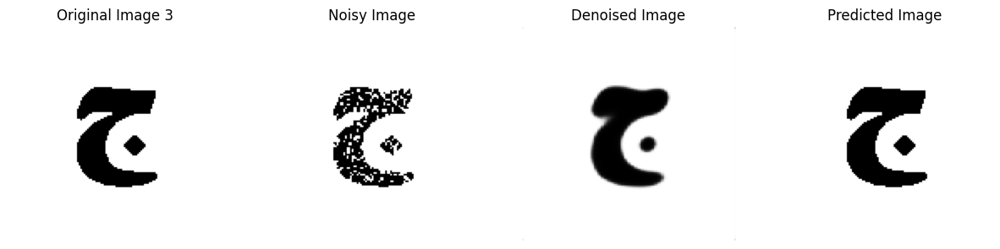

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


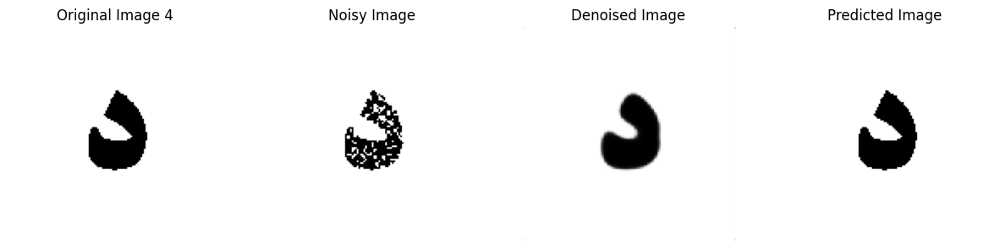

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


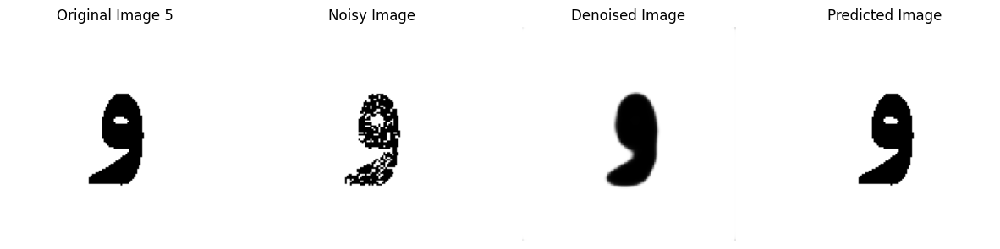

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


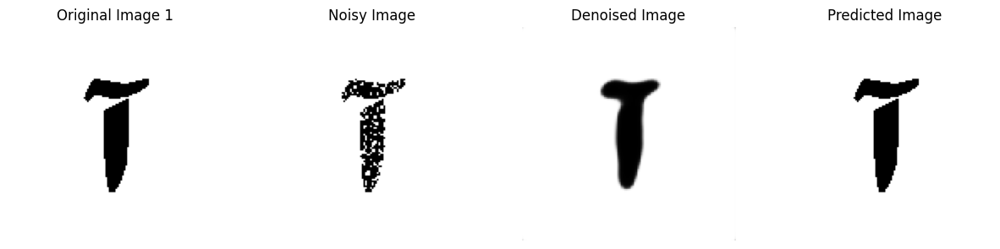

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


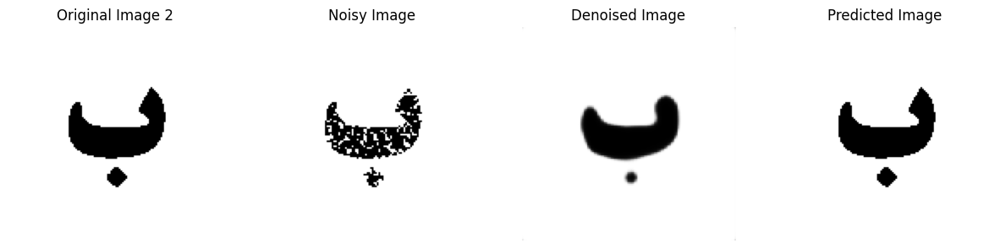

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


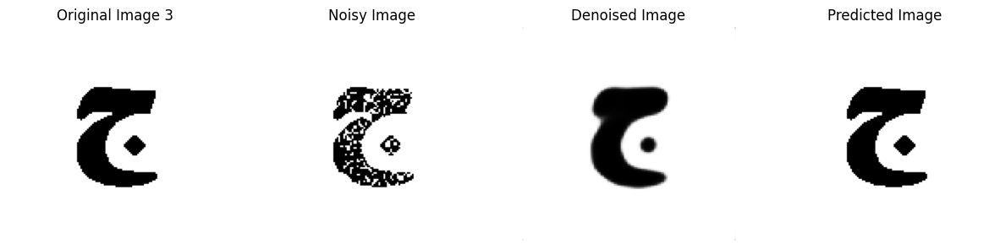

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


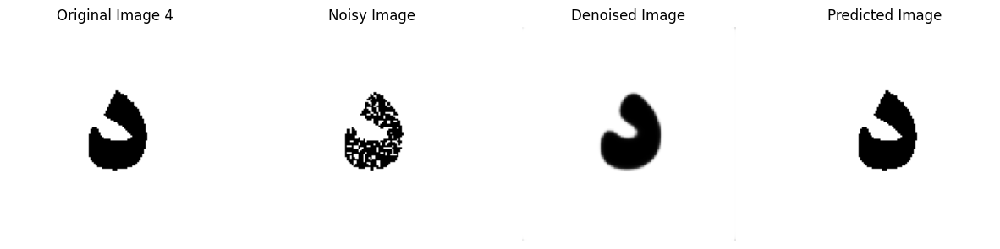

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


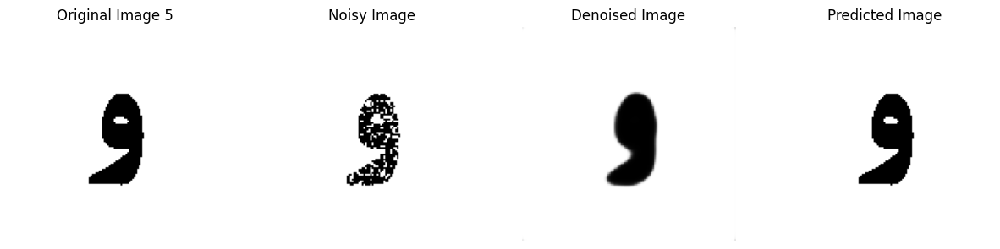

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


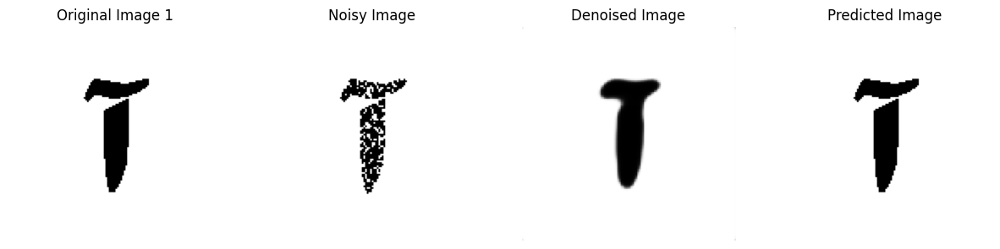

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


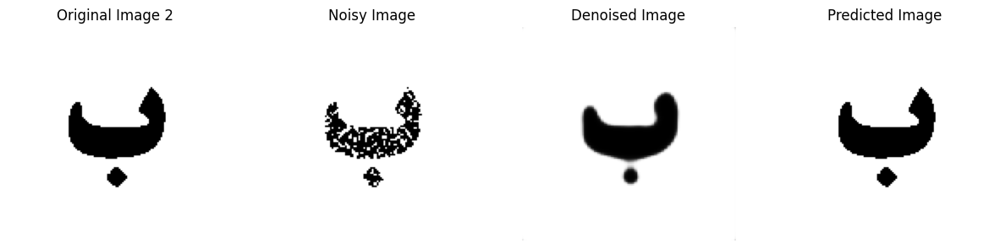

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


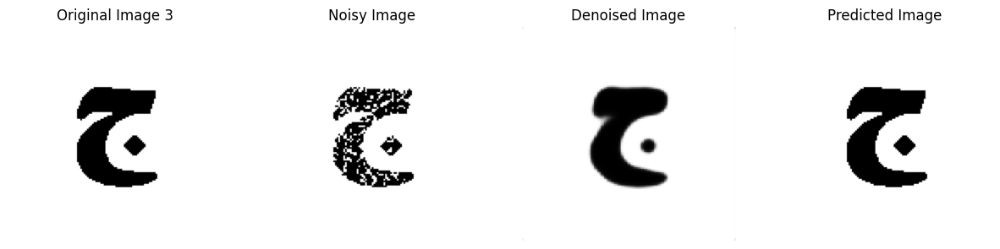

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


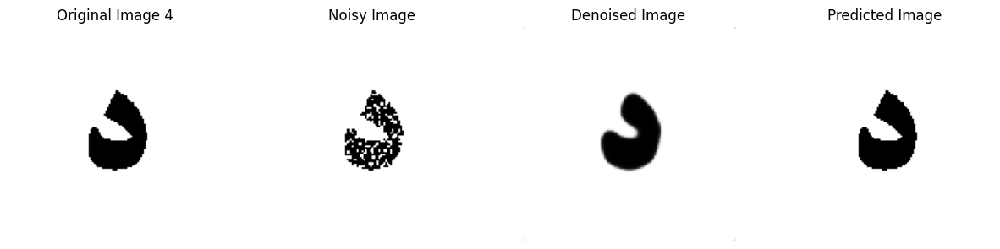

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


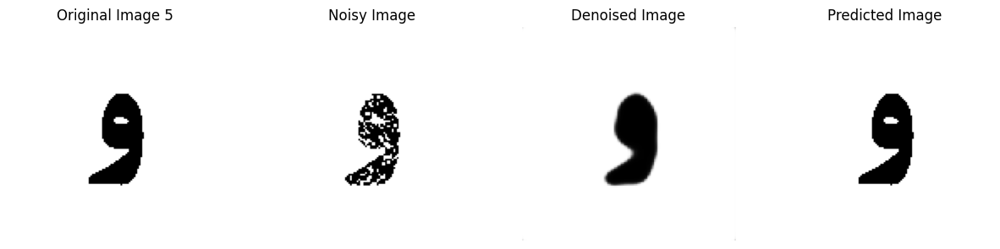

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


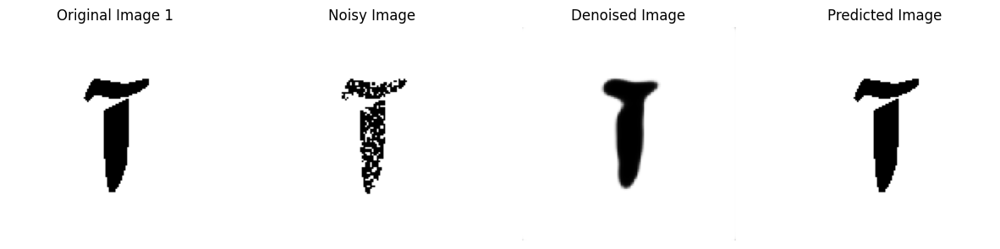

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


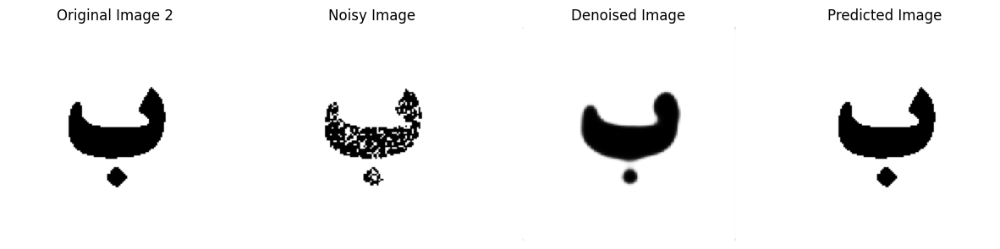

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


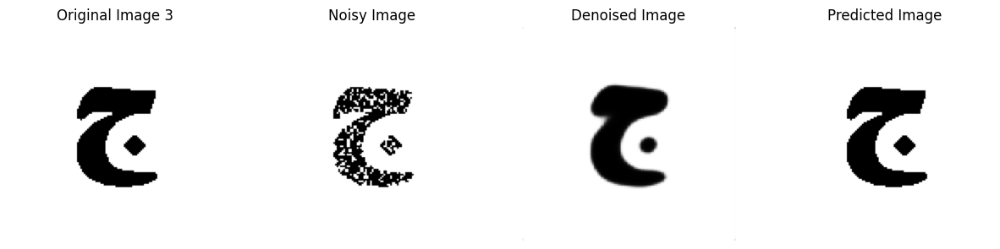

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


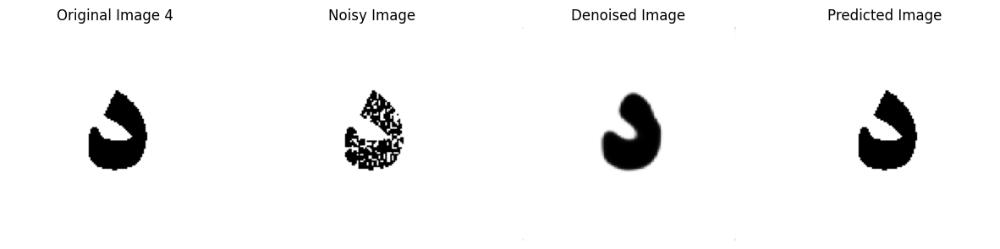

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


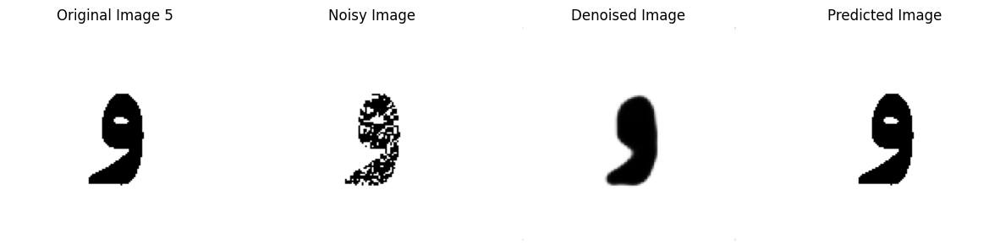

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


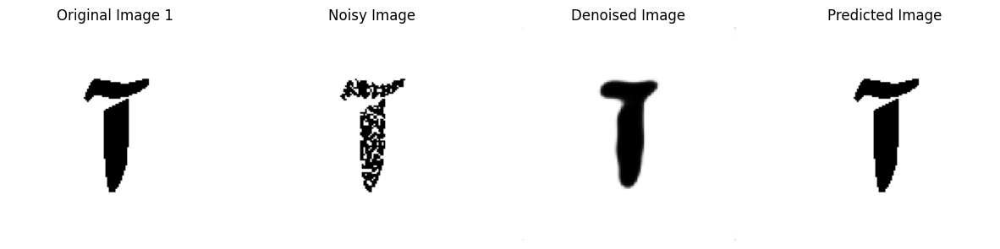

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


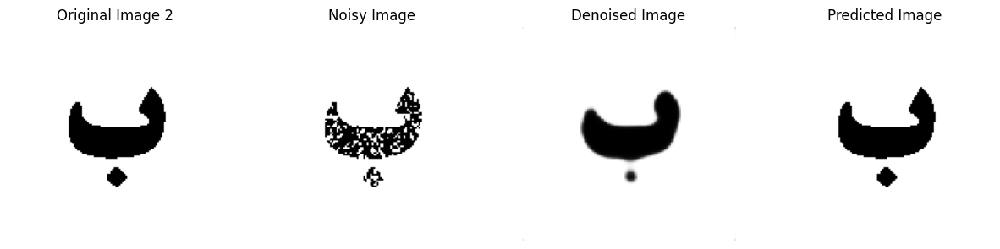

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


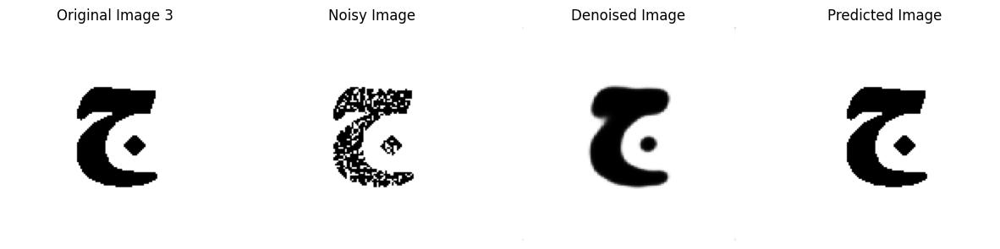

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


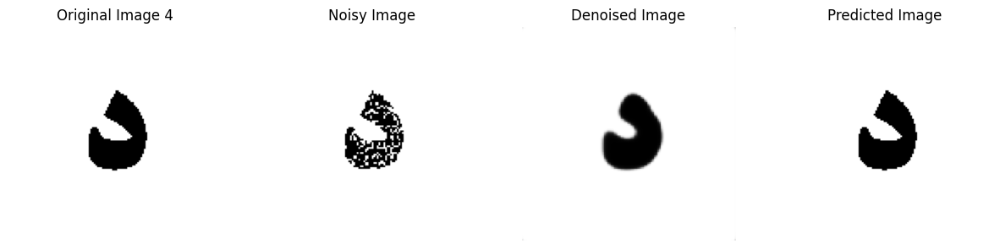

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


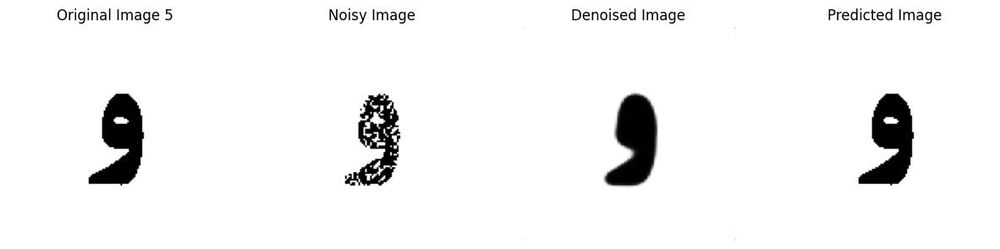

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


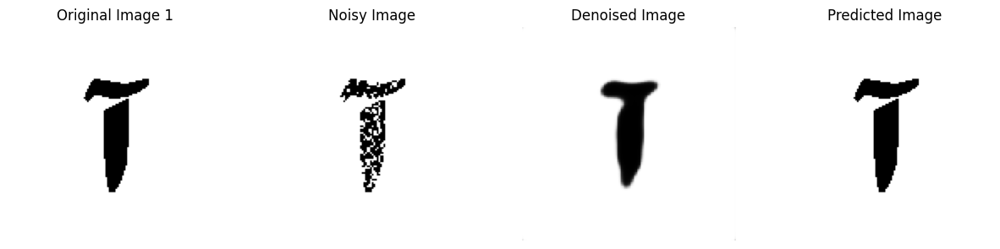

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


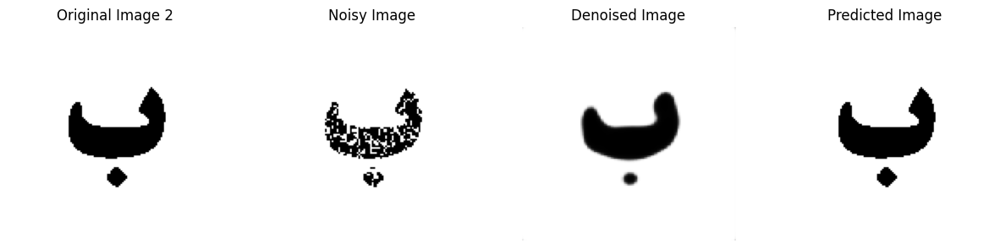

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


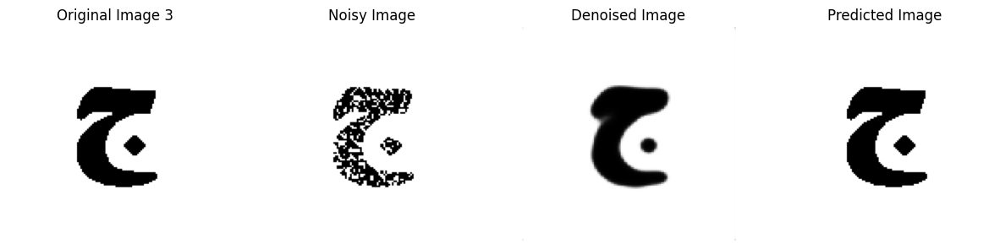

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


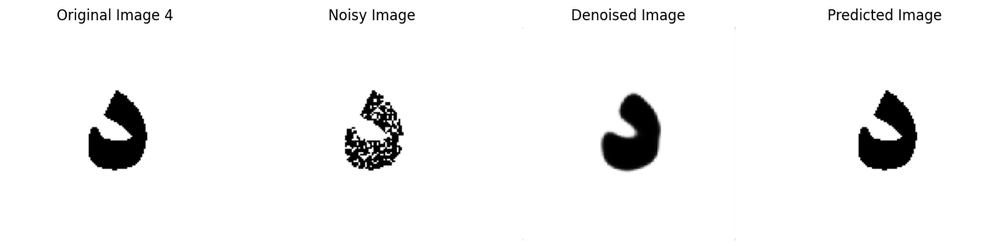

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


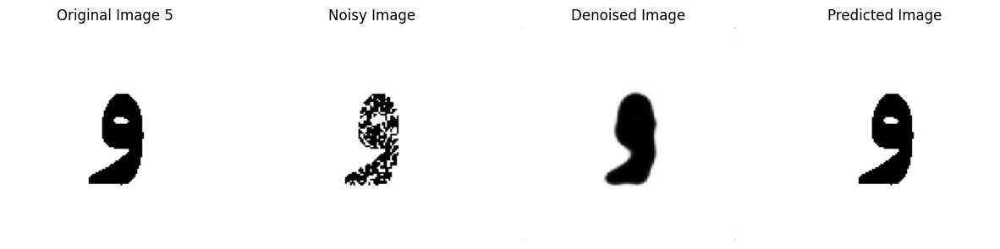

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


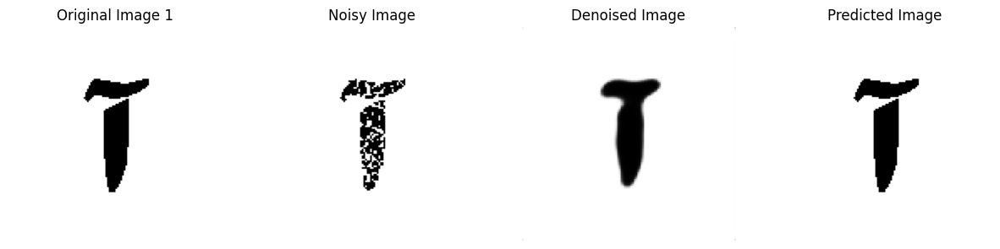

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


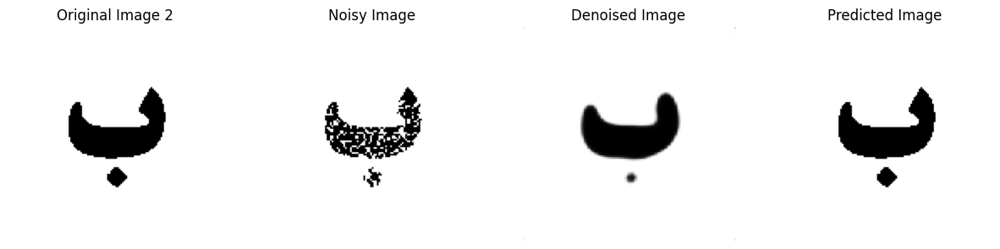

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


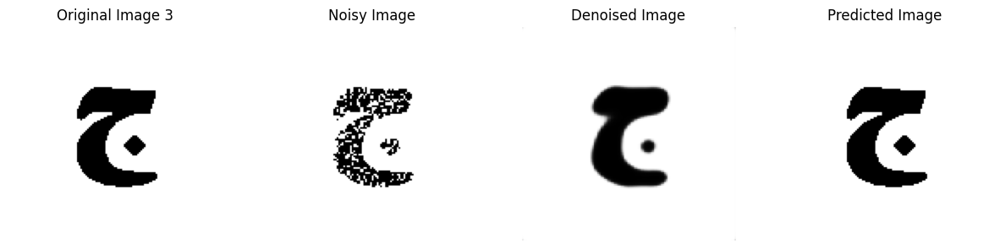

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


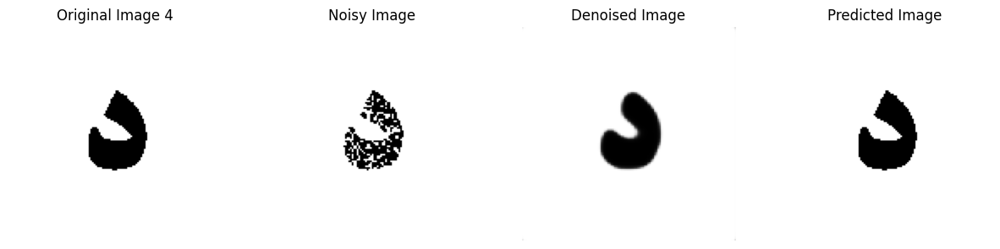

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


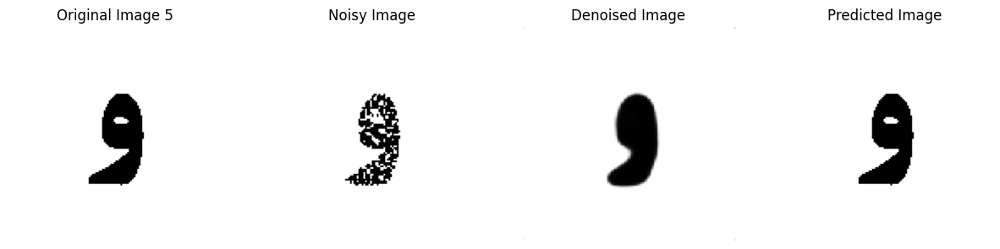

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


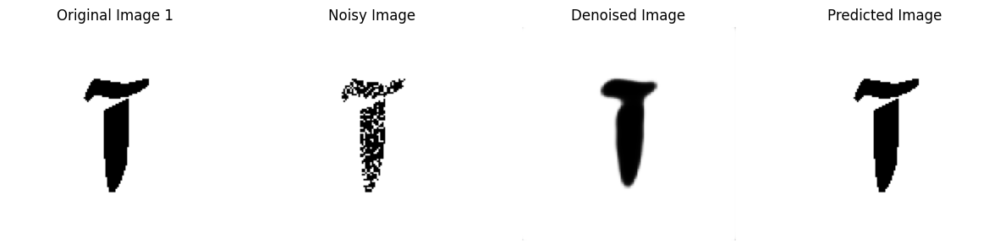

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


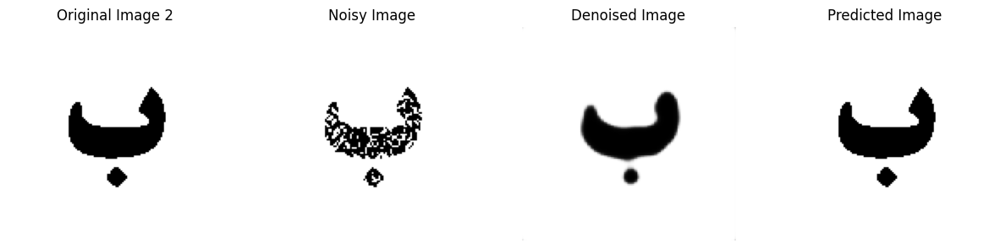

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


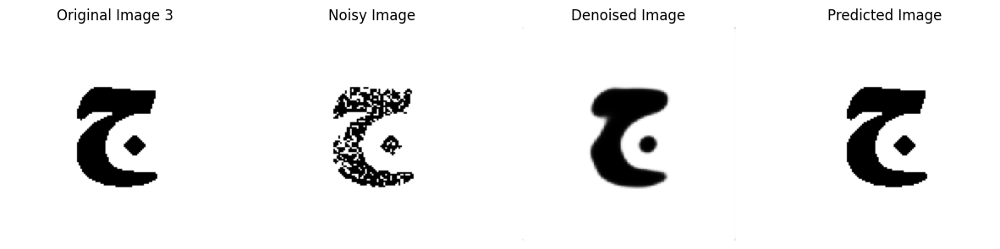

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


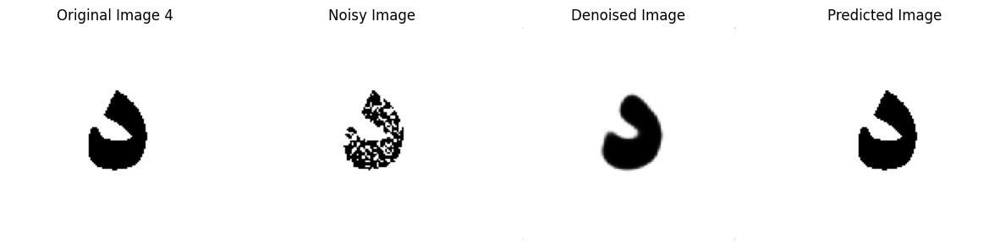

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


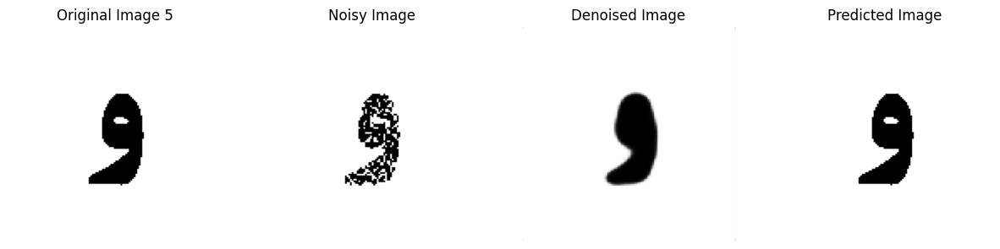

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


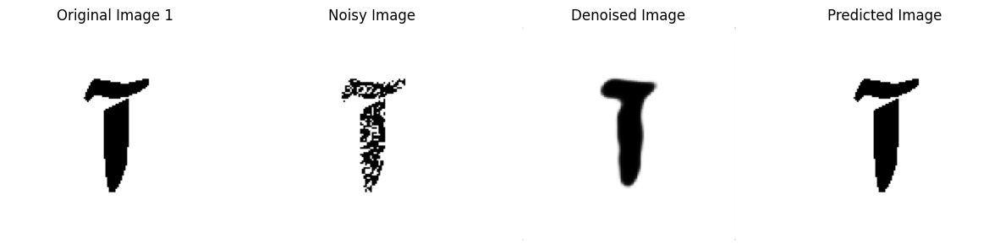

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


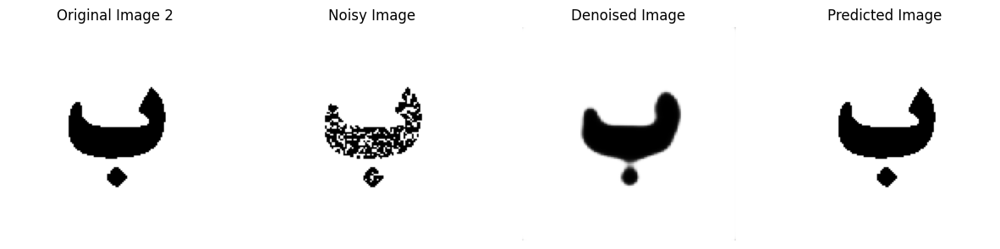

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


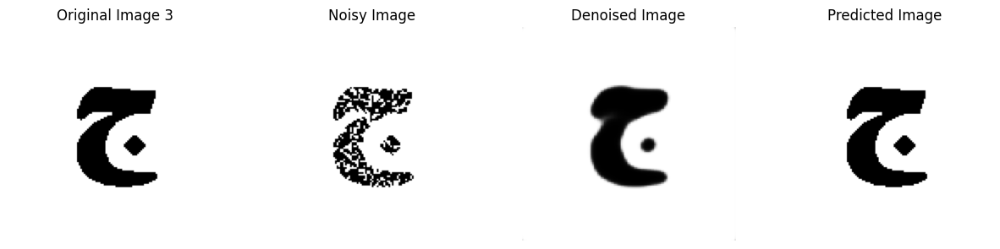

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


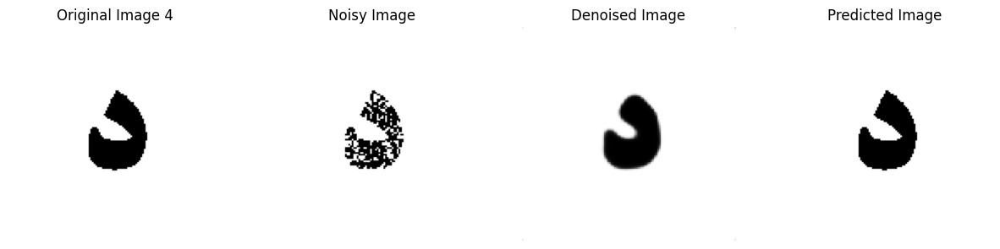

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


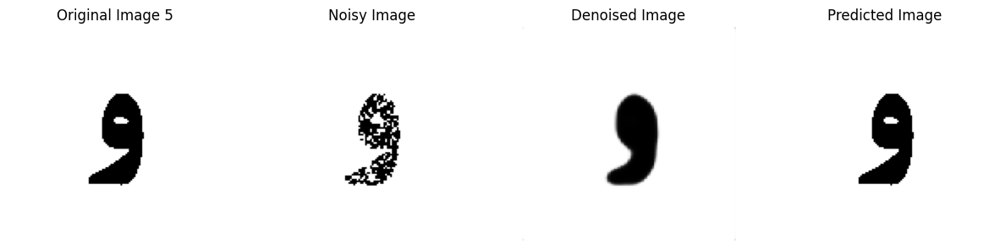

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


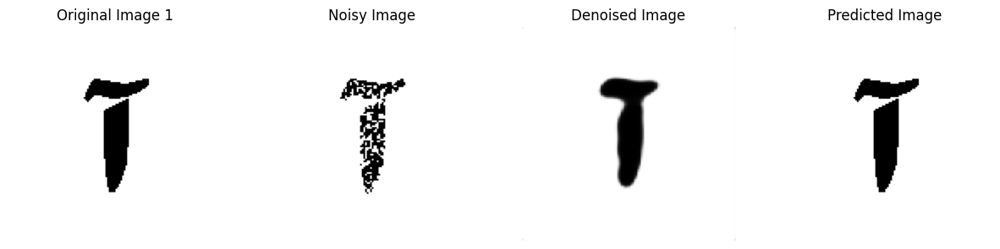

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


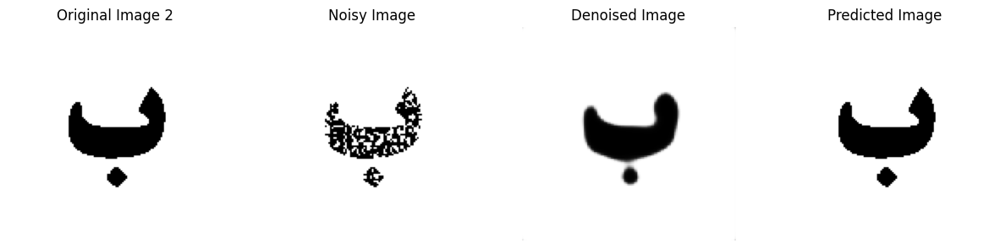

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


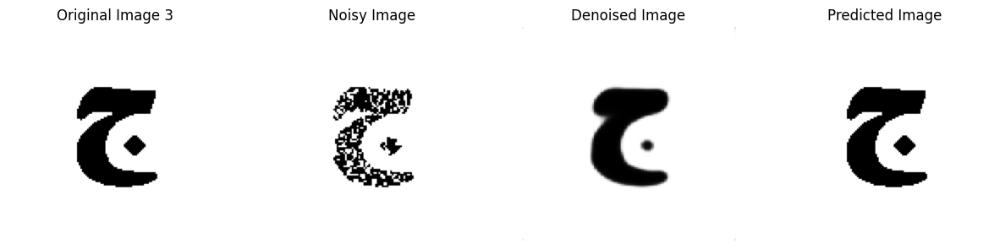

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


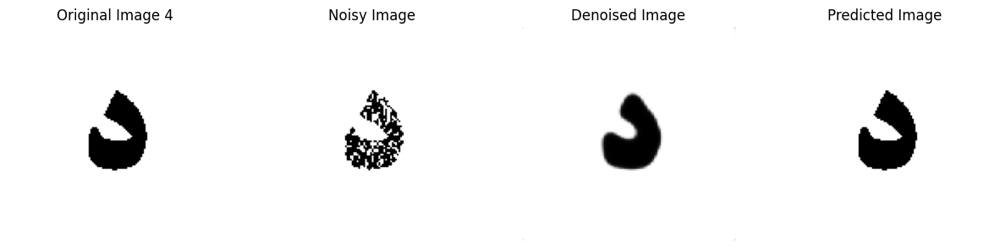

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


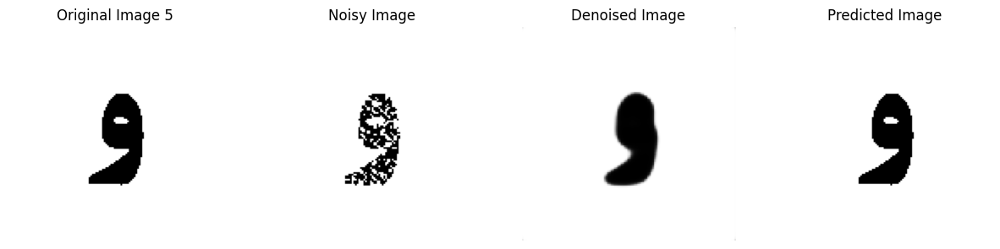

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


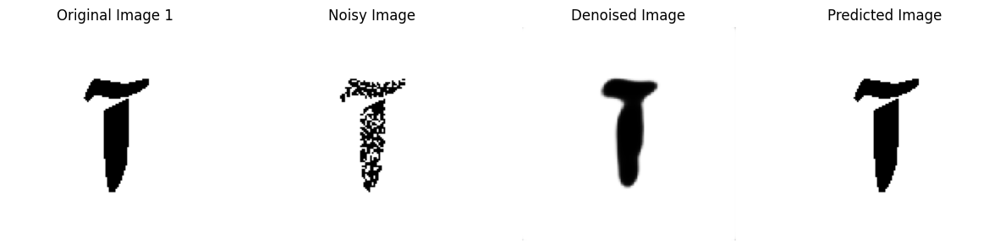

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


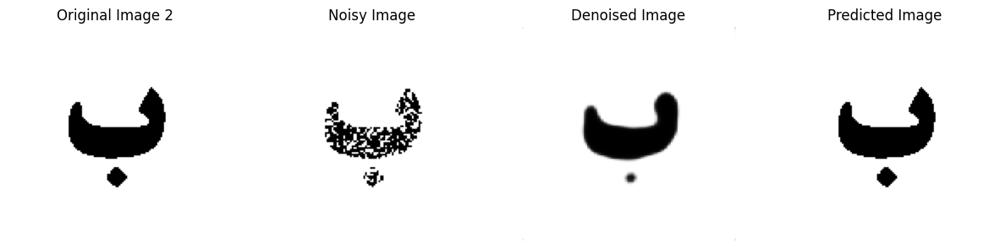

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


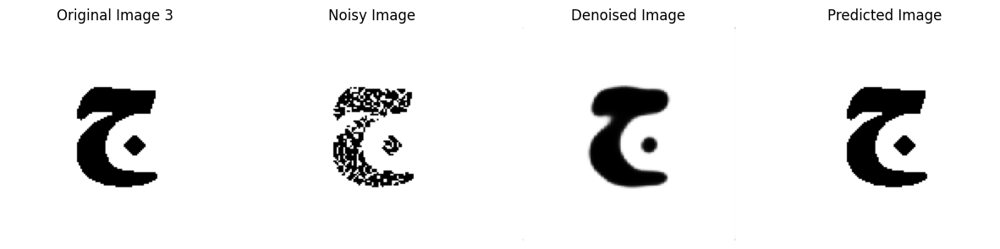

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


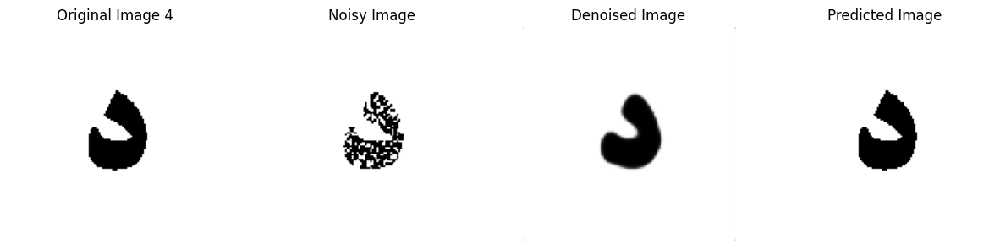

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


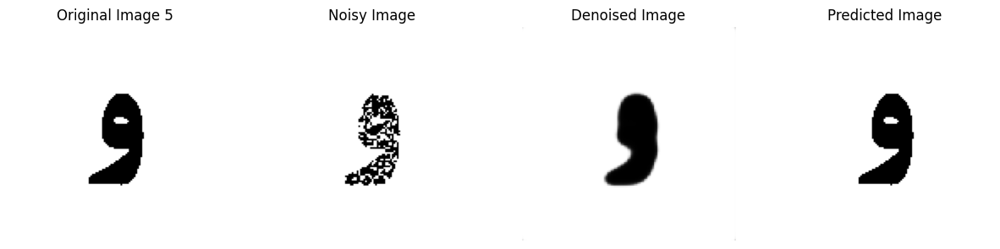

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


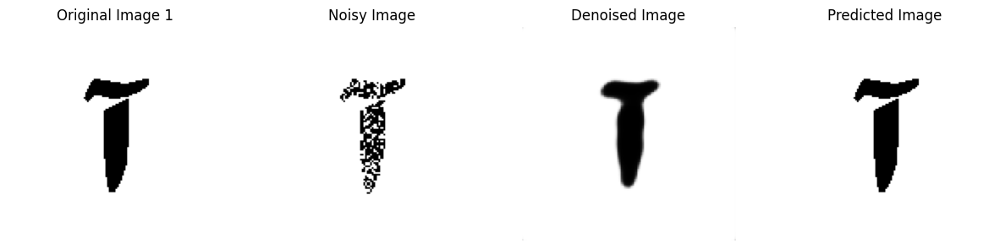

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


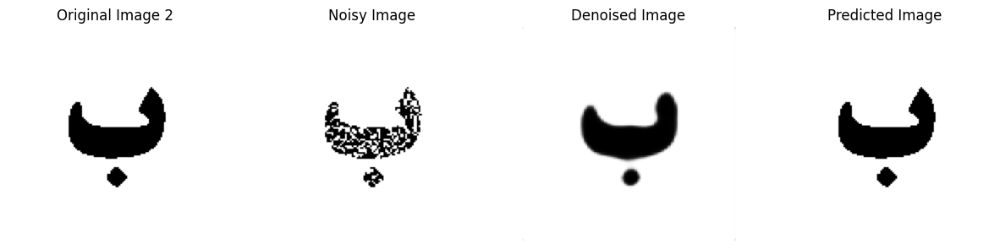

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


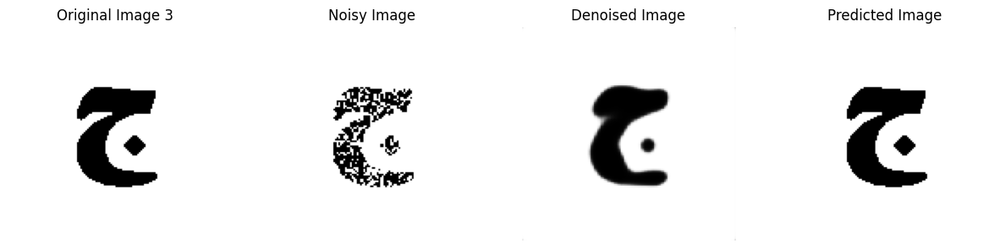

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


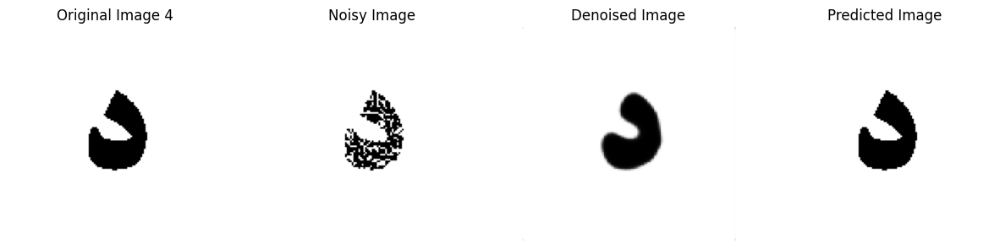

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


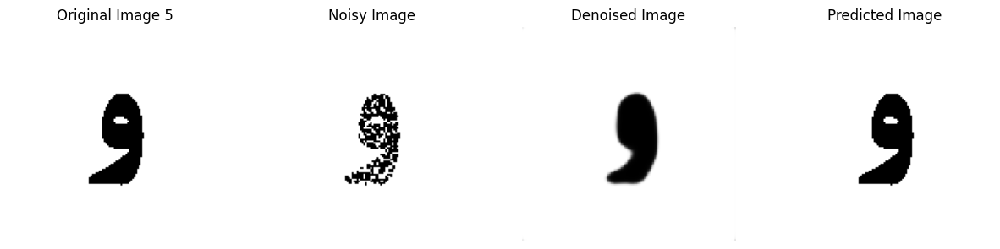

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


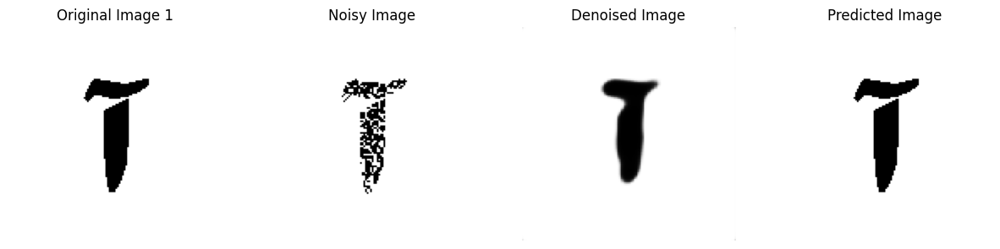

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


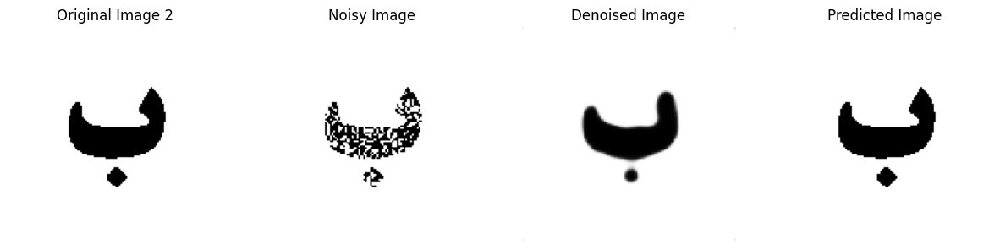

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


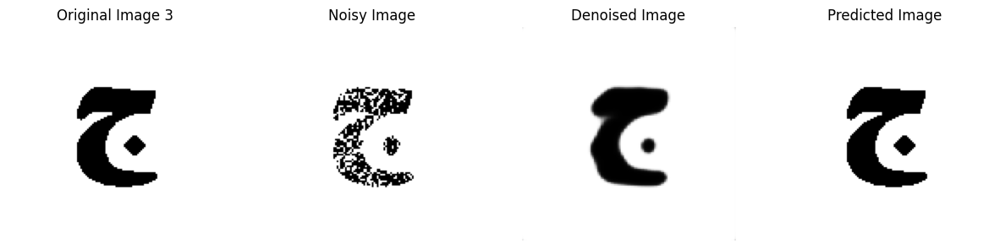

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


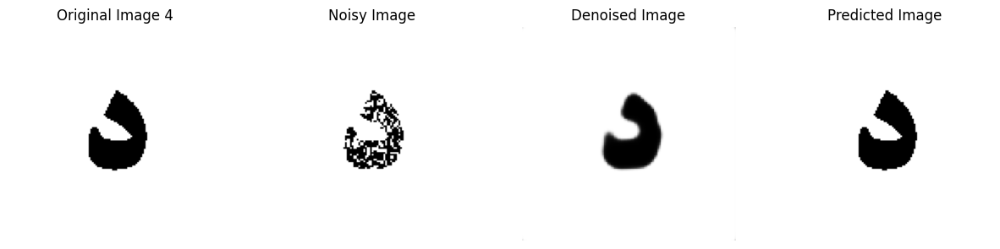

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


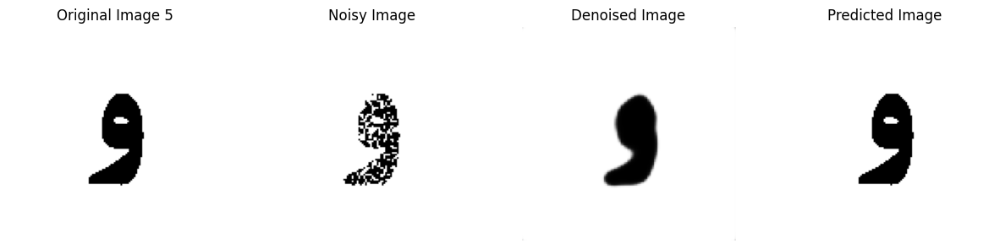

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


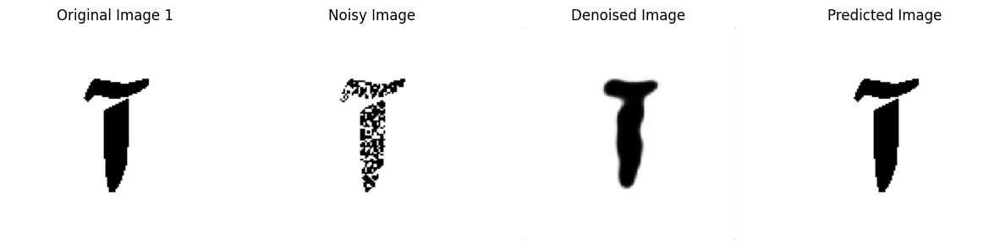

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


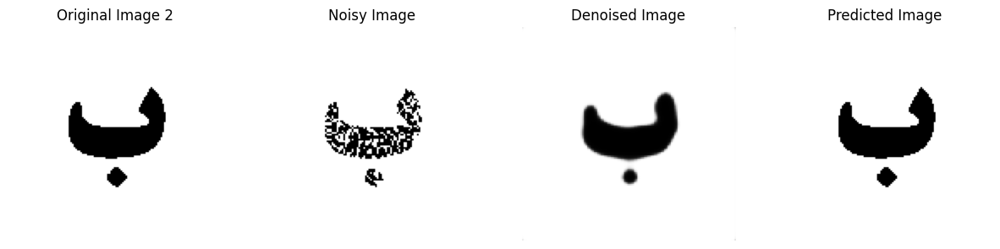

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


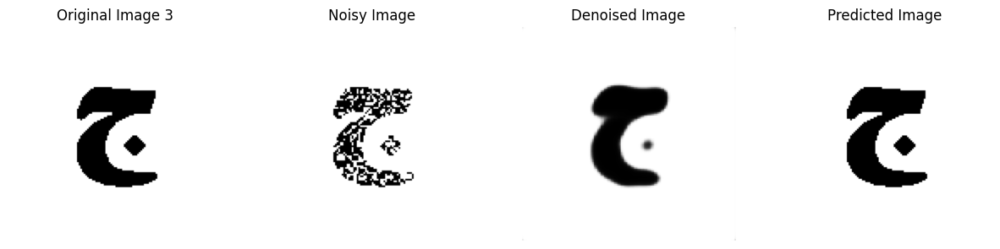

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


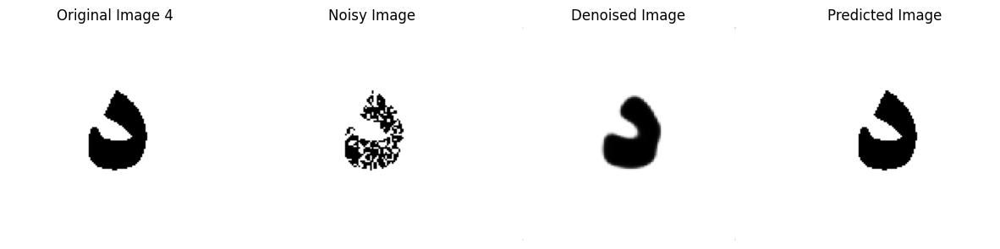

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


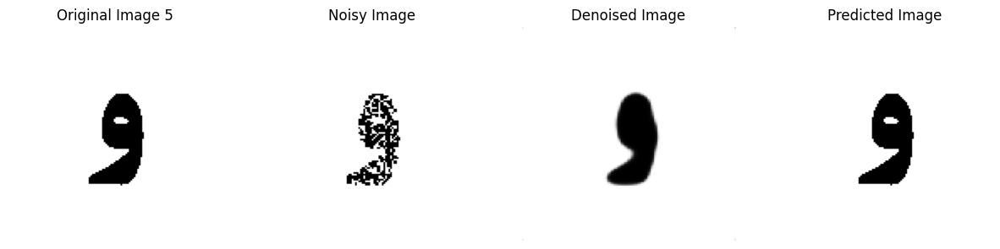

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


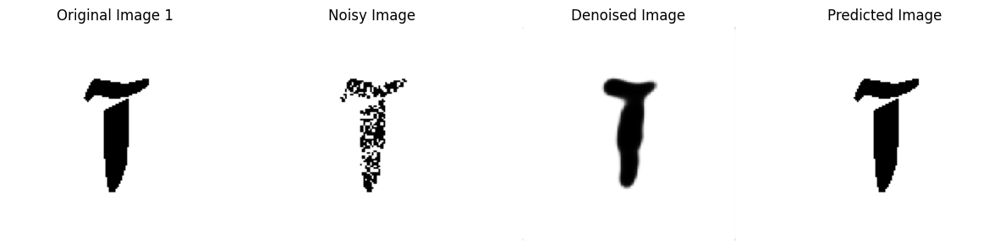

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


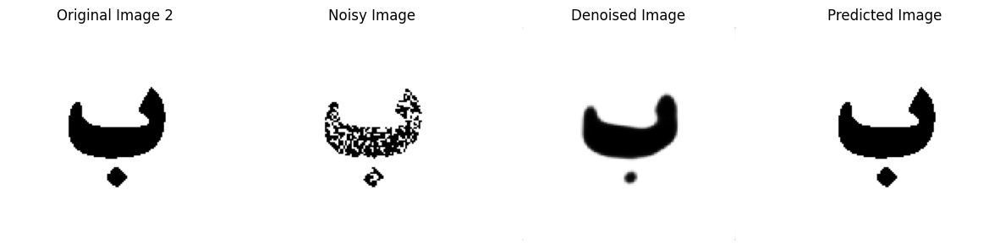

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


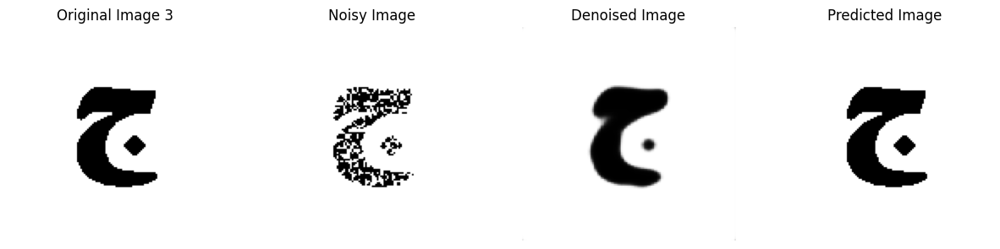

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


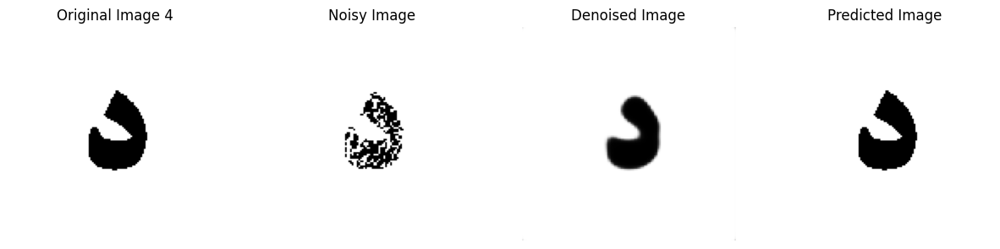

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


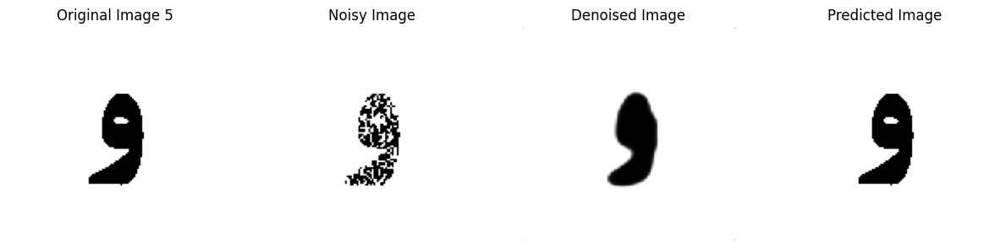

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


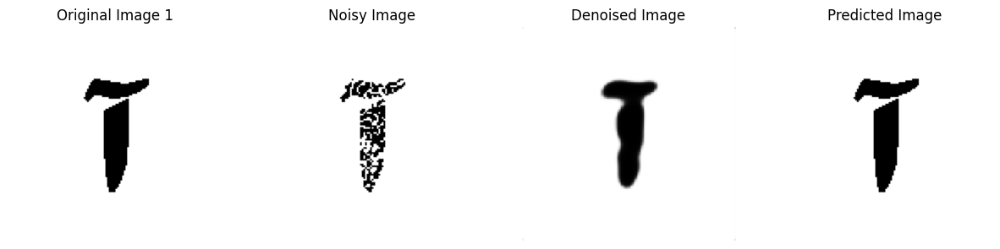

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


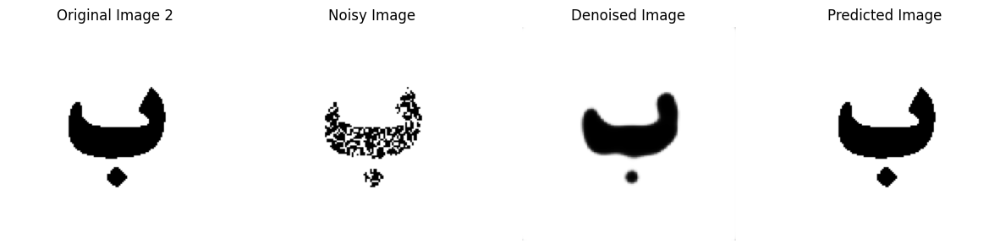

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


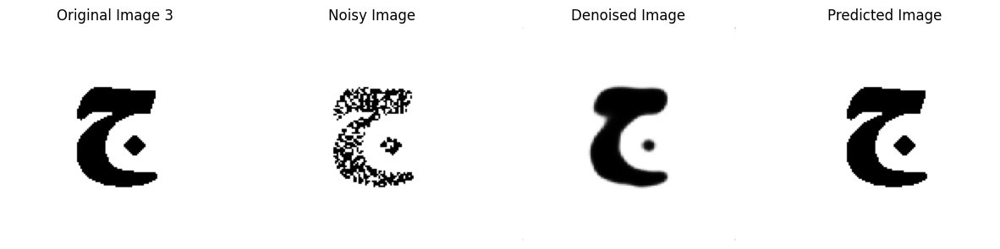

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


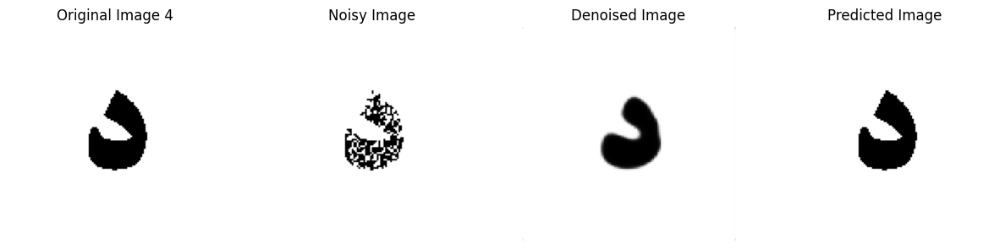

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


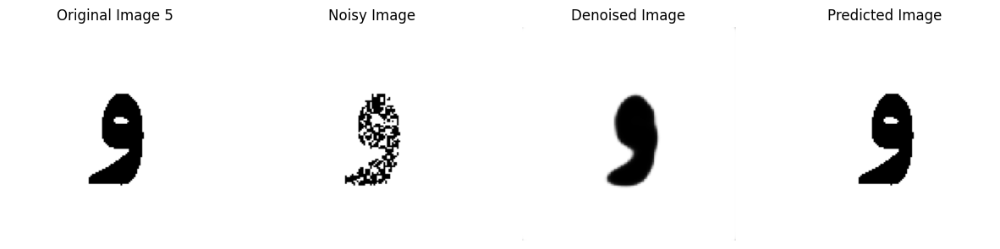

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


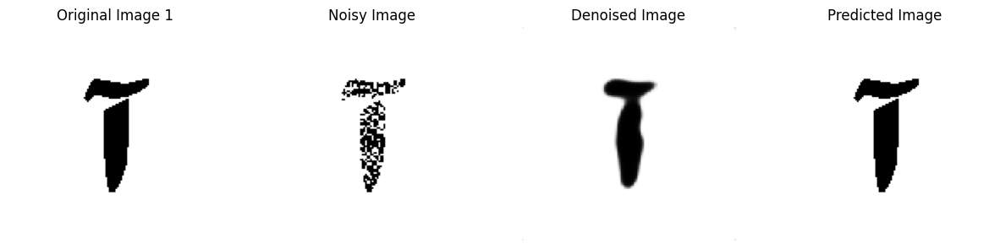

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


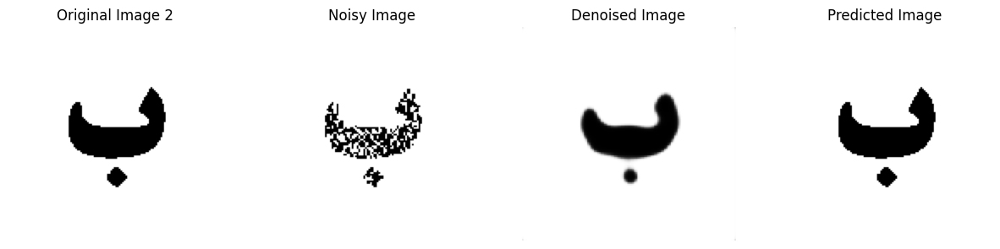

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


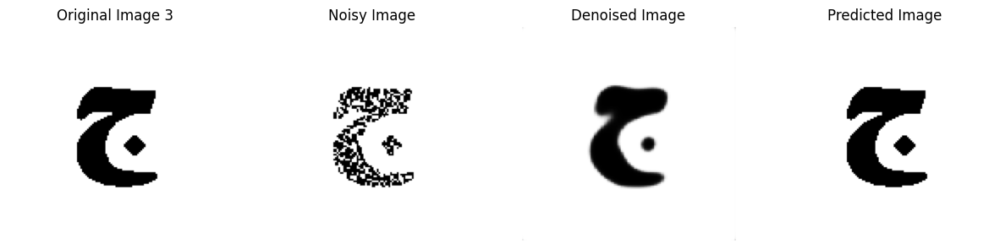

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


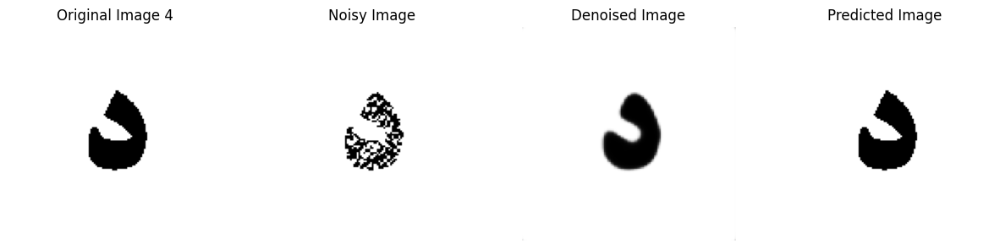

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


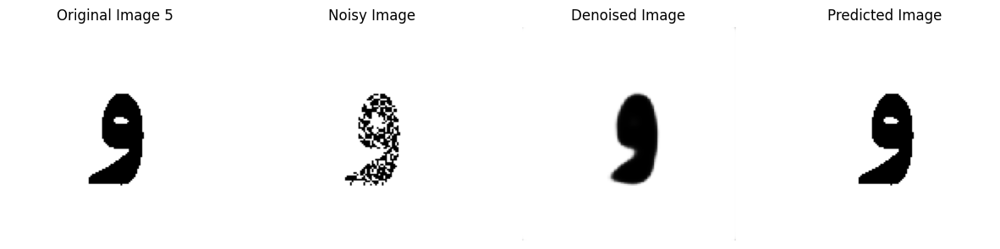

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


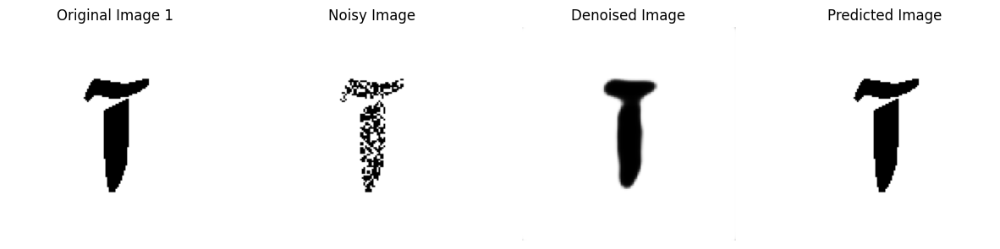

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


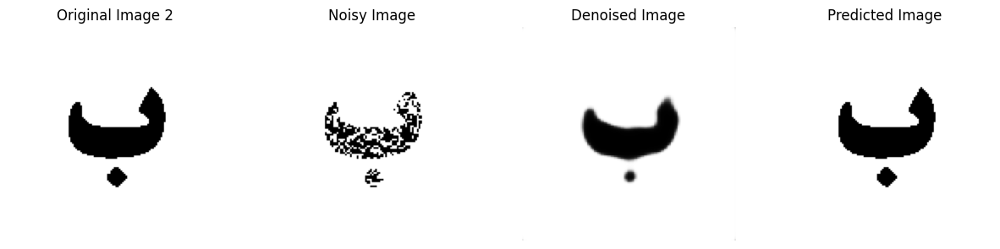

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


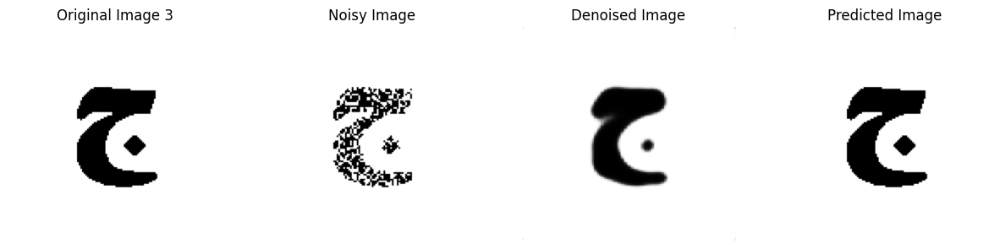

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


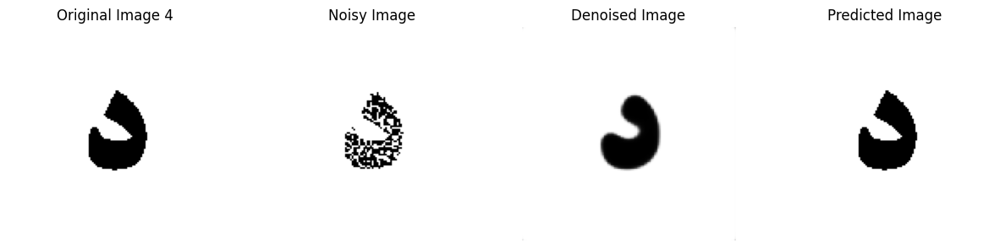

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


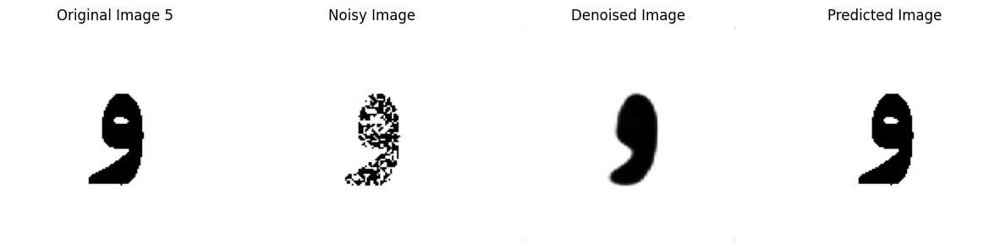

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


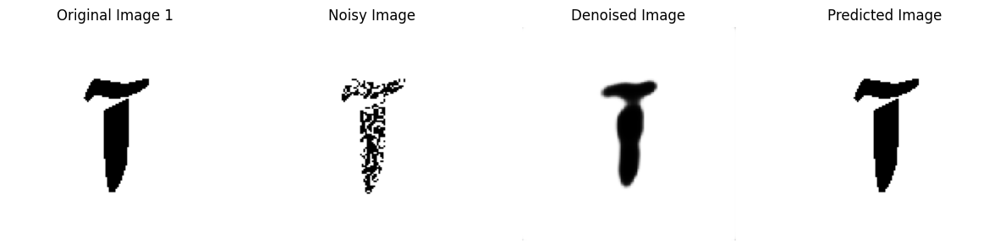

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


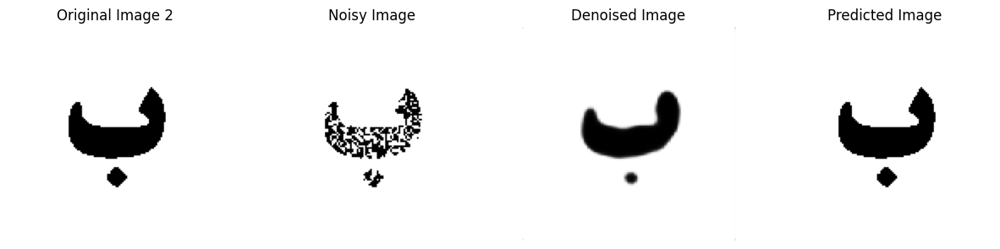

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


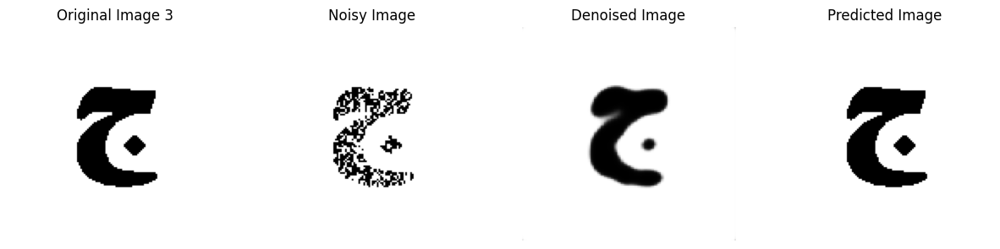

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


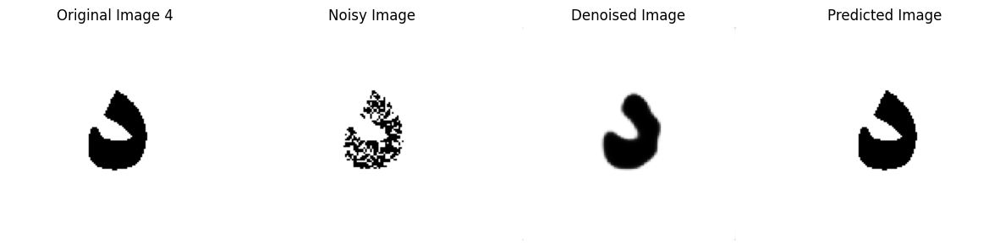

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


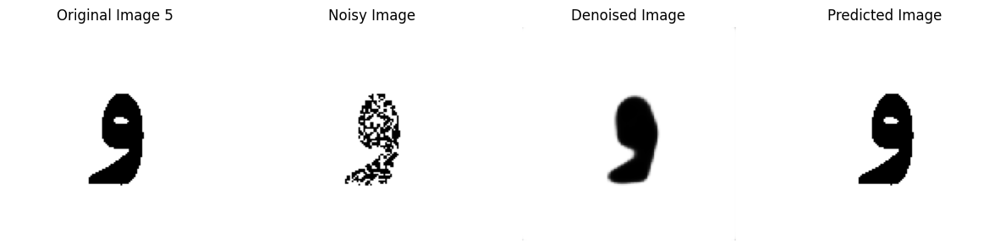

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


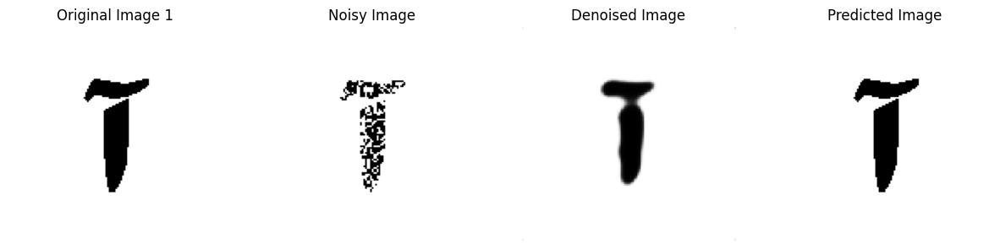

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


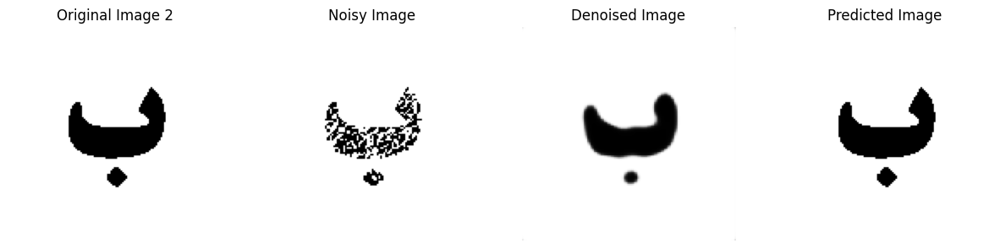

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


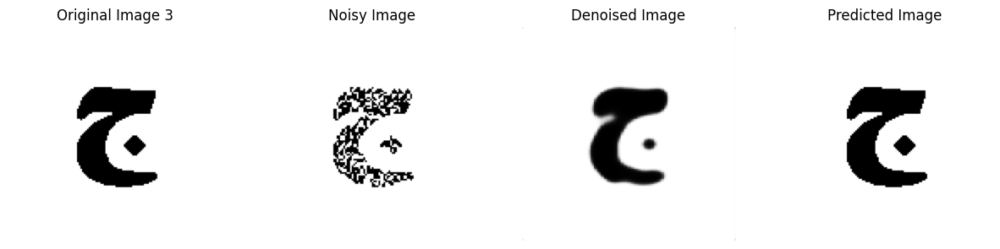

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


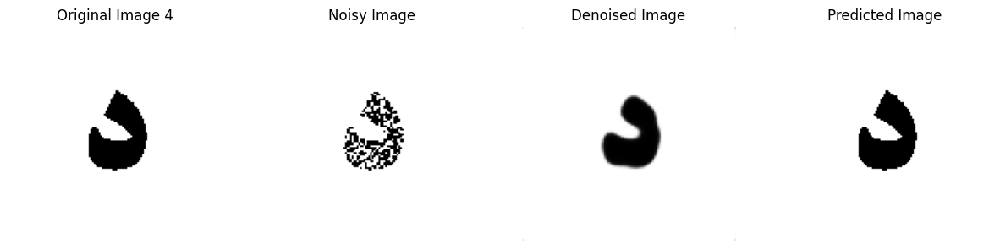

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


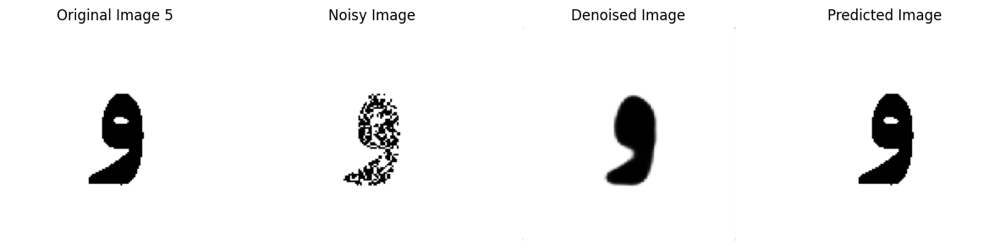

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


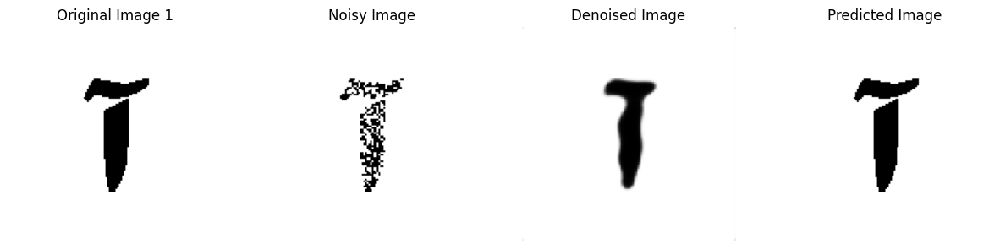

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


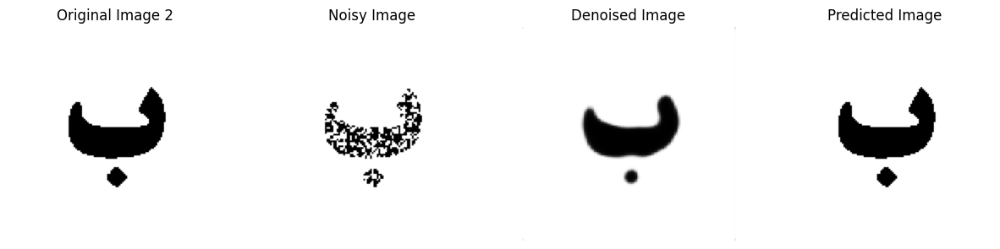

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


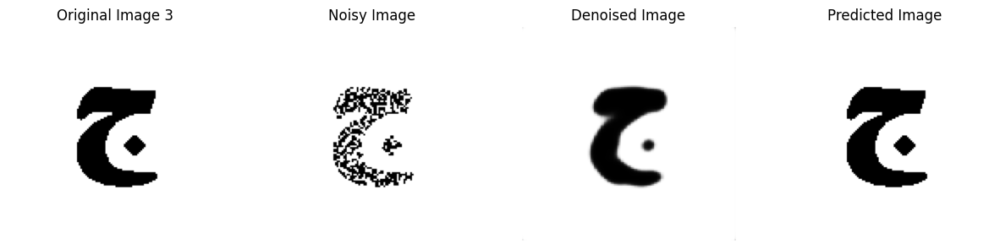

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


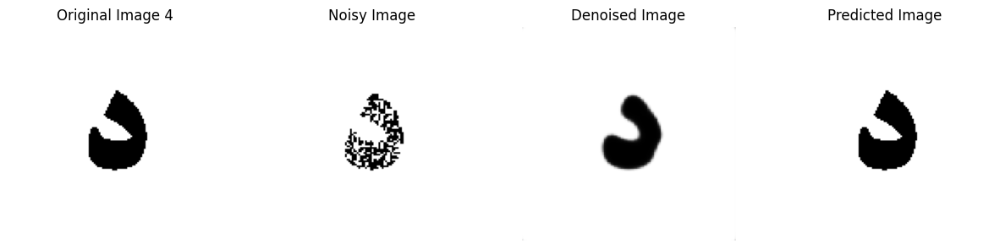

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


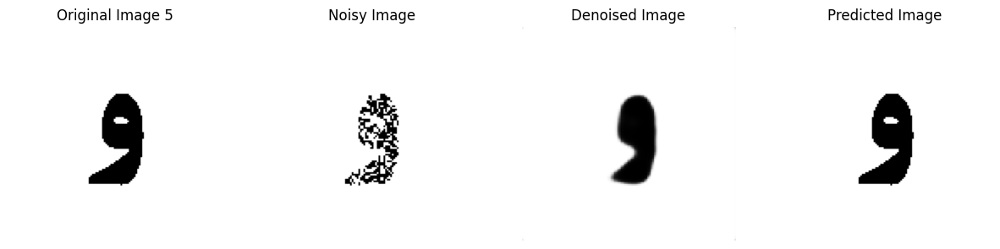

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


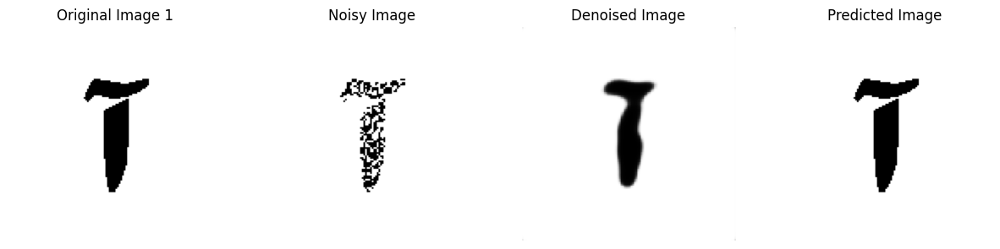

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


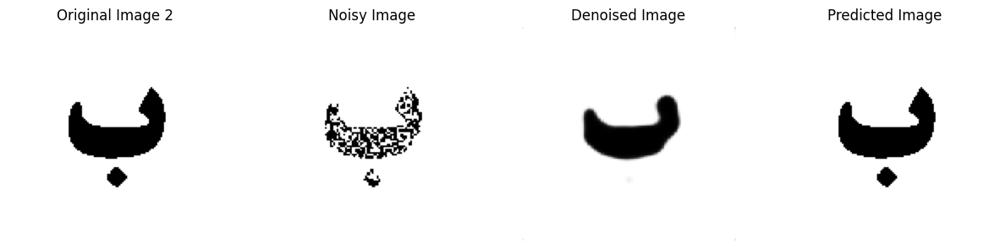

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


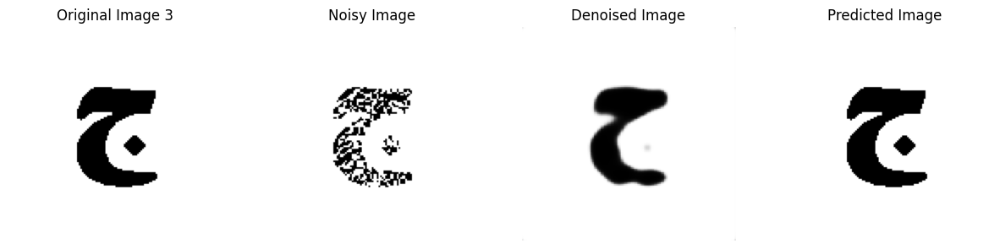

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


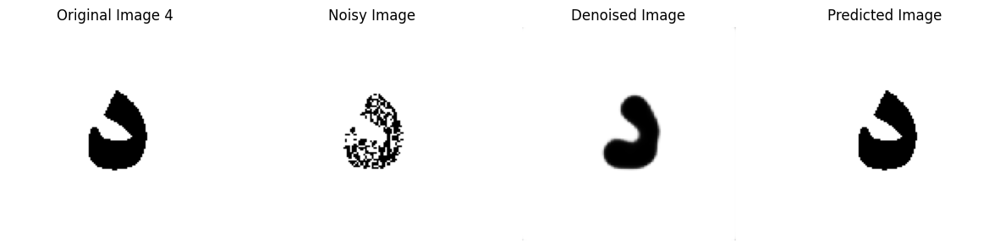

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


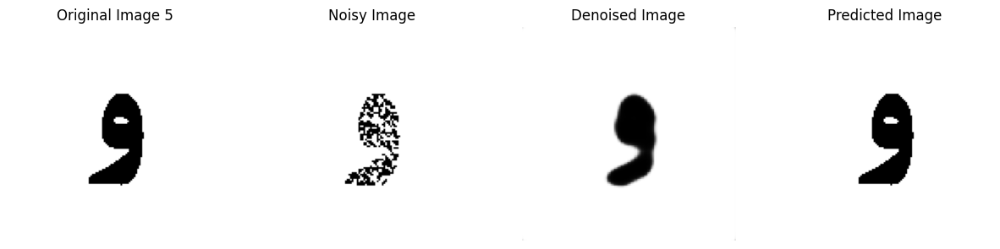

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


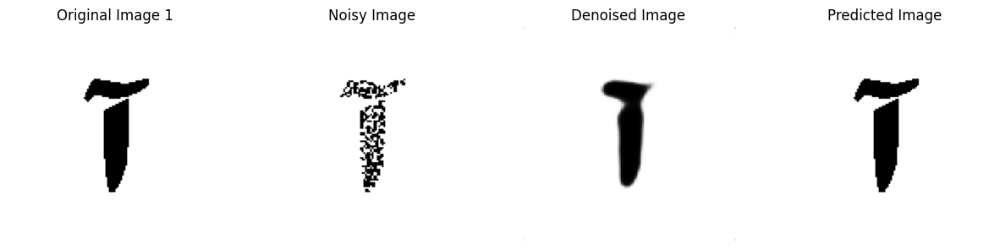

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


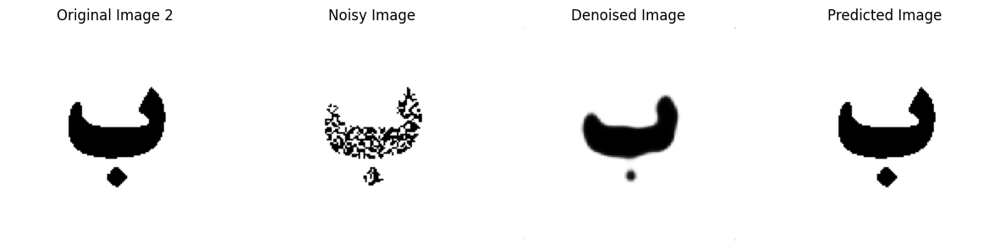

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


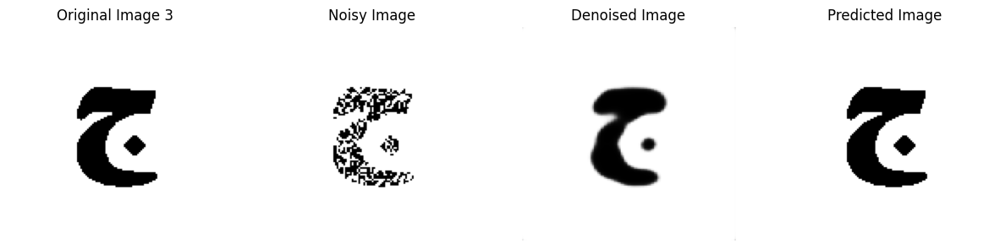

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


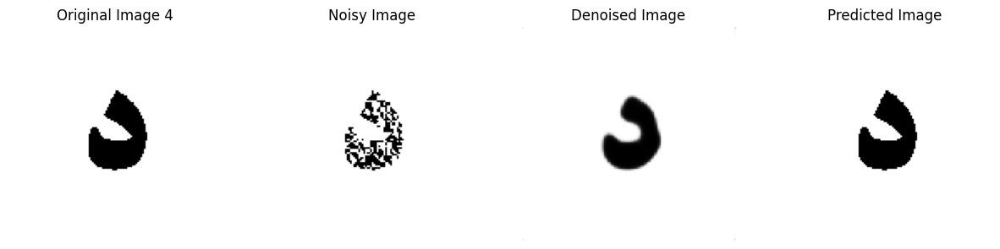

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


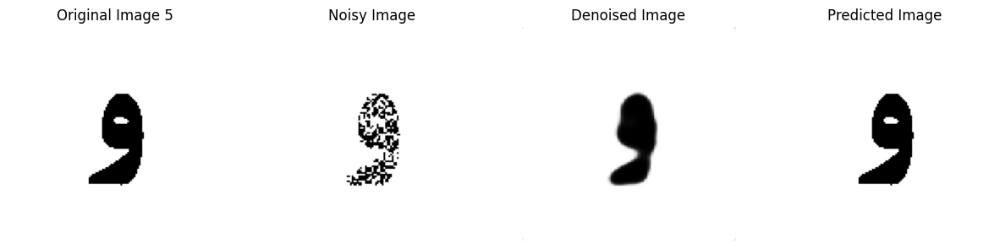

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


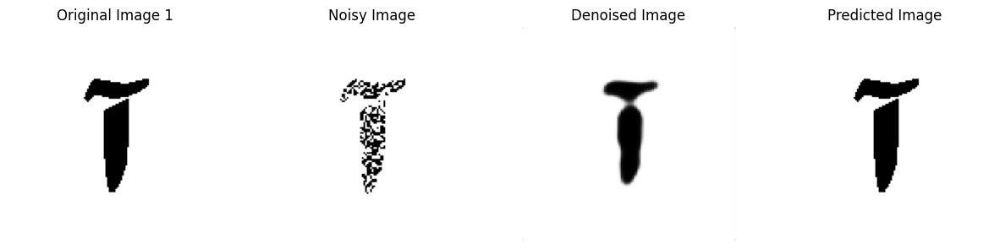

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


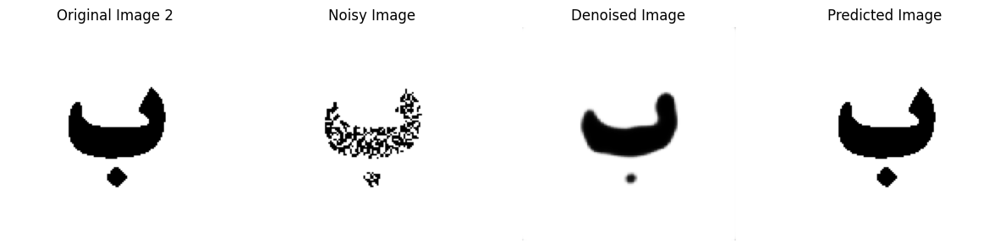

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


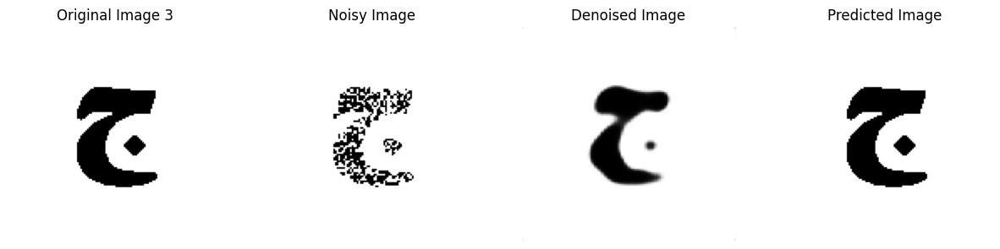

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


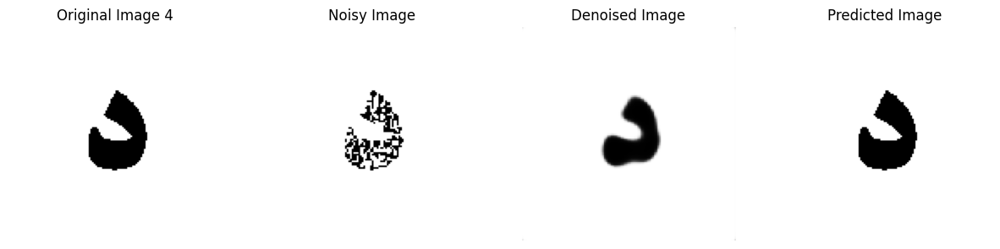

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


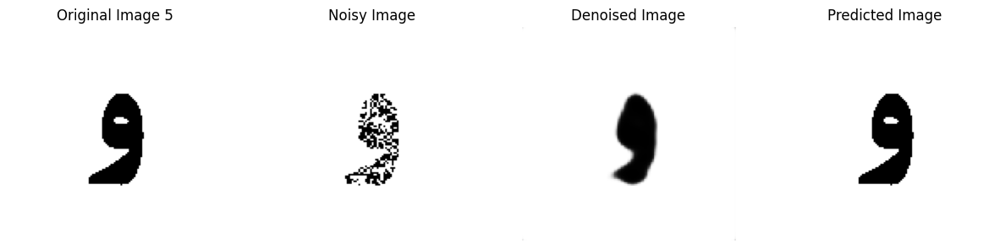

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


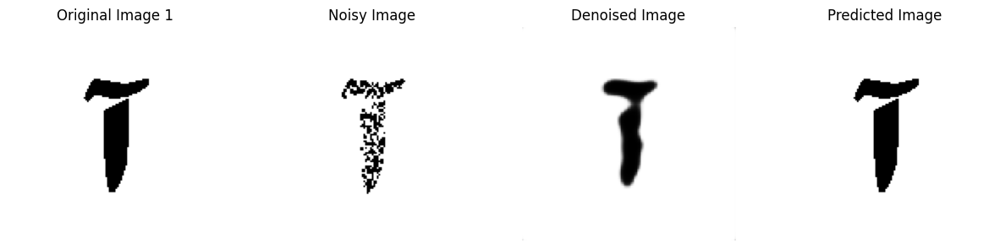

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


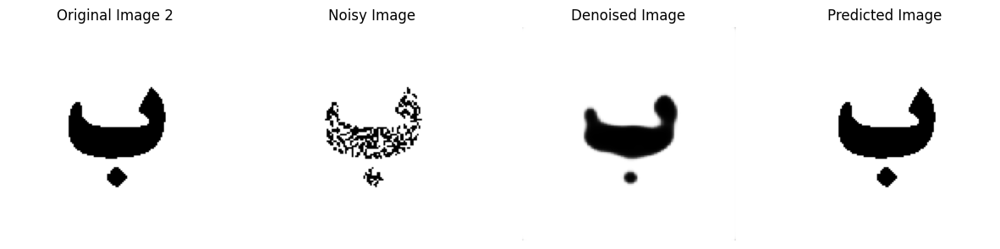

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


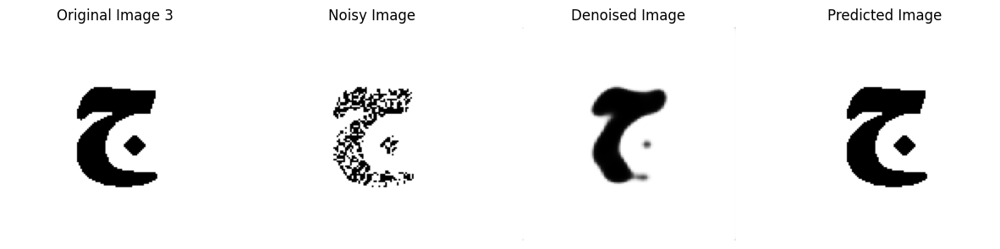

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


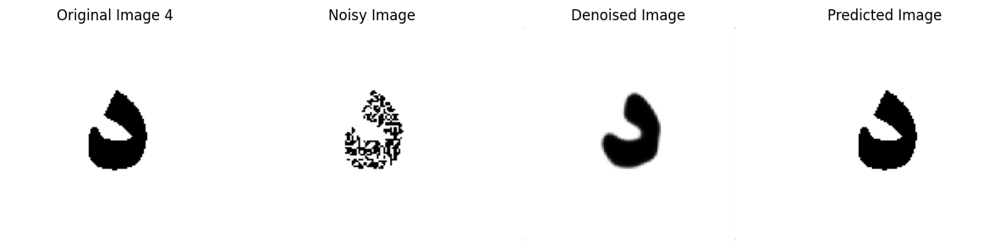

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


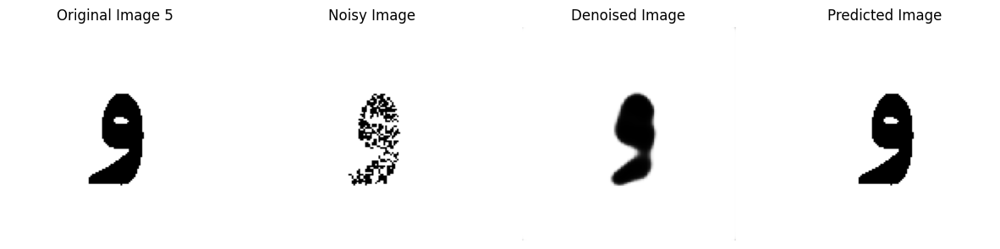

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


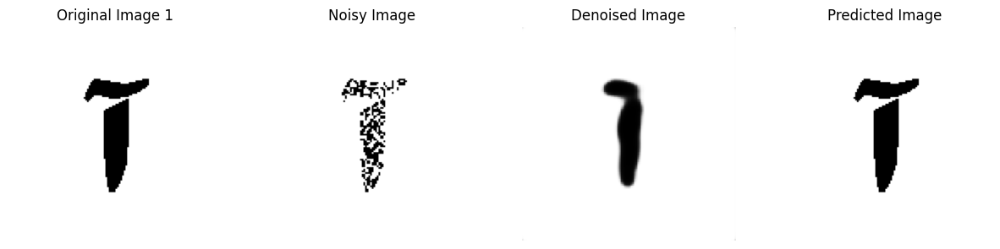

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


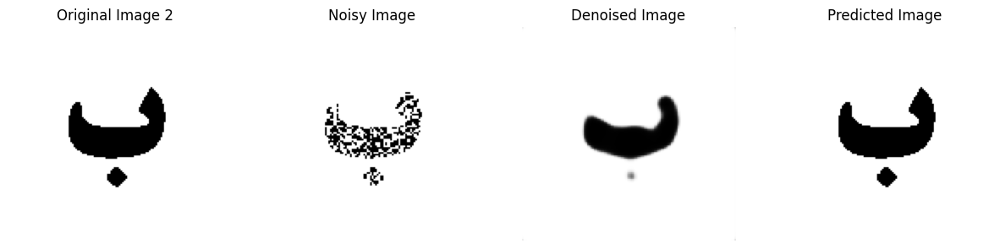

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


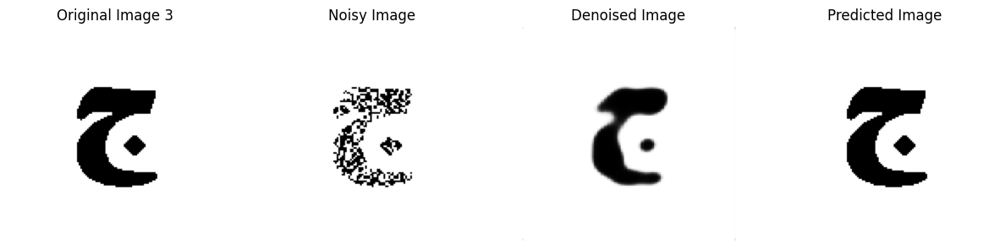

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


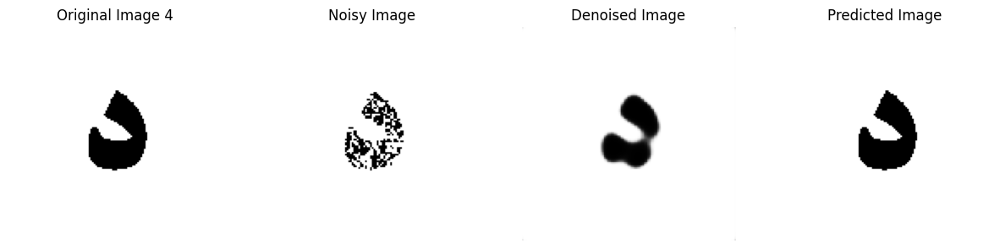

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


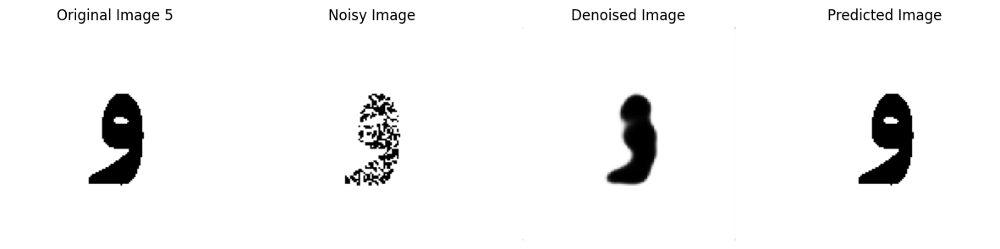

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


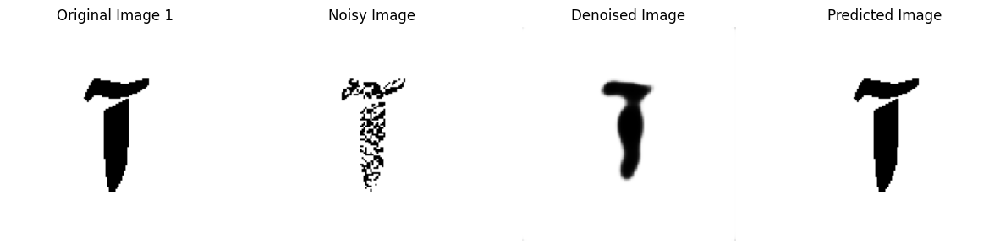

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


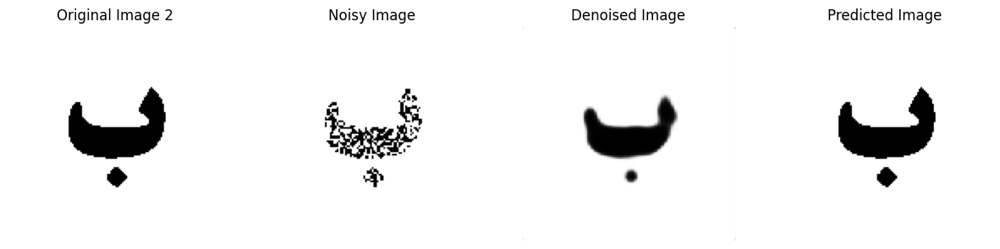

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


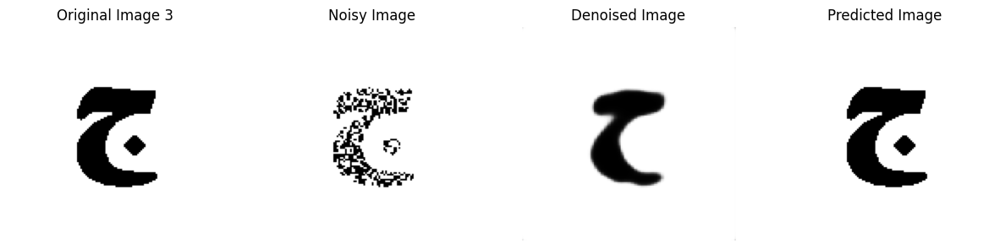

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


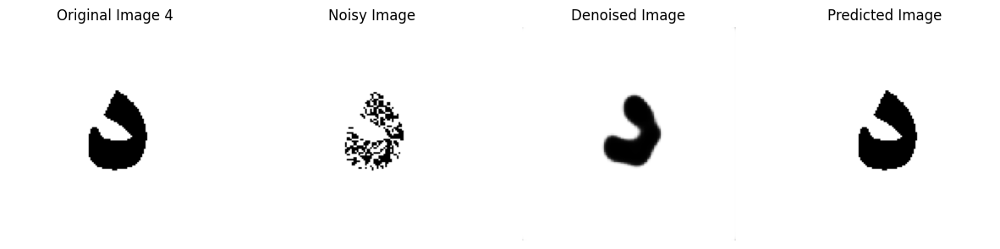

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


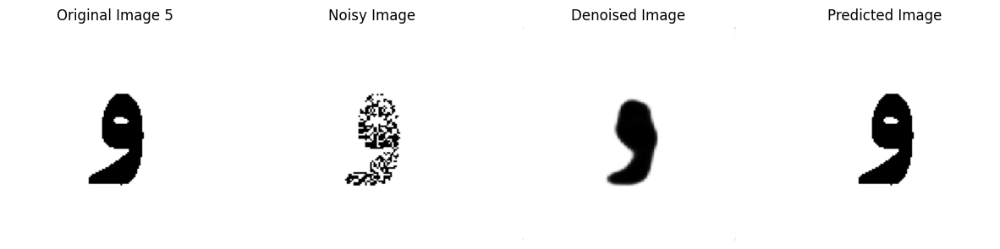

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


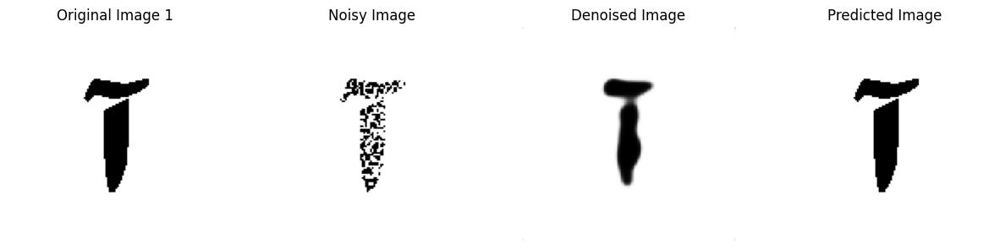

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


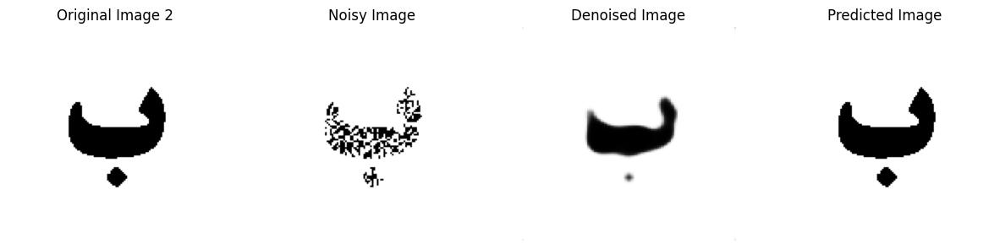

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


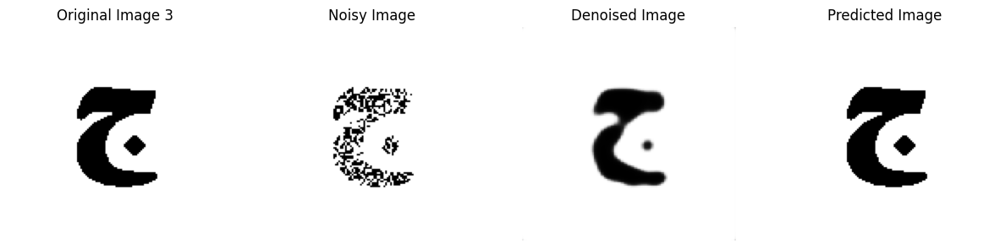

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


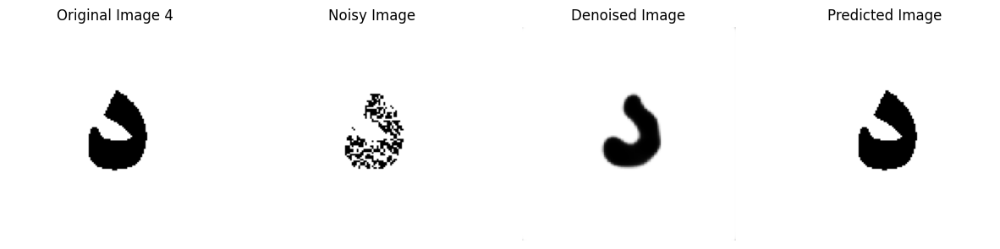

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


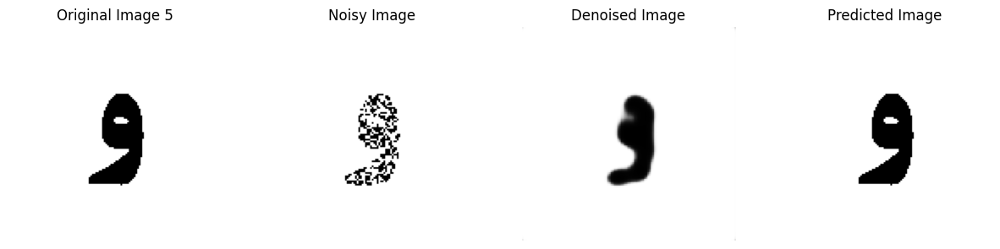

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


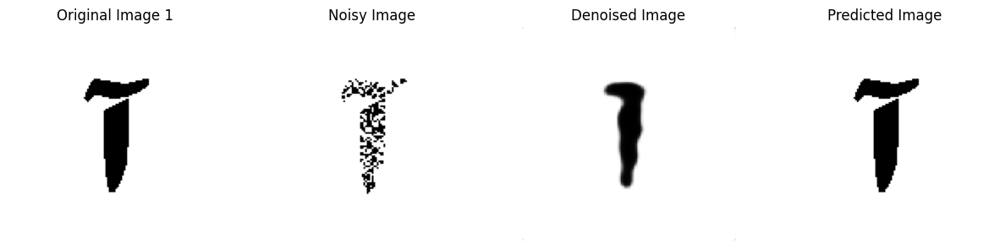

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


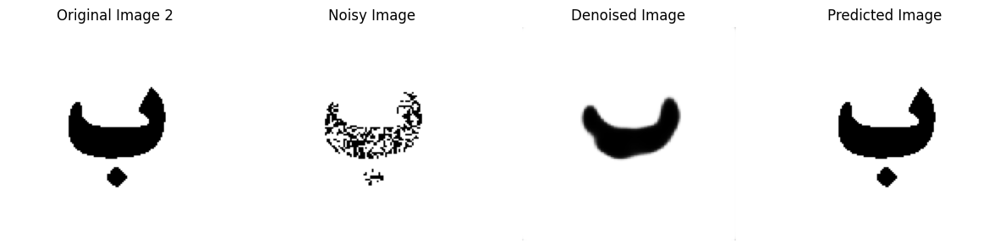

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


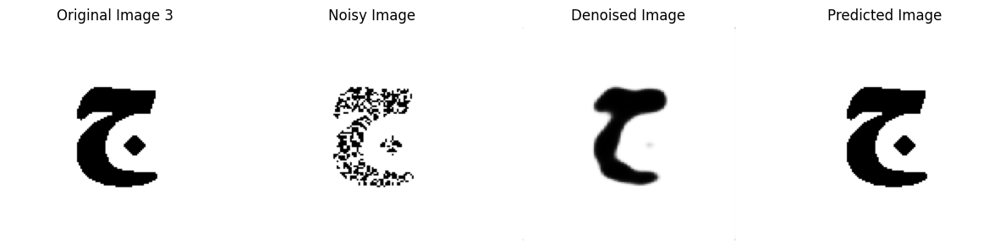

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


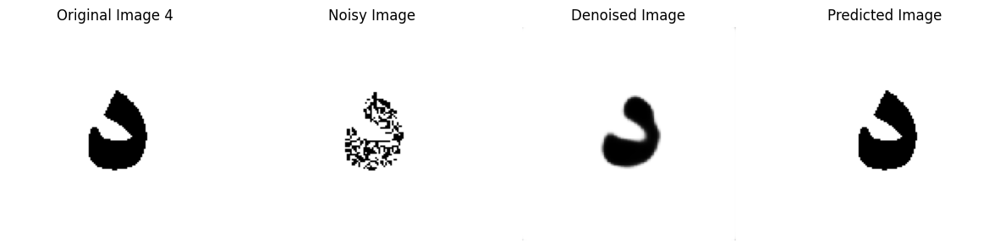

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


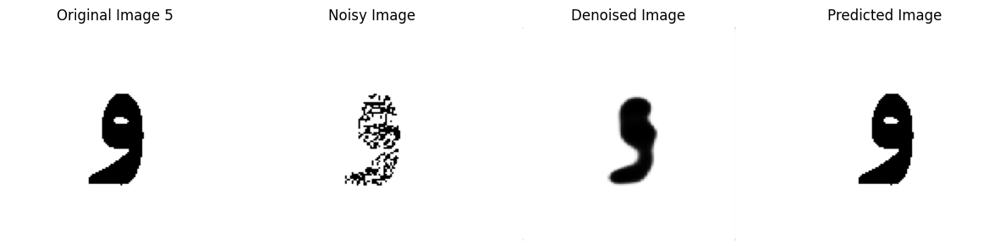

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


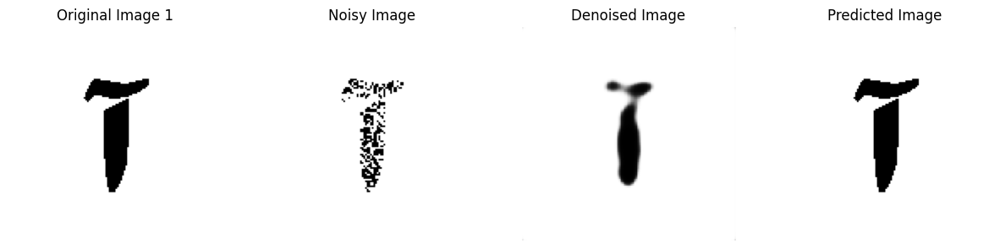

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


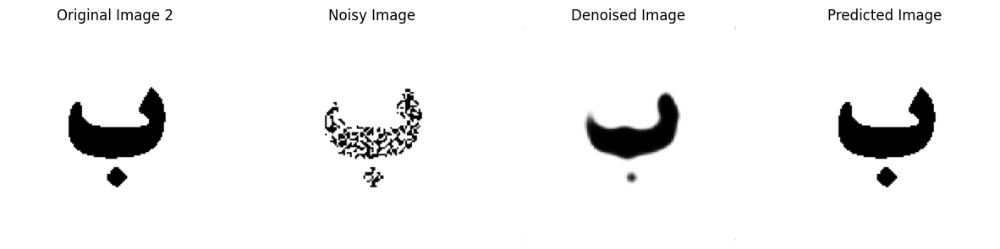

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


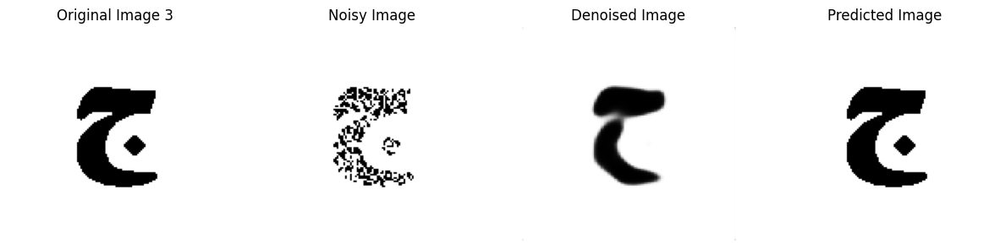

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


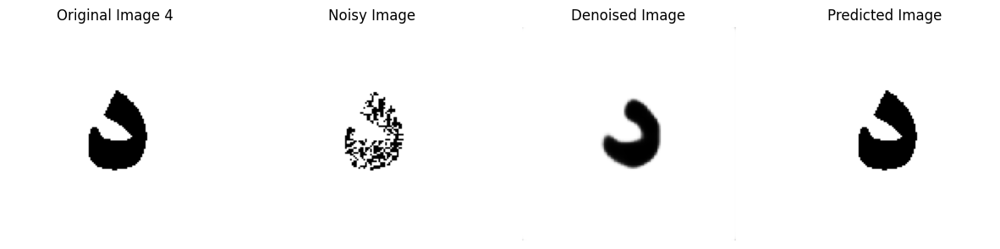

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


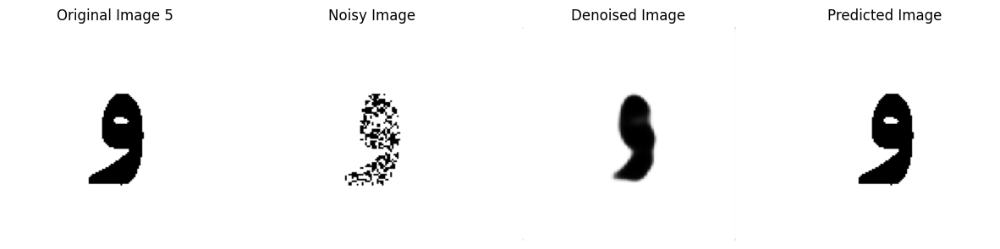

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


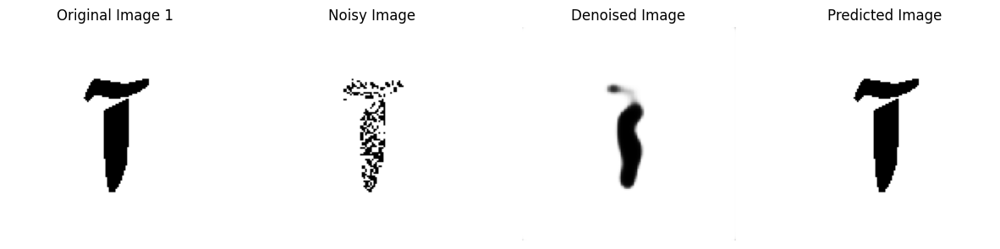

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


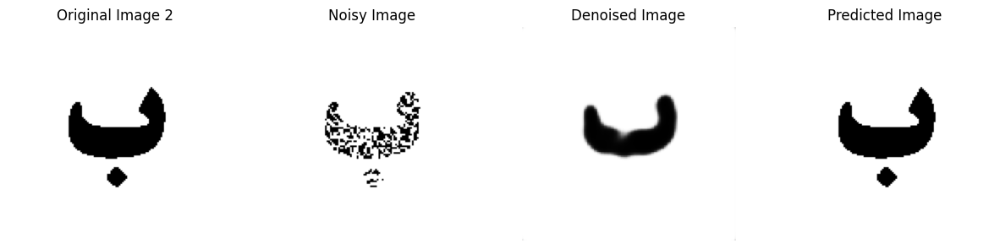

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


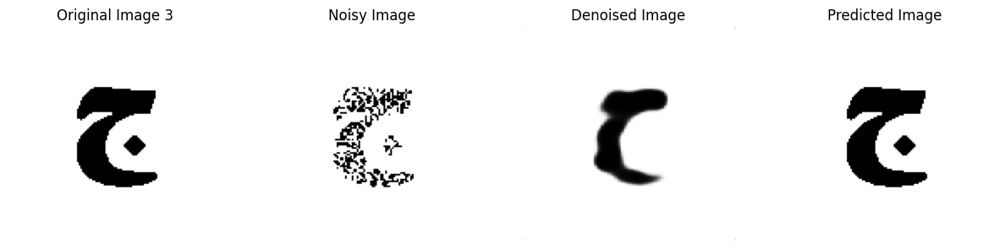

Given Image: 3, Predicted Image Index: 3
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


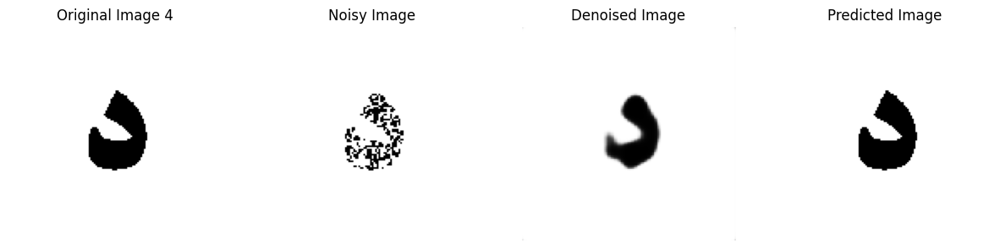

Given Image: 4, Predicted Image Index: 4
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


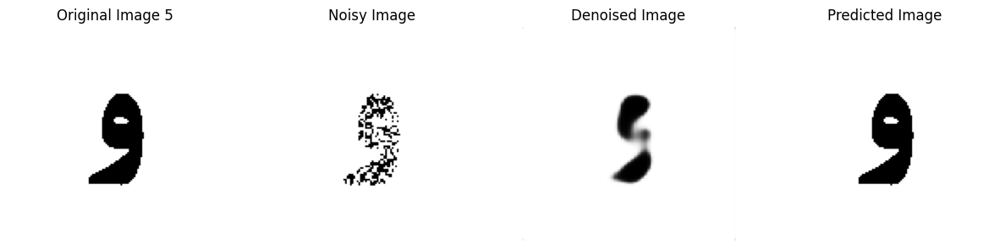

Given Image: 5, Predicted Image Index: 5
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


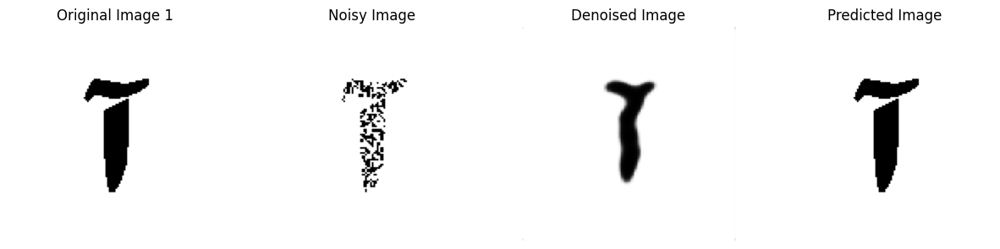

Given Image: 1, Predicted Image Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


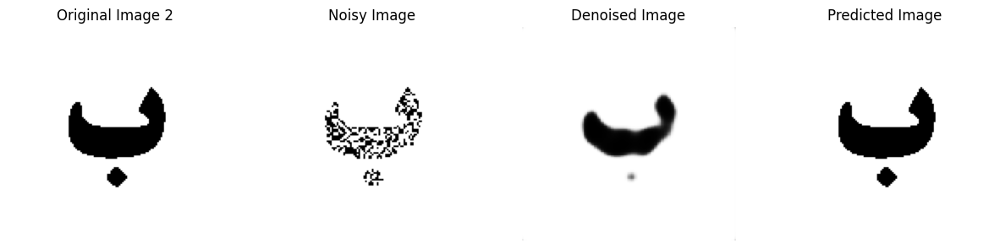

Given Image: 2, Predicted Image Index: 2
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


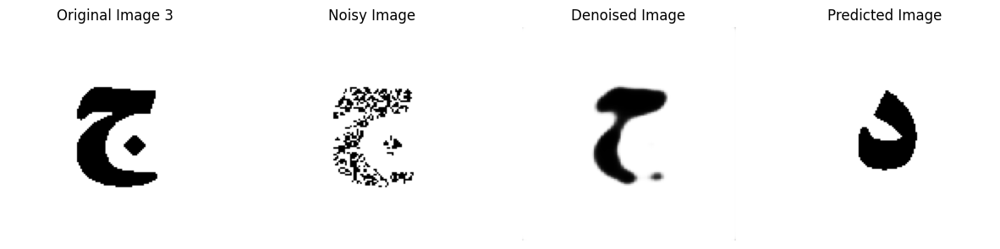

Given Image: 3, Predicted Image Index: 4
Prediction error. The image was 3 but predicted as 4.
The highest number of missing points where the network was still accurate: 49594


In [9]:
from keras.models import Model, Sequential
from keras.layers import Dense, Input, Flatten, Reshape, Conv2D, MaxPooling2D, UpSampling2D
from keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image, ImageDraw
import numpy as np
import random
import matplotlib.pyplot as plt

# Function to convert image to binary
def convert_image_to_binary(image_path, size=(128, 128)):
    image = Image.open(image_path).convert('L').resize(size)
    return (np.array(image) > 128).astype(int)

# Function to add missing points
def add_missing_points(image_path, output_path, change_rate):
    image = Image.open(image_path).convert('RGB')
    draw = ImageDraw.Draw(image)
    width, height = image.size
    pix = image.load()

    black_pixels = [(i, j) for i in range(width) for j in range(height) if sum(pix[i, j]) < 128 * 3]
    num_pixels_to_change = int(len(black_pixels) * change_rate)
    sampled_pixels = random.sample(black_pixels, num_pixels_to_change)

    for i, j in sampled_pixels:
        draw.point((i, j), (255, 255, 255))

    image.save(output_path, "JPEG")
    return len(sampled_pixels)

# Build the autoencoder
def build_autoencoder(input_shape):
    input_img = Input(shape=input_shape)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)

    x = Conv2D(64, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)

    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy')
    return autoencoder

# Hamming network
class HammingNetwork:
    def __init__(self, num_neurons):
        self.num_neurons = num_neurons
        self.weights = None
        self.bias = None

    def train(self, inputs):
        self.weights = np.array(inputs)
        self.bias = np.ones(self.num_neurons) * 0.5 * len(inputs[0]) * 3

    def predict(self, input_image):
        product = np.dot(self.weights, input_image)
        stored = product - self.bias
        return np.argmax(stored)

# Function to display images side-by-side
def display_images(original, noisy, denoised, predicted, index):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 4, 1)
    plt.imshow(original, cmap='gray')
    plt.title(f'Original Image {index + 1}')
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.imshow(noisy, cmap='gray')
    plt.title('Noisy Image')
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.imshow(denoised, cmap='gray')
    plt.title('Denoised Image')
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.imshow(predicted, cmap='gray')
    plt.title('Predicted Image')
    plt.axis('off')

    plt.show()

# Paths to original images
image_paths = [f"{i}.jpg" for i in range(1, 6)]

# Prepare data for the autoencoder
train_images = np.array([convert_image_to_binary(path) for path in image_paths])
train_images = train_images.reshape((-1, 128, 128, 1))

# Build and train the autoencoder
autoencoder = build_autoencoder(input_shape=(128, 128, 1))
noisy_images = train_images + 0.5 * np.random.normal(loc=0.0, scale=1.0, size=train_images.shape)
noisy_images = np.clip(noisy_images, 0., 1.)
autoencoder.fit(noisy_images, train_images, epochs=50, batch_size=16, validation_split=0.2)

# Initialize and train the Hamming network
network = HammingNetwork(num_neurons=len(image_paths))
training_data = [convert_image_to_binary(path).flatten() for path in image_paths]
network.train(training_data)

# Iterative process
change_rate = 0.01
missing_points_list = []
last_correct_missing_points = 0

while True:
    correct_predictions = 0

    # Generate noisy images
    for i, image_path in enumerate(image_paths):
        noisy_image_path = f"noisy_{i + 1}.jpg"
        missing_points = add_missing_points(image_path, noisy_image_path, change_rate)
        missing_points_list.append(missing_points)

        # Denoise the image
        noisy_image = np.array(convert_image_to_binary(noisy_image_path)).reshape(1, 128, 128, 1)
        denoised_image = autoencoder.predict(noisy_image).reshape(128, 128)

        # Predict using the Hamming network
        denoised_flattened = (denoised_image > 0.5).astype(int).flatten()
        prediction = network.predict(denoised_flattened)

        # Display the images
        original_image = np.array(convert_image_to_binary(image_path)).reshape(128, 128)
        noisy_image_display = np.array(convert_image_to_binary(noisy_image_path)).reshape(128, 128)
        predicted_image = np.array(convert_image_to_binary(image_paths[prediction])).reshape(128, 128)

        display_images(original_image, noisy_image_display, denoised_image, predicted_image, i)

        print(f"Given Image: {i + 1}, Predicted Image Index: {prediction + 1}")

        if prediction != i:
            print(f"Prediction error. The image was {i + 1} but predicted as {prediction + 1}.")
            last_correct_missing_points = sum(missing_points_list)
            break
        else:
            correct_predictions += 1

    if correct_predictions != len(image_paths):
        break

    change_rate += 0.01

print(f"The highest number of missing points where the network was still accurate: {last_correct_missing_points}")


**Quest 4 Part 1**

In [ ]:
from sklearn.datasets import fetch_california_housing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Load the California Housing dataset
housing = fetch_california_housing()
X, y = housing.data, housing.target

print("Dataset loaded successfully.")
print(f"Feature names: {housing.feature_names}")
print(f"First 5 rows of data:\n{X[:5]}")
print(f"First 5 target values:\n{y[:5]}")

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=73)

print("\nData split into training and testing sets.")
print(f"Training data shape: {X_train.shape}")
print(f"Testing data shape: {X_test.shape}")

# Standardize the dataset
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

print("\nData standardized.")


Dataset loaded successfully.
Feature names: ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude']
First 5 rows of data:
[[ 8.32520000e+00  4.10000000e+01  6.98412698e+00  1.02380952e+00
   3.22000000e+02  2.55555556e+00  3.78800000e+01 -1.22230000e+02]
 [ 8.30140000e+00  2.10000000e+01  6.23813708e+00  9.71880492e-01
   2.40100000e+03  2.10984183e+00  3.78600000e+01 -1.22220000e+02]
 [ 7.25740000e+00  5.20000000e+01  8.28813559e+00  1.07344633e+00
   4.96000000e+02  2.80225989e+00  3.78500000e+01 -1.22240000e+02]
 [ 5.64310000e+00  5.20000000e+01  5.81735160e+00  1.07305936e+00
   5.58000000e+02  2.54794521e+00  3.78500000e+01 -1.22250000e+02]
 [ 3.84620000e+00  5.20000000e+01  6.28185328e+00  1.08108108e+00
   5.65000000e+02  2.18146718e+00  3.78500000e+01 -1.22250000e+02]]
First 5 target values:
[4.526 3.585 3.521 3.413 3.422]

Data split into training and testing sets.
Training data shape: (16512, 8)
Testing data shape: (4128, 8)

Data st

In [ ]:
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam
from keras.layers import Input
import tensorflow as tf

# Define RBF layer
class RBFLayer(tf.keras.layers.Layer):
    def __init__(self, units, gamma):
        super().__init__()
        self.units = units
        self.gamma = gamma

    def build(self, input_shape):
        self.centers = self.add_weight(
            shape=(self.units, input_shape[1]),
            initializer='random_normal',
            trainable=True
        )
        self.built = True

    def call(self, inputs):
        c = tf.expand_dims(self.centers, axis=0)
        h = tf.expand_dims(inputs, axis=1)
        return tf.exp(-self.gamma * tf.math.reduce_sum(tf.math.square(h - c), axis=2))

# Define the RBF model
rbf_model = Sequential()
rbf_model.add(Input(shape=(X_train.shape[1],)))
rbf_model.add(RBFLayer(10, 0.1))
rbf_model.add(Dense(1))

# Compile the model
rbf_model.compile(optimizer=Adam(learning_rate=0.01), loss='mse')

print("RBF model defined and compiled.")
print(rbf_model.summary())


RBF model defined and compiled.


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ rbf_layer (RBFLayer)                 │ (None, 10)                  │              80 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              11 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 91 (364.00 B)

 Trainable params: 91 (364.00 B)

 Non-trainable params: 0 (0.00 B)

None


In [ ]:
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam

# Define the Dense model
dense_model = Sequential()
dense_model.add(Dense(64, input_shape=(X_train.shape[1],), activation='relu'))
dense_model.add(Dense(1))

# Compile the model
dense_model.compile(optimizer=Adam(learning_rate=0.01), loss='mse')

print("Dense model defined and compiled.")
print(dense_model.summary())


Dense model defined and compiled.


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_1 (Dense)                      │ (None, 64)                  │             576 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 641 (2.50 KB)

 Trainable params: 641 (2.50 KB)

 Non-trainable params: 0 (0.00 B)

None


In [ ]:
# Train the RBF model
history_rbf = rbf_model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2, verbose=1)

print("RBF model training complete.")
print(f"Training Loss: {history_rbf.history['loss']}")
print(f"Validation Loss: {history_rbf.history['val_loss']}")


Epoch 1/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 1.3304 - val_loss: 0.6486
Epoch 2/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.5705 - val_loss: 0.5472
Epoch 3/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4917 - val_loss: 0.5239
Epoch 4/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.4910 - val_loss: 0.5280
Epoch 5/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4868 - val_loss: 0.4938
Epoch 6/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4637 - val_loss: 0.4836
Epoch 7/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.4515 - val_loss: 0.4748
Epoch 8/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4503 - val_loss: 0.4714
Epoch 9/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4330 - val_loss: 0.4688
Epoch 10/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4410 - val_loss: 0.4635
Epoch 11/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4237 - val_loss: 0.4590
Epoch 12/100
413/413 ━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Evaluate the RBF model
rbf_loss = rbf_model.evaluate(X_test, y_test, verbose=0)
print(f"RBF Model Test Loss: {rbf_loss:.4f}")


RBF Model Test Loss: 0.3989


In [ ]:
# Train the Dense model
history_dense = dense_model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2, verbose=1)

print("Dense model training complete.")
print(f"Training Loss: {history_dense.history['loss']}")
print(f"Validation Loss: {history_dense.history['val_loss']}")


Epoch 1/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - loss: 1.0313 - val_loss: 0.7410
Epoch 2/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4947 - val_loss: 0.4124
Epoch 3/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3986 - val_loss: 0.4948
Epoch 4/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3853 - val_loss: 1.2169
Epoch 5/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.6365 - val_loss: 1.4193
Epoch 6/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 1.3460 - val_loss: 0.4038
Epoch 7/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4582 - val_loss: 0.5336
Epoch 8/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3884 - val_loss: 0.3722
Epoch 9/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3335 - val_loss: 0.3552
Epoch 10/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.6500 - val_loss: 0.3619
Epoch 11/100
413/413 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.3237 - val_loss: 0.4023
Epoch 12/100
413/413 ━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Evaluate the Dense model
dense_loss = dense_model.evaluate(X_test, y_test, verbose=0)
print(f"Dense Model Test Loss: {dense_loss:.4f}")


Dense Model Test Loss: 0.3129



Summary of Results:
RBF Model Test Loss: 0.4152
Dense Model Test Loss: 0.3038
Comparing Training and Validation Losses for both models:


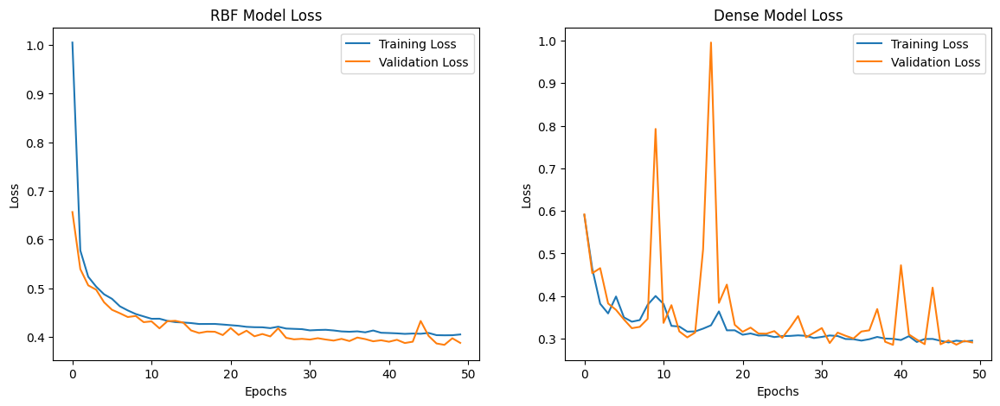

In [ ]:
# Summarizing the results
print("\nSummary of Results:")
print(f"RBF Model Test Loss: {rbf_loss:.4f}")
print(f"Dense Model Test Loss: {dense_loss:.4f}")

print("Comparing Training and Validation Losses for both models:")

# Plot the training and validation losses
import matplotlib.pyplot as plt

# RBF Model
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)
plt.plot(history_rbf.history['loss'], label='Training Loss')
plt.plot(history_rbf.history['val_loss'], label='Validation Loss')
plt.title('RBF Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Dense Model
plt.subplot(1, 2, 2)
plt.plot(history_dense.history['loss'], label='Training Loss')
plt.plot(history_dense.history['val_loss'], label='Validation Loss')
plt.title('Dense Model Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.show()


**Obtimised Overall code for Quest 4**

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 8s 7ms/step - loss: 1.3968 - val_loss: 0.6565
Epoch 2/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 4s 4ms/step - loss: 0.6098 - val_loss: 0.5392
Epoch 3/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.5273 - val_loss: 0.5058
Epoch 4/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.5127 - val_loss: 0.4969
Epoch 5/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - loss: 0.4936 - val_loss: 0.4710
Epoch 6/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step - loss: 0.4912 - val_loss: 0.4555
Epoch 7/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4680 - val_loss: 0.4484
Epoch 8/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4634 - val_loss: 0.4406
Epoch 9/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4637 - val_loss: 0.4428
Epoch 10/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4506 - val_loss: 0.4301
Epoch 11/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4385 - val_loss: 0.4317
Epoch 12/50
413/413 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step

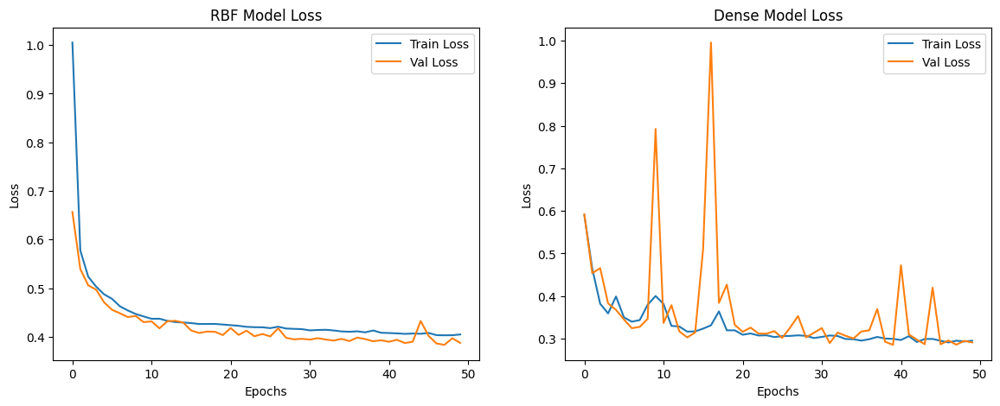

In [ ]:
# Optimize the complete code
from sklearn.datasets import fetch_california_housing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Input
from keras.optimizers import Adam
import matplotlib.pyplot as plt

# Load and preprocess data
housing = fetch_california_housing()
X, y = housing.data, housing.target
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=73)
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Define RBF layer
class RBFLayer(tf.keras.layers.Layer):
    def __init__(self, units, gamma):
        super().__init__()
        self.units = units
        self.gamma = gamma

    def build(self, input_shape):
        self.centers = self.add_weight(
            shape=(self.units, input_shape[1]),
            initializer='random_normal',
            trainable=True
        )

    def call(self, inputs):
        c = tf.expand_dims(self.centers, axis=0)
        h = tf.expand_dims(inputs, axis=1)
        return tf.exp(-self.gamma * tf.reduce_sum(tf.square(h - c), axis=2))

# RBF model
rbf_model = Sequential([
    Input(shape=(X_train.shape[1],)),
    RBFLayer(10, 0.1),
    Dense(1)
])
rbf_model.compile(optimizer=Adam(learning_rate=0.01), loss='mse')

# Dense model
dense_model = Sequential([
    Dense(64, input_shape=(X_train.shape[1],), activation='relu'),
    Dense(1)
])
dense_model.compile(optimizer=Adam(learning_rate=0.01), loss='mse')

# Train and evaluate models
history_rbf = rbf_model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2, verbose=1)
history_dense = dense_model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2, verbose=1)
rbf_loss = rbf_model.evaluate(X_test, y_test, verbose=0)
dense_loss = dense_model.evaluate(X_test, y_test, verbose=0)

# Results
print(f"RBF Test Loss: {rbf_loss:.4f}")
print(f"Dense Test Loss: {dense_loss:.4f}")

# Plot results
plt.figure(figsize=(14, 5))
for i, (history, title) in enumerate(zip([history_rbf, history_dense], ['RBF', 'Dense'])):
    plt.subplot(1, 2, i + 1)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Val Loss')
    plt.title(f'{title} Model Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
plt.show()
